# Time Series Analysis Notebook

**By:** Mohamed Ezzat

---

## Objective

We have 96 time series datasets. For each dataset, our goal is to create a model that achieves the **best RMSE** and provides **accurate predictions**. The following pipeline outlines the steps we'll take to achieve this:

---

## Pipeline

1. **Exploratory Data Analysis (EDA)** for the dataset.
2. Detecting the **best algorithm for filling missing values** (handling nulls).
3. Analyzing the data components:
   - **Trend**
   - **Seasonality**
   - **Autocorrelation**
4. **Feature extraction** to enhance model performance.
5. **Model training and Evaluation** on the dataset.
6. **Saving the best model** and developing an **API for usage**.

---

This notebook will guide you through the step-by-step process of working with time series data, from exploratory analysis to model development, and ultimately, to deployment through an API.


In [2]:
import sys
print(sys.version)


3.12.4 | packaged by Anaconda, Inc. | (main, Jun 18 2024, 15:03:56) [MSC v.1929 64 bit (AMD64)]


### Exploratory Data Analysis

In [4]:
import pandas as pd
import numpy as np

# Load dataset
df = pd.read_csv('train_splits/train_9.csv')

# Display Rows
df.head()



,value,timestamp,anomaly
0,-0.925347,2021-07-01 00:00:00,False
1,-1.053632,2021-07-01 00:10:00,False
2,-1.023581,2021-07-01 00:20:00,False
3,-0.959519,2021-07-01 00:30:00,False
4,-1.154035,2021-07-01 00:40:00,False


In [5]:
# Check for missing values
df.isnull().sum()

value        1231
timestamp       0
anomaly         0
dtype: int64

### Handling Nulls (Linear Interpolation vs Iterative Imputation)

In [7]:
# Summary of the dataset
df.describe()

,value
count,22961.000000
mean,-0.845377
std,0.303192
min,-1.439961
25%,-1.020311
50%,-0.927183
75%,-0.771639
max,0.998917


In [8]:
# Applying linear interpolation
df_interpolated = df.copy()
df_interpolated['value'] = df_interpolated['value'].interpolate(method='linear')

df_interpolated.describe()

,value
count,24192.000000
mean,-0.845695
std,0.300191
min,-1.439961
25%,-1.019587
50%,-0.927655
75%,-0.770816
max,0.998917


In [9]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer



df_iterative = df.copy()
iter_imputer = IterativeImputer(max_iter=10, random_state=42)
df_iterative['value'] = iter_imputer.fit_transform(df_iterative[['value']])


df_iterative.describe()


,value
count,24192.000000
mean,-0.845377
std,0.295377
min,-1.439961
25%,-1.015093
50%,-0.915753
75%,-0.786151
max,0.998917


As observed, **Linear Interpolation** preserves most of the characteristics of the original data with only a slight difference in the mean. Most other statistical properties remain consistent, making it a **reliable method** for handling missing data.


## Analyzing the Data Components

### Difference Between ACF and PACF Plots:

- **Autocorrelation Function (ACF) Plot**:
  - The ACF plot shows the correlation between the time series and its **lagged values**. It tells us how each value in the time series is related to past values at different time lags. A high value indicates that the series has some correlation with its previous values at that lag.
  
- **Partial Autocorrelation Function (PACF) Plot**:
  - The PACF plot shows the correlation between the time series and its lagged values **after removing the effects of shorter lags**. It isolates the direct relationship between a time series and its lag at a specific time step, giving a clearer picture of how much a particular lag influences the series.


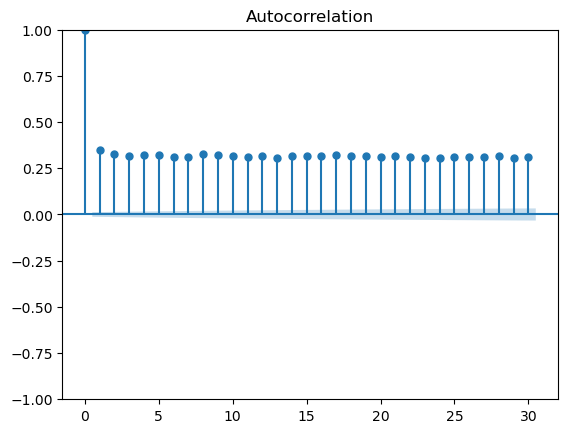

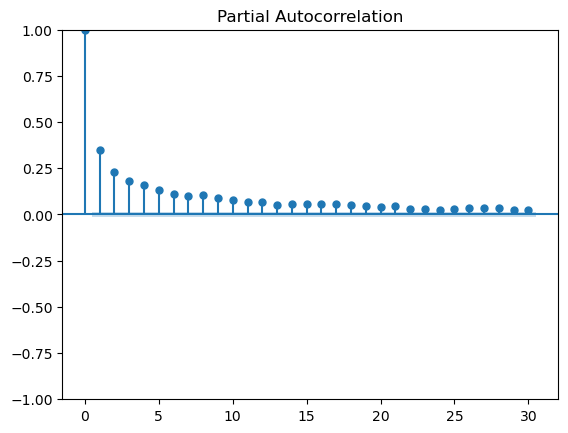

In [12]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

# ACF plot
plot_acf(df_interpolated['value'], lags=30)
plt.show()

# PACF plot
plot_pacf(df_interpolated['value'], lags=30)
plt.show()


As obeserved in the two graph the lag values of 3 or 4 is suffcient for the data as features

## Now let us check the data structure  (stationary vs non-stationary)

In [15]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd


result = adfuller(df_interpolated['value'])
print('p-value:', result[1])

 
   
cnt= 0
while(result[1] > 0.05):
        print(f'The time series is not stationary. Applying differencing{cnt}')
        df['value'] = df_interpolated['value'].diff()
        df['value'] = df_interpolated['value'].bfill()
        result = adfuller(df_interpolated['value'])
        print('New p-value after differencing:', result[1])
    
       
print('The differenced time series is stationary.')
        

p-value: 1.654229760652117e-06
The differenced time series is stationary.


## Data Decomposition

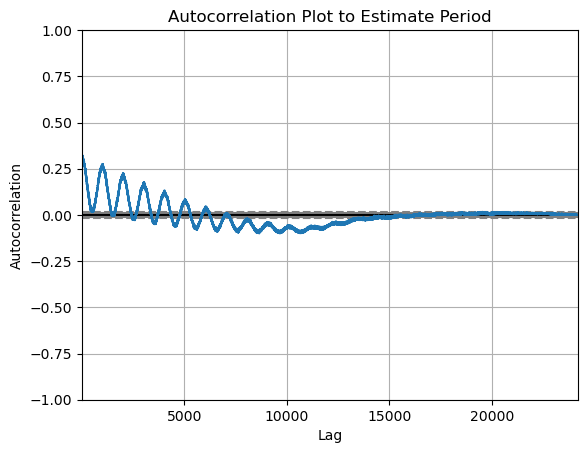

In [17]:
import matplotlib.pyplot as plt
from pandas.plotting import autocorrelation_plot

# Plot the autocorrelation to detect periodic patterns
autocorrelation_plot(df_interpolated['value'])
plt.title('Autocorrelation Plot to Estimate Period')
plt.show()


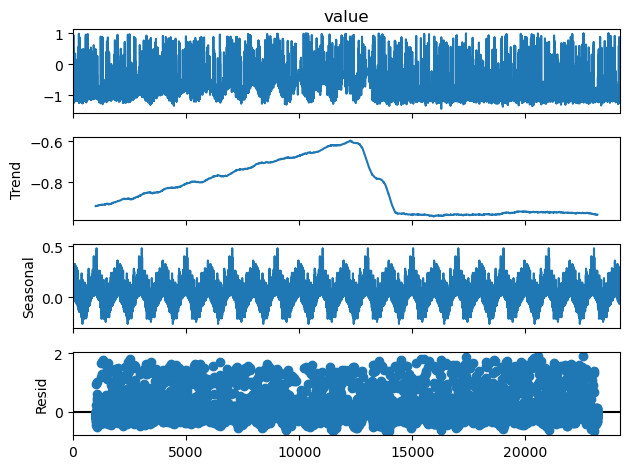

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Perform classical decomposition (additive model as observed in data visualization)
decomposition = seasonal_decompose(df_interpolated['value'], model='additive',period=2000)

# Plot the decomposed components
decomposition.plot()
plt.show()


### Building the Pipeline

We will now build a pipeline to test the data on different models, including:
- **XGBoost** (an Ensemble machine learning model),
- **Linear Regression** (a classical machine learning model),
- **ARIMA**
- **Prophet**.


### Feature Selection Process

After trying many combinations of features and measuring feature importance, which will be shown in the upcoming graph, the final selected features are:

- **Minute of Hour**: Helps capture the time-related patterns within each hour.
- **3 Lag Features**: Proven to be significant by analyzing the AutoCorrelation Function (ACF).
- **Rolling Mean**: Provides a smooth trend by averaging data over a specified window.
- **Rolling Standard Deviation (std)**: Captures the variability of the data over a rolling window.


In [21]:

# Feature Engineering Function
def create_features(df, max_lag=3):
    """
    Create time, lag, rolling stats.
    """

    # Extract time features
    df['minute_of_hour'] = df.index.minute
    #df['day_of_week'] = df.index.dayofweek
    #df['month_of_year'] = df.index.month
    #df['week_of_month'] = ((df.index.day - 1) // 7) + 1
    #df['day_of_month'] = df.index.day


    # Extract lag features 3
    for lag in range(1, max_lag + 1):
        df[f'lag_{lag}'] = df['value'].shift(lag)

    # Extract rolling stat features
    df['rolling_mean'] = df['value'].rolling(window=3).mean()
    df['rolling_std'] = df['value'].rolling(window=3).std()

    df.fillna(method='bfill', inplace=True)

    
    return df


In [22]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller

def preprocess_data(df):
    if 'anomaly' in df.columns:
        df.drop('anomaly', axis=1, inplace=True)
    
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    df['value'] = df['value'].interpolate(method='linear')
    df.set_index('timestamp', inplace=True)
    
    df.replace([np.inf, -np.inf], np.nan, inplace=True)
    df.fillna(method='bfill', inplace=True)
    result = adfuller(df['value'])
    cnt = 0
    while result[1] > 0.05:
        print(f'The time series is not stationary. Applying differencing {cnt}')
        df['value'] = df['value'].diff().bfill()
        result = adfuller(df['value'])
        print('New p-value after differencing:', result[1])
        cnt += 1
    
    print('The differenced time series is stationary.')
    
    df = create_features(df)
    
    return df


In [23]:
import joblib


# ARIMA Model
def train_arima_model(train_df):
    arima_order = (1, 0, 2)
    arima_model = ARIMA(train_df['value'], order=arima_order).fit()
    return arima_model

# Prophet Model
def train_prophet_model(train_df):
    prophet_train_df = train_df.reset_index()[['timestamp', 'value']].rename(
        columns={'timestamp': 'ds', 'value': 'y'}
    )
    prophet_model = Prophet()
    prophet_model.fit(prophet_train_df)
    return prophet_model

# XGBoost Model
def train_xgboost_model(train_df):
    feature_cols = [col for col in train_df.columns if col != 'value']
    xgb_model = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=5)
    xgb_model.fit(train_df[feature_cols], train_df['value'])

    # Visualize feature importance
    plt.figure(figsize=(10, 8))
    plot_importance(xgb_model, importance_type='weight', xlabel='F Score', height=0.8)
    plt.title('XGBoost Feature Importance')
    plt.show()

    return xgb_model

# Linear Regression Model
def train_linear_regression_model(train_df):
    feature_cols = [col for col in train_df.columns if col != 'value']
    lin_reg_model = LinearRegression()
    lin_reg_model.fit(train_df[feature_cols], train_df['value'])

    return lin_reg_model

# Save model to directory
def save_model(model, dataset_name):
    
    models_dir = 'models'
    if not os.path.exists(models_dir):
        os.makedirs(models_dir)
        
    model_filename = os.path.join(models_dir, dataset_name.replace('train', 'model').replace('.csv', '.pkl')) 
                                  
    joblib.dump(model, model_filename)
    print(f"Best model saved as: {model_filename}")


In [24]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import numpy as np
import joblib


def Model_Evaluation(model, train_df, val_df, test_df, model_name):
    """
    Calculate RMSE on training, validation, and test sets and plot residuals for the testing data only.
    """
    # Prediction for training, validation, and test data
    if model_name == 'ARIMA':
        train_pred = model.predict(start=train_df.index[0], end=train_df.index[-1])
        
        val_pred = model.forecast(steps=len(val_df))
        
        test_pred = model.forecast(steps=len(test_df))

    elif model_name == 'Prophet':
        prophet_train_df = train_df.reset_index()[['timestamp', 'value']].rename(
            columns={'timestamp': 'ds', 'value': 'y'}
        )
        future_train = model.make_future_dataframe(periods=0)
        future_val = model.make_future_dataframe(periods=len(val_df), freq='D')
        future_test = model.make_future_dataframe(periods=len(test_df), freq='D')
        train_pred = model.predict(future_train)['yhat'].values
        val_pred = model.predict(future_val)['yhat'][-len(val_df):].values
        test_pred = model.predict(future_test)['yhat'][-len(test_df):].values

    elif model_name == 'XGBoost':
        feature_cols = [col for col in train_df.columns if col != 'value']
        train_pred = model.predict(train_df[feature_cols])
        val_pred = model.predict(val_df[feature_cols])
        test_pred = model.predict(test_df[feature_cols])

    elif model_name == 'LinearRegression':
        feature_cols = [col for col in train_df.columns if col != 'value']
        train_pred = model.predict(train_df[feature_cols])
        val_pred = model.predict(val_df[feature_cols])
        test_pred = model.predict(test_df[feature_cols])
        
   
    val_residuals = (val_df['value']) - (val_pred)
   
    # Plot residuals for testing data
    plt.figure(figsize=(10, 6))
    plt.plot(val_df.index, val_residuals, label='val Residuals')
    plt.axhline(0, color='red', linestyle='--', label='Zero Residual Line')
    plt.title(f"{model_name} Residuals on Validation Data")
    plt.xlabel('Time')
    plt.ylabel('Residuals')
    plt.legend()
    plt.show()

    # Calculate RMSE for training, validation, and test data
    train_rmse = np.sqrt(mean_squared_error(train_df['value'], train_pred))
    val_rmse = np.sqrt(mean_squared_error(val_df['value'], val_pred))
    test_rmse = np.sqrt(mean_squared_error(test_df['value'], test_pred))
    
    # Print RMSE for each dataset
    print(f"RMSE on training data for {model_name}: {train_rmse}")
    print(f"RMSE on validation data for {model_name}: {val_rmse}")
    print(f"RMSE on test data for {model_name}: {test_rmse}")

    return train_rmse, val_rmse, test_rmse 


In [25]:
from sklearn.model_selection import train_test_split


if __name__ == "__main__":
    # Load train data
    dataset_name = 'train_9.csv'
    df = pd.read_csv('train_splits/train_9.csv')
    # Load test data
    test_df = pd.read_csv('test_splits/test_9.csv')

    split_idx = int(0.8 * len(df))
    train_df = df[:split_idx] 
    val_df = df[split_idx:]
    
    # Preprocess Data
    train_df = preprocess_data(train_df)
    val_df =  preprocess_data(val_df)
    test_df = preprocess_data(test_df)



    best_rmse = float('inf')
    best_model = None
    best_model_name = ""


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)


C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


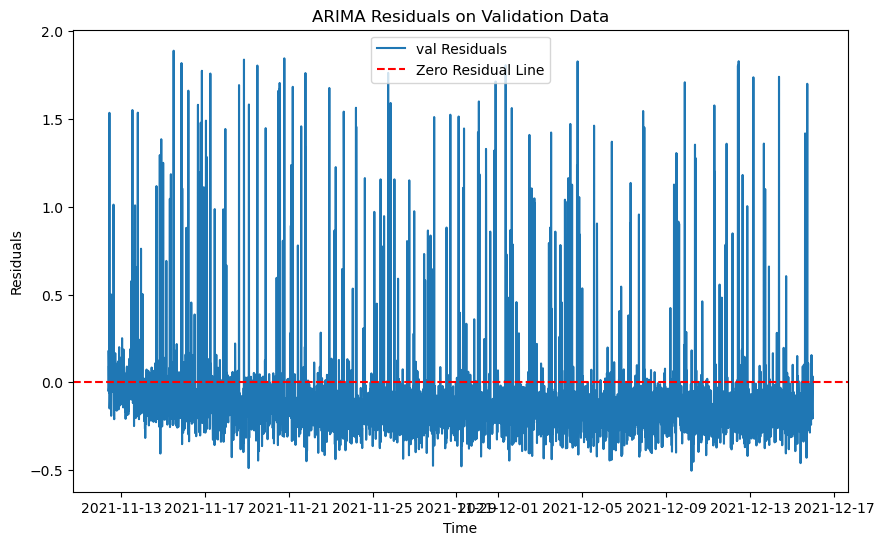

RMSE on training data for ARIMA: 0.24583794394705497
RMSE on validation data for ARIMA: 0.28869840670186225
RMSE on test data for ARIMA: 0.8746244256854737


In [26]:
import os
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
from prophet import Prophet
from sklearn.metrics import mean_squared_error
from xgboost import XGBRegressor, plot_importance
import matplotlib.pyplot as plt
import joblib  # for saving models
import warnings

arima_model = train_arima_model(train_df)
train_rmse, val_rmse, test_rmse = Model_Evaluation(arima_model, train_df, val_df, test_df, 'ARIMA')
if val_rmse < best_rmse:
    best_rmse = val_rmse
    best_model = arima_model
    best_model_name = 'ARIMA'


21:39:36 - cmdstanpy - INFO - Chain [1] start processing
21:39:44 - cmdstanpy - INFO - Chain [1] done processing


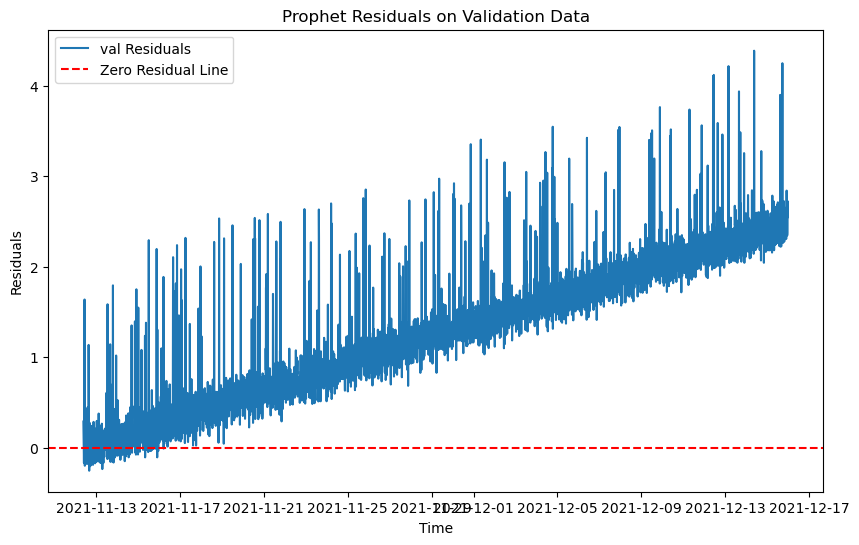

RMSE on training data for Prophet: 0.25885298184972105
RMSE on validation data for Prophet: 1.4902916286777368
RMSE on test data for Prophet: 3.8976348473949116


In [27]:

prophet_model = train_prophet_model(train_df)
train_rmse, val_rmse, test_rmse = Model_Evaluation(prophet_model, train_df, val_df, test_df, 'Prophet')


if val_rmse < best_rmse:
    best_rmse = val_rmse
    best_model = prophet_model
    best_model_name = 'Prophet'


<Figure size 1000x800 with 0 Axes>

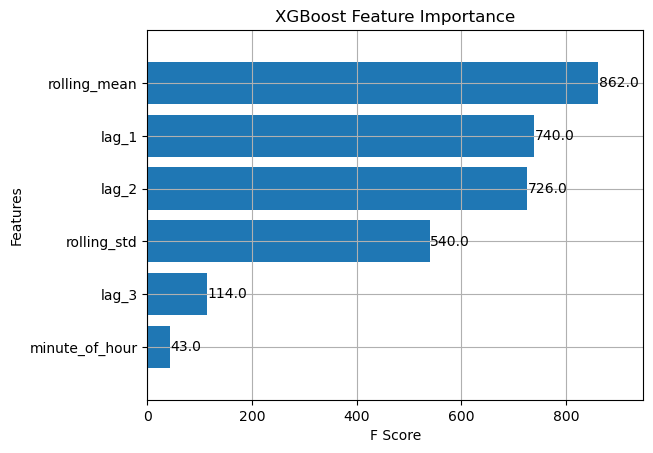

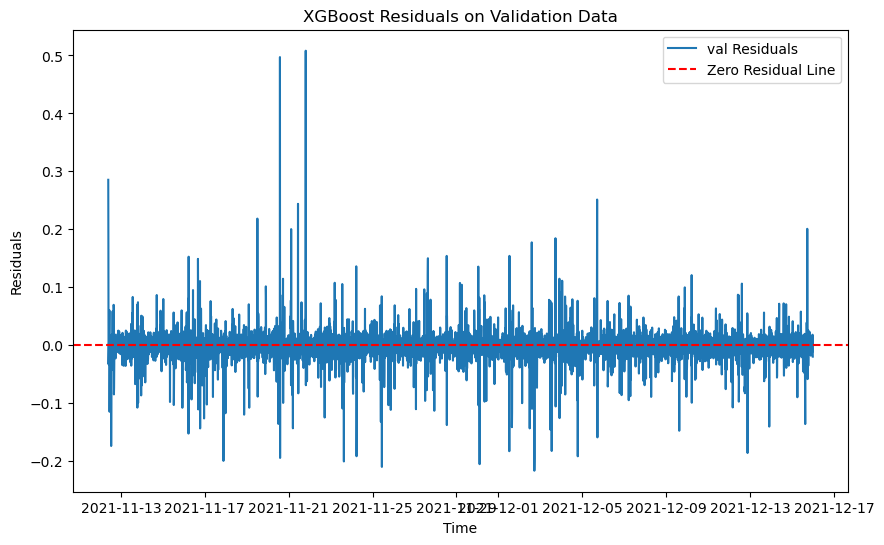

RMSE on training data for XGBoost: 0.027267473272201602
RMSE on validation data for XGBoost: 0.030709800396028077
RMSE on test data for XGBoost: 0.6256124742873085


In [28]:
#XGBoost model
xgb_model = train_xgboost_model(train_df)
train_rmse, val_rmse, test_rmse = Model_Evaluation(xgb_model, train_df, val_df, test_df, 'XGBoost')
if val_rmse < best_rmse:
    best_rmse = val_rmse
    best_model = xgb_model
    best_model_name = 'XGBoost'

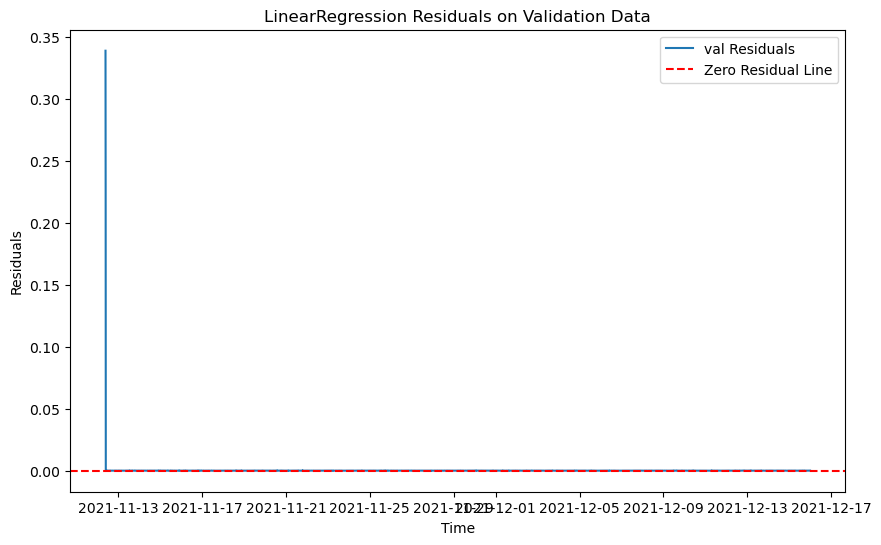

RMSE on training data for LinearRegression: 0.001774512705855682
RMSE on validation data for LinearRegression: 0.005851655919908474
RMSE on test data for LinearRegression: 0.0019684422865375597


In [29]:
# Linear Regression
lin_reg_model = train_linear_regression_model(train_df)
train_rmse, val_rmse, test_rmse = Model_Evaluation(lin_reg_model, train_df, val_df, test_df, 'LinearRegression')

if val_rmse < best_rmse:
    best_rmse = val_rmse
    best_model = lin_reg_model
    best_model_name = 'LinearRegression'



In [30]:
# Print the best model and save it
print(f"\nBest model is {best_model_name} with RMSE: {best_rmse}")
save_model(best_model, dataset_name)



Best model is LinearRegression with RMSE: 0.005851655919908474
Best model saved as: models\model_9.pkl


### Model Evaluation Summary

After testing and evaluating various models, the best-performing model for this task was the **Linear Regression** model. Following closely behind was the **XGBoost** model.

This indicates that classical machine learning models, in some cases, outperform specialized time series models like **Prophet** and **ARIMA**.

- Now let us try this pipline on all datasets 


train_102.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.679196181757723e-25
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 6.717974829163156e-19
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

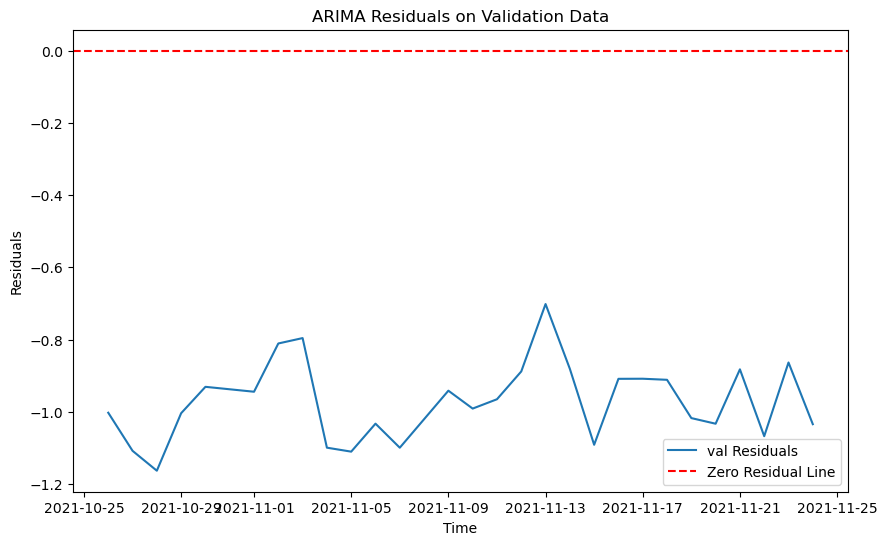

21:39:59 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.5233218428042806
RMSE on validation data for ARIMA: 0.9771388760725562
RMSE on test data for ARIMA: 0.4376068736582135


21:39:59 - cmdstanpy - INFO - Chain [1] done processing


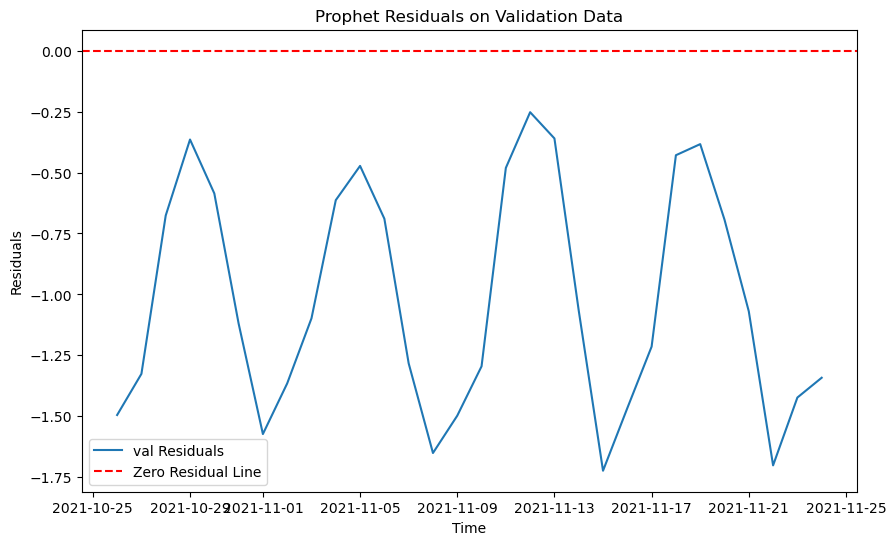

RMSE on training data for Prophet: 0.35499759961958116
RMSE on validation data for Prophet: 1.1242783346194918
RMSE on test data for Prophet: 0.682772612000259


<Figure size 1000x800 with 0 Axes>

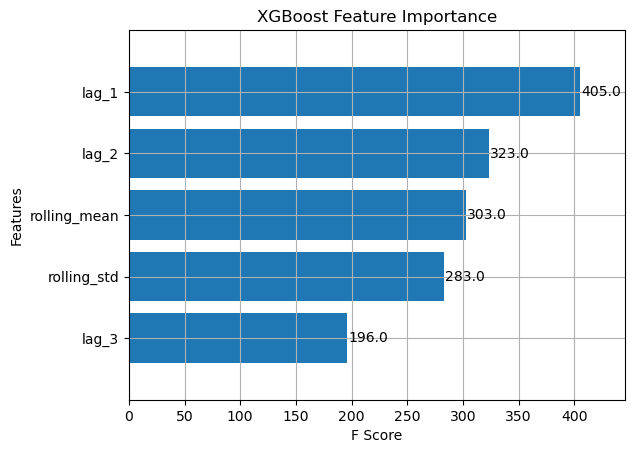

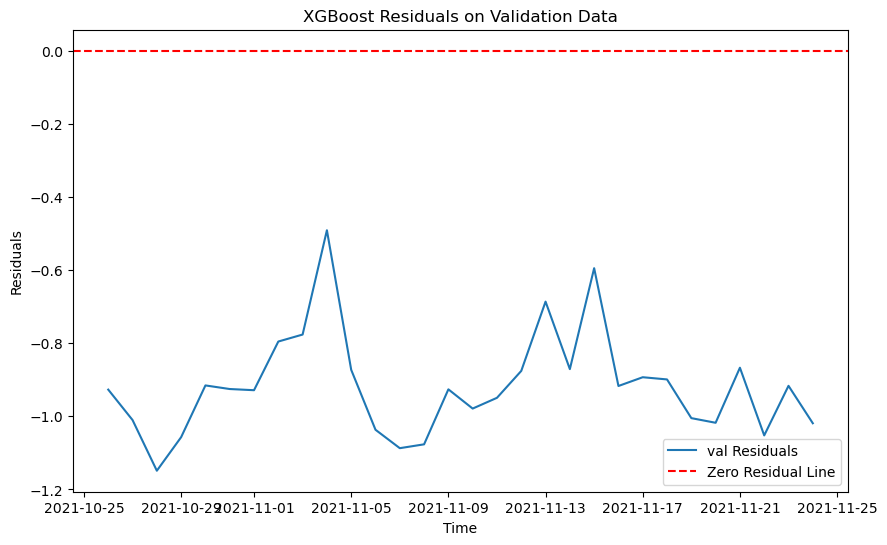

RMSE on training data for XGBoost: 0.030456669585055496
RMSE on validation data for XGBoost: 0.9278597728936968
RMSE on test data for XGBoost: 0.185275736119685


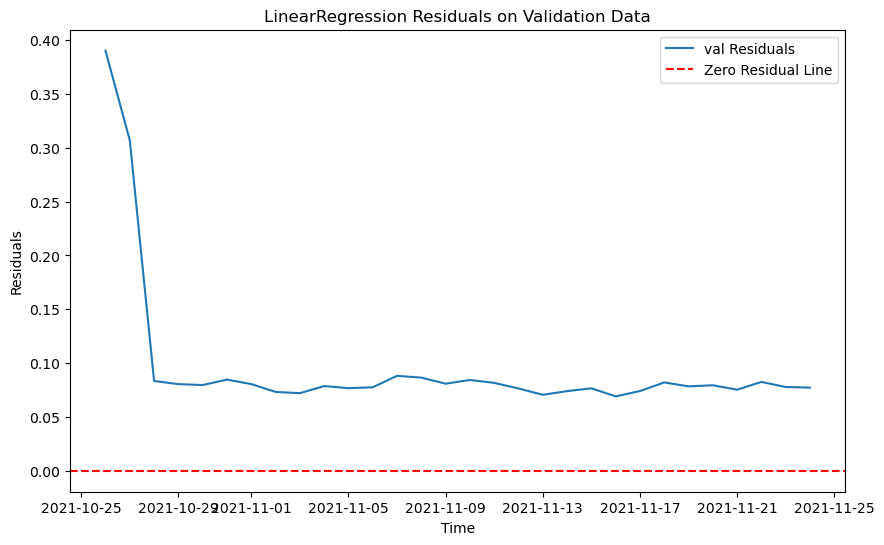

RMSE on training data for LinearRegression: 0.046439627305156245
RMSE on validation data for LinearRegression: 0.11835870219802444
RMSE on test data for LinearRegression: 0.014059489083928872

Best model is LinearRegression with RMSE: 0.11835870219802444
Best model saved as: models\model_102.pkl
data num 1
train_103.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

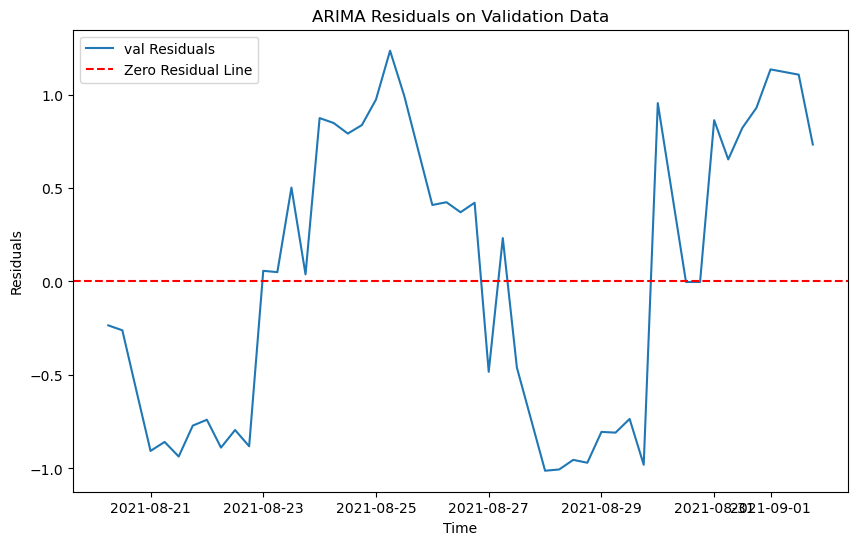

21:40:01 - cmdstanpy - INFO - Chain [1] start processing
21:40:01 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.39060113253662565
RMSE on validation data for ARIMA: 0.7644762039613969
RMSE on test data for ARIMA: 0.7273338899159498


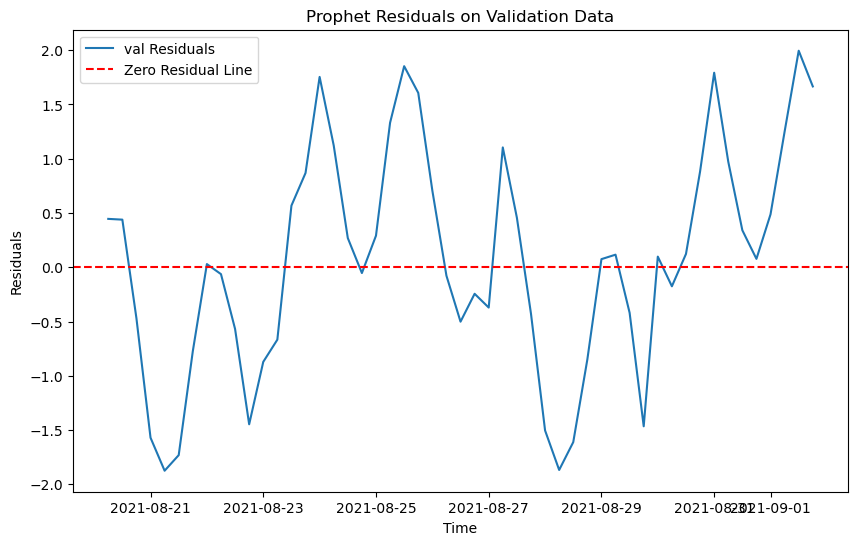

RMSE on training data for Prophet: 0.26343899744372323
RMSE on validation data for Prophet: 1.0368147681417126
RMSE on test data for Prophet: 1.0026165098930477


<Figure size 1000x800 with 0 Axes>

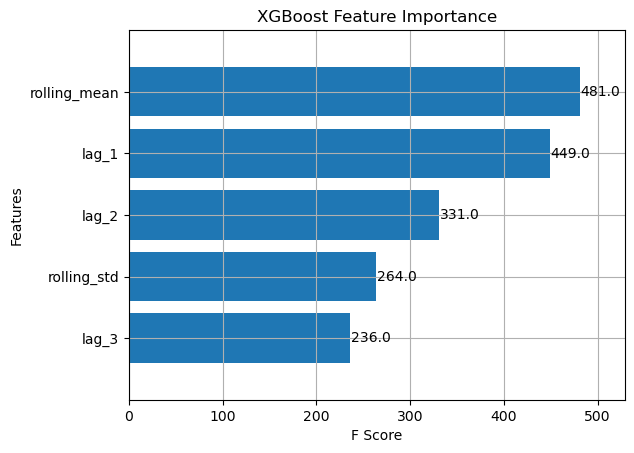

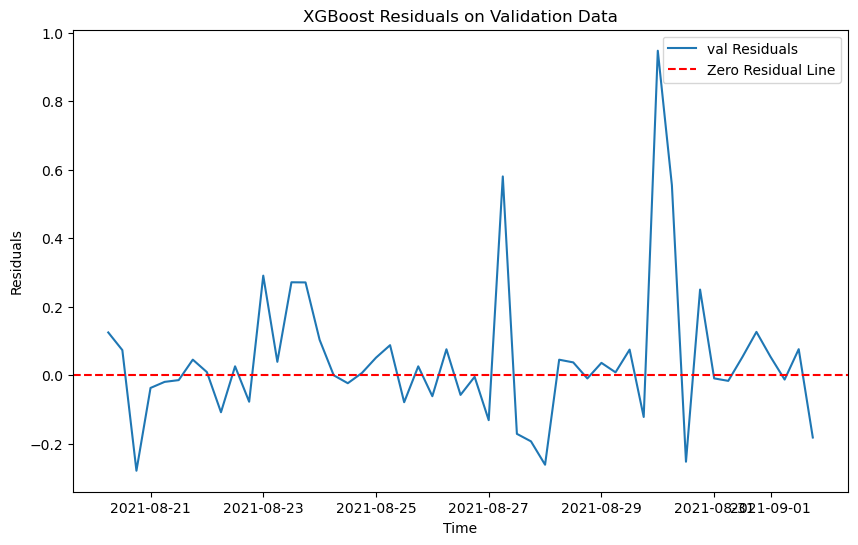

RMSE on training data for XGBoost: 0.014831574965827847
RMSE on validation data for XGBoost: 0.21253373149998184
RMSE on test data for XGBoost: 0.09761854766565553


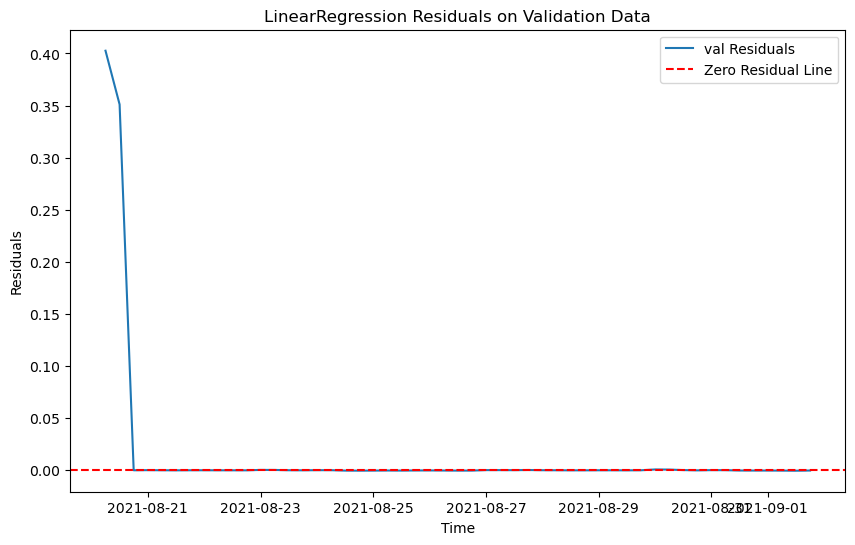

RMSE on training data for LinearRegression: 0.0016785318844774425
RMSE on validation data for LinearRegression: 0.07479262463707707
RMSE on test data for LinearRegression: 0.0026262274926906618

Best model is LinearRegression with RMSE: 0.07479262463707707
Best model saved as: models\model_103.pkl
data num 2
train_105.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.331318151184474e-10
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.577231885263625e-14
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

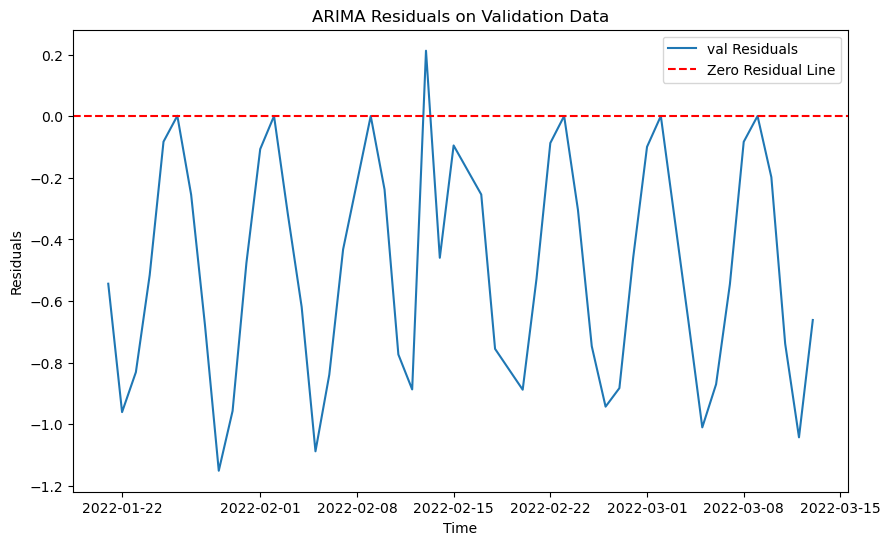

21:40:04 - cmdstanpy - INFO - Chain [1] start processing
21:40:04 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3062226659535955
RMSE on validation data for ARIMA: 0.6077163327674805
RMSE on test data for ARIMA: 0.6268333530678069


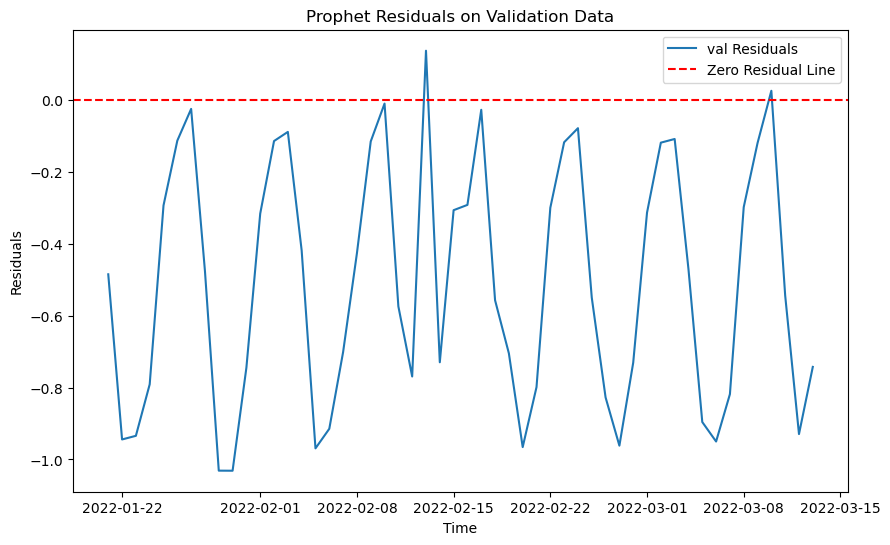

RMSE on training data for Prophet: 0.2978703719382203
RMSE on validation data for Prophet: 0.6126367896447981
RMSE on test data for Prophet: 0.7737332763149788


<Figure size 1000x800 with 0 Axes>

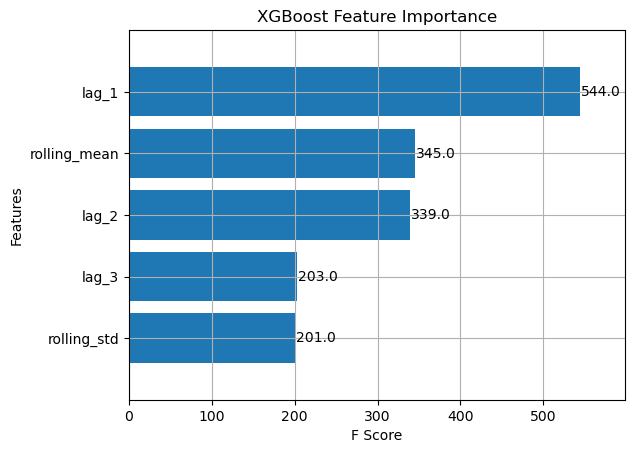

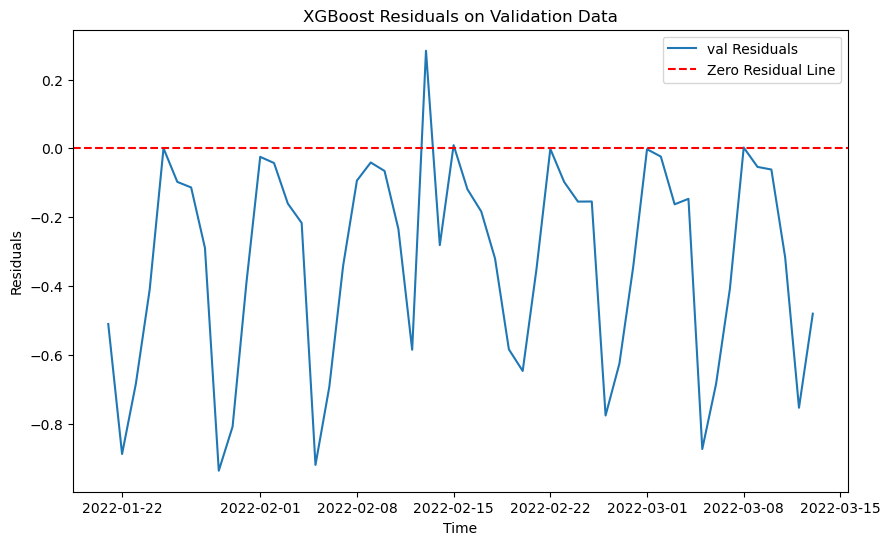

RMSE on training data for XGBoost: 0.010825204028705727
RMSE on validation data for XGBoost: 0.44127932529646535
RMSE on test data for XGBoost: 0.3794980466250357


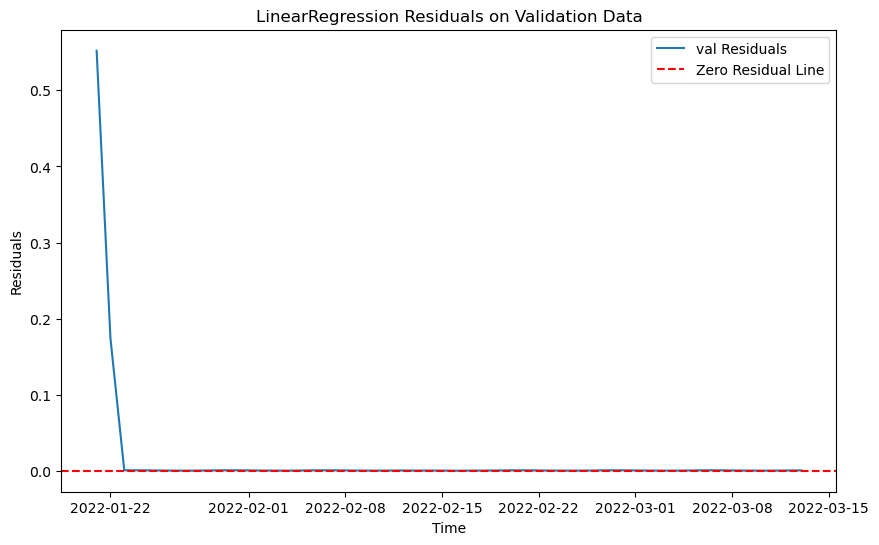

RMSE on training data for LinearRegression: 0.0005099977304703559
RMSE on validation data for LinearRegression: 0.08026620345267804
RMSE on test data for LinearRegression: 0.029636785912385322

Best model is LinearRegression with RMSE: 0.08026620345267804
Best model saved as: models\model_105.pkl
data num 3
train_110.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.872505470229485e-24
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.022931336577495e-19
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

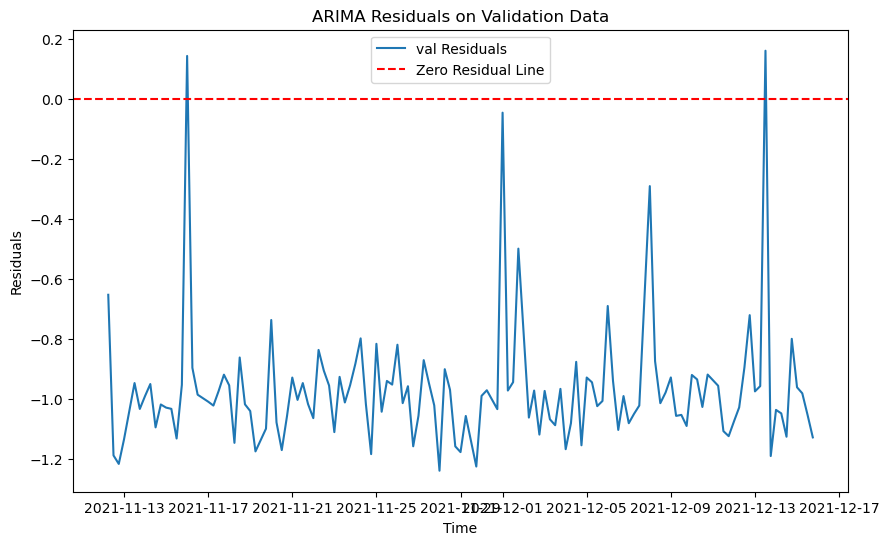

21:40:06 - cmdstanpy - INFO - Chain [1] start processing
21:40:06 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.35761828195565654
RMSE on validation data for ARIMA: 0.9899247424870447
RMSE on test data for ARIMA: 0.3975753741931487


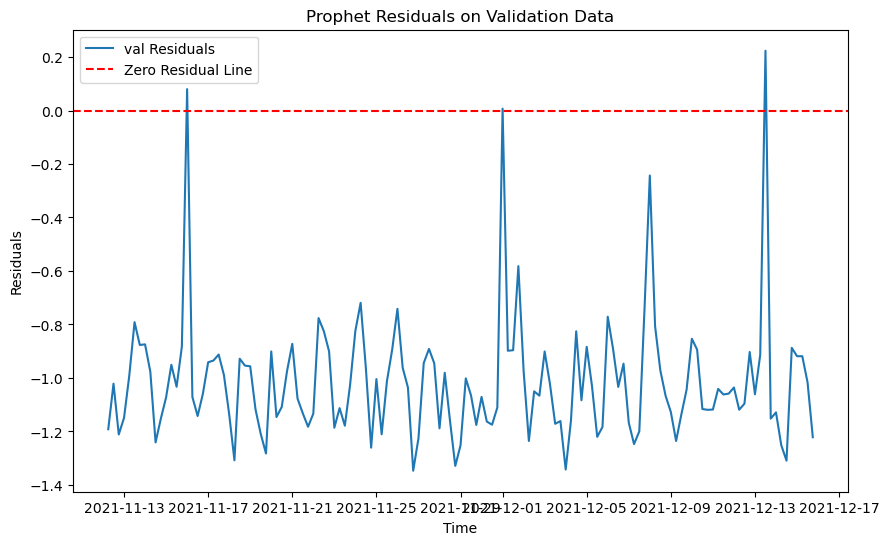

RMSE on training data for Prophet: 0.366568391067124
RMSE on validation data for Prophet: 1.0395488282189451
RMSE on test data for Prophet: 0.4110879441218985


<Figure size 1000x800 with 0 Axes>

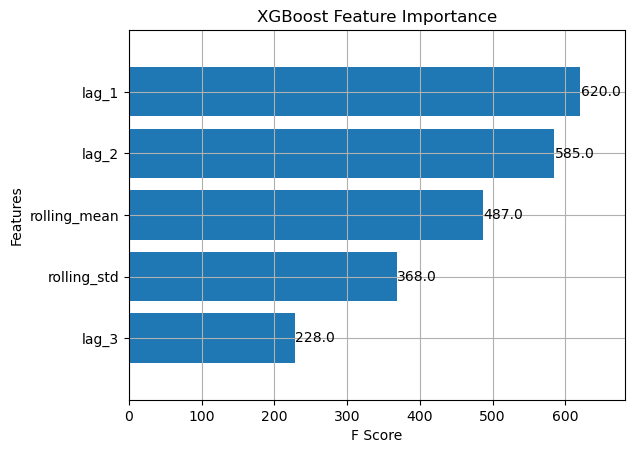

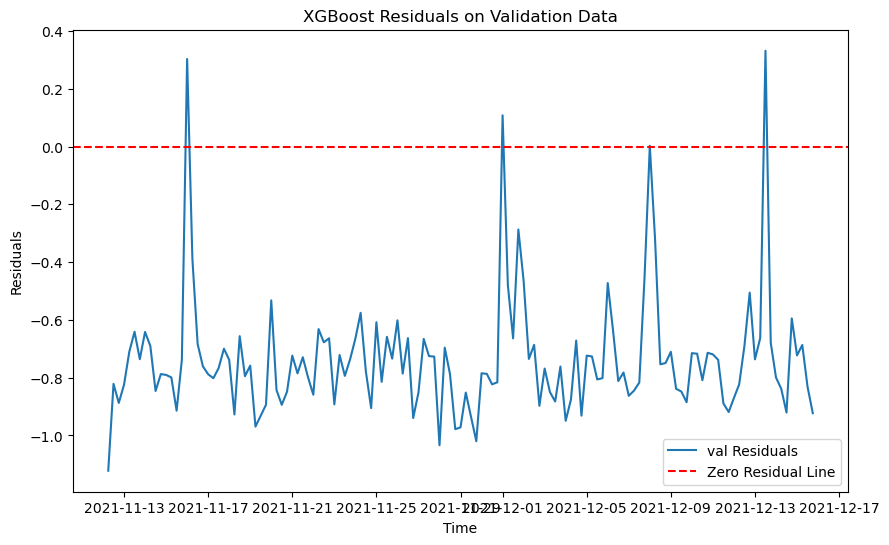

RMSE on training data for XGBoost: 0.025799862778054974
RMSE on validation data for XGBoost: 0.7652472647382583
RMSE on test data for XGBoost: 0.15942704893917678


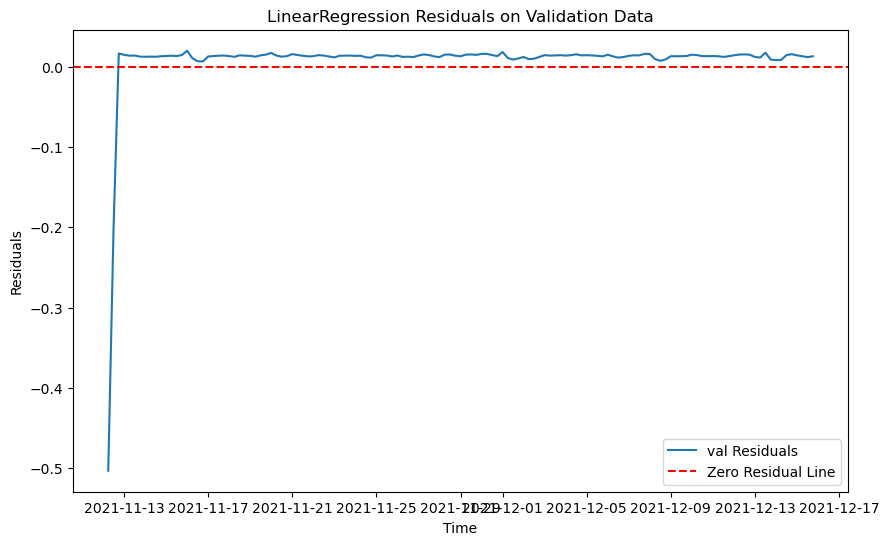

RMSE on training data for LinearRegression: 0.034805391278009995
RMSE on validation data for LinearRegression: 0.04864079865470018
RMSE on test data for LinearRegression: 0.011619308370854602

Best model is LinearRegression with RMSE: 0.04864079865470018
Best model saved as: models\model_110.pkl
data num 4
train_115.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.6229245283021666e-26
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.0826313760074208e-10
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.006675658476019e-15
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

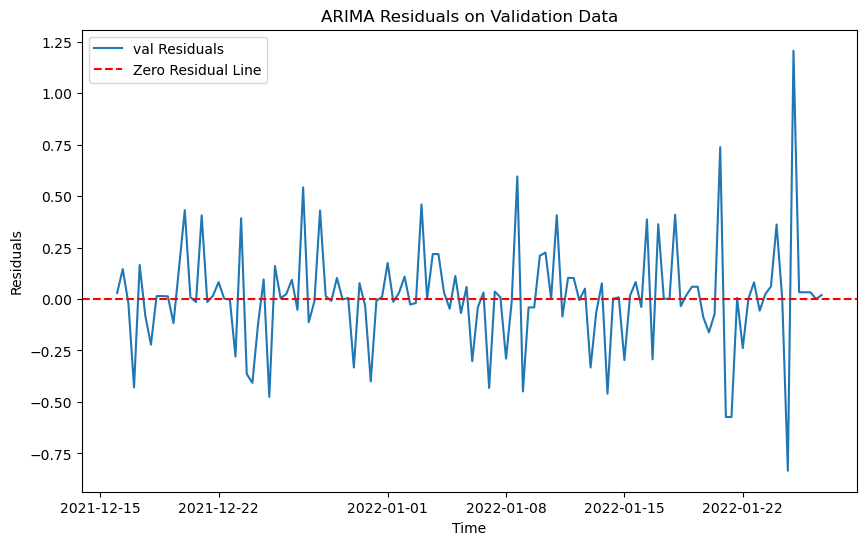

21:40:08 - cmdstanpy - INFO - Chain [1] start processing
21:40:08 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2743838182026247
RMSE on validation data for ARIMA: 0.25894666475968775
RMSE on test data for ARIMA: 0.2569331795259362


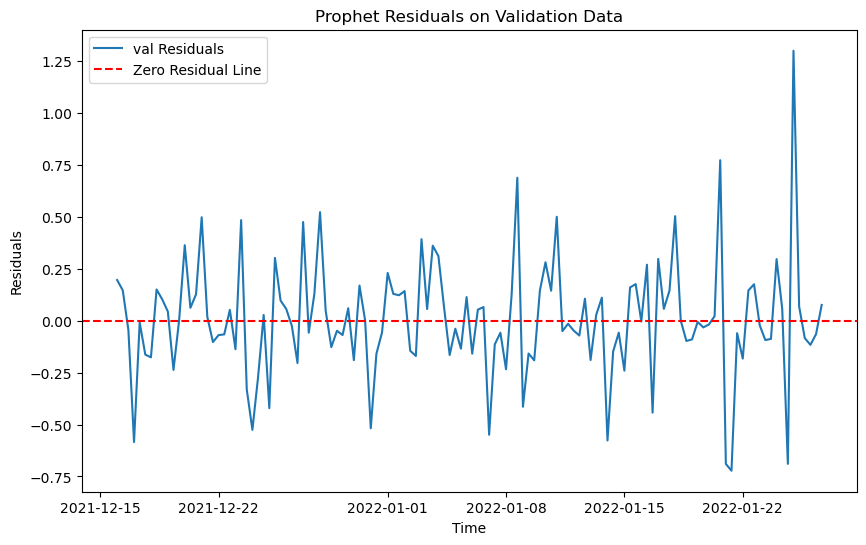

RMSE on training data for Prophet: 0.2795825452561712
RMSE on validation data for Prophet: 0.2848920635720826
RMSE on test data for Prophet: 0.27309793053898124


<Figure size 1000x800 with 0 Axes>

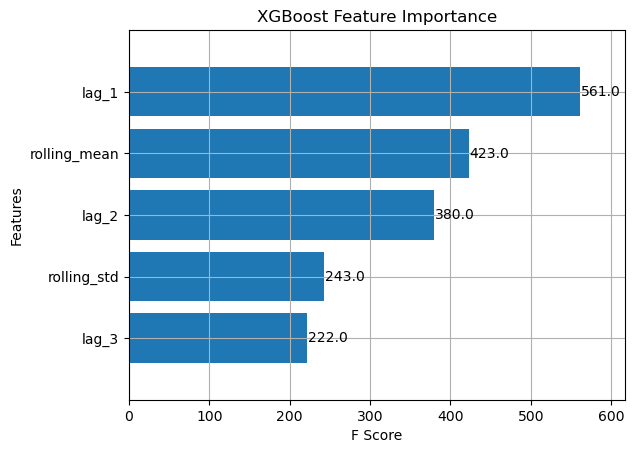

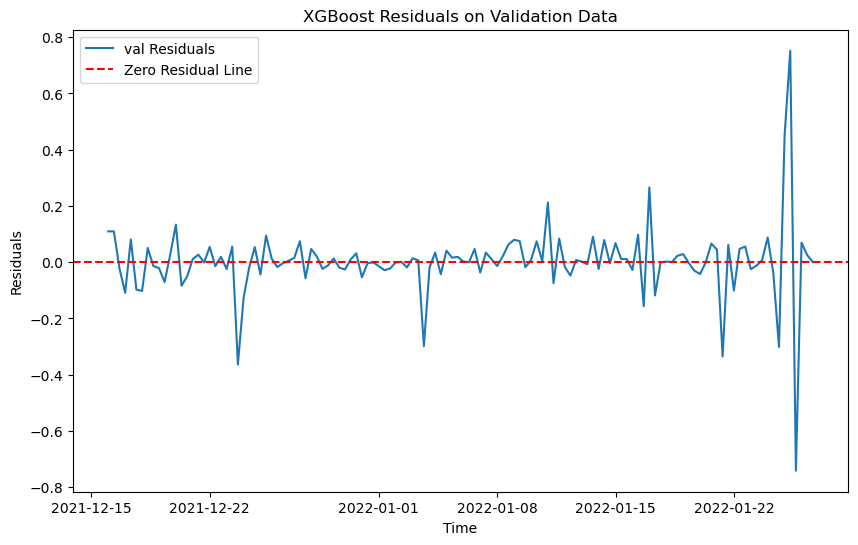

RMSE on training data for XGBoost: 0.016105530441622284
RMSE on validation data for XGBoost: 0.13156061386056936
RMSE on test data for XGBoost: 0.17004253453262244


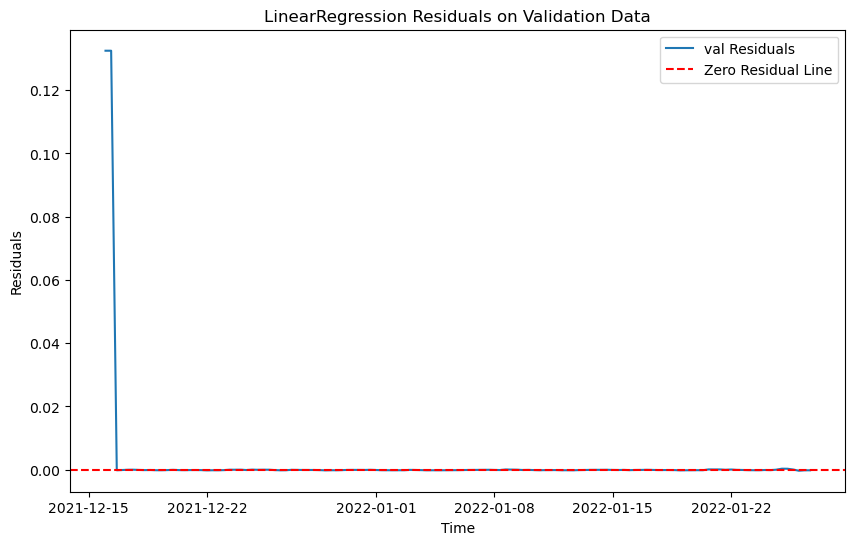

RMSE on training data for LinearRegression: 0.001448027209739995
RMSE on validation data for LinearRegression: 0.016692042030830148
RMSE on test data for LinearRegression: 0.017034488106679218

Best model is LinearRegression with RMSE: 0.016692042030830148
Best model saved as: models\model_115.pkl
data num 5
train_118.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive 

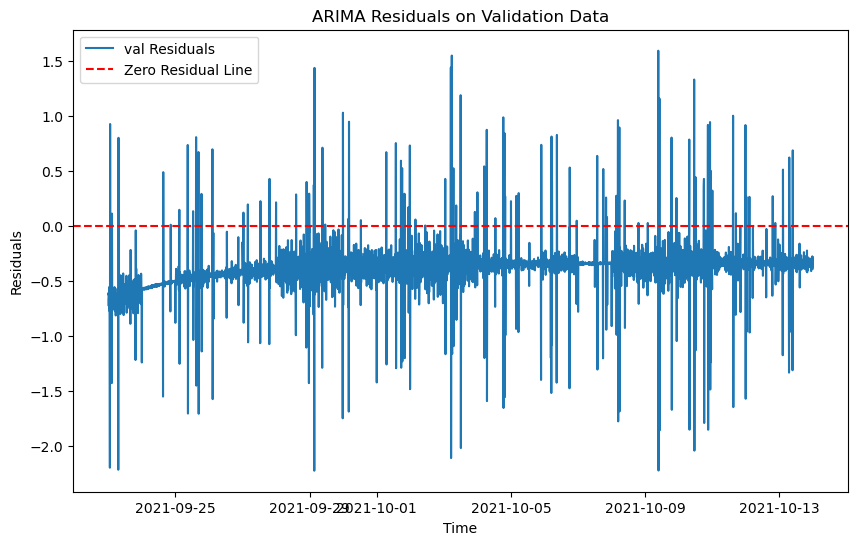

RMSE on training data for ARIMA: 0.2056154235187551
RMSE on validation data for ARIMA: 0.46800219780754126
RMSE on test data for ARIMA: 0.8542670496923991


21:40:23 - cmdstanpy - INFO - Chain [1] start processing
21:40:24 - cmdstanpy - INFO - Chain [1] done processing


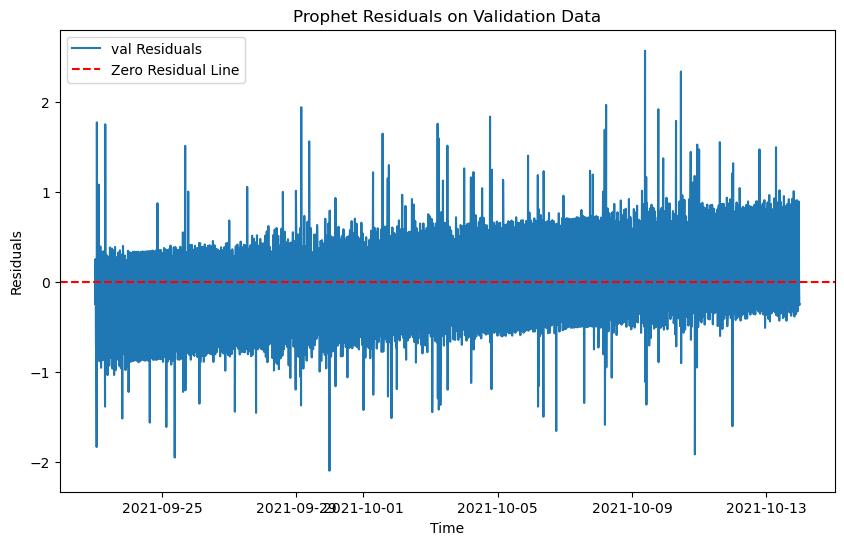

RMSE on training data for Prophet: 0.2215965282815207
RMSE on validation data for Prophet: 0.5382049762053792
RMSE on test data for Prophet: 0.763495415752379


<Figure size 1000x800 with 0 Axes>

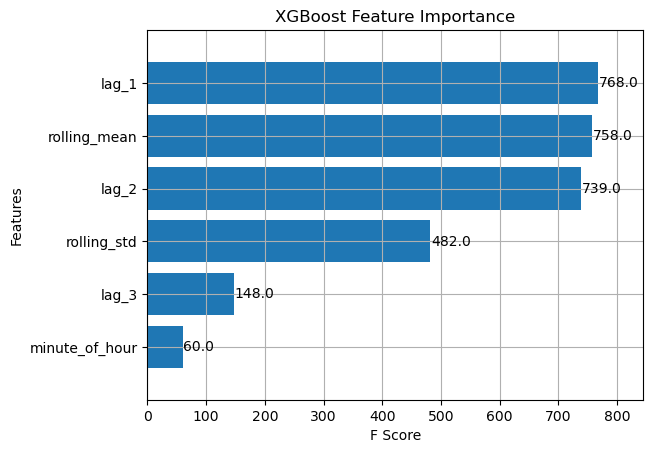

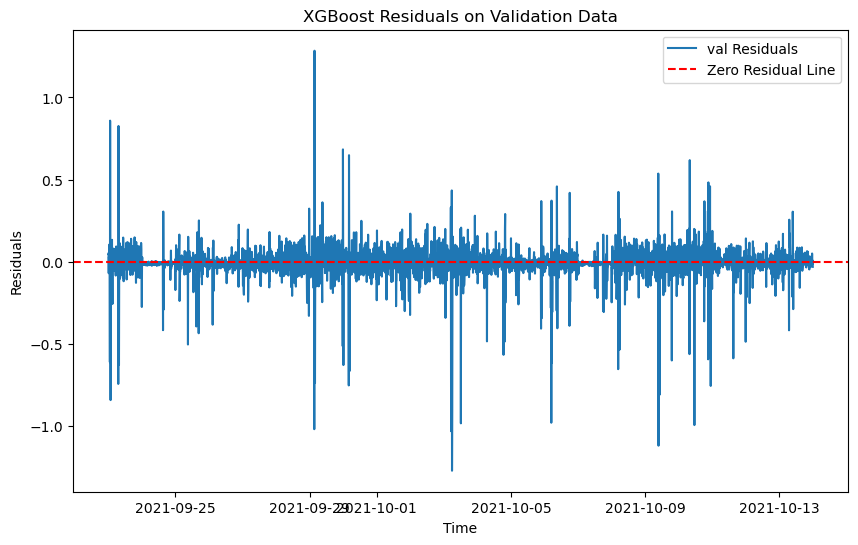

RMSE on training data for XGBoost: 0.02981622481695051
RMSE on validation data for XGBoost: 0.11618089875793339
RMSE on test data for XGBoost: 0.2783790802592247


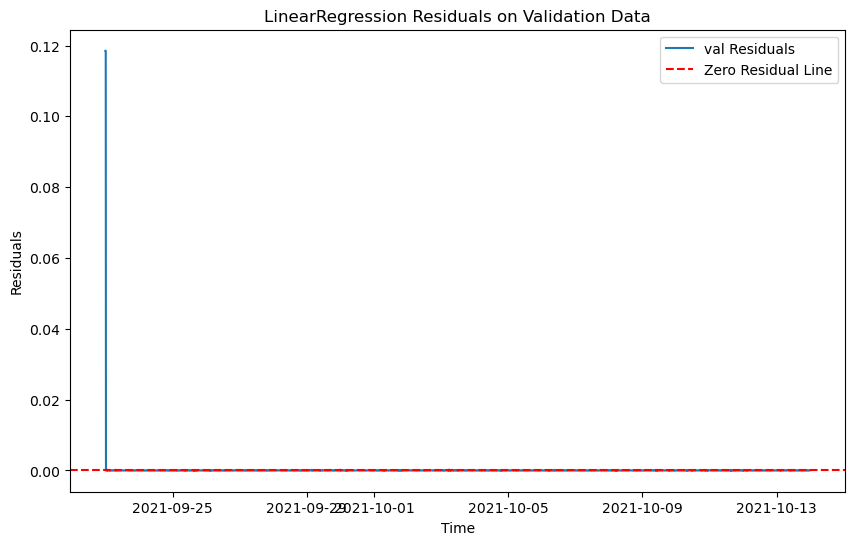

RMSE on training data for LinearRegression: 0.001464812560976091
RMSE on validation data for LinearRegression: 0.003048341363850971
RMSE on test data for LinearRegression: 4.010220235710402e-05

Best model is LinearRegression with RMSE: 0.003048341363850971
Best model saved as: models\model_118.pkl
data num 6
train_119.csv
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.6474352315036197e-11
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

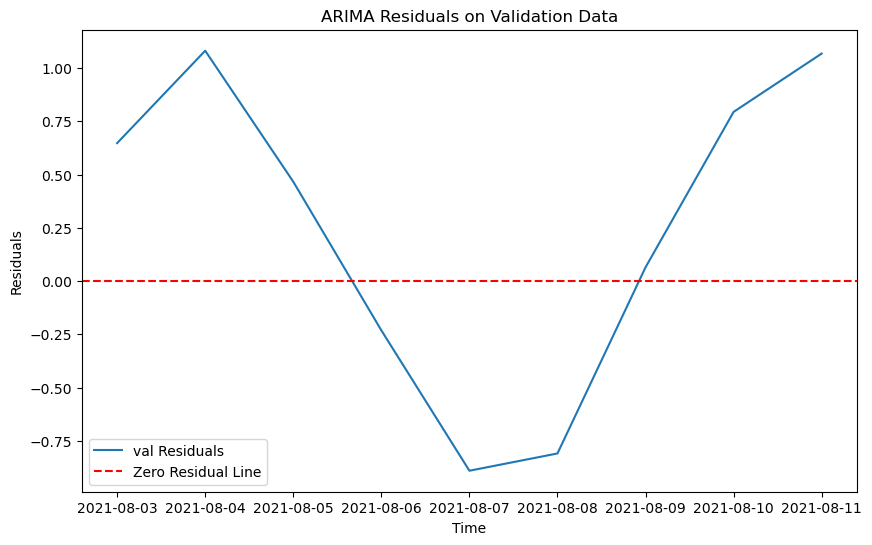

21:40:32 - cmdstanpy - INFO - Chain [1] start processing
21:40:32 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.5325917152882206
RMSE on validation data for ARIMA: 0.7515595020993794
RMSE on test data for ARIMA: 0.5982832585925209


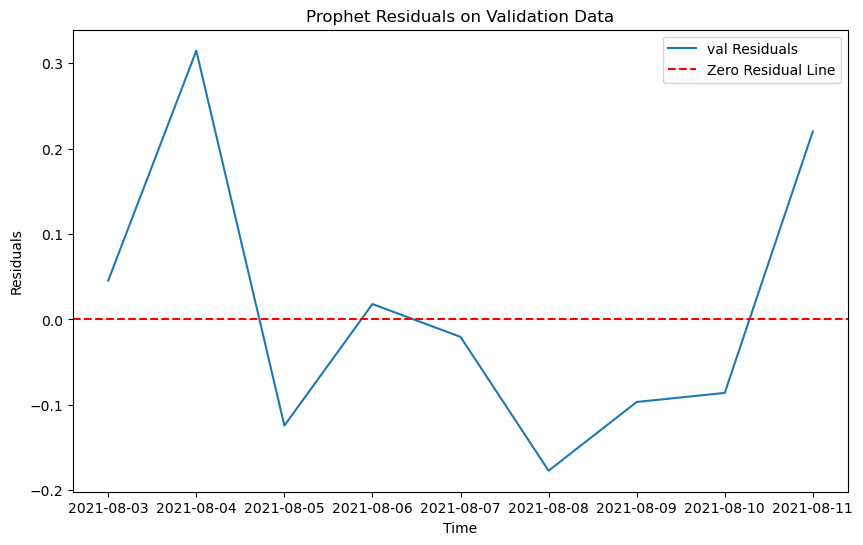

RMSE on training data for Prophet: 0.27211232094642196
RMSE on validation data for Prophet: 0.1541049679250987
RMSE on test data for Prophet: 1.2293390723651125


<Figure size 1000x800 with 0 Axes>

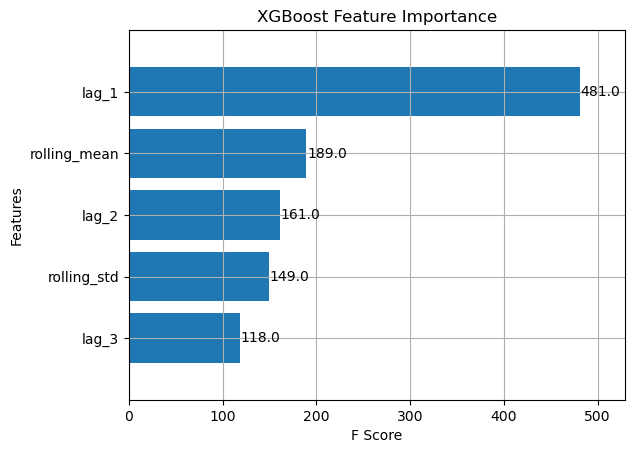

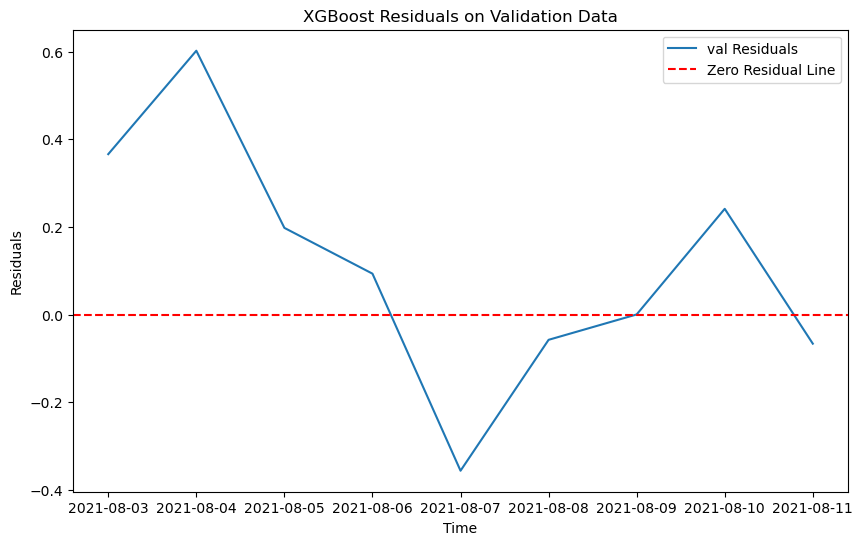

RMSE on training data for XGBoost: 0.11369572871538204
RMSE on validation data for XGBoost: 0.28627989417389504
RMSE on test data for XGBoost: 0.4794189561412173


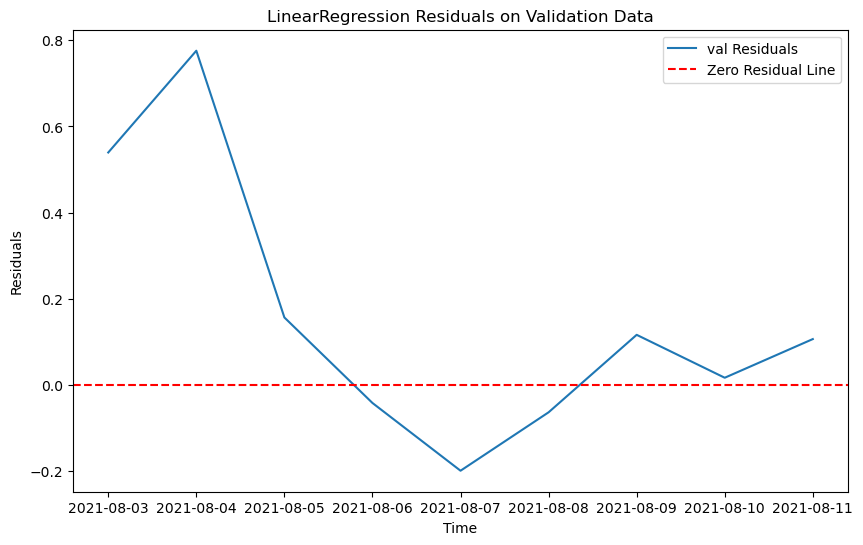

RMSE on training data for LinearRegression: 0.3443990210522278
RMSE on validation data for LinearRegression: 0.33128957472249504
RMSE on test data for LinearRegression: 0.15123103773756016

Best model is Prophet with RMSE: 0.1541049679250987
Best model saved as: models\model_119.pkl
data num 7
train_12.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


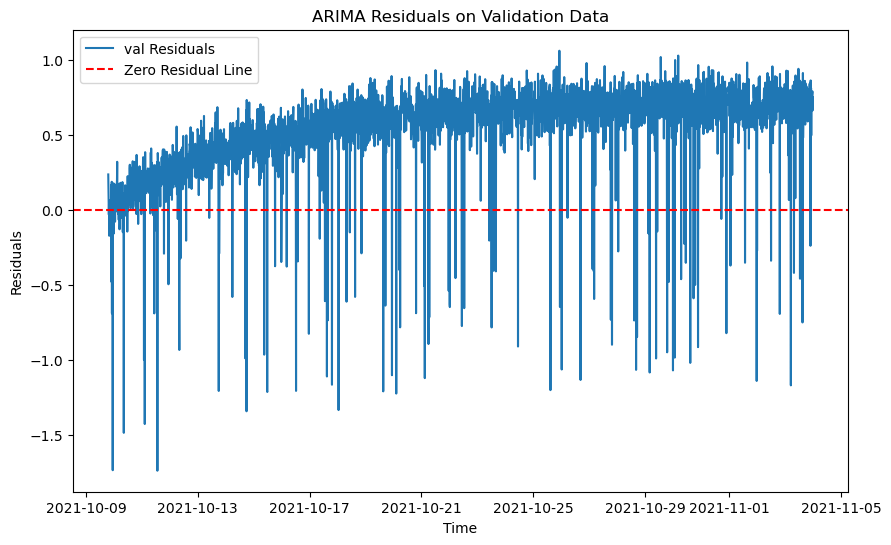

RMSE on training data for ARIMA: 0.2174104552728966
RMSE on validation data for ARIMA: 0.6192033548821393
RMSE on test data for ARIMA: 0.678125970429564


21:40:39 - cmdstanpy - INFO - Chain [1] start processing
21:40:41 - cmdstanpy - INFO - Chain [1] done processing


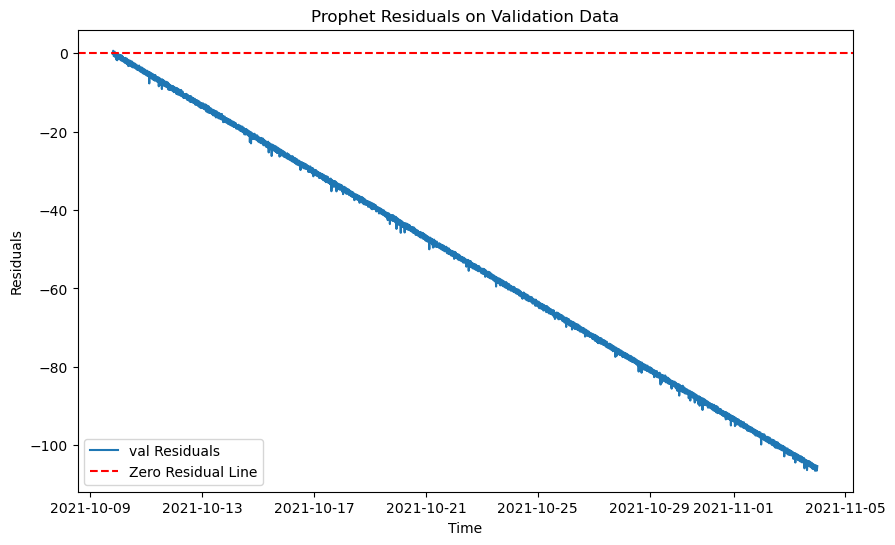

RMSE on training data for Prophet: 0.2898160146256992
RMSE on validation data for Prophet: 61.231517186390555
RMSE on test data for Prophet: 131.21676712820894


<Figure size 1000x800 with 0 Axes>

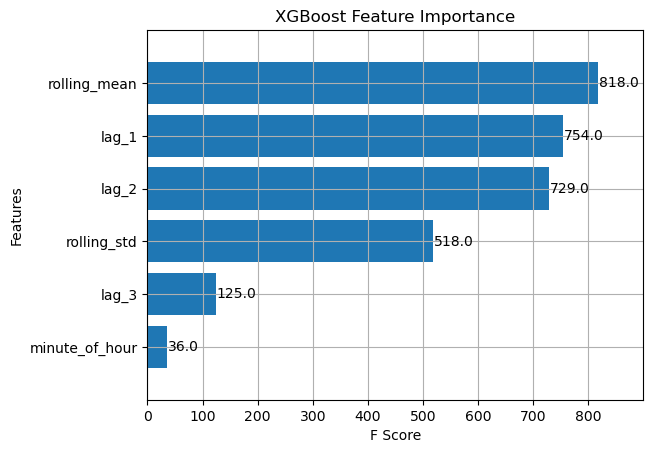

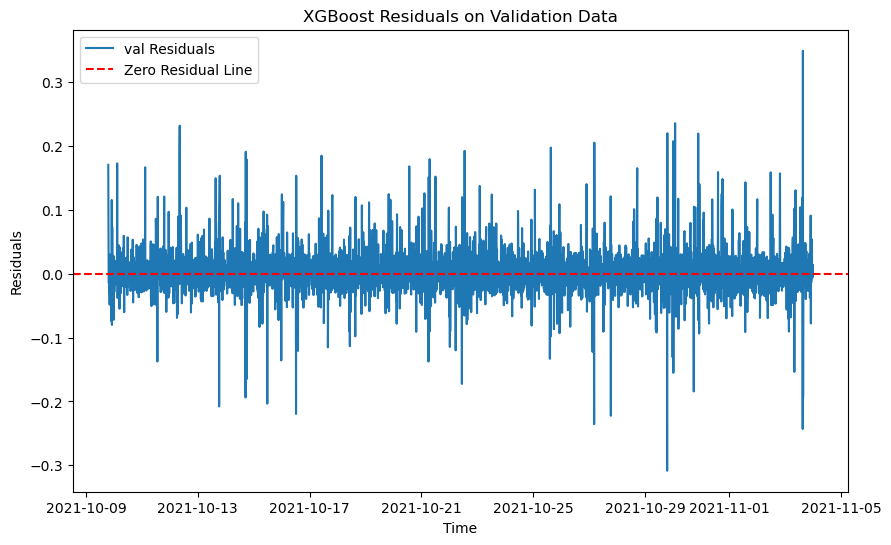

RMSE on training data for XGBoost: 0.03548411307614848
RMSE on validation data for XGBoost: 0.03786249373689107
RMSE on test data for XGBoost: 0.04443409935564445


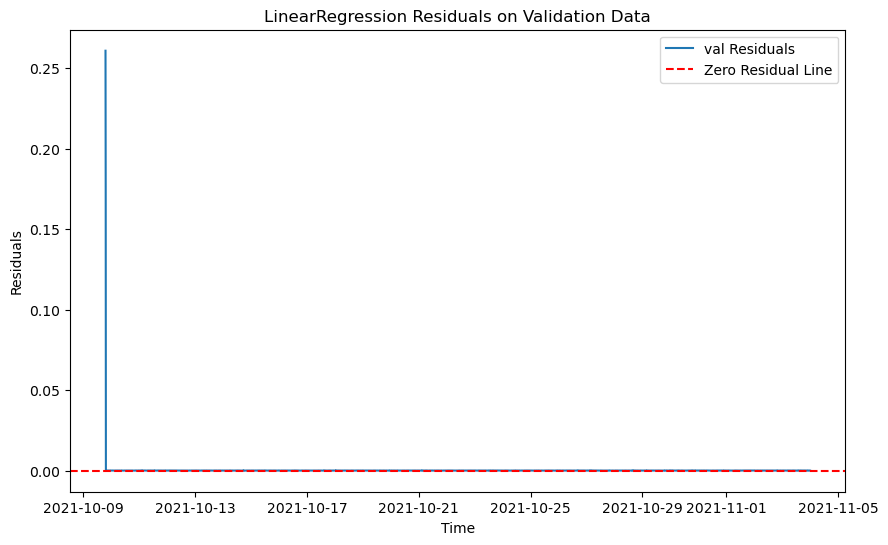

RMSE on training data for LinearRegression: 0.0014055237127465476
RMSE on validation data for LinearRegression: 0.005228039952364157
RMSE on test data for LinearRegression: 0.020289621951189253

Best model is LinearRegression with RMSE: 0.005228039952364157
Best model saved as: models\model_12.pkl
data num 8
train_131.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 1.1679070346539543e-26
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


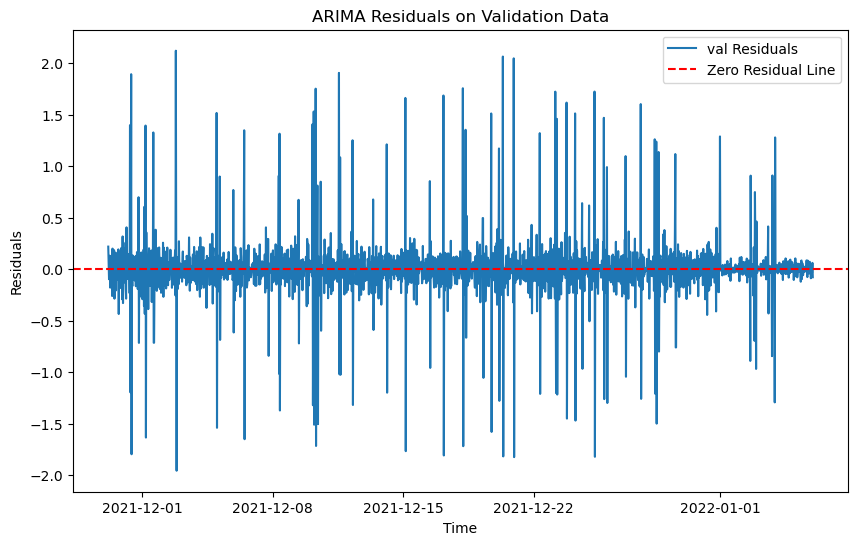

RMSE on training data for ARIMA: 0.2268457642097416
RMSE on validation data for ARIMA: 0.3479811770585257
RMSE on test data for ARIMA: 0.2958568915739024


21:40:56 - cmdstanpy - INFO - Chain [1] start processing
21:40:57 - cmdstanpy - INFO - Chain [1] done processing


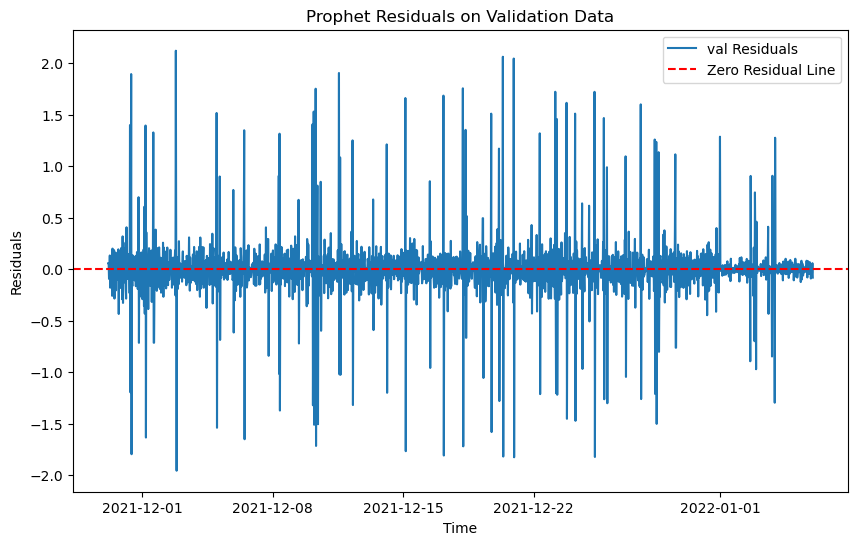

RMSE on training data for Prophet: 0.305841055223731
RMSE on validation data for Prophet: 0.34795107850527307
RMSE on test data for Prophet: 0.2958973159297588


<Figure size 1000x800 with 0 Axes>

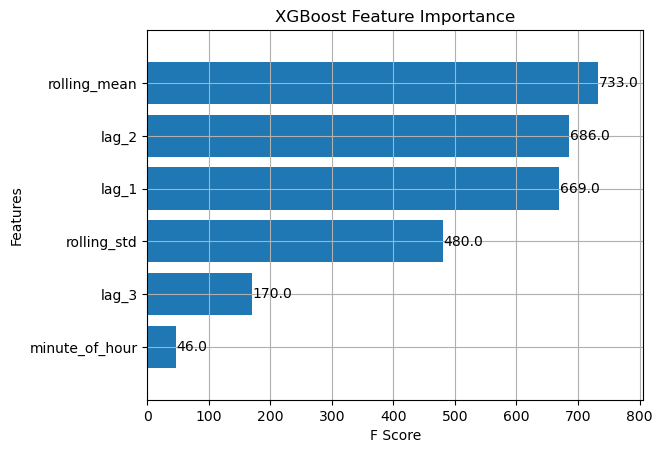

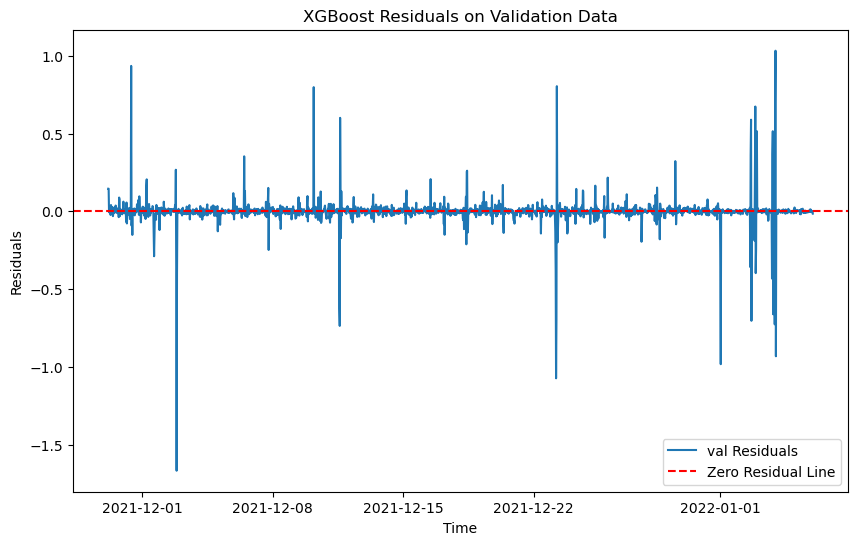

RMSE on training data for XGBoost: 0.020680434468826156
RMSE on validation data for XGBoost: 0.09989099278809556
RMSE on test data for XGBoost: 0.2557352814568325


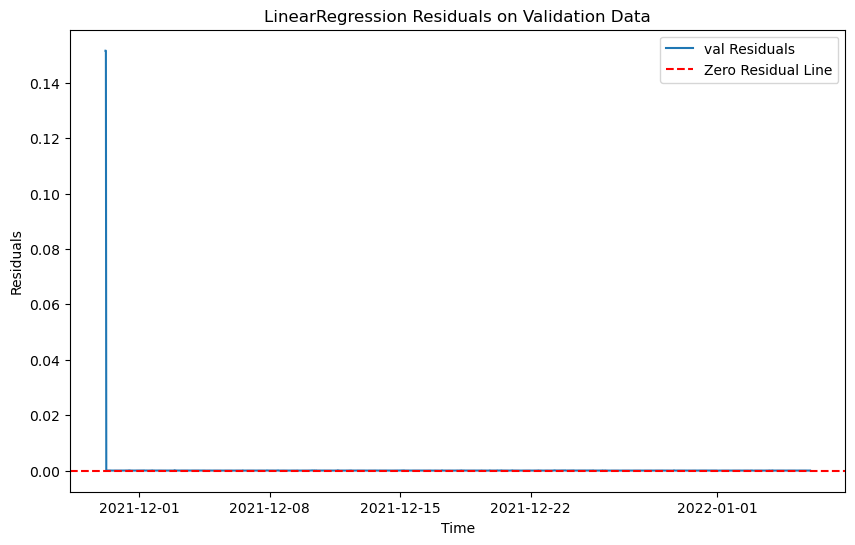

RMSE on training data for LinearRegression: 0.0004711638044382445
RMSE on validation data for LinearRegression: 0.005031697537891921
RMSE on test data for LinearRegression: 0.004667605960959944

Best model is LinearRegression with RMSE: 0.005031697537891921
Best model saved as: models\model_131.pkl
data num 9
train_141.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.5722228612801715e-22
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.3299980730924183e-21
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

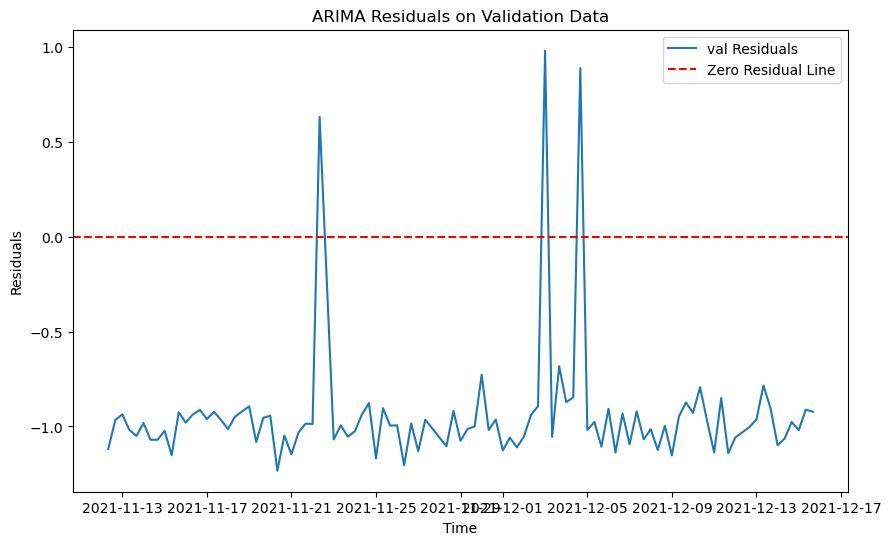

21:41:02 - cmdstanpy - INFO - Chain [1] start processing
21:41:02 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2344032884558796
RMSE on validation data for ARIMA: 0.9938944959079901
RMSE on test data for ARIMA: 0.28190474227643825


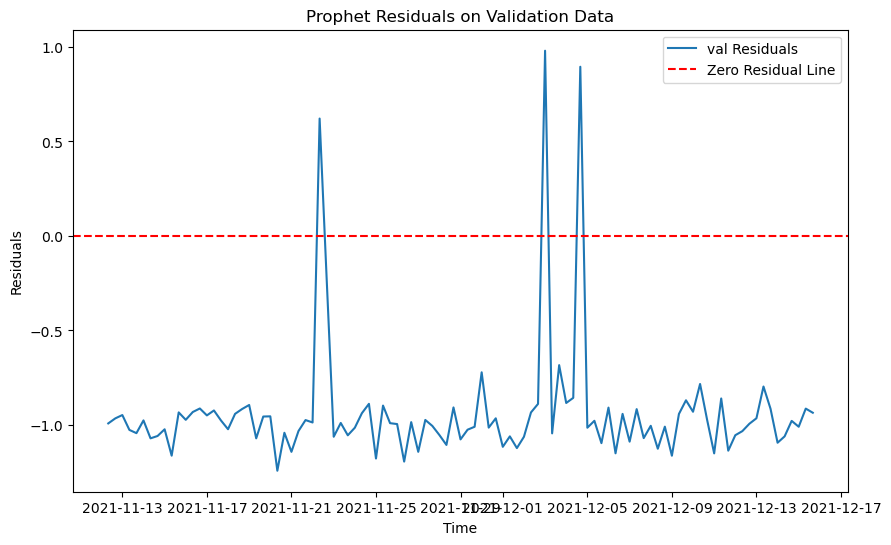

RMSE on training data for Prophet: 0.3100206229547175
RMSE on validation data for Prophet: 0.993077873605992
RMSE on test data for Prophet: 0.2810043111742809


<Figure size 1000x800 with 0 Axes>

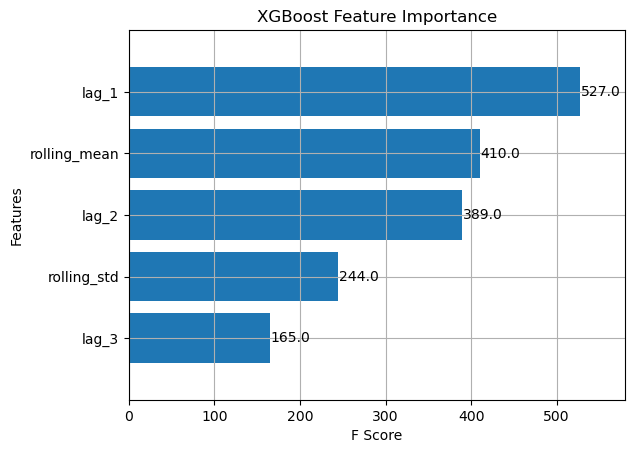

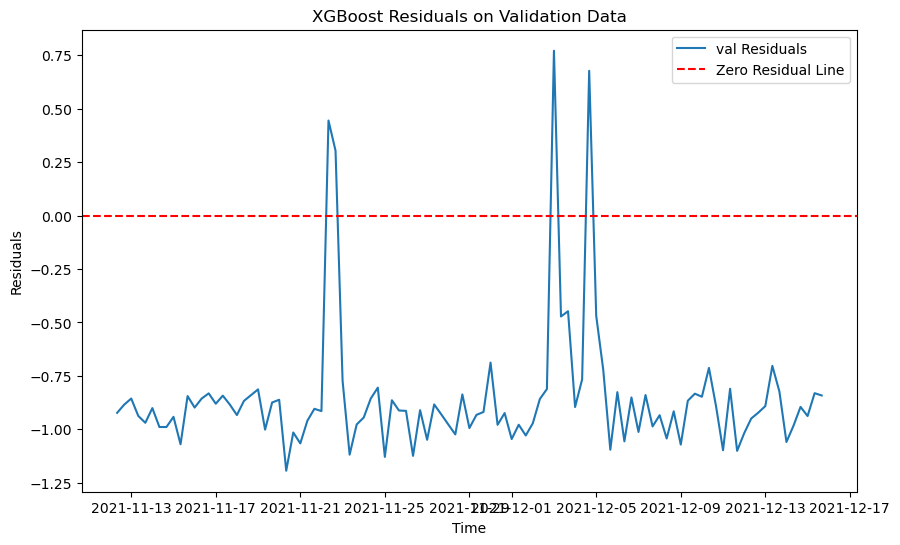

RMSE on training data for XGBoost: 0.013364333099294386
RMSE on validation data for XGBoost: 0.9085415602352396
RMSE on test data for XGBoost: 0.291529069826291


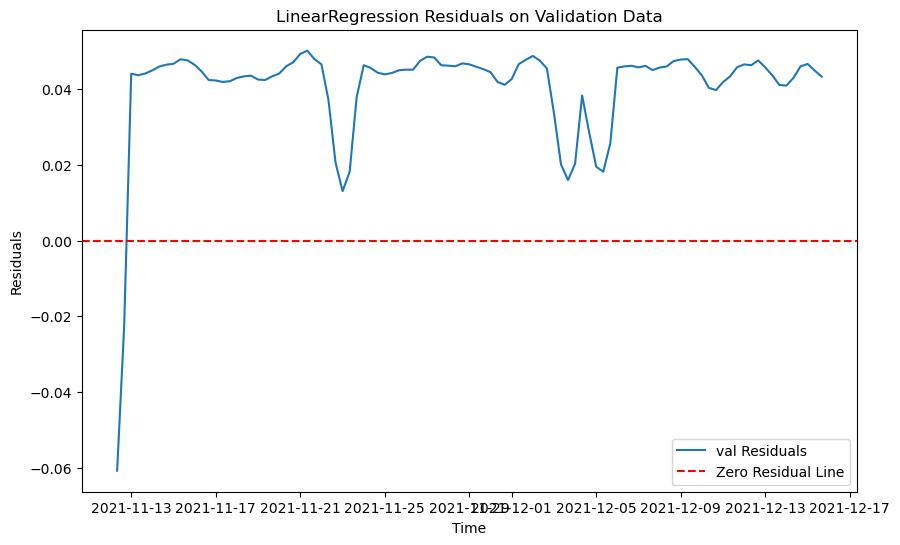

RMSE on training data for LinearRegression: 0.01646434084474432
RMSE on validation data for LinearRegression: 0.04316079821984053
RMSE on test data for LinearRegression: 0.029158187242886865

Best model is LinearRegression with RMSE: 0.04316079821984053
Best model saved as: models\model_141.pkl
data num 10
train_151.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.088575527262519e-20
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.4082278278763527e-09
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.4541230077620053e-11
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

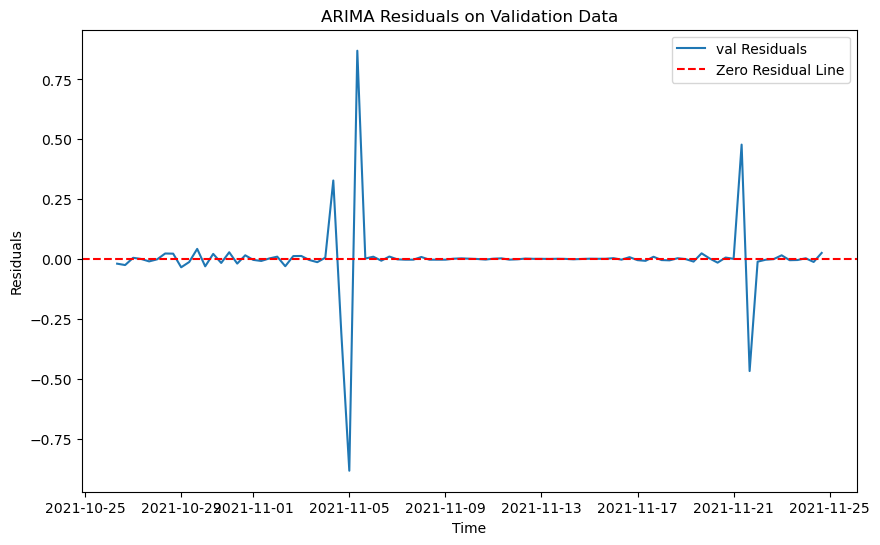

21:41:04 - cmdstanpy - INFO - Chain [1] start processing
21:41:04 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2102976808258601
RMSE on validation data for ARIMA: 0.1571684026593518
RMSE on test data for ARIMA: 0.2642281427385585


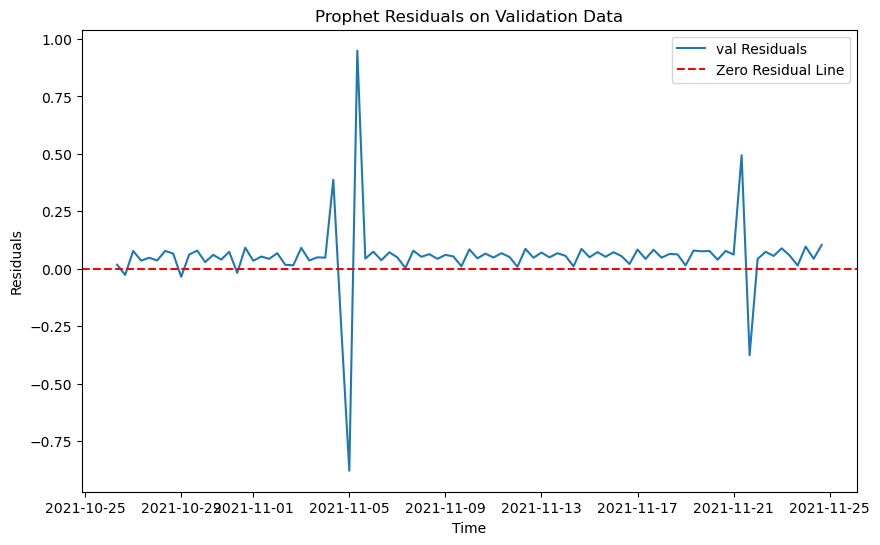

RMSE on training data for Prophet: 0.26746944061215644
RMSE on validation data for Prophet: 0.16986733023865538
RMSE on test data for Prophet: 0.27658798346313296


<Figure size 1000x800 with 0 Axes>

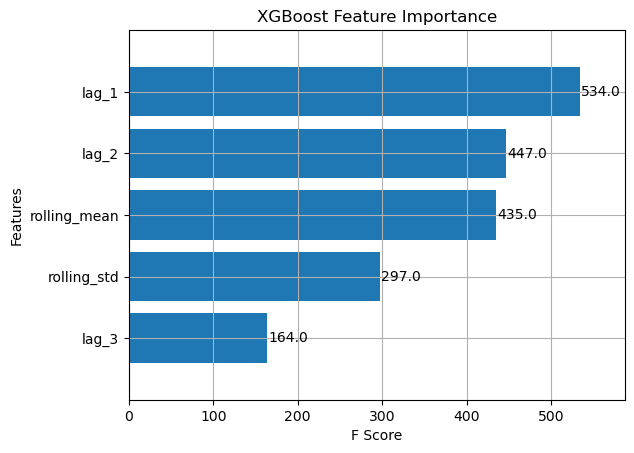

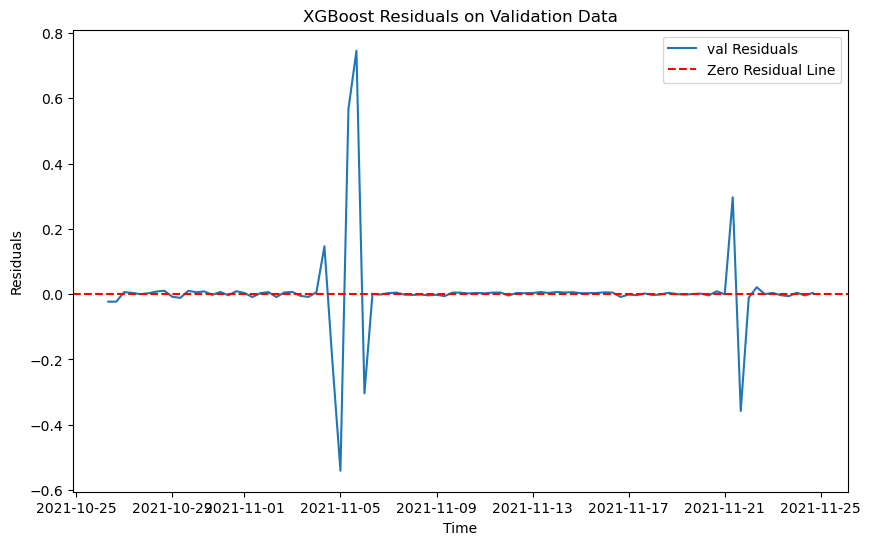

RMSE on training data for XGBoost: 0.0887490100155209
RMSE on validation data for XGBoost: 0.13185902519961093
RMSE on test data for XGBoost: 0.25179476488761215


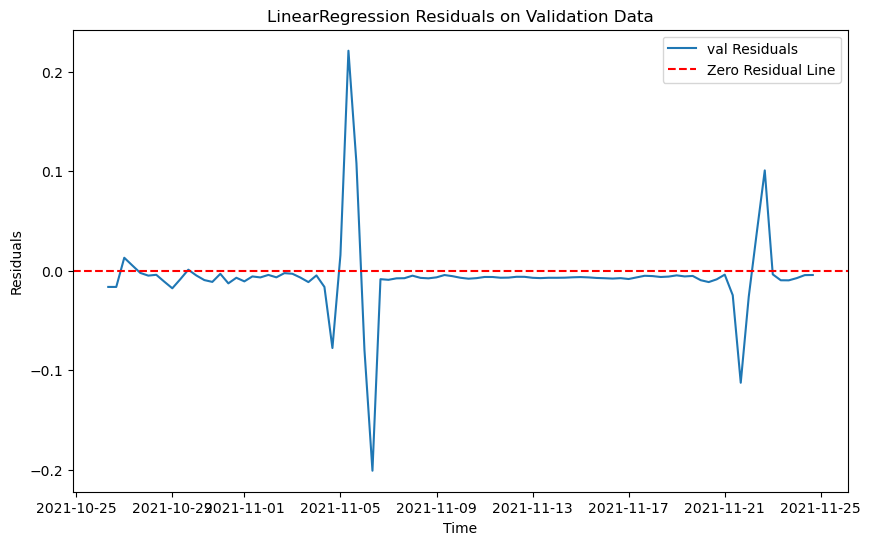

RMSE on training data for LinearRegression: 0.12279097081402338
RMSE on validation data for LinearRegression: 0.04021272726859086
RMSE on test data for LinearRegression: 0.06992935375749343

Best model is LinearRegression with RMSE: 0.04021272726859086
Best model saved as: models\model_151.pkl
data num 11
train_153.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.0776802772479312e-12
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.7716559336733767e-17
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

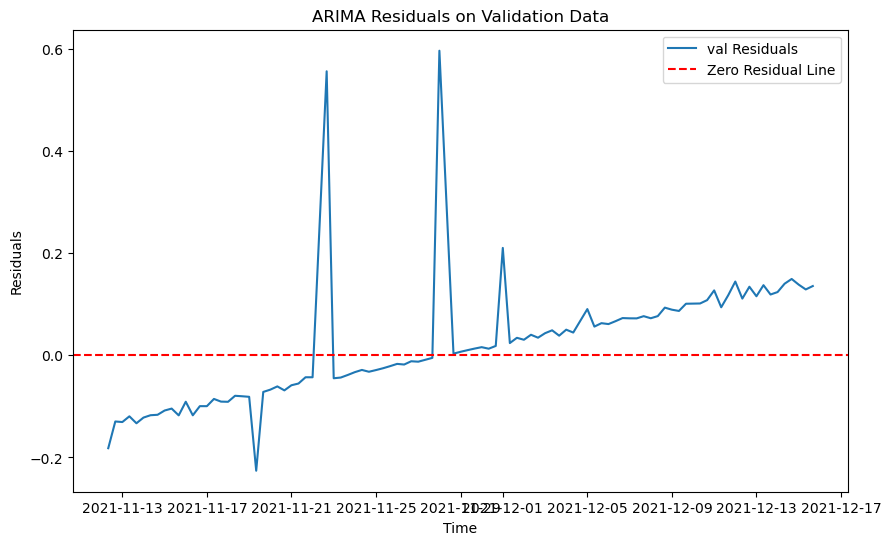

21:41:06 - cmdstanpy - INFO - Chain [1] start processing
21:41:06 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.1865953247106351
RMSE on validation data for ARIMA: 0.12641499985873877
RMSE on test data for ARIMA: 0.2591420804008397


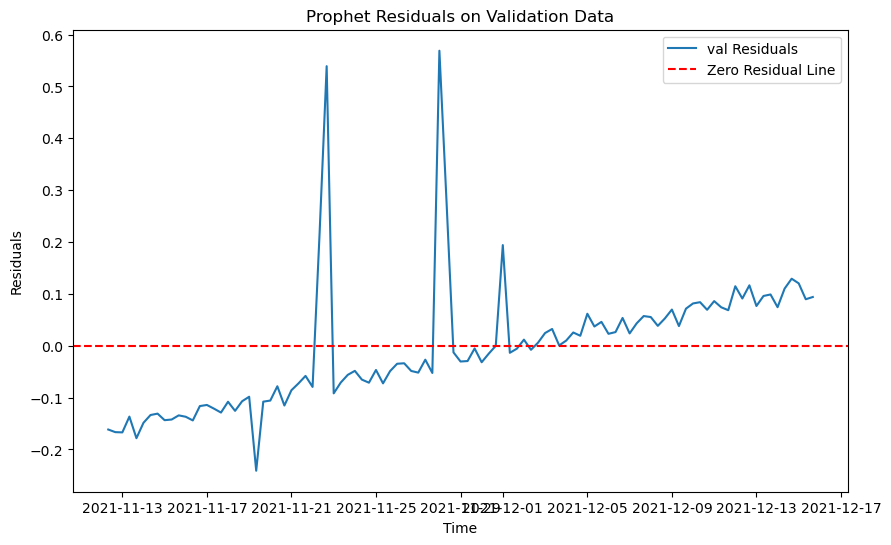

RMSE on training data for Prophet: 0.25286331902601067
RMSE on validation data for Prophet: 0.12383443147458532
RMSE on test data for Prophet: 0.26129044746690006


<Figure size 1000x800 with 0 Axes>

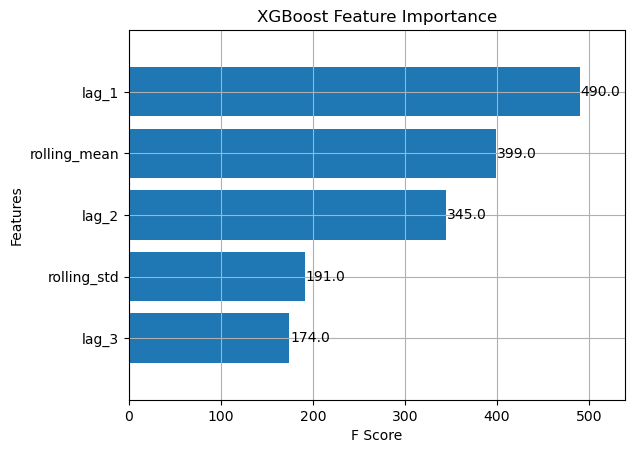

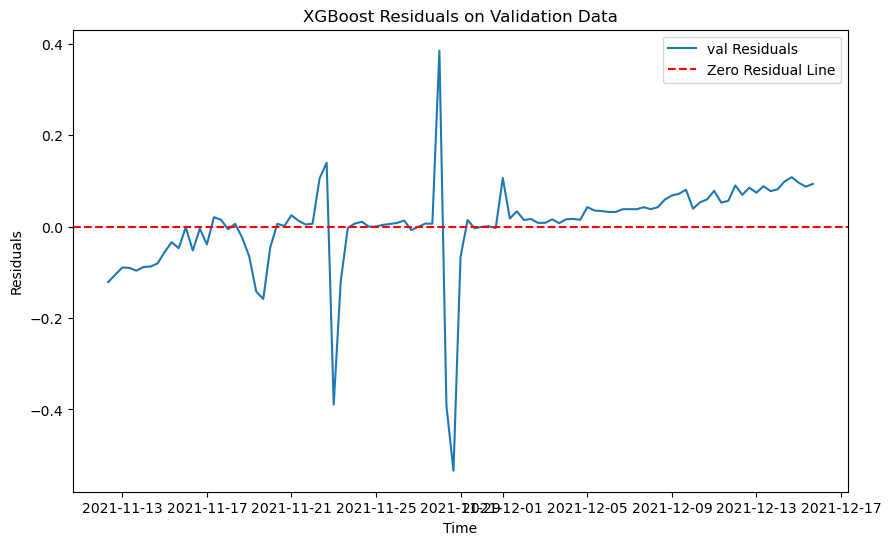

RMSE on training data for XGBoost: 0.008543313808835759
RMSE on validation data for XGBoost: 0.10393497884004202
RMSE on test data for XGBoost: 0.24414333606140412


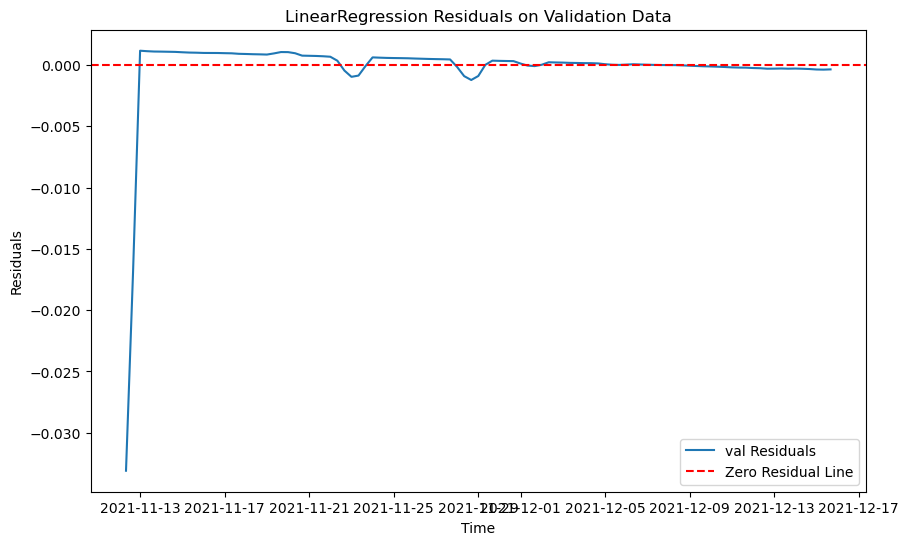

RMSE on training data for LinearRegression: 0.0050909753278867475
RMSE on validation data for LinearRegression: 0.003745430846776722
RMSE on test data for LinearRegression: 0.002208766087681691

Best model is LinearRegression with RMSE: 0.003745430846776722
Best model saved as: models\model_153.pkl
data num 12
train_155.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 4.4965227706509085e-29
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to co

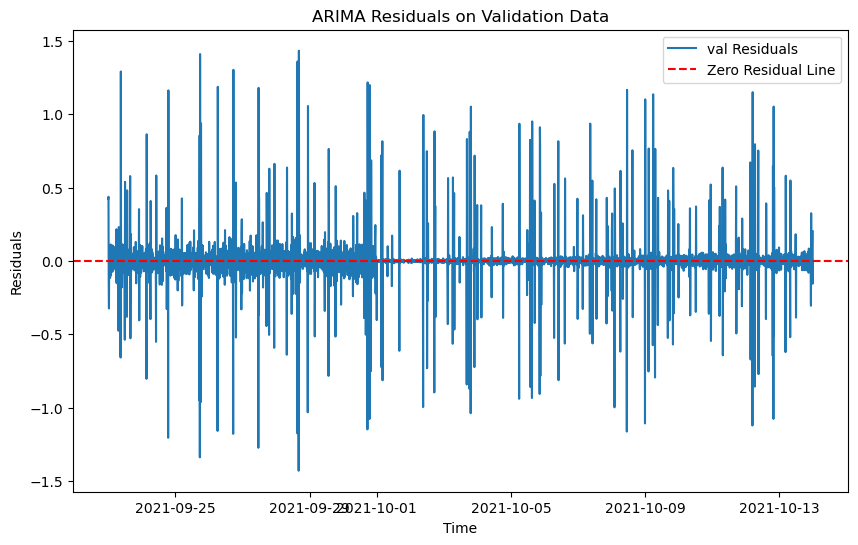

RMSE on training data for ARIMA: 0.1691298499477293
RMSE on validation data for ARIMA: 0.19819069322556687
RMSE on test data for ARIMA: 0.2844691147339282


21:41:28 - cmdstanpy - INFO - Chain [1] start processing
21:41:29 - cmdstanpy - INFO - Chain [1] done processing


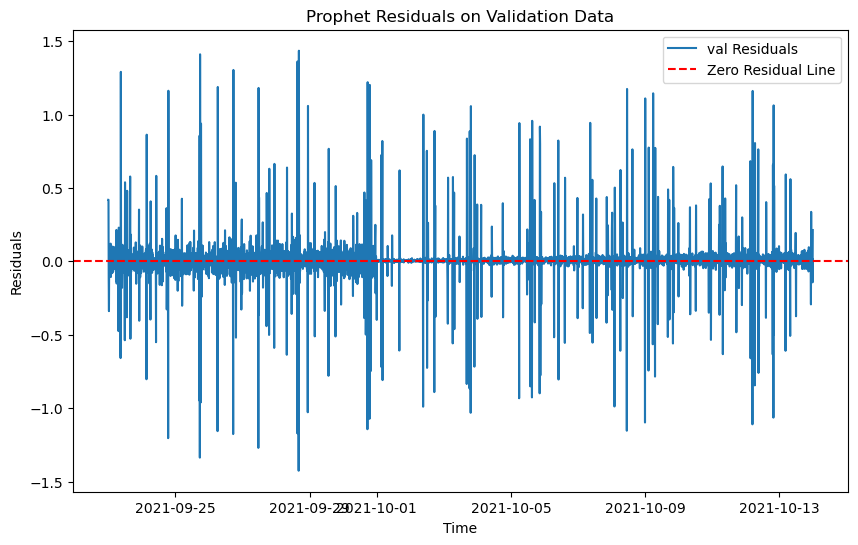

RMSE on training data for Prophet: 0.23289254507307997
RMSE on validation data for Prophet: 0.1983029214688241
RMSE on test data for Prophet: 0.28489073172644297


<Figure size 1000x800 with 0 Axes>

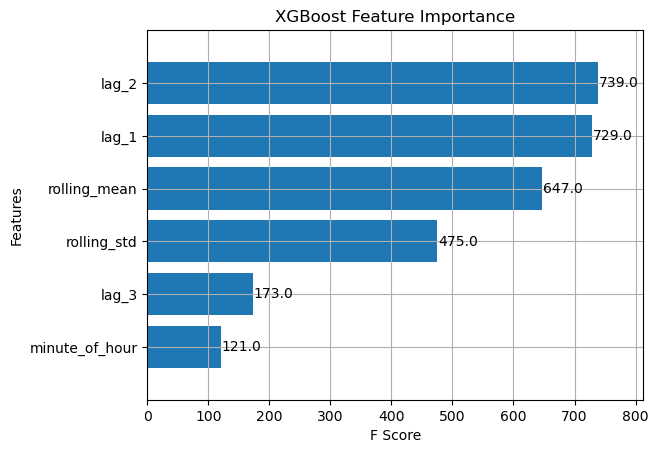

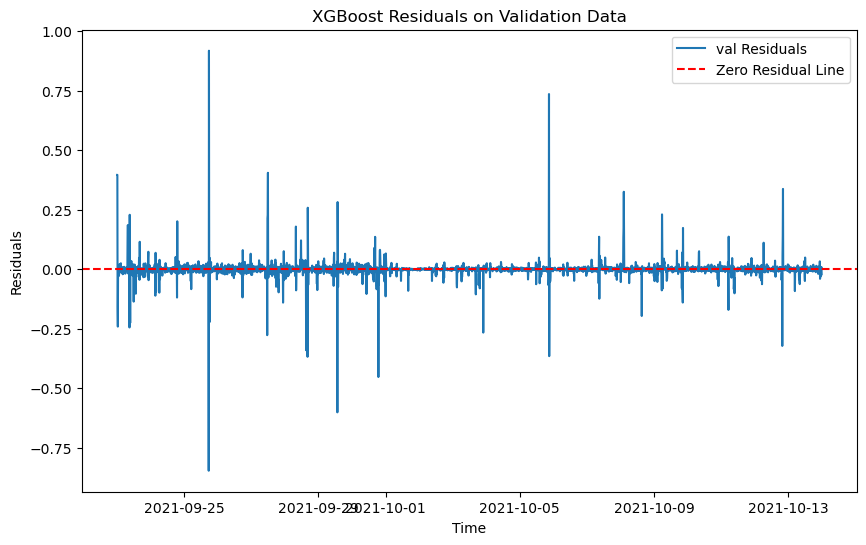

RMSE on training data for XGBoost: 0.019186178069653528
RMSE on validation data for XGBoost: 0.04445090445730373
RMSE on test data for XGBoost: 0.10630950171751187


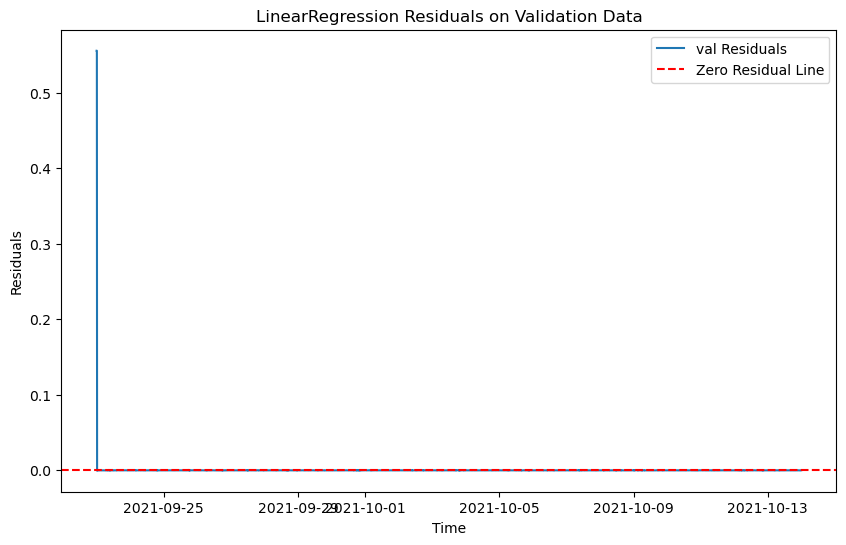

RMSE on training data for LinearRegression: 0.0020299835571481227
RMSE on validation data for LinearRegression: 0.014285503319211433
RMSE on test data for LinearRegression: 0.0013903388124942037

Best model is LinearRegression with RMSE: 0.014285503319211433
Best model saved as: models\model_155.pkl
data num 13
train_161.csv
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

New p-value after differencing: 0.0
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


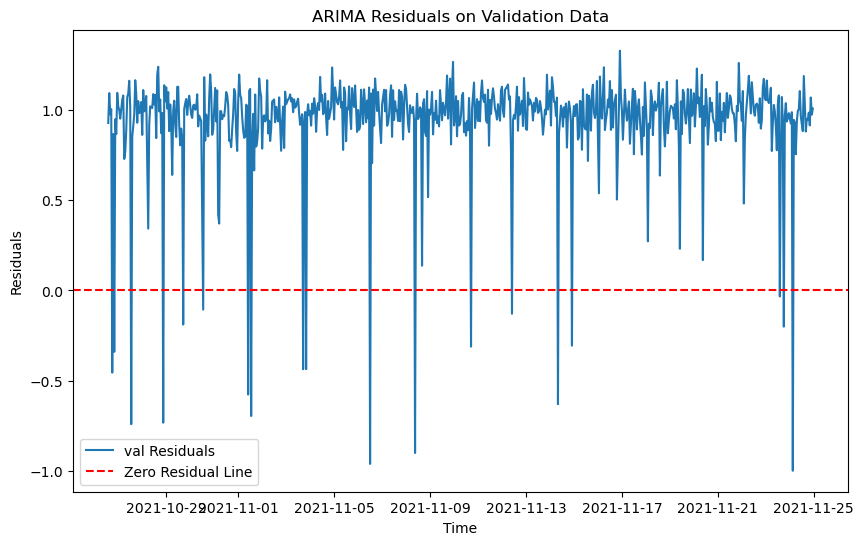

21:41:39 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.2316471299797256
RMSE on validation data for ARIMA: 0.9866287975176323
RMSE on test data for ARIMA: 0.9409239610934889


21:41:40 - cmdstanpy - INFO - Chain [1] done processing


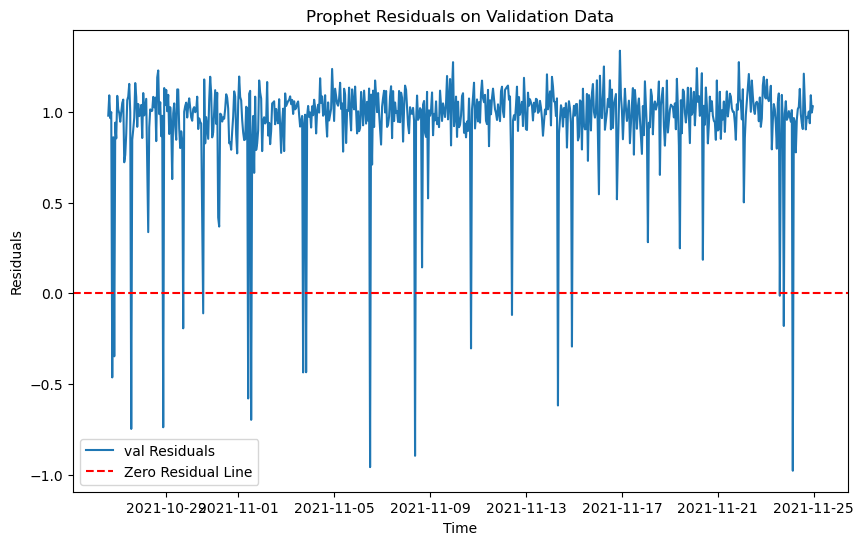

RMSE on training data for Prophet: 0.2987438296678054
RMSE on validation data for Prophet: 0.9926174349680038
RMSE on test data for Prophet: 0.96259795000318


<Figure size 1000x800 with 0 Axes>

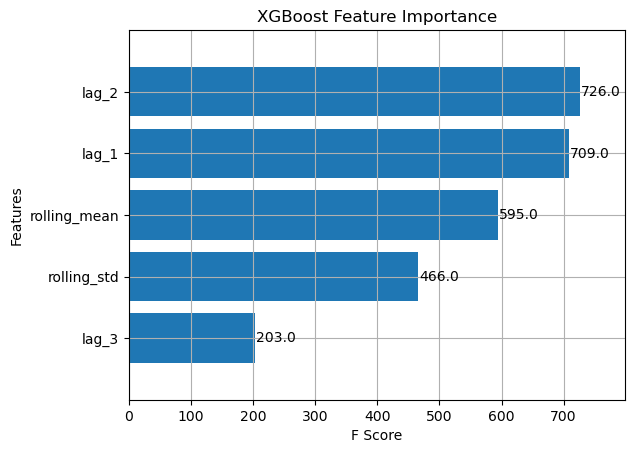

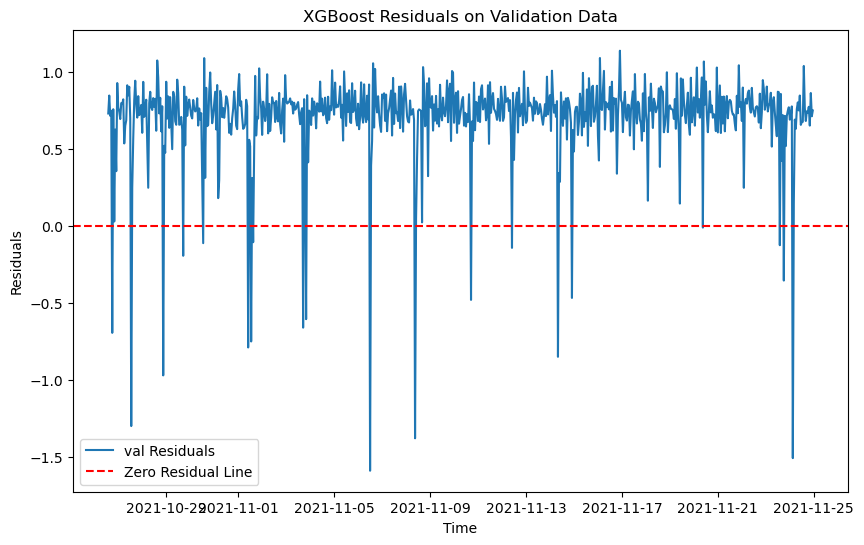

RMSE on training data for XGBoost: 0.060689861494114344
RMSE on validation data for XGBoost: 0.764287890317116
RMSE on test data for XGBoost: 0.7218573378183277


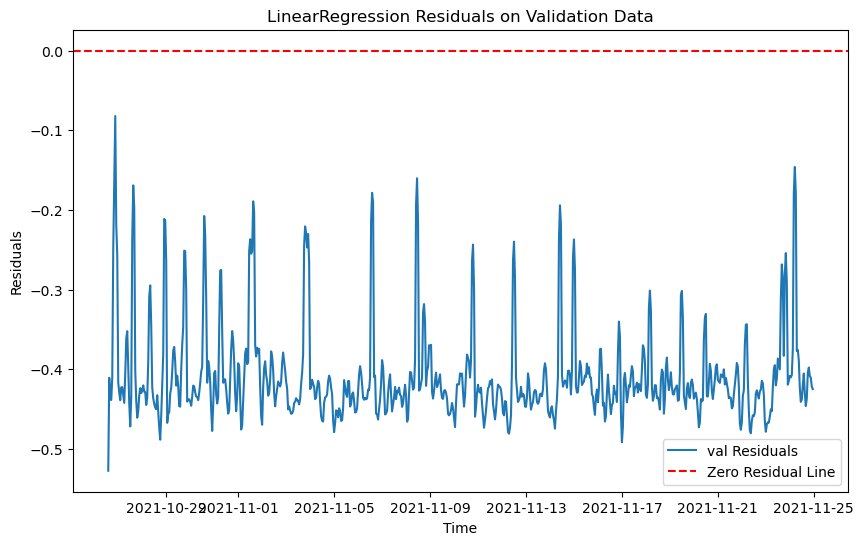

RMSE on training data for LinearRegression: 0.08949835632127105
RMSE on validation data for LinearRegression: 0.41250079998913175
RMSE on test data for LinearRegression: 0.39502283746148675

Best model is LinearRegression with RMSE: 0.41250079998913175
Best model saved as: models\model_161.pkl
data num 14
train_165.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.849408438635993e-28
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.2987260371711966e-23
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

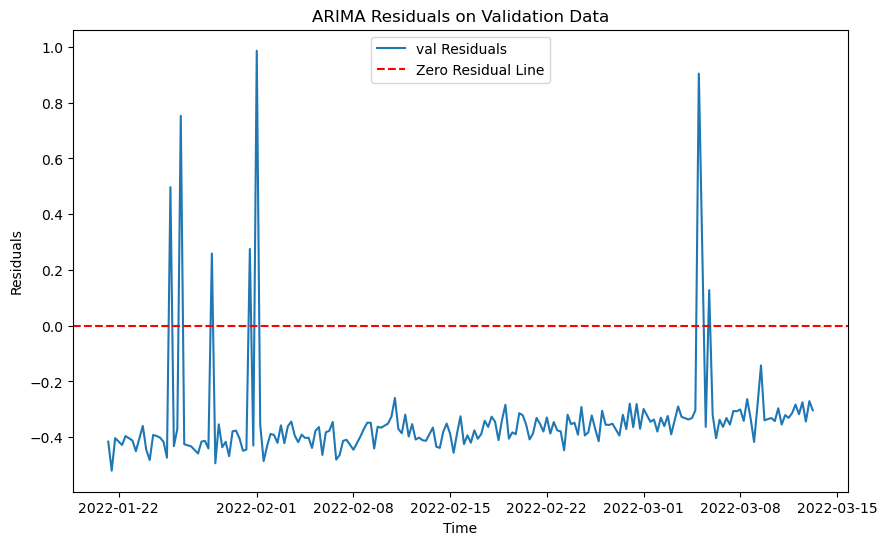

21:41:43 - cmdstanpy - INFO - Chain [1] start processing
21:41:43 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.27158201802028703
RMSE on validation data for ARIMA: 0.38826591620853207
RMSE on test data for ARIMA: 0.29530940509613435


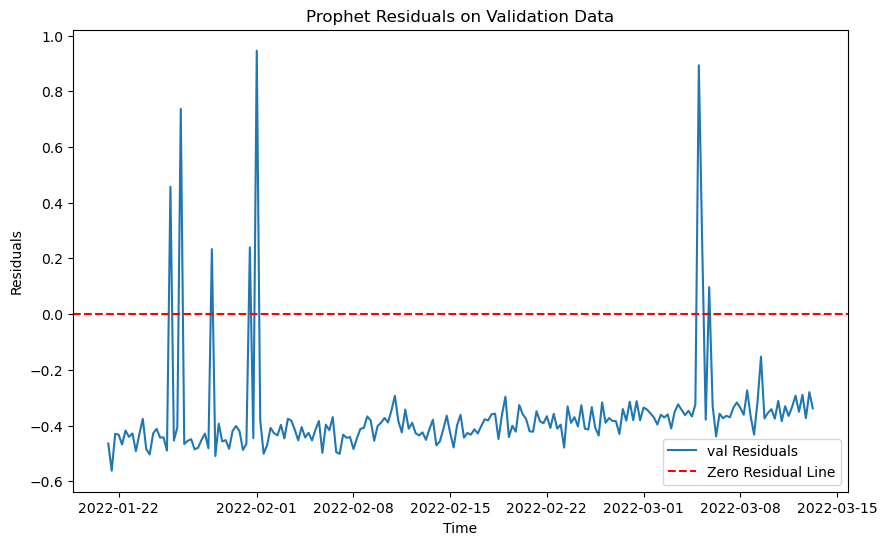

RMSE on training data for Prophet: 0.3689971090107548
RMSE on validation data for Prophet: 0.4109327397893934
RMSE on test data for Prophet: 0.29519028071619846


<Figure size 1000x800 with 0 Axes>

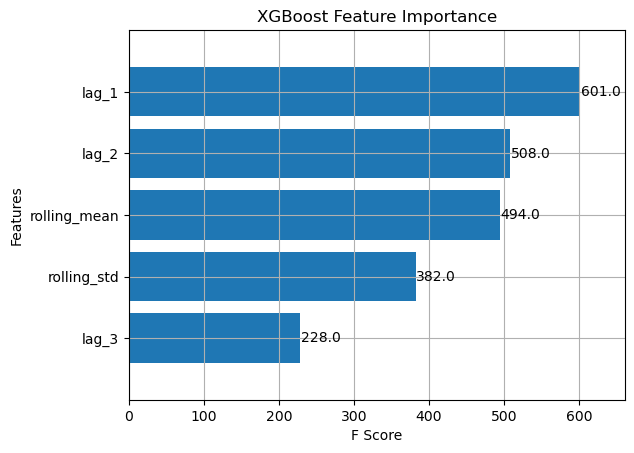

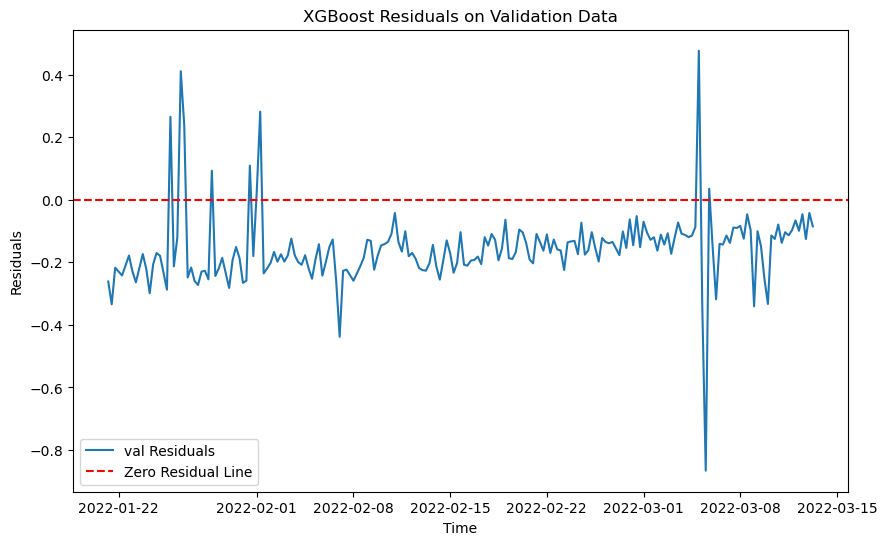

RMSE on training data for XGBoost: 0.018513092757730398
RMSE on validation data for XGBoost: 0.19634951697134403
RMSE on test data for XGBoost: 0.2956971707667506


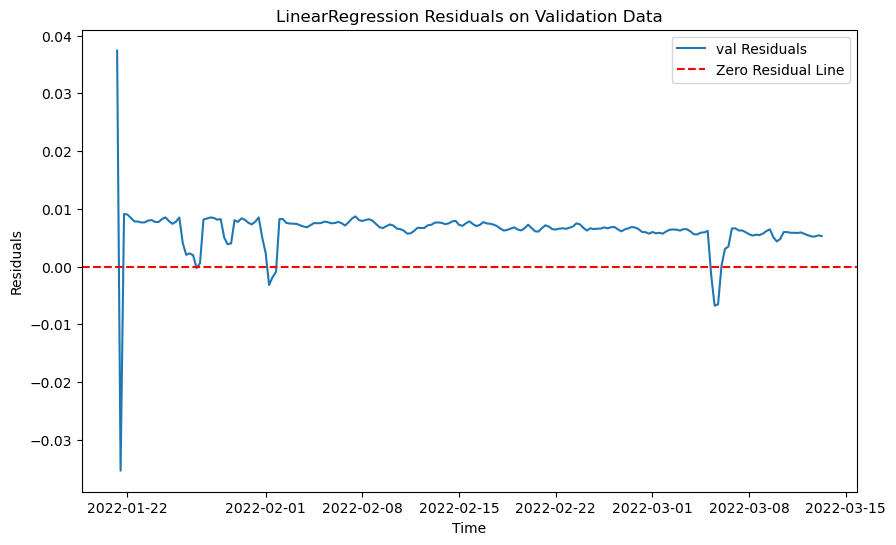

RMSE on training data for LinearRegression: 0.019535095008516332
RMSE on validation data for LinearRegression: 0.007581165650263003
RMSE on test data for LinearRegression: 0.009837800773821955

Best model is LinearRegression with RMSE: 0.007581165650263003
Best model saved as: models\model_165.pkl
data num 15
train_176.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.981473119028948e-13
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

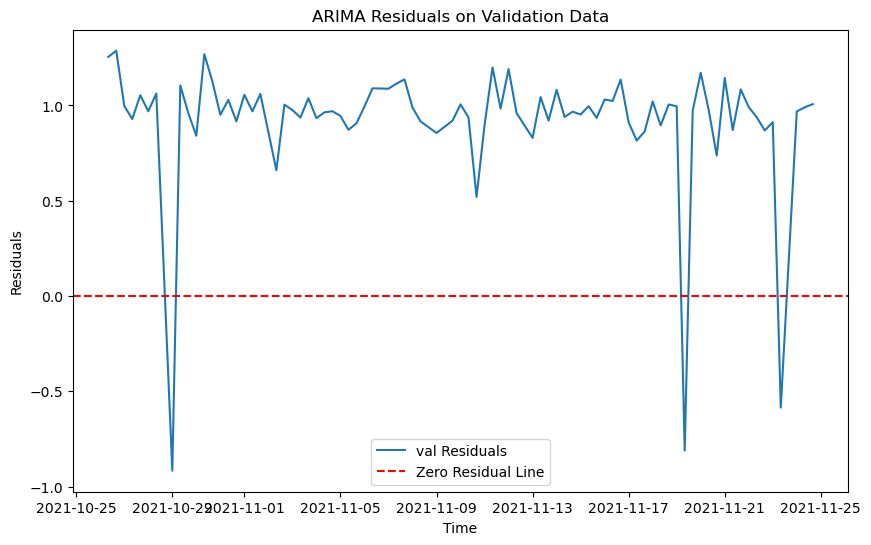

21:41:45 - cmdstanpy - INFO - Chain [1] start processing
21:41:45 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2732933764333168
RMSE on validation data for ARIMA: 0.9718427590734167
RMSE on test data for ARIMA: 0.9427096482601096


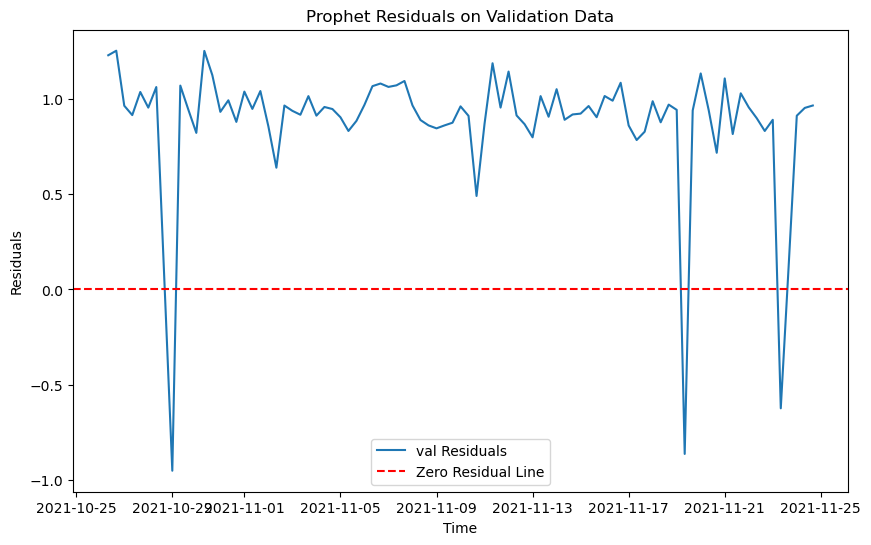

RMSE on training data for Prophet: 0.3295180032548068
RMSE on validation data for Prophet: 0.9448324118663173
RMSE on test data for Prophet: 0.9008904290477463


<Figure size 1000x800 with 0 Axes>

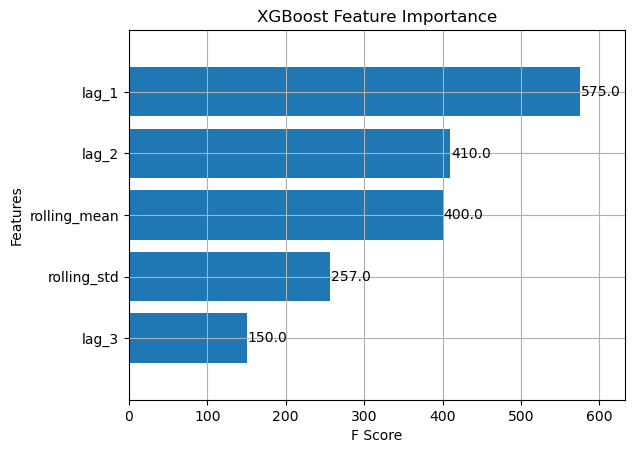

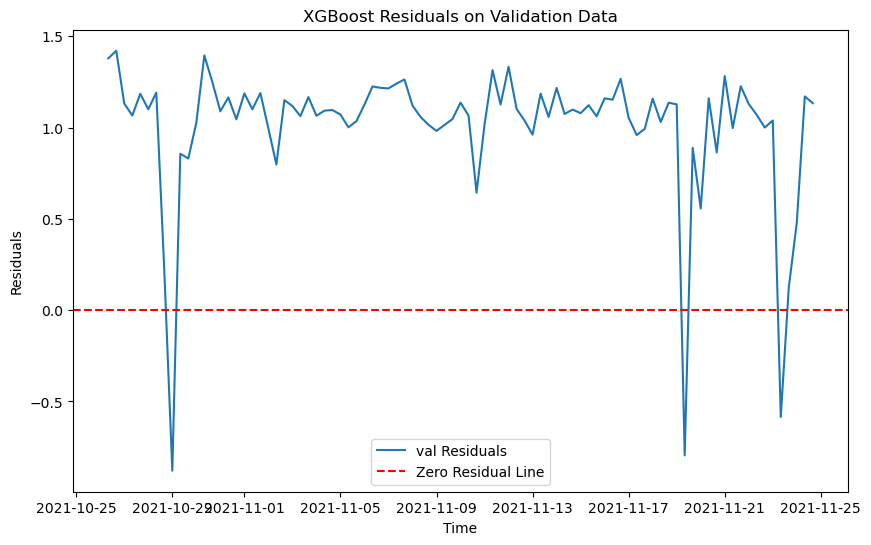

RMSE on training data for XGBoost: 0.007136634382436144
RMSE on validation data for XGBoost: 1.0779926092947938
RMSE on test data for XGBoost: 1.0527947325756575


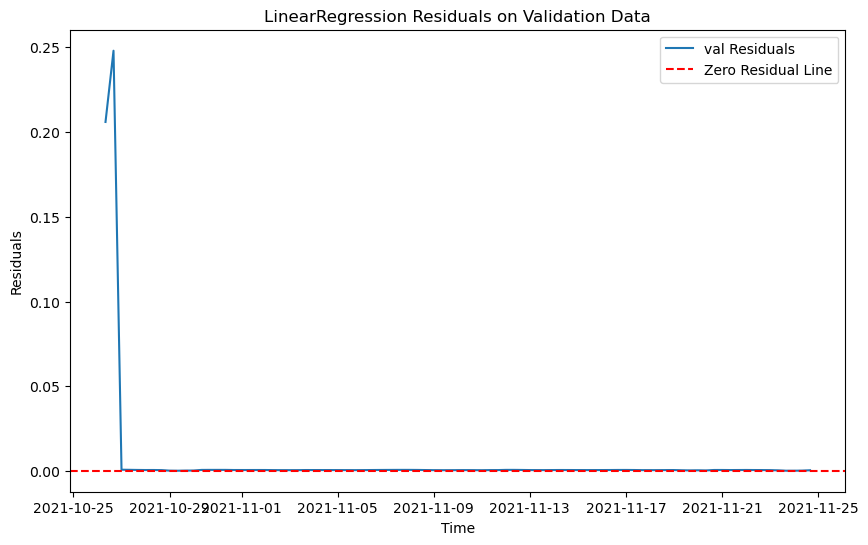

RMSE on training data for LinearRegression: 0.0015733109540314988
RMSE on validation data for LinearRegression: 0.03416044075634151
RMSE on test data for LinearRegression: 0.007293528279017661

Best model is LinearRegression with RMSE: 0.03416044075634151
Best model saved as: models\model_176.pkl
data num 16
train_177.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.282160211357895e-29
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()
C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:/

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


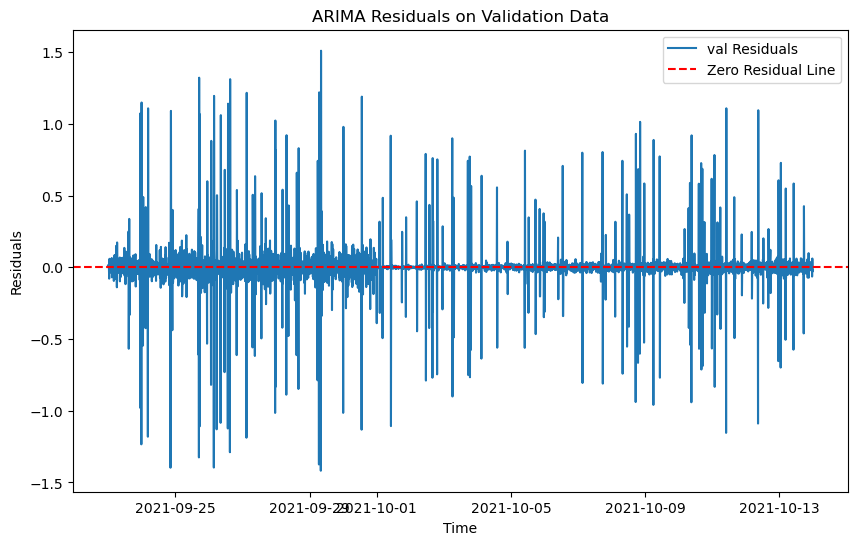

RMSE on training data for ARIMA: 0.18300243413708348
RMSE on validation data for ARIMA: 0.1969128312694633
RMSE on test data for ARIMA: 0.27918646781678425


21:42:04 - cmdstanpy - INFO - Chain [1] start processing
21:42:06 - cmdstanpy - INFO - Chain [1] done processing


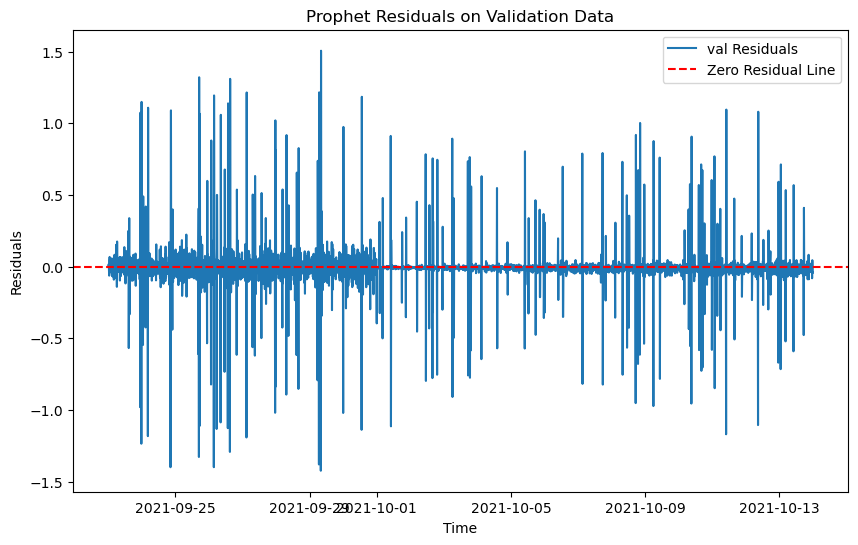

RMSE on training data for Prophet: 0.2527004956071414
RMSE on validation data for Prophet: 0.19713501065796069
RMSE on test data for Prophet: 0.27994139536010704


<Figure size 1000x800 with 0 Axes>

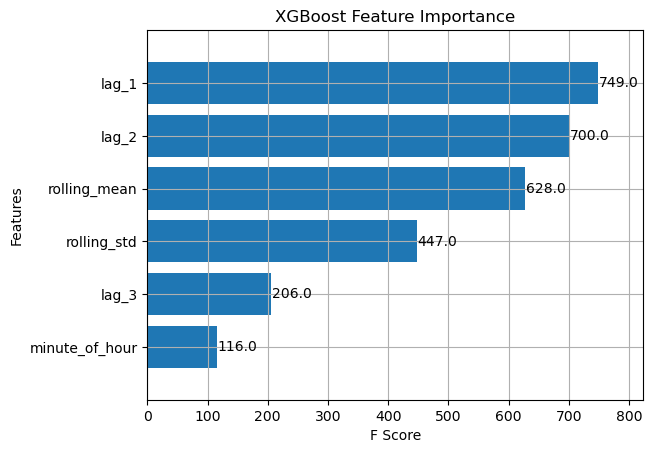

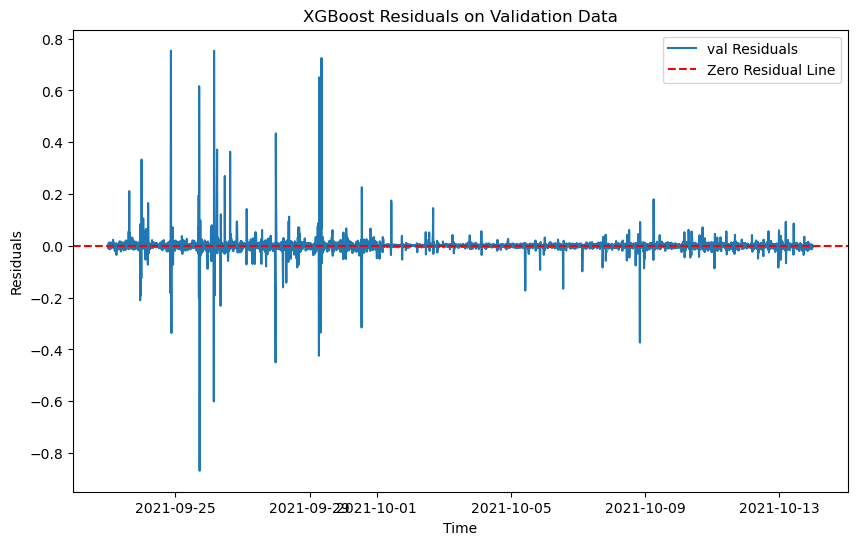

RMSE on training data for XGBoost: 0.020977059170580764
RMSE on validation data for XGBoost: 0.04903129875754311
RMSE on test data for XGBoost: 0.09976453395502127


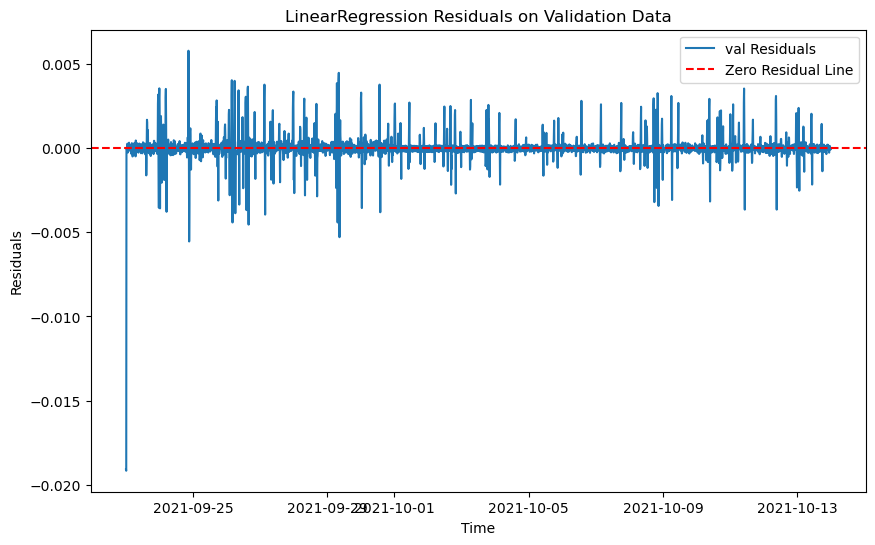

RMSE on training data for LinearRegression: 0.007003304575183139
RMSE on validation data for LinearRegression: 0.00089123643719775
RMSE on test data for LinearRegression: 0.0015186953376737078

Best model is LinearRegression with RMSE: 0.00089123643719775
Best model saved as: models\model_177.pkl
data num 17
train_185.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.0848713910355025e-17
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 6.022727362641376e-14
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 8.398607810938008e-13
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

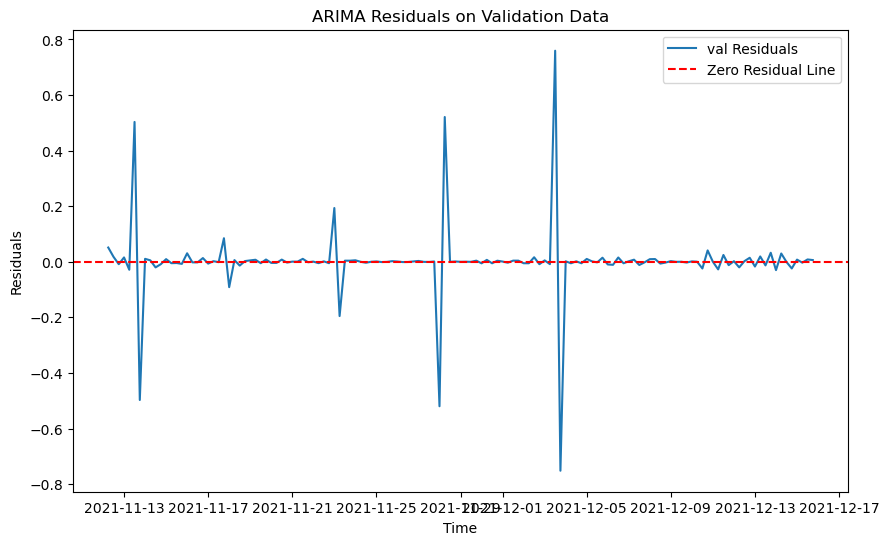

21:42:17 - cmdstanpy - INFO - Chain [1] start processing
21:42:17 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.22000542181985963
RMSE on validation data for ARIMA: 0.13033522977554776
RMSE on test data for ARIMA: 0.27000744150762335


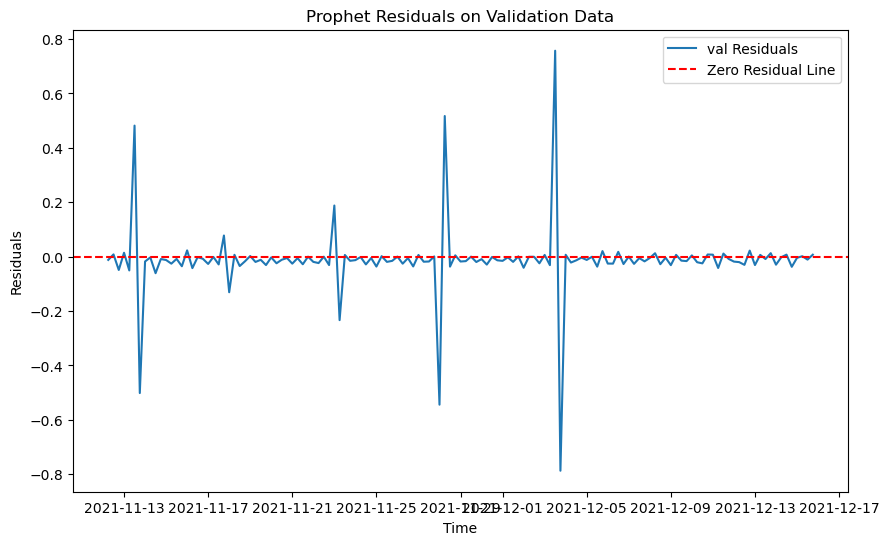

RMSE on training data for Prophet: 0.29345109547307785
RMSE on validation data for Prophet: 0.13348433460782202
RMSE on test data for Prophet: 0.26936676116526986


<Figure size 1000x800 with 0 Axes>

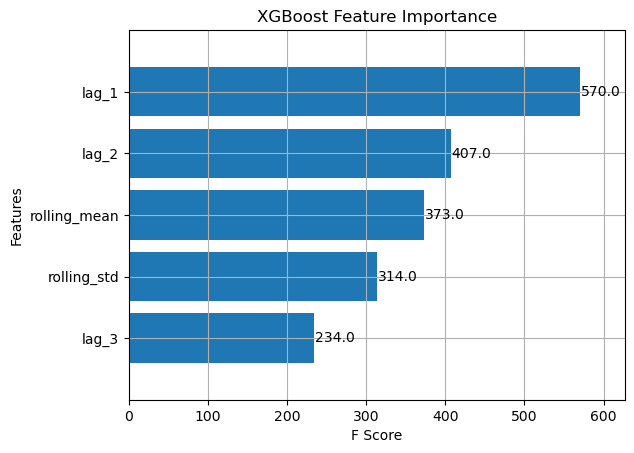

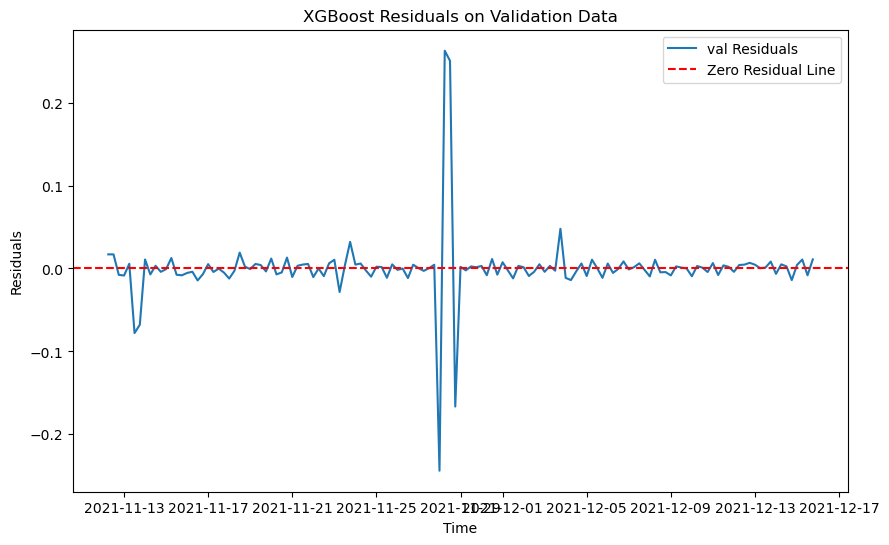

RMSE on training data for XGBoost: 0.008102766850362578
RMSE on validation data for XGBoost: 0.04215723641031365
RMSE on test data for XGBoost: 0.30445931797555853


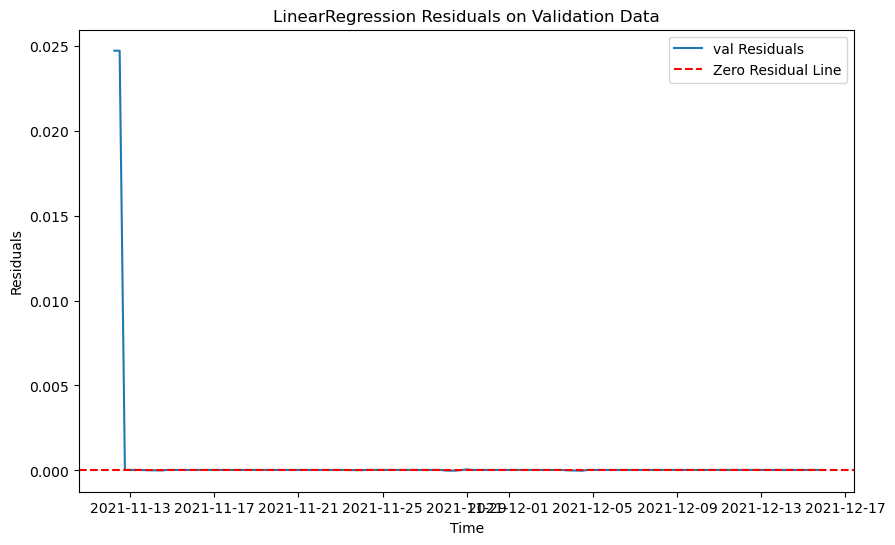

RMSE on training data for LinearRegression: 0.0002906318355946098
RMSE on validation data for LinearRegression: 0.0030085078782637296
RMSE on test data for LinearRegression: 0.001857876948770499

Best model is LinearRegression with RMSE: 0.0030085078782637296
Best model saved as: models\model_185.pkl
data num 18
train_188.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.4424536147016909e-05
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.887401937411778e-07
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.9625706446184474e-05
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

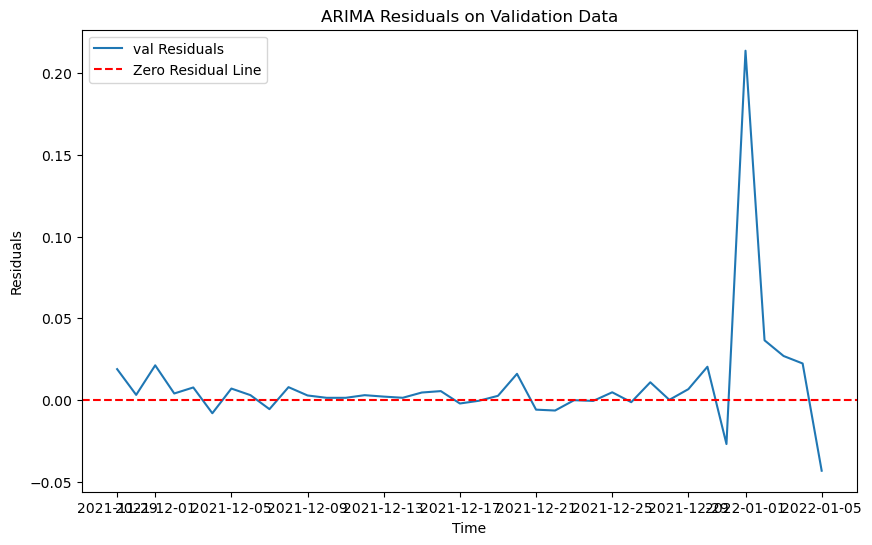

21:42:19 - cmdstanpy - INFO - Chain [1] start processing
21:42:19 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.12237266031623951
RMSE on validation data for ARIMA: 0.03731894045441069
RMSE on test data for ARIMA: 0.263707657328568


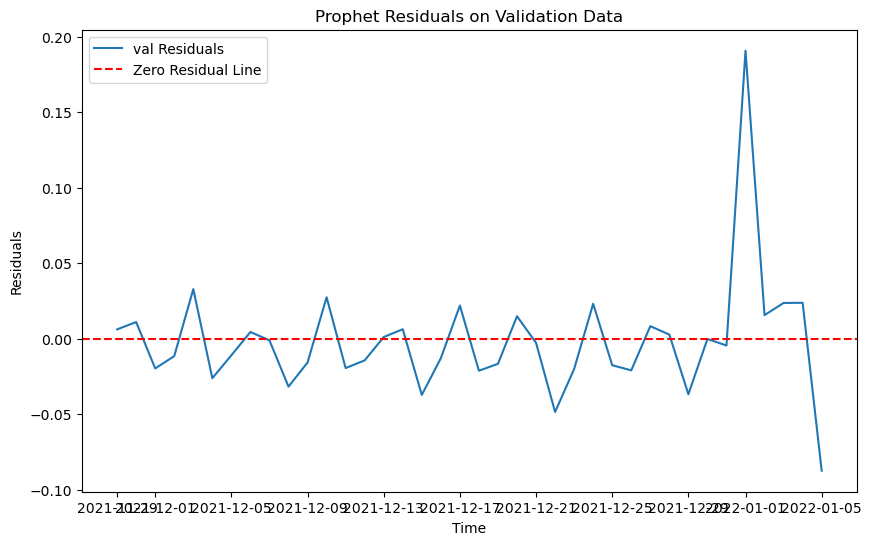

RMSE on training data for Prophet: 0.16111340809763136
RMSE on validation data for Prophet: 0.039440724585415136
RMSE on test data for Prophet: 0.2628150715652403


<Figure size 1000x800 with 0 Axes>

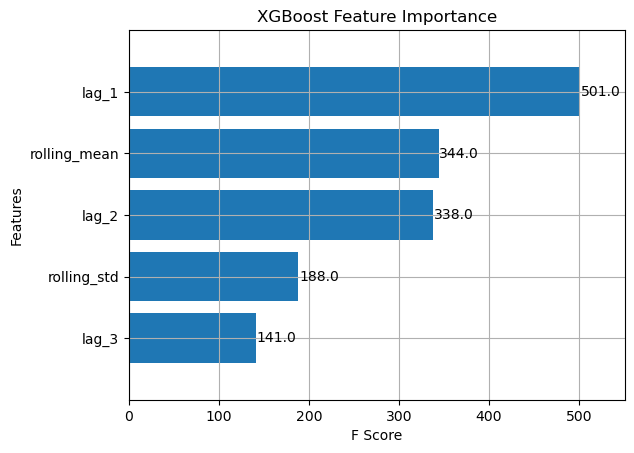

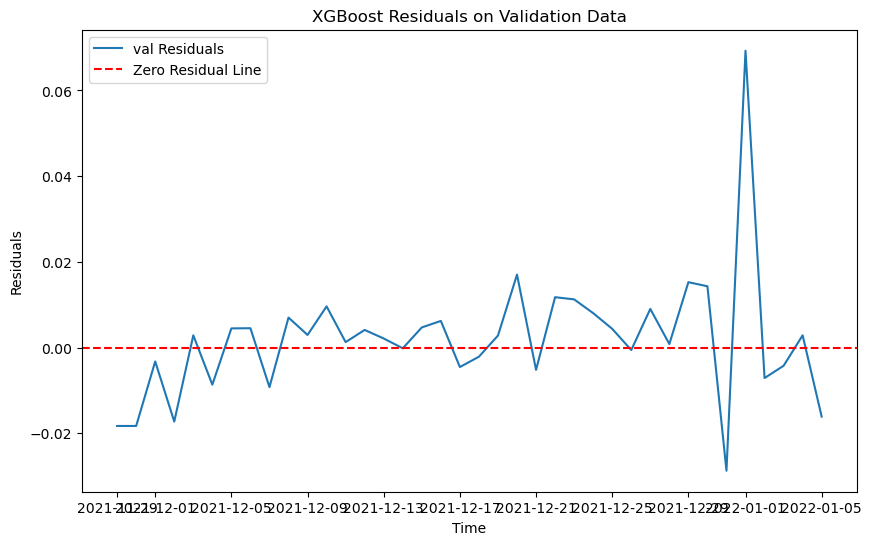

RMSE on training data for XGBoost: 0.008803522397437823
RMSE on validation data for XGBoost: 0.015042334351506313
RMSE on test data for XGBoost: 0.24998049577722528


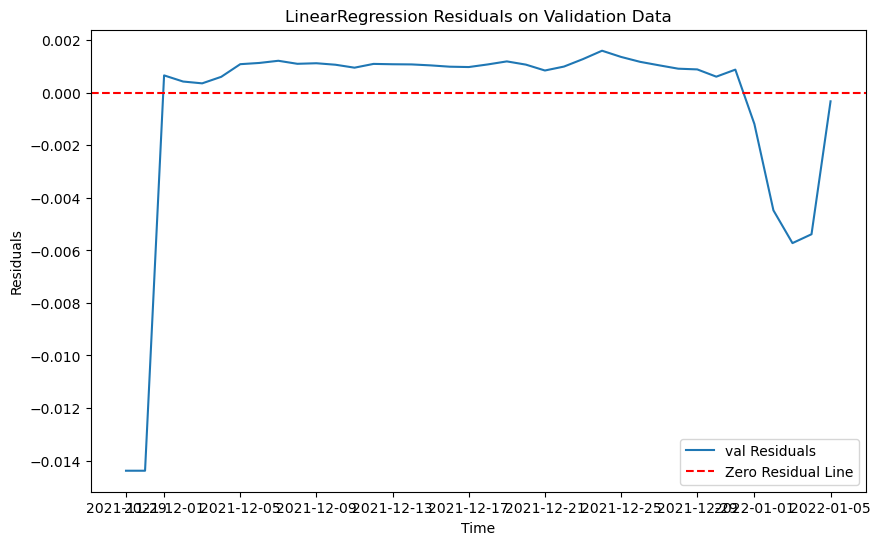

RMSE on training data for LinearRegression: 0.01381623286994419
RMSE on validation data for LinearRegression: 0.0037357814992636826
RMSE on test data for LinearRegression: 0.04738823860296314

Best model is LinearRegression with RMSE: 0.0037357814992636826
Best model saved as: models\model_188.pkl
data num 19
train_198.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 3.219079752364582e-30
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


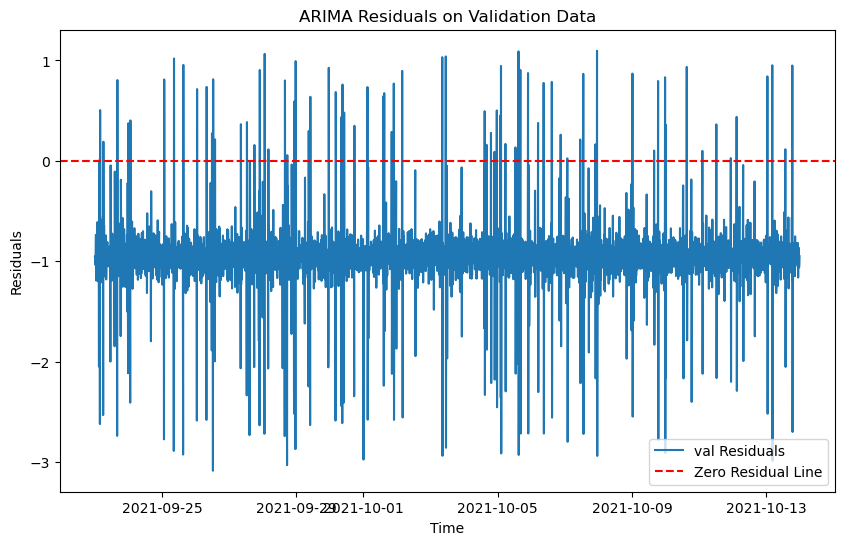

RMSE on training data for ARIMA: 0.26793252357391983
RMSE on validation data for ARIMA: 1.0289426385514453
RMSE on test data for ARIMA: 1.923487235912858


21:42:25 - cmdstanpy - INFO - Chain [1] start processing
21:42:25 - cmdstanpy - INFO - Chain [1] done processing


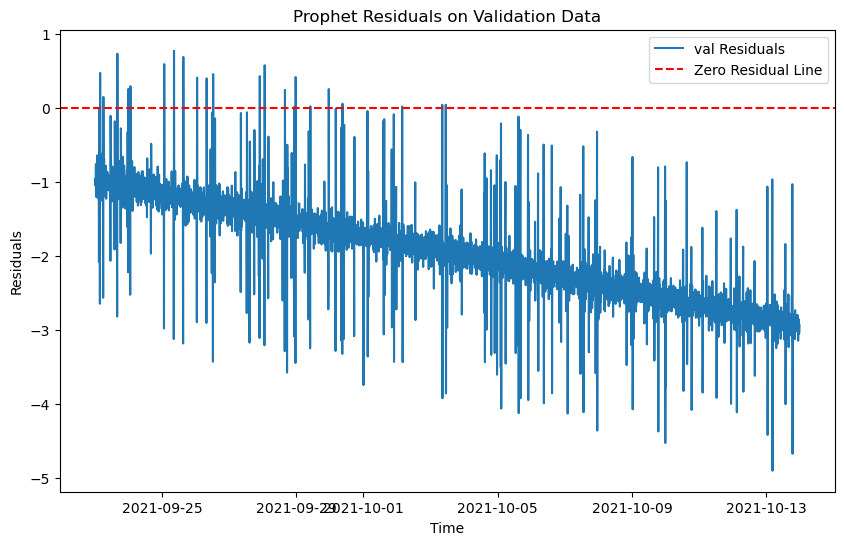

RMSE on training data for Prophet: 0.26820816715663615
RMSE on validation data for Prophet: 2.0698544791072133
RMSE on test data for Prophet: 4.2252233242079145


<Figure size 1000x800 with 0 Axes>

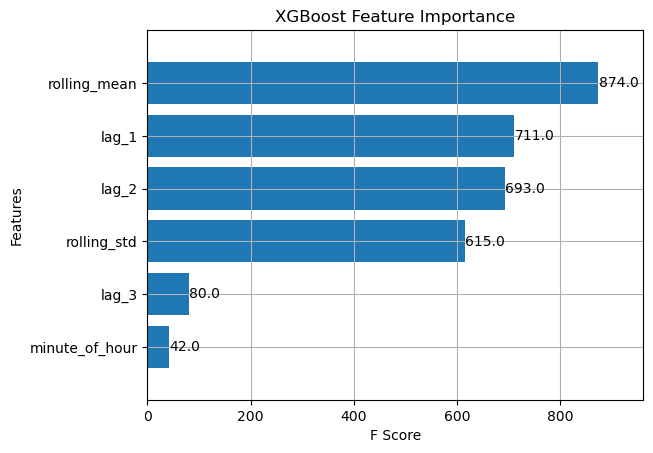

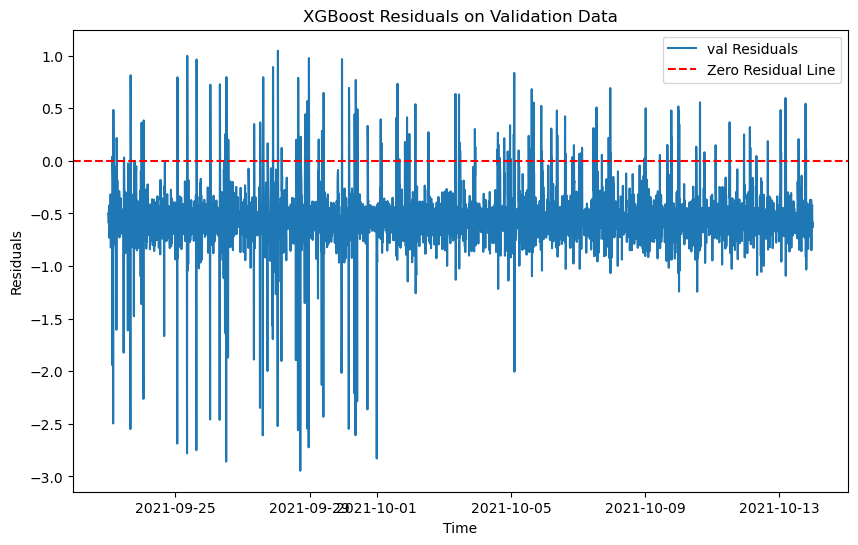

RMSE on training data for XGBoost: 0.019012082324584186
RMSE on validation data for XGBoost: 0.6362868429924299
RMSE on test data for XGBoost: 1.5294657990229692


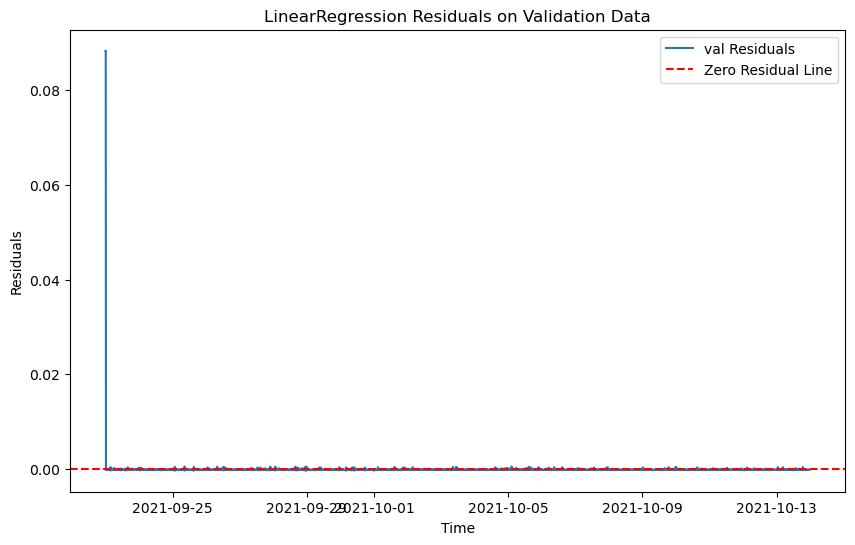

RMSE on training data for LinearRegression: 0.002865956999638158
RMSE on validation data for LinearRegression: 0.002283304957776203
RMSE on test data for LinearRegression: 0.004335172699120356

Best model is LinearRegression with RMSE: 0.002283304957776203
Best model saved as: models\model_198.pkl
data num 20
train_200.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive 

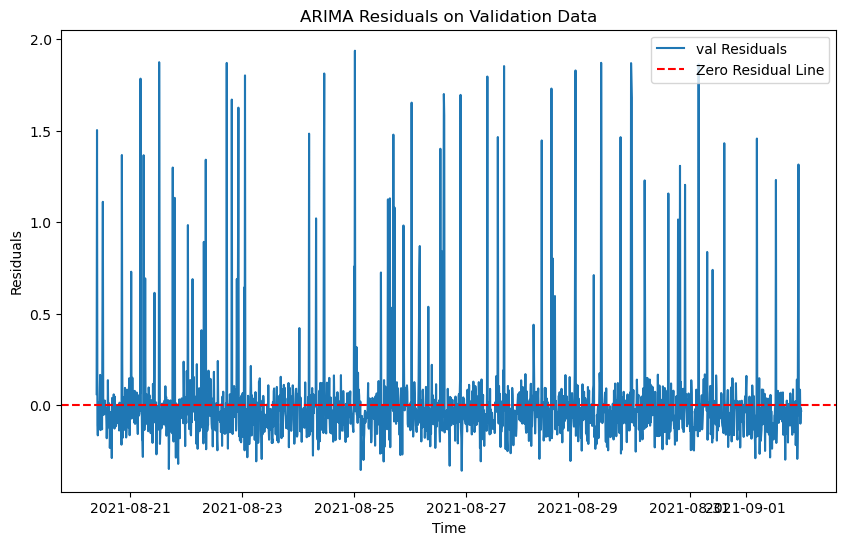

RMSE on training data for ARIMA: 0.2702603454896477
RMSE on validation data for ARIMA: 0.2875142429846277
RMSE on test data for ARIMA: 0.26406694577796885


21:42:36 - cmdstanpy - INFO - Chain [1] start processing
21:42:36 - cmdstanpy - INFO - Chain [1] done processing


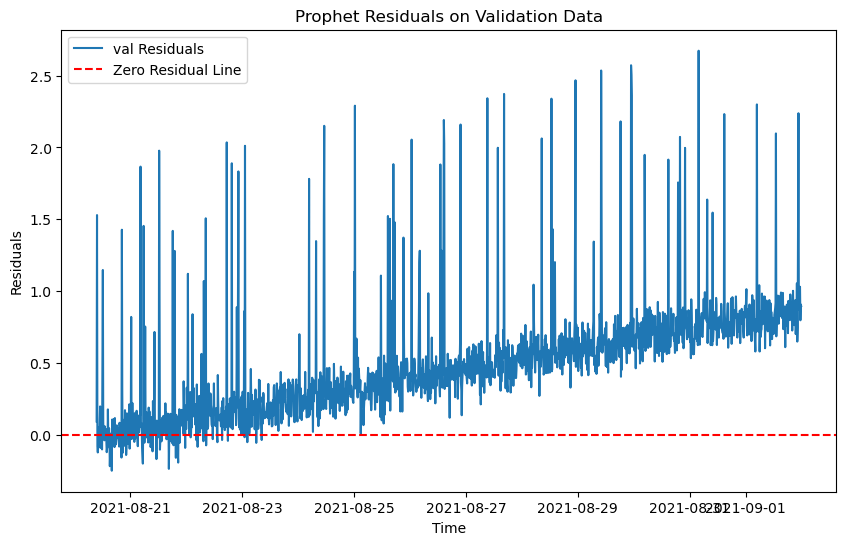

RMSE on training data for Prophet: 0.27036188009771295
RMSE on validation data for Prophet: 0.6153900136858429
RMSE on test data for Prophet: 1.1645484523031773


<Figure size 1000x800 with 0 Axes>

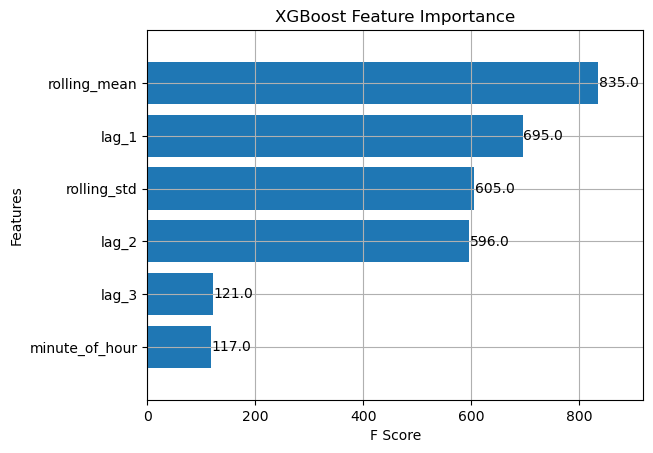

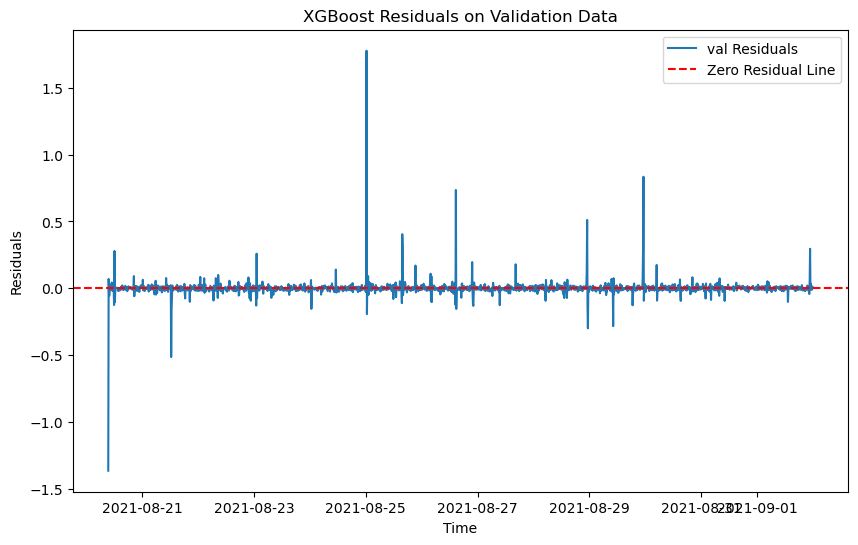

RMSE on training data for XGBoost: 0.01813168044793965
RMSE on validation data for XGBoost: 0.0692738172768554
RMSE on test data for XGBoost: 0.03021279865103213


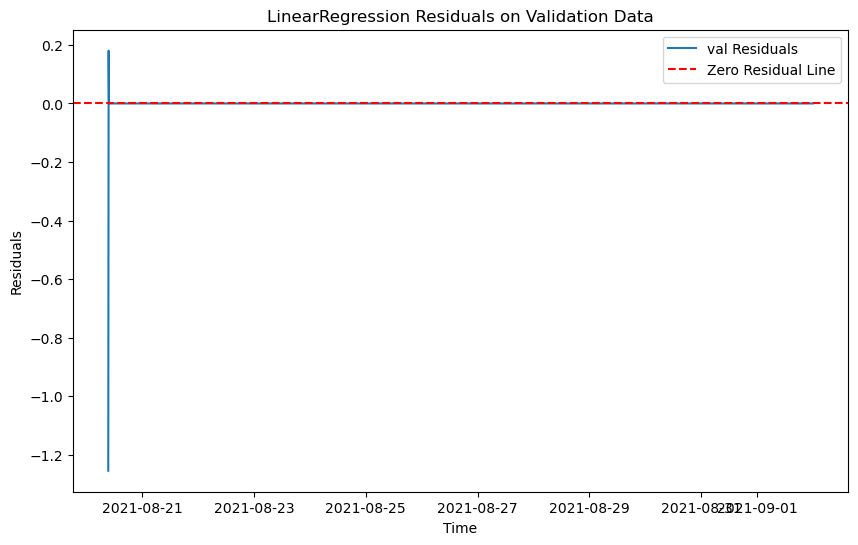

RMSE on training data for LinearRegression: 0.0025086560912563225
RMSE on validation data for LinearRegression: 0.029743707402763813
RMSE on test data for LinearRegression: 0.0037908952487479097

Best model is LinearRegression with RMSE: 0.029743707402763813
Best model saved as: models\model_200.pkl
data num 21
train_204.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

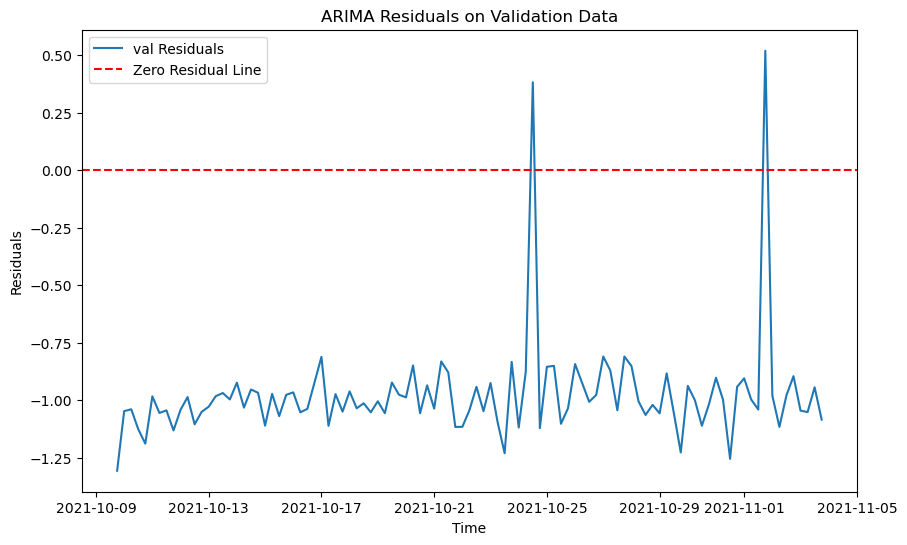

RMSE on training data for ARIMA: 0.30895684166562665
RMSE on validation data for ARIMA: 1.0027649721745653
RMSE on test data for ARIMA: 0.9641455115484888


21:42:42 - cmdstanpy - INFO - Chain [1] start processing
21:42:42 - cmdstanpy - INFO - Chain [1] done processing


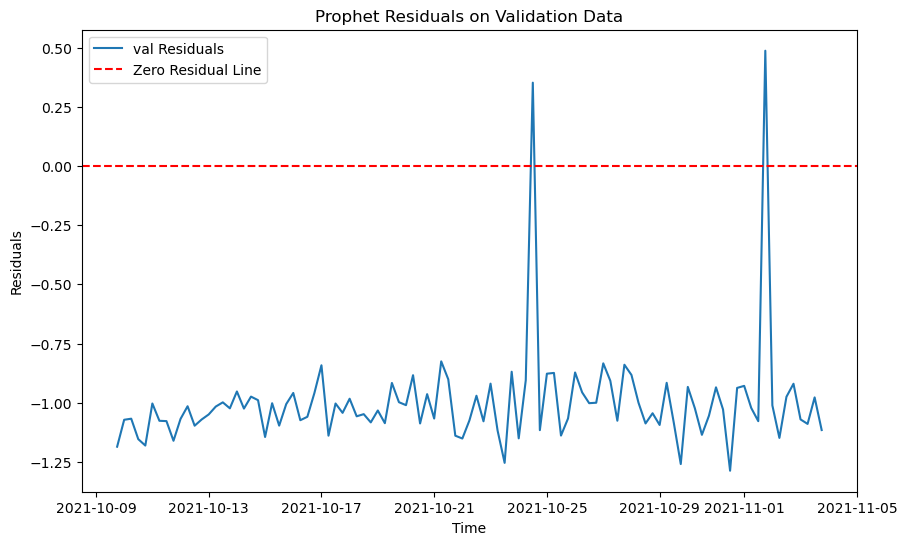

RMSE on training data for Prophet: 0.36517435353965666
RMSE on validation data for Prophet: 1.0238379461777685
RMSE on test data for Prophet: 0.9878980103455499


<Figure size 1000x800 with 0 Axes>

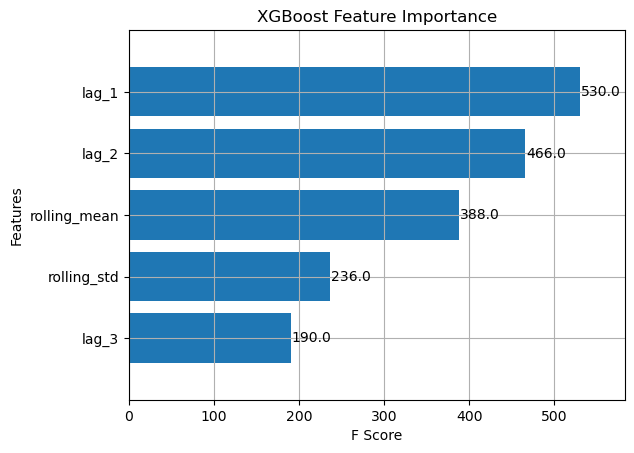

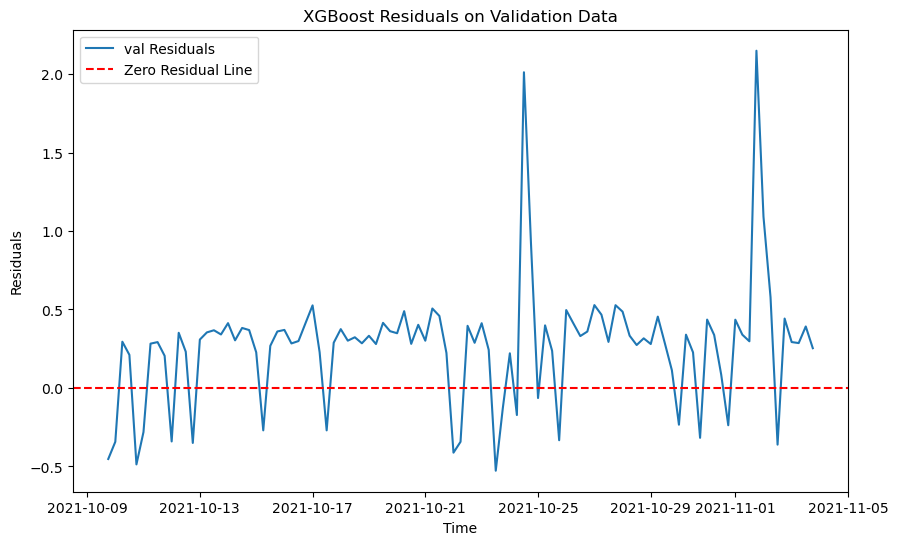

RMSE on training data for XGBoost: 0.08499390435965185
RMSE on validation data for XGBoost: 0.47223208813732387
RMSE on test data for XGBoost: 0.5049876750813226


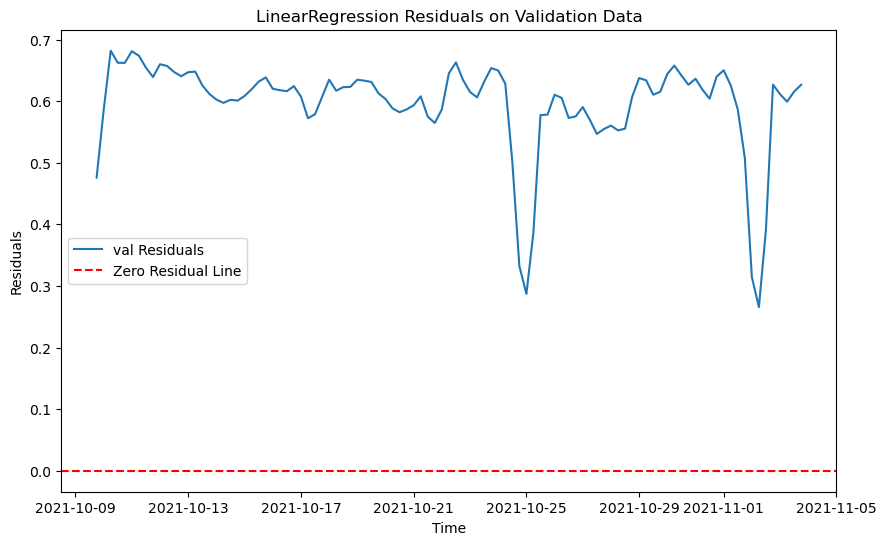

RMSE on training data for LinearRegression: 0.12492362511113969
RMSE on validation data for LinearRegression: 0.6007847358656159
RMSE on test data for LinearRegression: 0.5677248606591205

Best model is XGBoost with RMSE: 0.47223208813732387
Best model saved as: models\model_204.pkl
data num 22
train_205.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


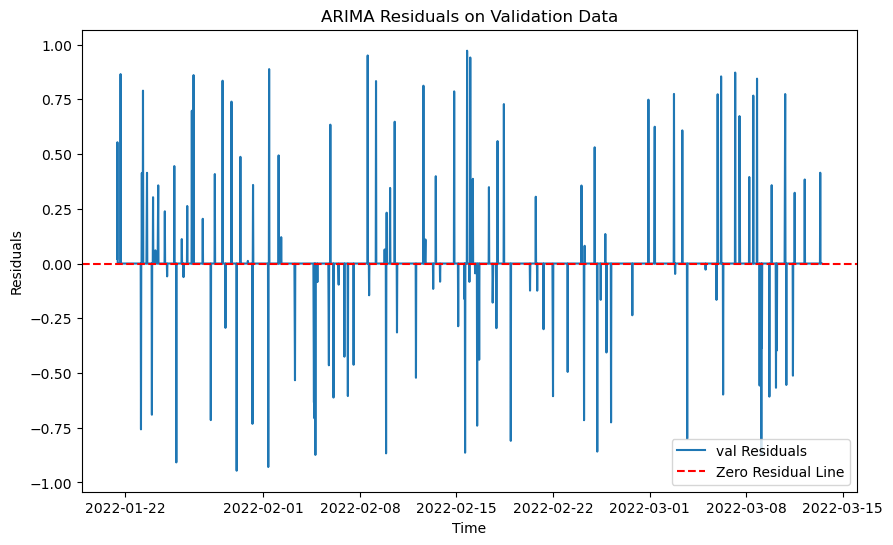

RMSE on training data for ARIMA: 0.20698711672378262
RMSE on validation data for ARIMA: 0.12792301073371193
RMSE on test data for ARIMA: 0.34220892017105564


21:42:58 - cmdstanpy - INFO - Chain [1] start processing
21:42:58 - cmdstanpy - INFO - Chain [1] done processing


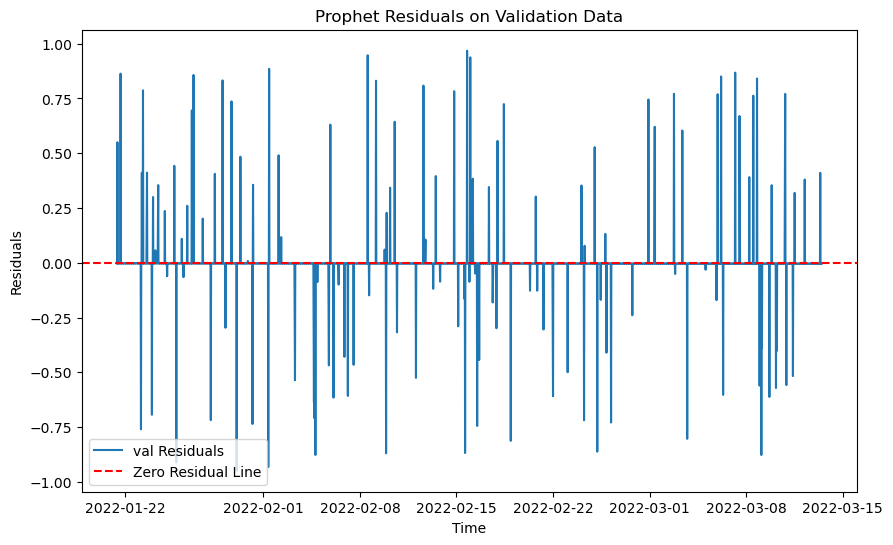

RMSE on training data for Prophet: 0.27415068028900047
RMSE on validation data for Prophet: 0.12791582859860928
RMSE on test data for Prophet: 0.342240871049404


<Figure size 1000x800 with 0 Axes>

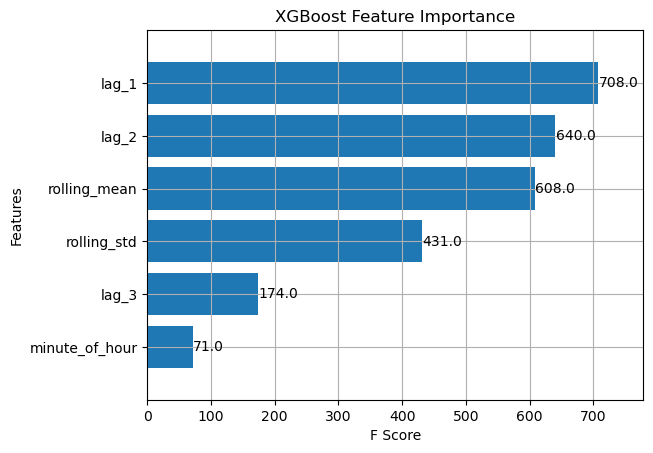

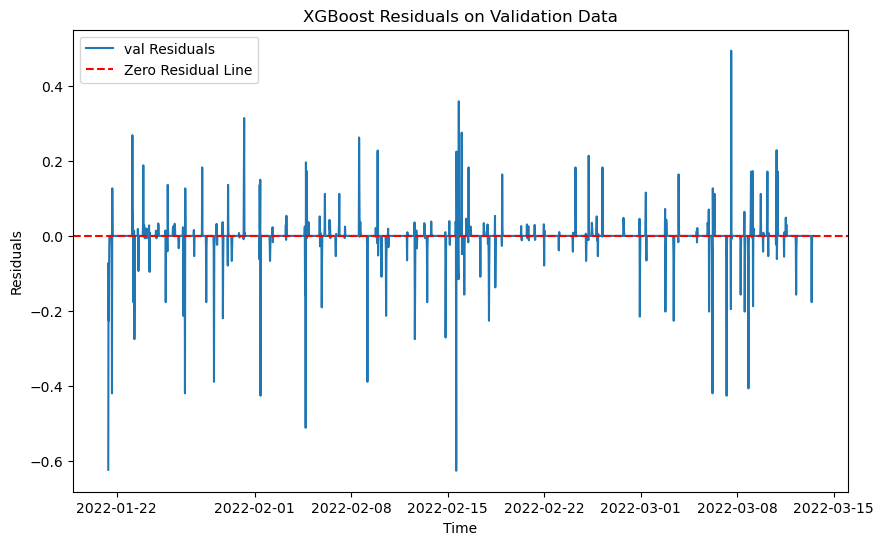

RMSE on training data for XGBoost: 0.022557712219742468
RMSE on validation data for XGBoost: 0.04745290339249218
RMSE on test data for XGBoost: 0.23395393730232453


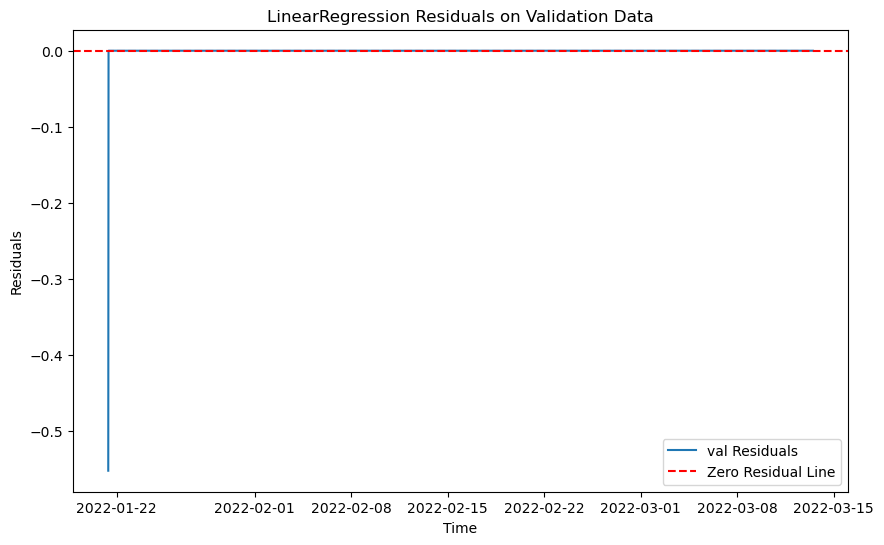

RMSE on training data for LinearRegression: 1.877458978294826e-15
RMSE on validation data for LinearRegression: 0.011152516686666364
RMSE on test data for LinearRegression: 2.4238057235041606e-15

Best model is LinearRegression with RMSE: 0.011152516686666364
Best model saved as: models\model_205.pkl
data num 23
train_209.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()
C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:/

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive 

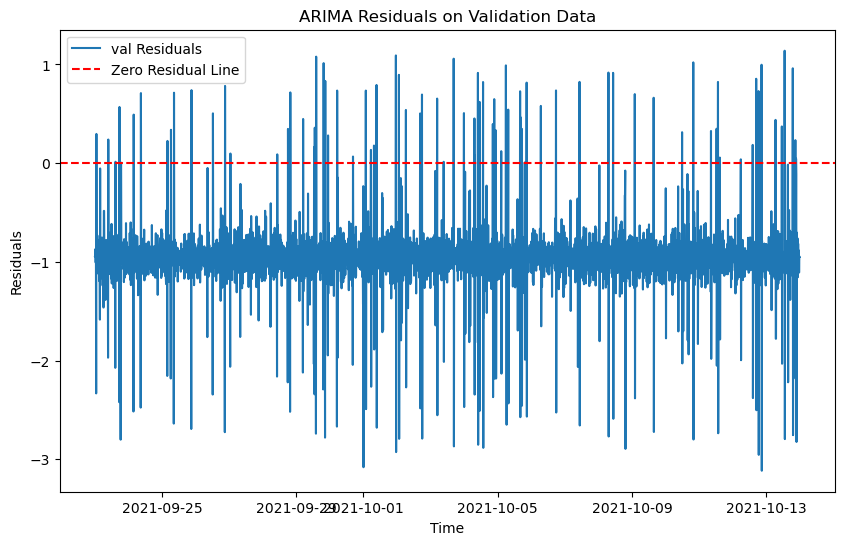

RMSE on training data for ARIMA: 0.2617718503148617
RMSE on validation data for ARIMA: 1.0296031681111428
RMSE on test data for ARIMA: 1.919636593135197


21:43:10 - cmdstanpy - INFO - Chain [1] start processing
21:43:11 - cmdstanpy - INFO - Chain [1] done processing


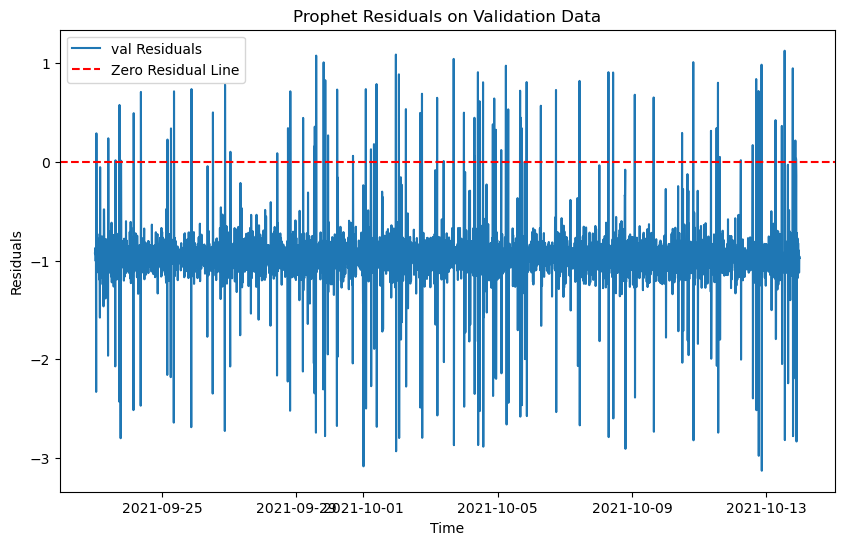

RMSE on training data for Prophet: 0.2619170973687969
RMSE on validation data for Prophet: 1.0356733327323586
RMSE on test data for Prophet: 1.9352435722204944


<Figure size 1000x800 with 0 Axes>

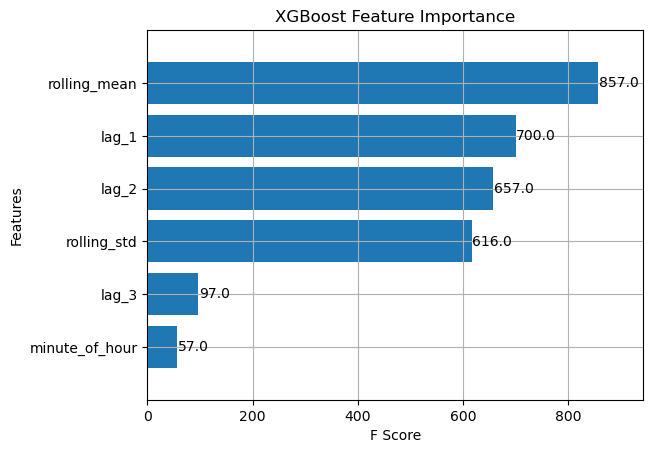

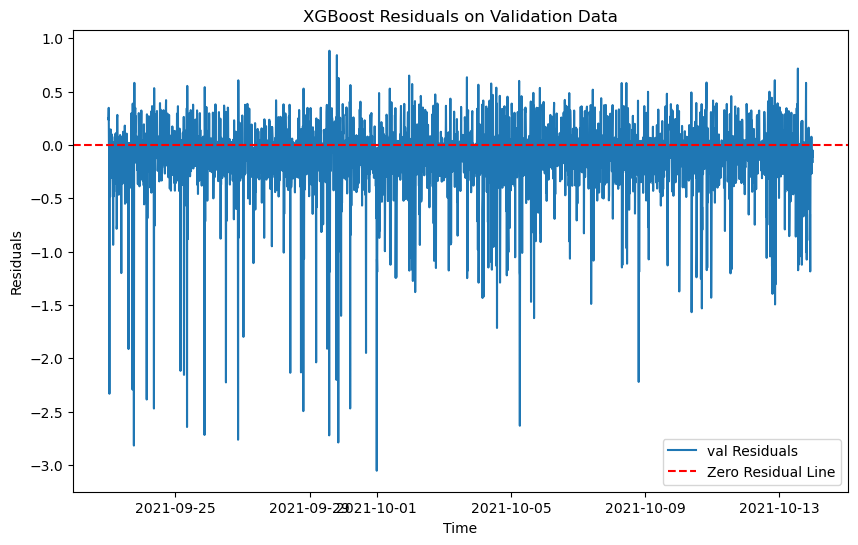

RMSE on training data for XGBoost: 0.020000549890271047
RMSE on validation data for XGBoost: 0.3940770928505401
RMSE on test data for XGBoost: 0.914468995796325


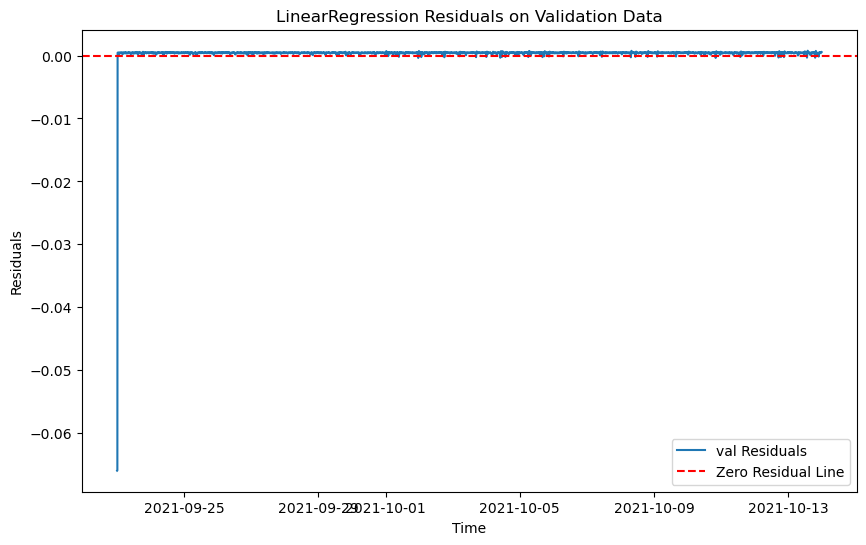

RMSE on training data for LinearRegression: 0.0033500192930361076
RMSE on validation data for LinearRegression: 0.0017524772791593583
RMSE on test data for LinearRegression: 0.006257512025712284

Best model is LinearRegression with RMSE: 0.0017524772791593583
Best model saved as: models\model_209.pkl
data num 24
train_21.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 9.924325990639065e-13
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.01601659027782393
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 8.437807835727073e-06
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

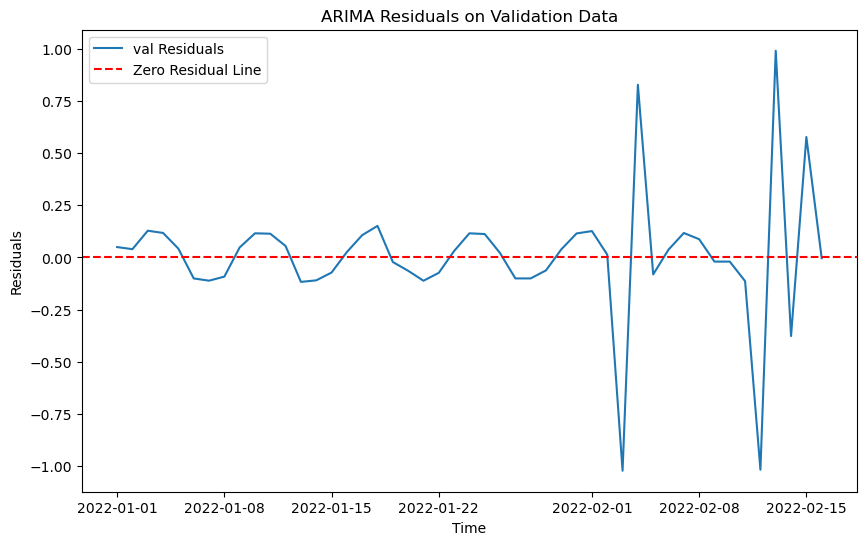

21:43:19 - cmdstanpy - INFO - Chain [1] start processing
21:43:19 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.27602492910104465
RMSE on validation data for ARIMA: 0.310241218653448
RMSE on test data for ARIMA: 0.15566391112642258


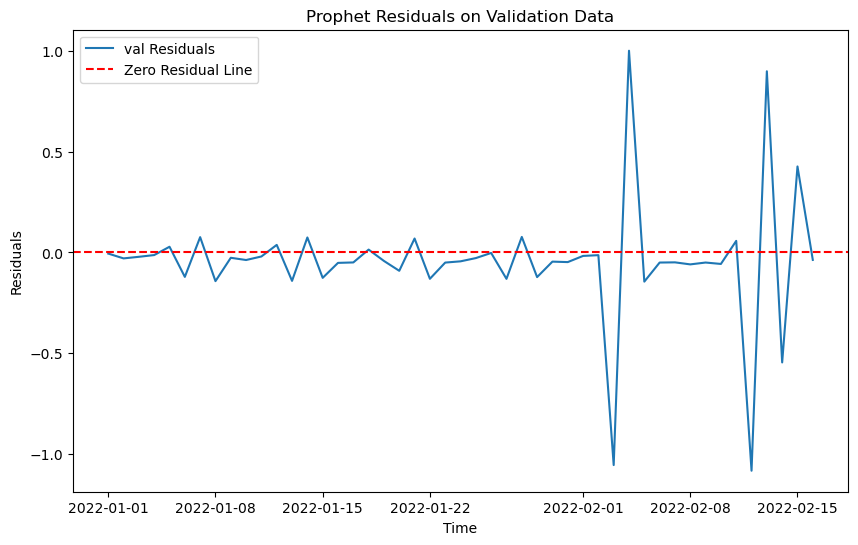

RMSE on training data for Prophet: 0.29890613601185817
RMSE on validation data for Prophet: 0.3192407748887259
RMSE on test data for Prophet: 0.20884998882746655


<Figure size 1000x800 with 0 Axes>

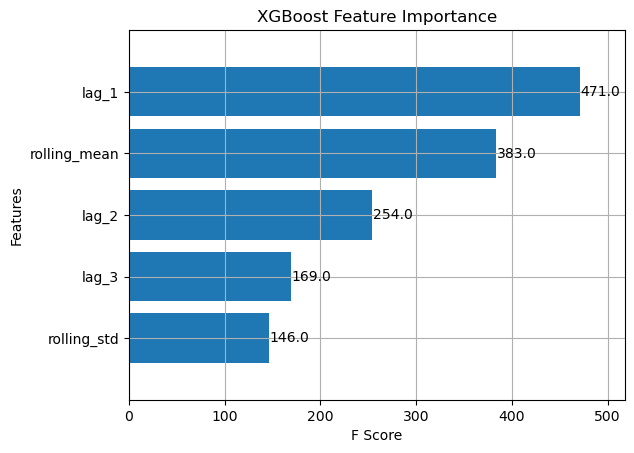

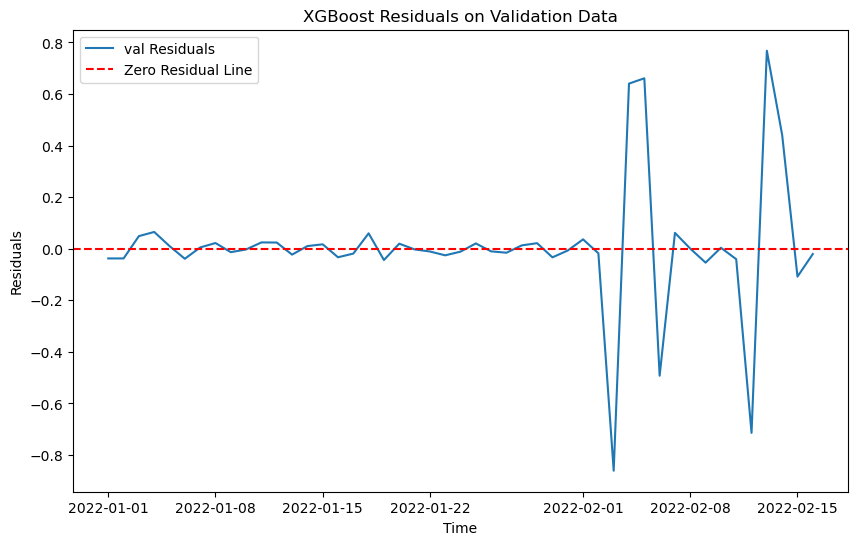

RMSE on training data for XGBoost: 0.060316557988973285
RMSE on validation data for XGBoost: 0.25978925268960745
RMSE on test data for XGBoost: 0.08012320681958227


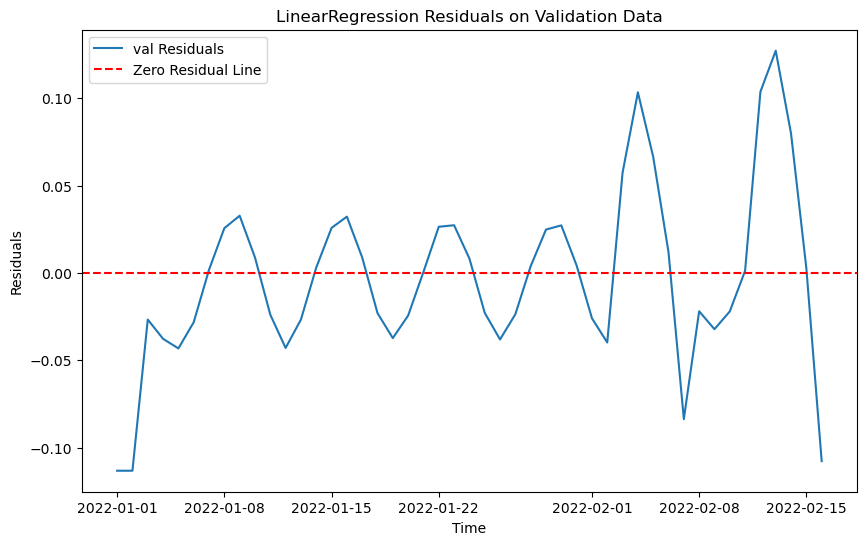

RMSE on training data for LinearRegression: 0.07988365681891725
RMSE on validation data for LinearRegression: 0.050520963501515616
RMSE on test data for LinearRegression: 0.02838786506364061

Best model is LinearRegression with RMSE: 0.050520963501515616
Best model saved as: models\model_21.pkl
data num 25
train_211.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to co

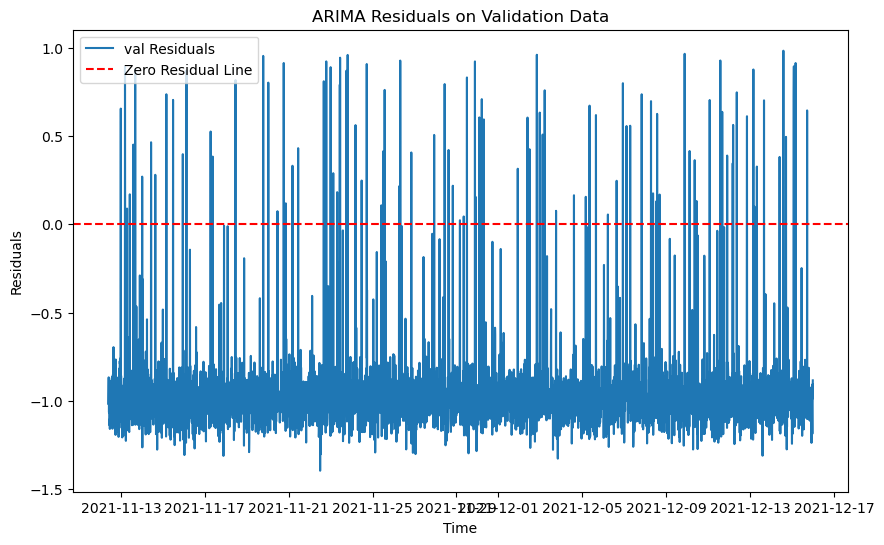

RMSE on training data for ARIMA: 0.27588354226754325
RMSE on validation data for ARIMA: 0.9895127927176356
RMSE on test data for ARIMA: 0.3657915497164846


21:43:44 - cmdstanpy - INFO - Chain [1] start processing
21:43:46 - cmdstanpy - INFO - Chain [1] done processing


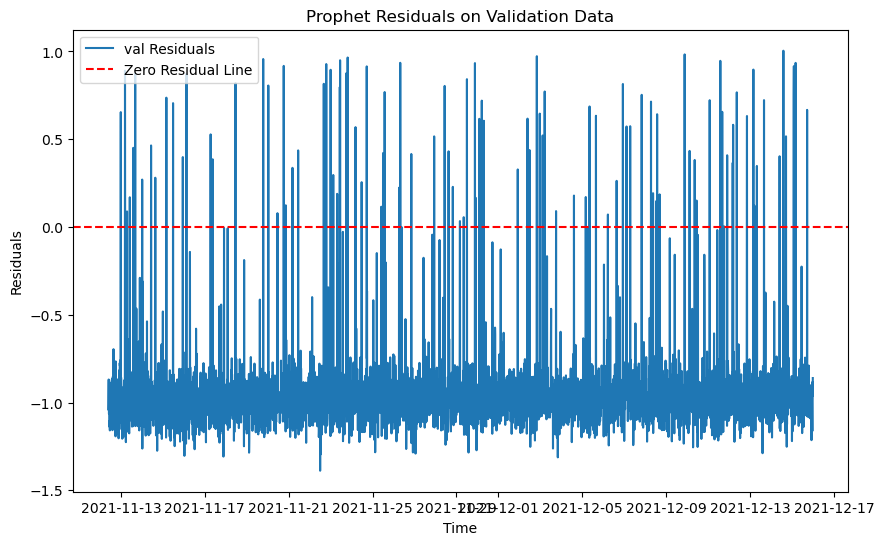

RMSE on training data for Prophet: 0.3699217696343194
RMSE on validation data for Prophet: 0.9789286524813561
RMSE on test data for Prophet: 0.3669215400028721


<Figure size 1000x800 with 0 Axes>

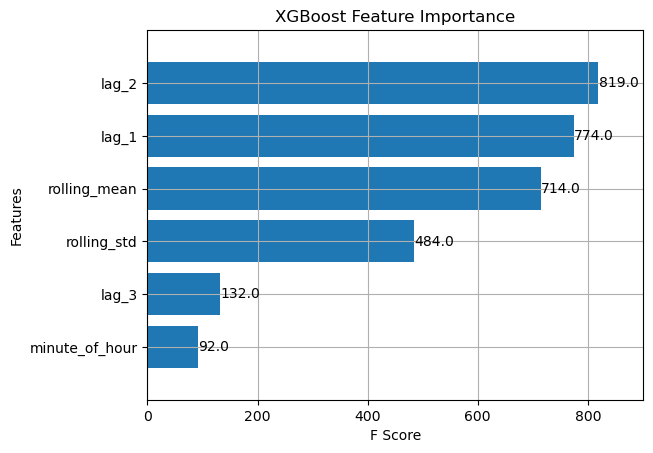

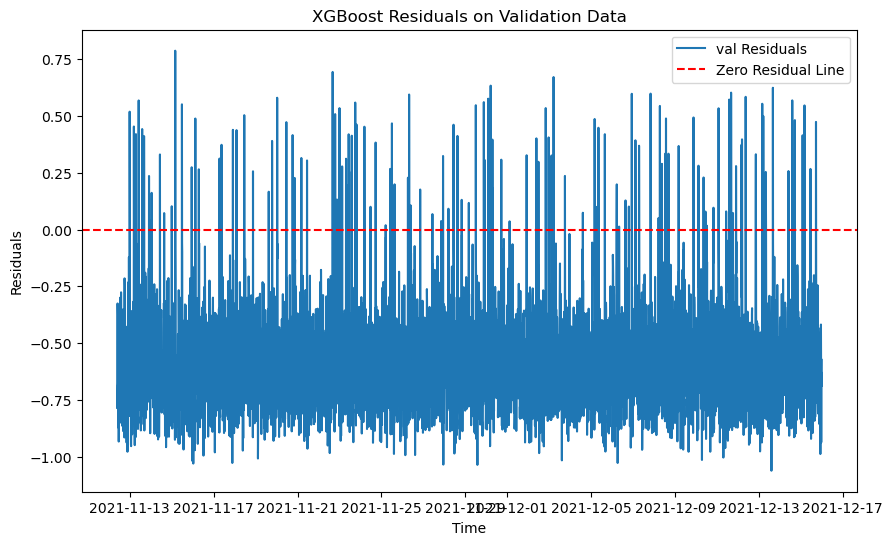

RMSE on training data for XGBoost: 0.03277353467366481
RMSE on validation data for XGBoost: 0.6333482393043852
RMSE on test data for XGBoost: 0.047097214228463545


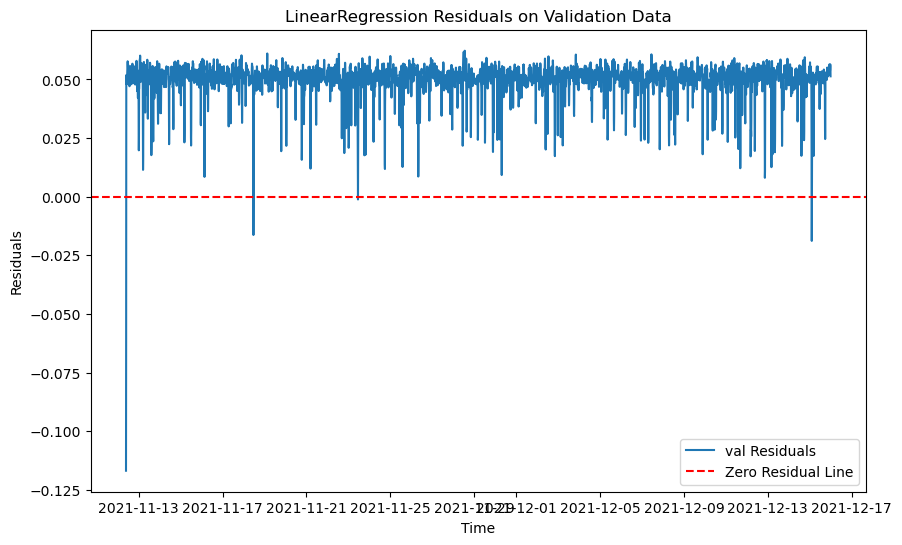

RMSE on training data for LinearRegression: 0.035571997801983966
RMSE on validation data for LinearRegression: 0.050180996904417116
RMSE on test data for LinearRegression: 0.009150173985509165

Best model is LinearRegression with RMSE: 0.050180996904417116
Best model saved as: models\model_211.pkl
data num 26
train_212.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

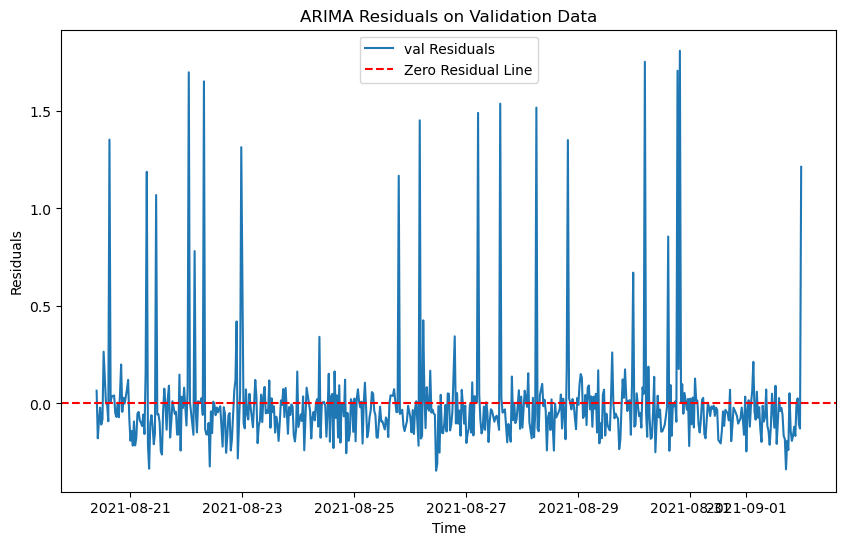

21:44:00 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.277480295109252
RMSE on validation data for ARIMA: 0.2722795955219273
RMSE on test data for ARIMA: 0.27817923770463204


21:44:00 - cmdstanpy - INFO - Chain [1] done processing


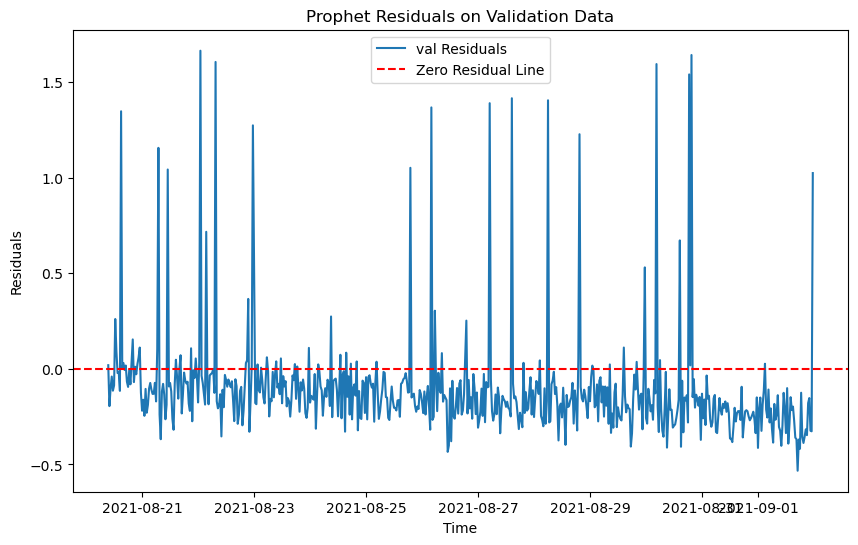

RMSE on training data for Prophet: 0.27688238414772665
RMSE on validation data for Prophet: 0.29911136950964823
RMSE on test data for Prophet: 0.36204913696006763


<Figure size 1000x800 with 0 Axes>

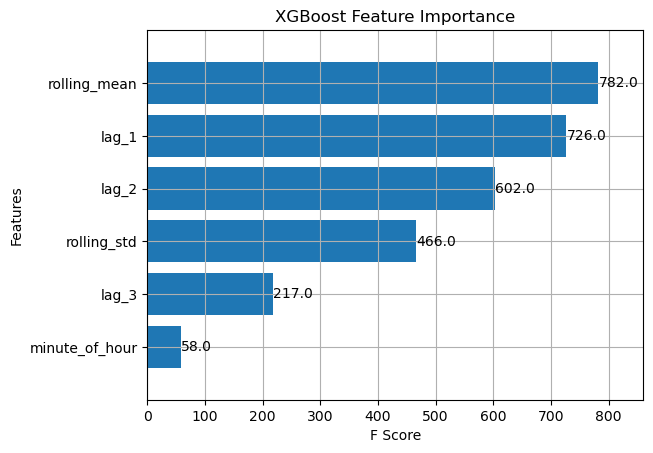

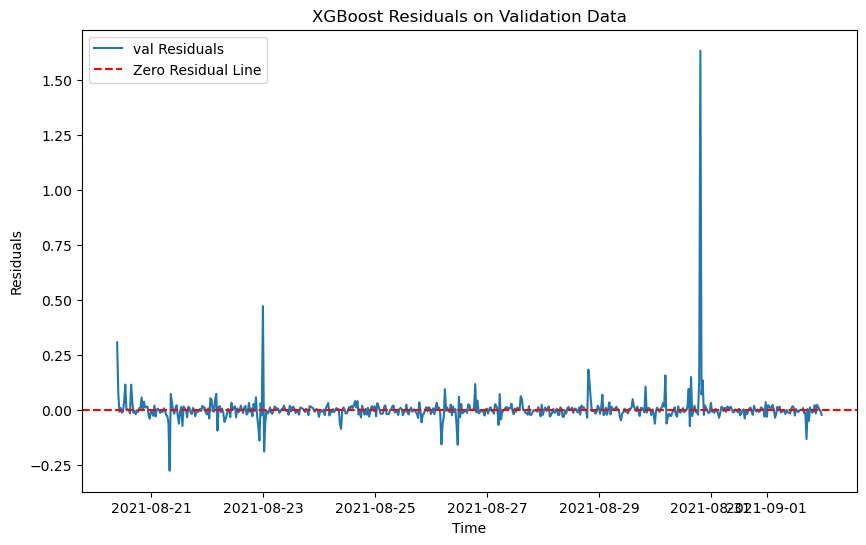

RMSE on training data for XGBoost: 0.015132632326893993
RMSE on validation data for XGBoost: 0.07774344791299882
RMSE on test data for XGBoost: 0.09697059874187655


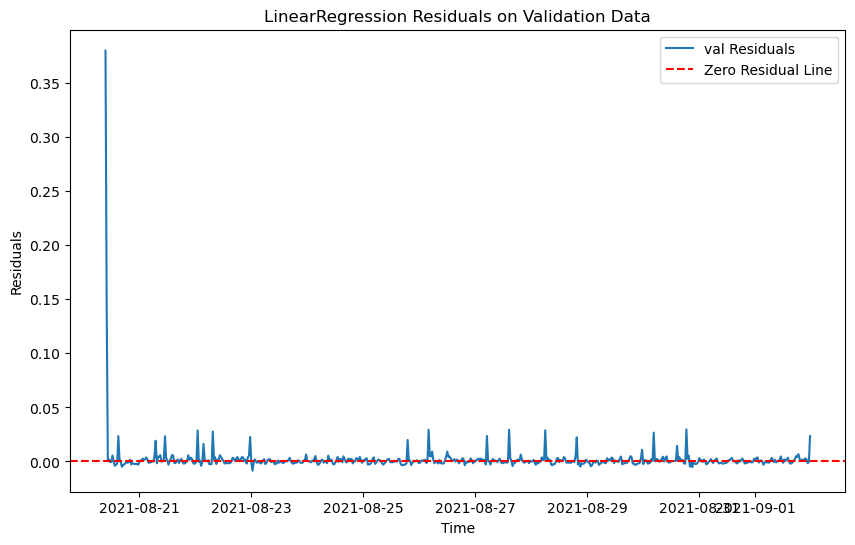

RMSE on training data for LinearRegression: 0.03548019840469913
RMSE on validation data for LinearRegression: 0.01718958343816112
RMSE on test data for LinearRegression: 0.11207607267166855

Best model is LinearRegression with RMSE: 0.01718958343816112
Best model saved as: models\model_212.pkl
data num 27
train_217.csv
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.00018573443258763732
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

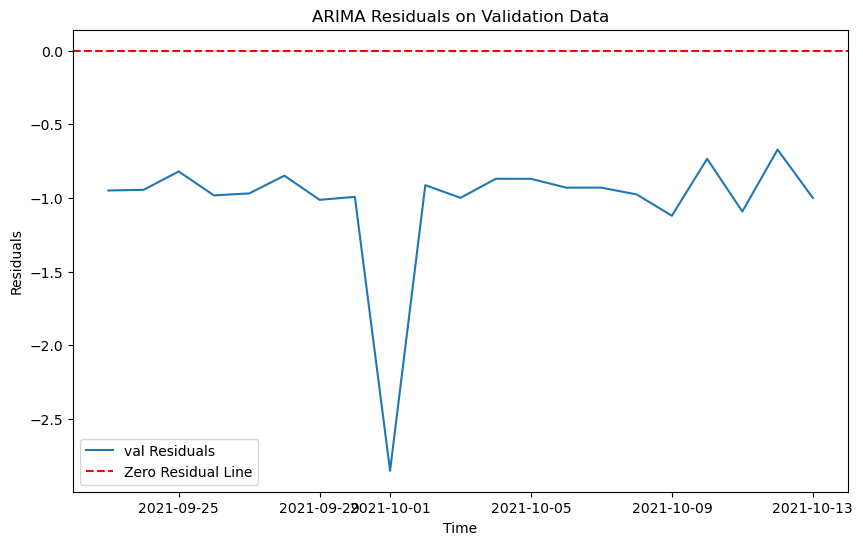

21:44:03 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.27579961175650114
RMSE on validation data for ARIMA: 1.106611089367723
RMSE on test data for ARIMA: 1.941318968990752


21:44:03 - cmdstanpy - INFO - Chain [1] done processing


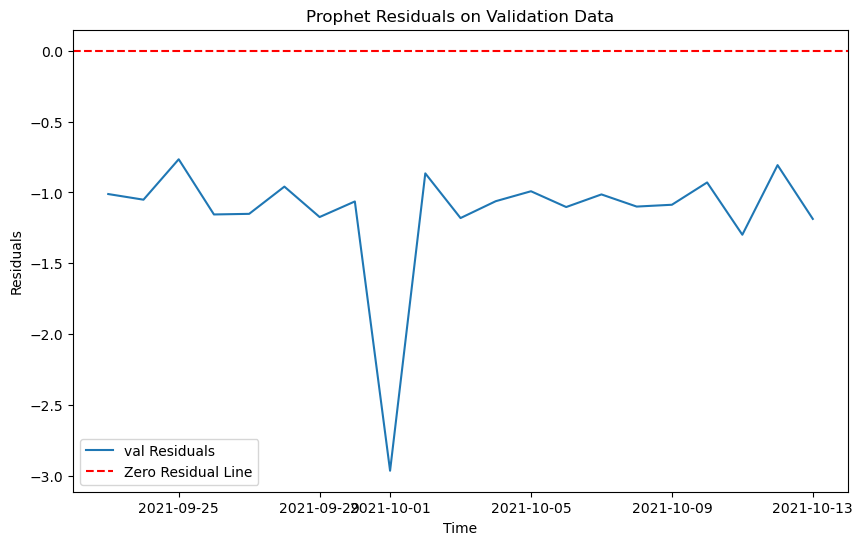

RMSE on training data for Prophet: 0.2709247487573666
RMSE on validation data for Prophet: 1.2164013100243722
RMSE on test data for Prophet: 2.080320518959145


<Figure size 1000x800 with 0 Axes>

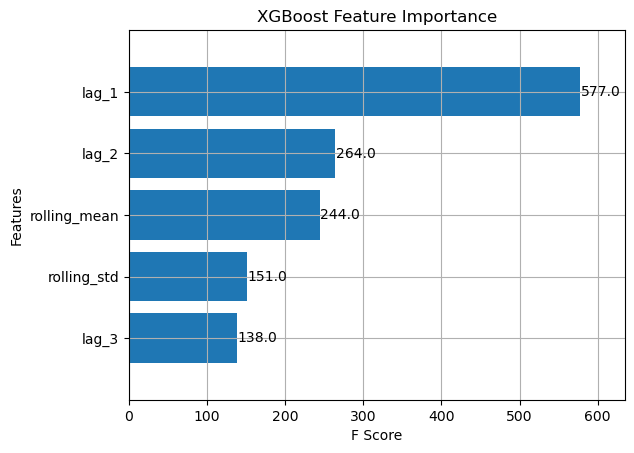

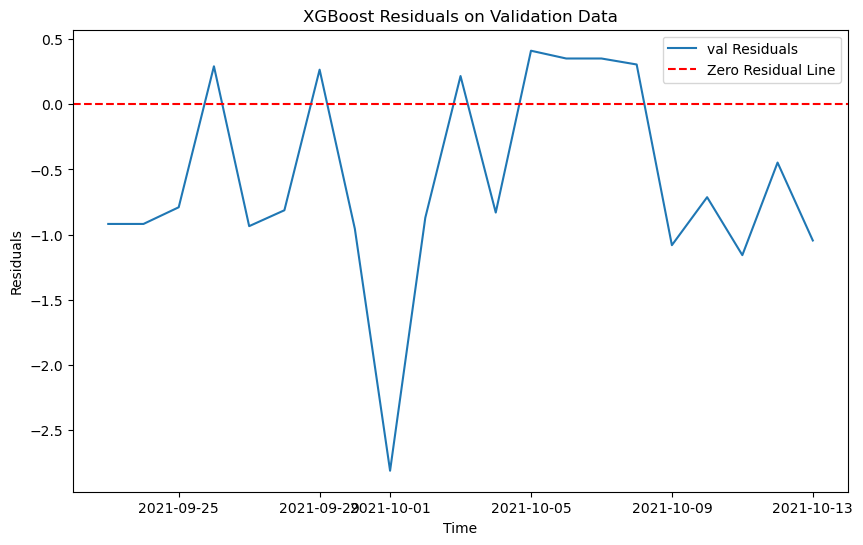

RMSE on training data for XGBoost: 0.0039500013063104
RMSE on validation data for XGBoost: 0.954350153230426
RMSE on test data for XGBoost: 1.911308314911396


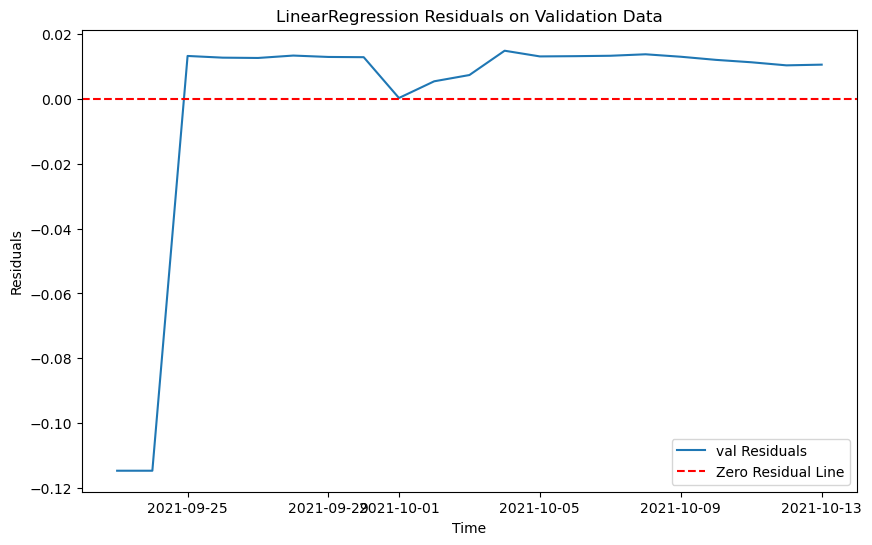

RMSE on training data for LinearRegression: 0.012816927640854512
RMSE on validation data for LinearRegression: 0.03713531695983134
RMSE on test data for LinearRegression: 0.04765608922260606

Best model is LinearRegression with RMSE: 0.03713531695983134
Best model saved as: models\model_217.pkl
data num 28
train_218.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


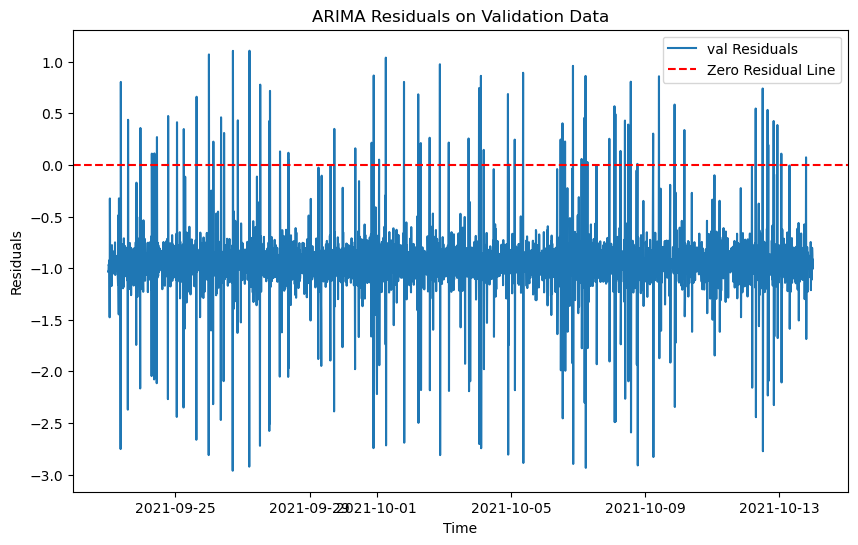

RMSE on training data for ARIMA: 0.2700554170501631
RMSE on validation data for ARIMA: 1.017973275542547
RMSE on test data for ARIMA: 1.9182937921921326


21:44:10 - cmdstanpy - INFO - Chain [1] start processing
21:44:11 - cmdstanpy - INFO - Chain [1] done processing


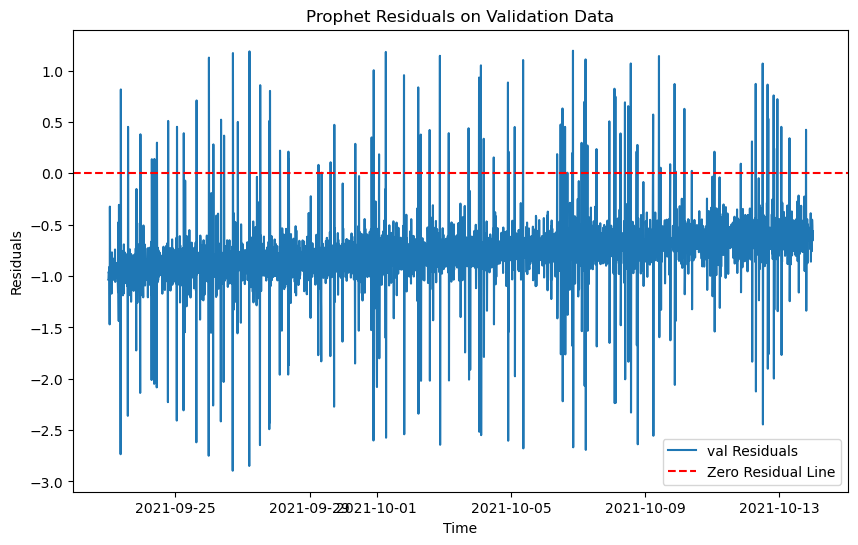

RMSE on training data for Prophet: 0.270060036349225
RMSE on validation data for Prophet: 0.8581743764320912
RMSE on test data for Prophet: 1.5601395183062072


<Figure size 1000x800 with 0 Axes>

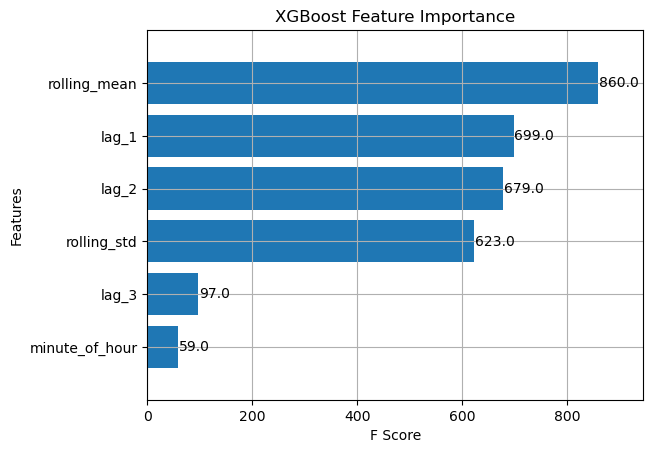

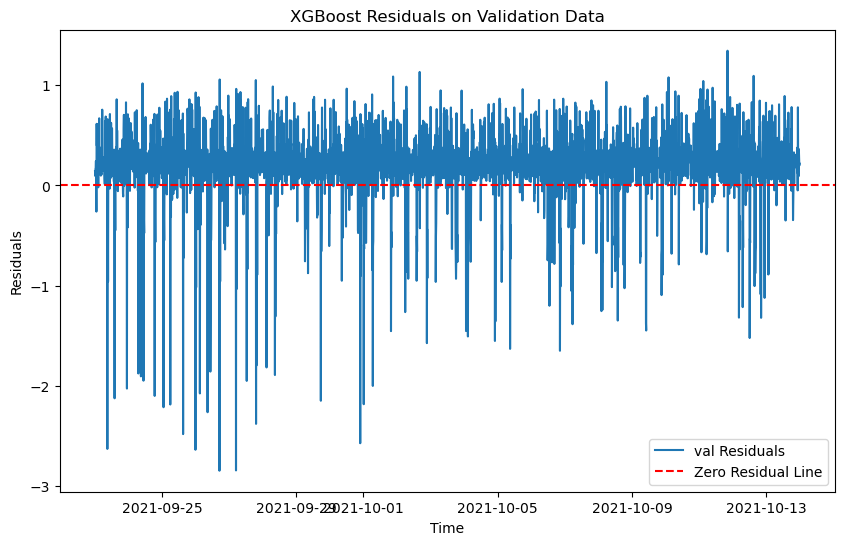

RMSE on training data for XGBoost: 0.020124650905082943
RMSE on validation data for XGBoost: 0.4394710297129145
RMSE on test data for XGBoost: 0.8795397727112264


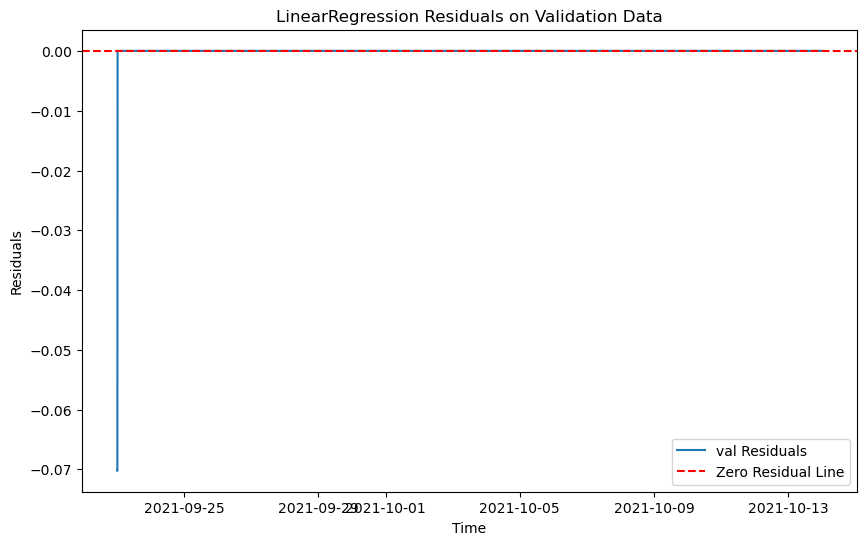

RMSE on training data for LinearRegression: 0.0006587615585281578
RMSE on validation data for LinearRegression: 0.0018068837254170066
RMSE on test data for LinearRegression: 0.0011369728753022673

Best model is LinearRegression with RMSE: 0.0018068837254170066
Best model saved as: models\model_218.pkl
data num 29
train_227.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to co

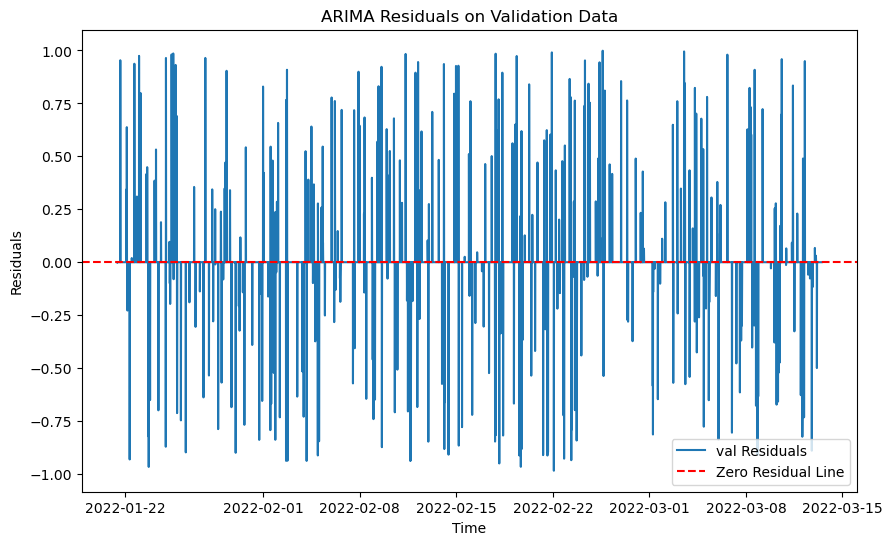

RMSE on training data for ARIMA: 0.20872892867224108
RMSE on validation data for ARIMA: 0.13456250770675093
RMSE on test data for ARIMA: 0.9027169733779675


21:45:04 - cmdstanpy - INFO - Chain [1] start processing
21:45:05 - cmdstanpy - INFO - Chain [1] done processing


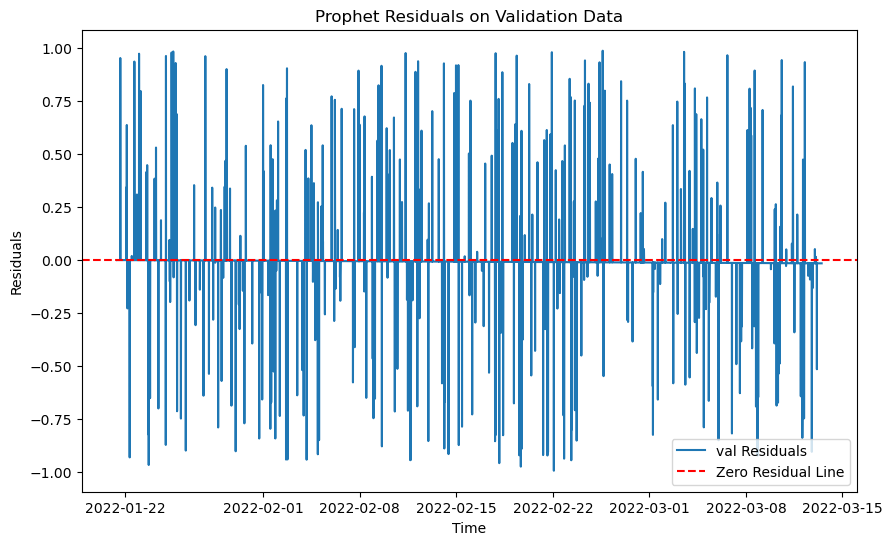

RMSE on training data for Prophet: 0.2818060358278499
RMSE on validation data for Prophet: 0.13481746912976214
RMSE on test data for Prophet: 0.885914687825398


<Figure size 1000x800 with 0 Axes>

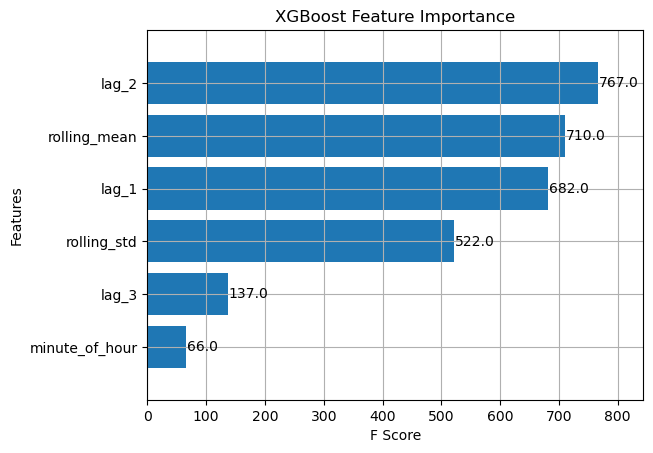

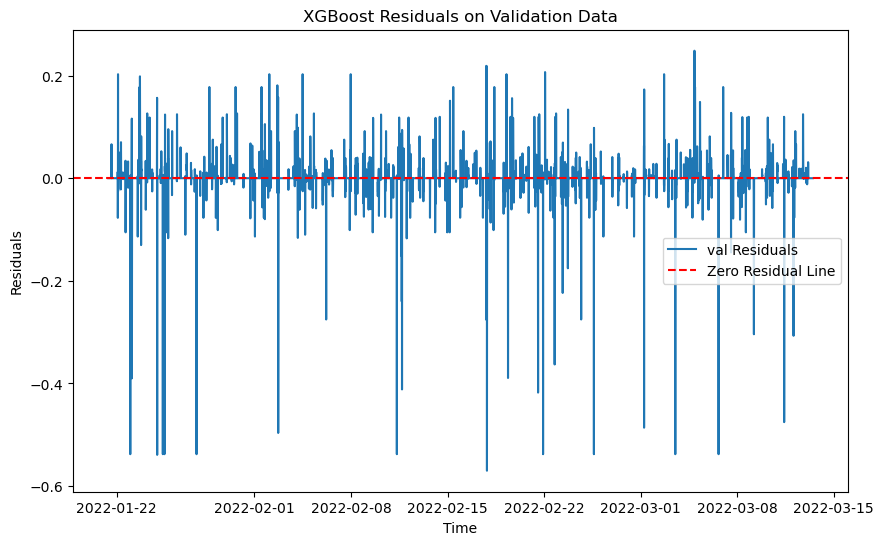

RMSE on training data for XGBoost: 0.024598432251966455
RMSE on validation data for XGBoost: 0.03376833507213224
RMSE on test data for XGBoost: 0.5875067575450349


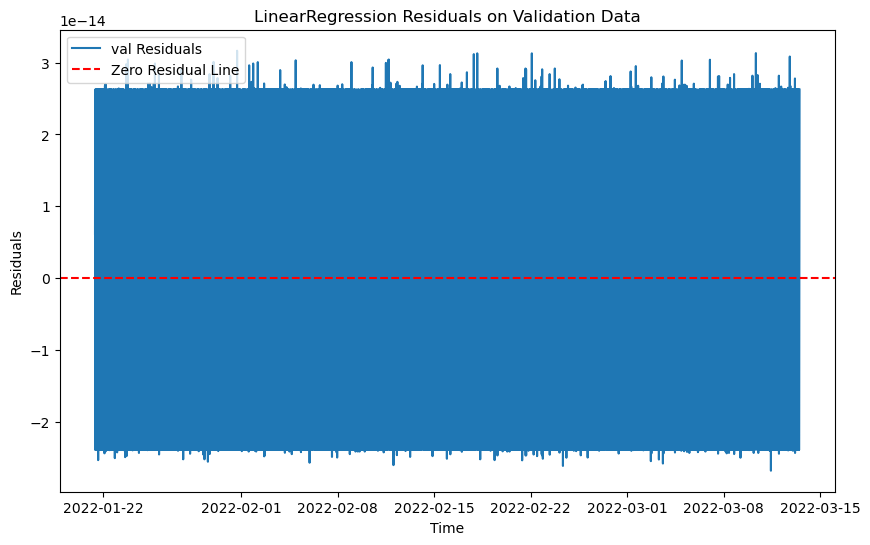

RMSE on training data for LinearRegression: 1.7186276817661493e-14
RMSE on validation data for LinearRegression: 1.7196685958592905e-14
RMSE on test data for LinearRegression: 0.002043167058599451

Best model is LinearRegression with RMSE: 1.7196685958592905e-14
Best model saved as: models\model_227.pkl
data num 30
train_23.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.3570946731008256e-25
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.68378437044115e-14
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

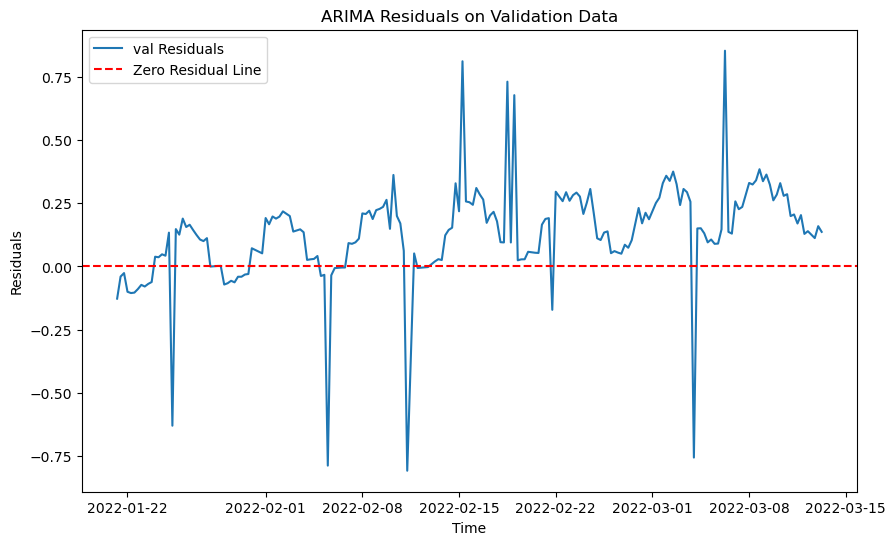

21:45:22 - cmdstanpy - INFO - Chain [1] start processing
21:45:22 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.20024488855074346
RMSE on validation data for ARIMA: 0.23492995765060262
RMSE on test data for ARIMA: 0.2291075931631424


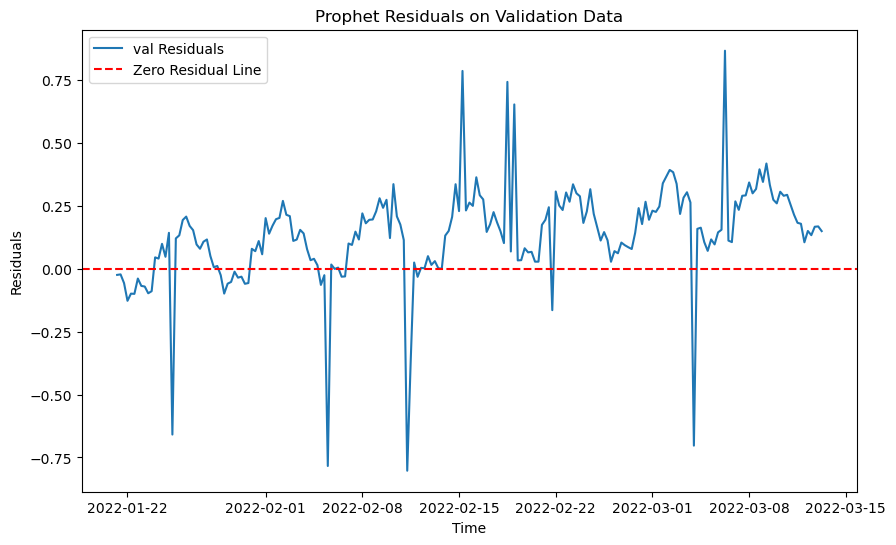

RMSE on training data for Prophet: 0.2454928587277408
RMSE on validation data for Prophet: 0.23788161375353575
RMSE on test data for Prophet: 0.2330845739721297


<Figure size 1000x800 with 0 Axes>

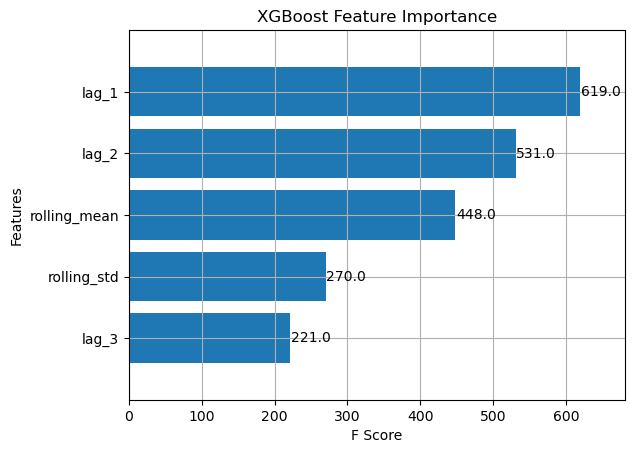

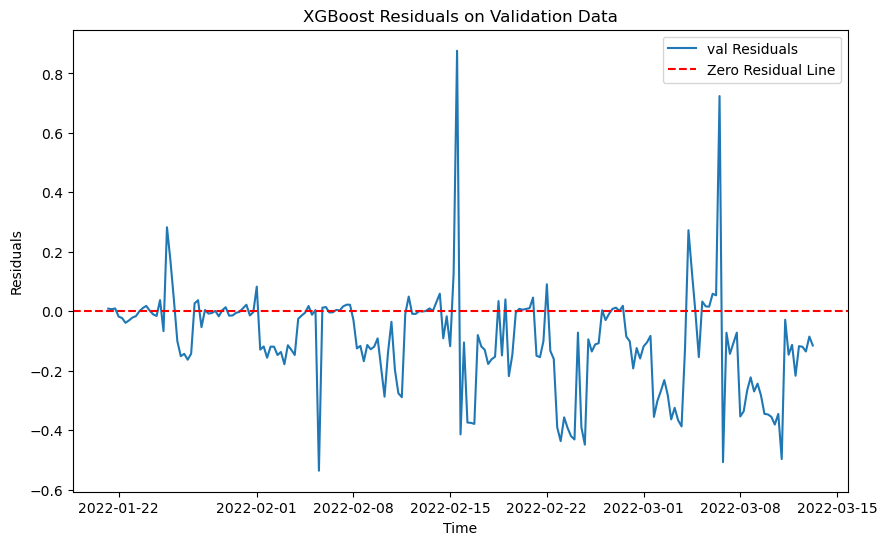

RMSE on training data for XGBoost: 0.011959122162698215
RMSE on validation data for XGBoost: 0.1970172458555045
RMSE on test data for XGBoost: 0.2049949104975967


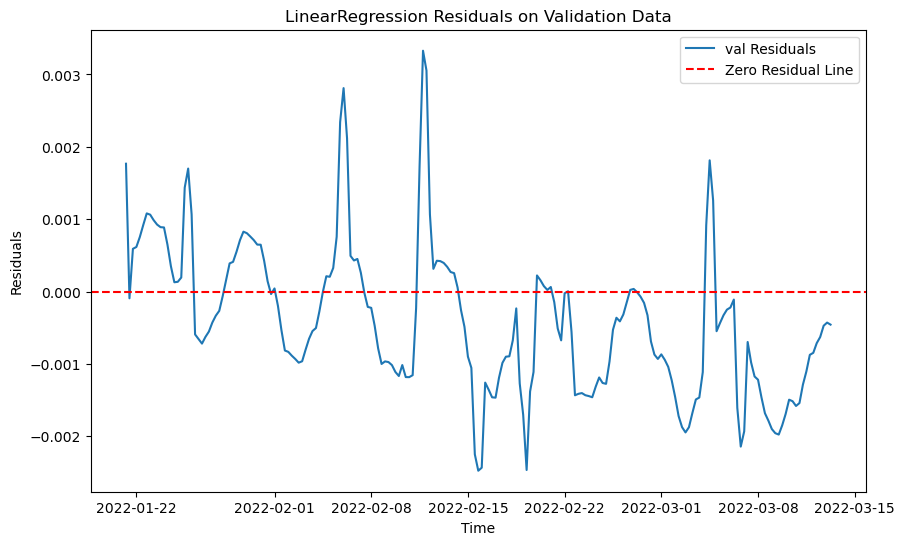

RMSE on training data for LinearRegression: 0.009708481857315938
RMSE on validation data for LinearRegression: 0.0011022646294979314
RMSE on test data for LinearRegression: 0.005636050710928131

Best model is LinearRegression with RMSE: 0.0011022646294979314
Best model saved as: models\model_23.pkl
data num 31
train_242.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.5996911277678867e-30
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


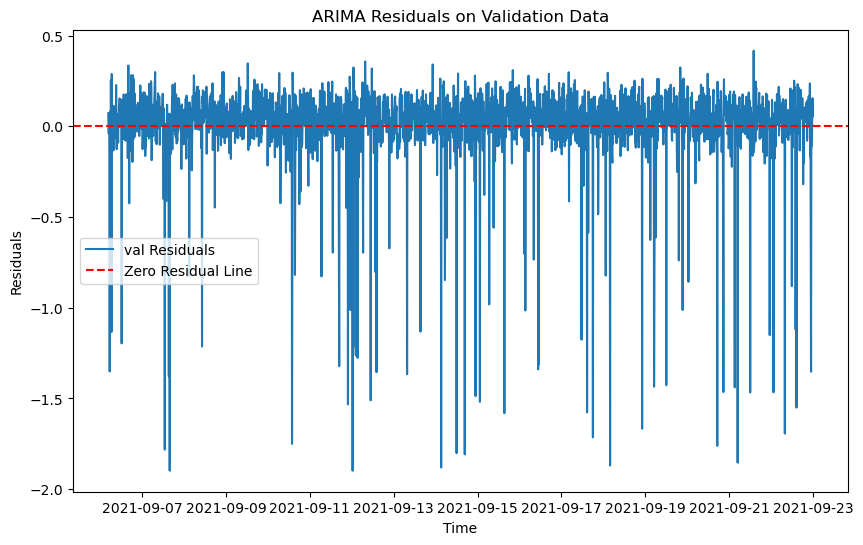

RMSE on training data for ARIMA: 0.2681814701081444
RMSE on validation data for ARIMA: 0.24784211059195096
RMSE on test data for ARIMA: 1.019763201339154


21:45:28 - cmdstanpy - INFO - Chain [1] start processing
21:45:29 - cmdstanpy - INFO - Chain [1] done processing


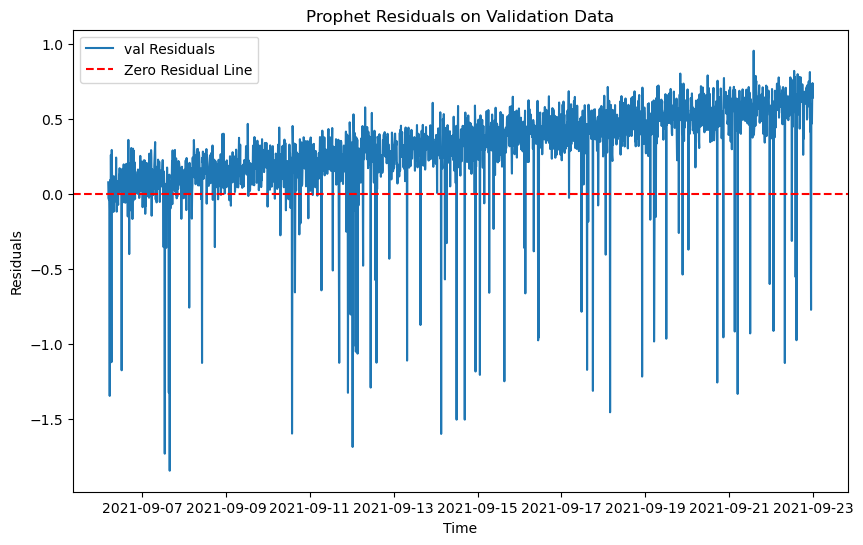

RMSE on training data for Prophet: 0.2683801513533559
RMSE on validation data for Prophet: 0.4237990247117008
RMSE on test data for Prophet: 0.6082238051694663


<Figure size 1000x800 with 0 Axes>

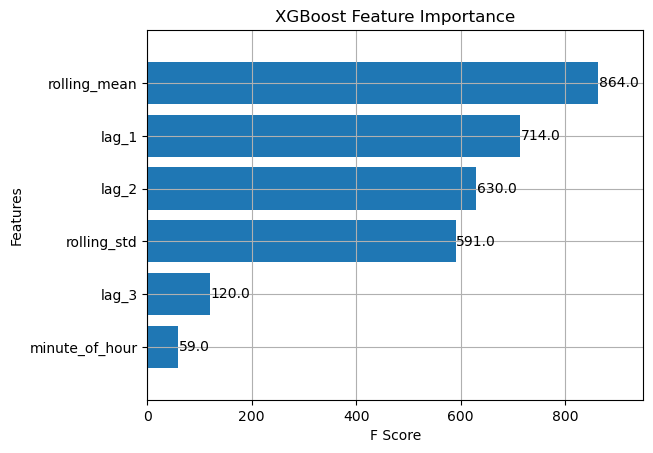

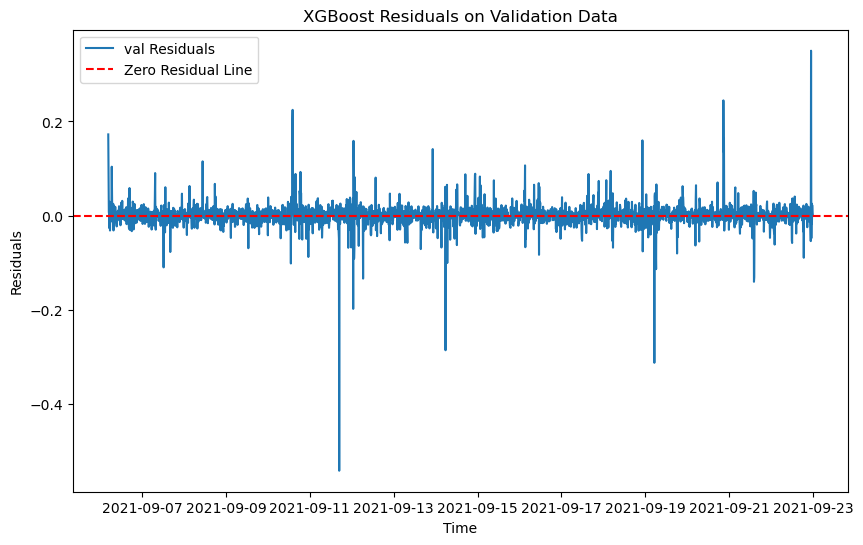

RMSE on training data for XGBoost: 0.019531186868601766
RMSE on validation data for XGBoost: 0.02838099633649297
RMSE on test data for XGBoost: 0.318380625235647


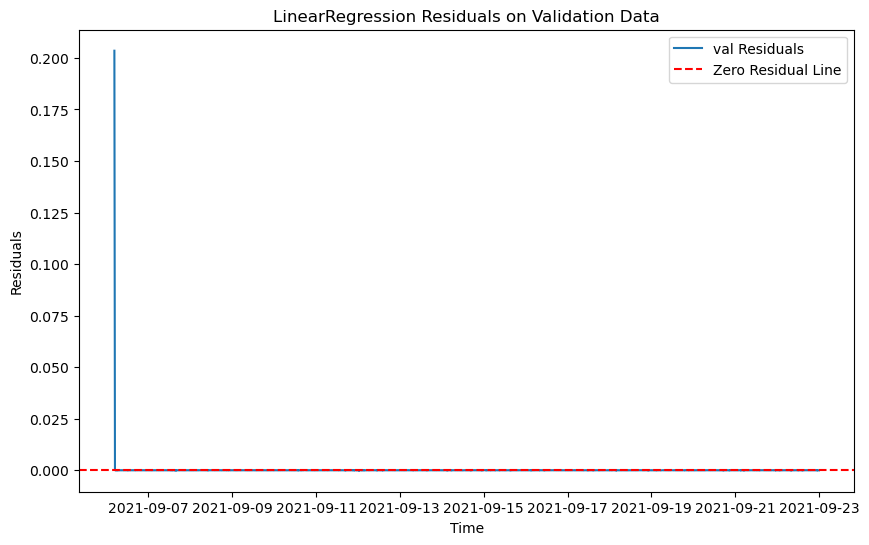

RMSE on training data for LinearRegression: 0.0020983926894791822
RMSE on validation data for LinearRegression: 0.004714881529364909
RMSE on test data for LinearRegression: 0.0018857692294701274

Best model is LinearRegression with RMSE: 0.004714881529364909
Best model saved as: models\model_242.pkl
data num 32
train_246.csv
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 9.905677019461518e-15
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

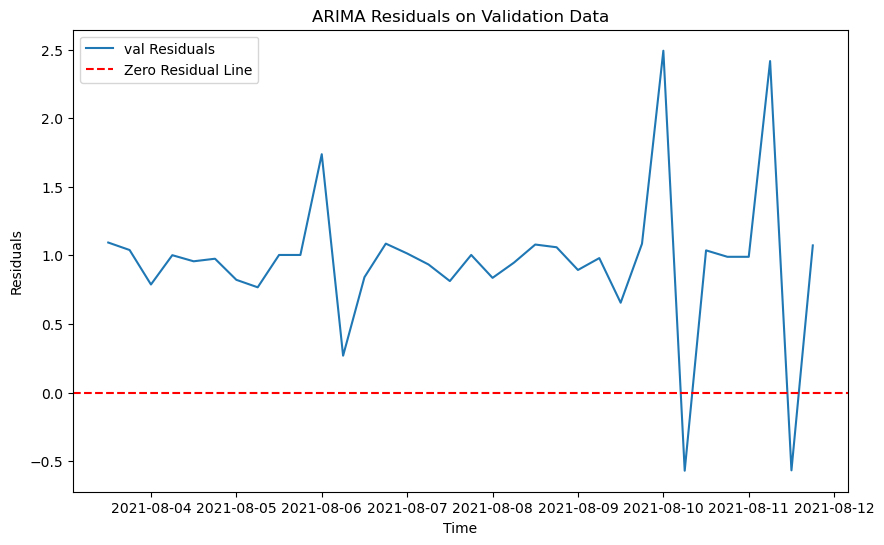

21:45:36 - cmdstanpy - INFO - Chain [1] start processing
21:45:36 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2735469558680715
RMSE on validation data for ARIMA: 1.10749018826973
RMSE on test data for ARIMA: 0.3019799970164471


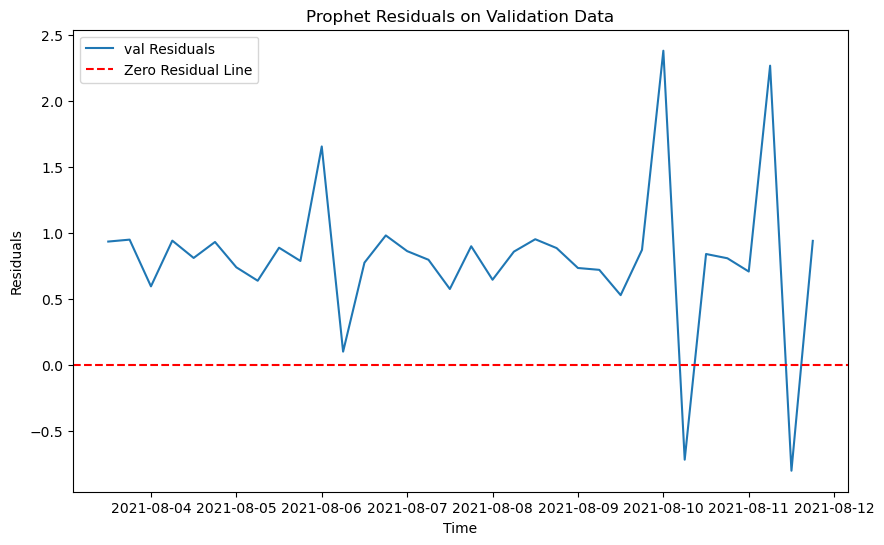

RMSE on training data for Prophet: 0.2705151549566405
RMSE on validation data for Prophet: 0.9910657092063099
RMSE on test data for Prophet: 0.37634437295553863


<Figure size 1000x800 with 0 Axes>

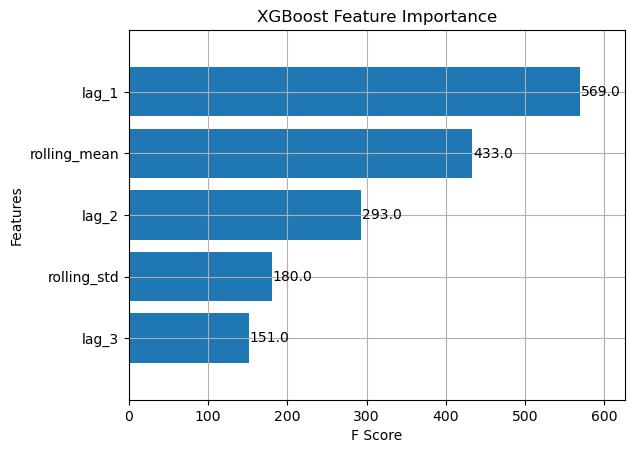

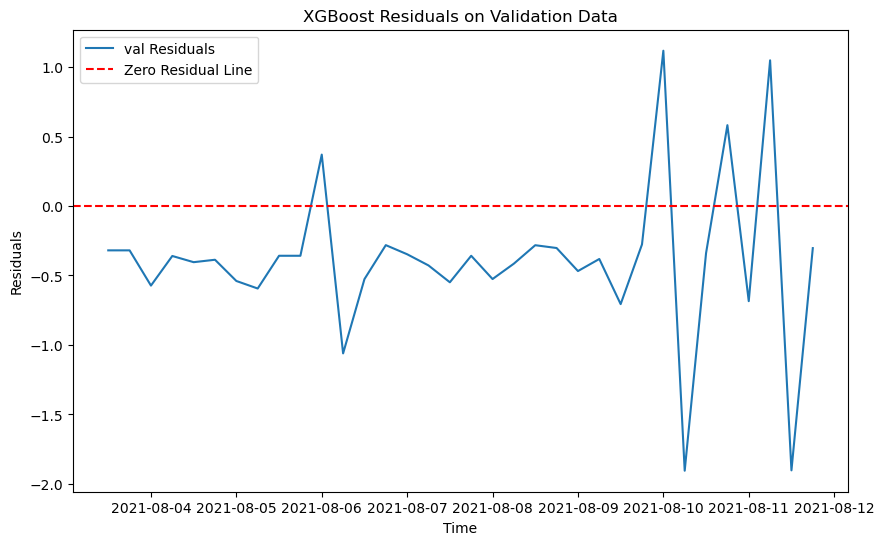

RMSE on training data for XGBoost: 0.008002083095862733
RMSE on validation data for XGBoost: 0.6944638131135709
RMSE on test data for XGBoost: 0.2570279602254492


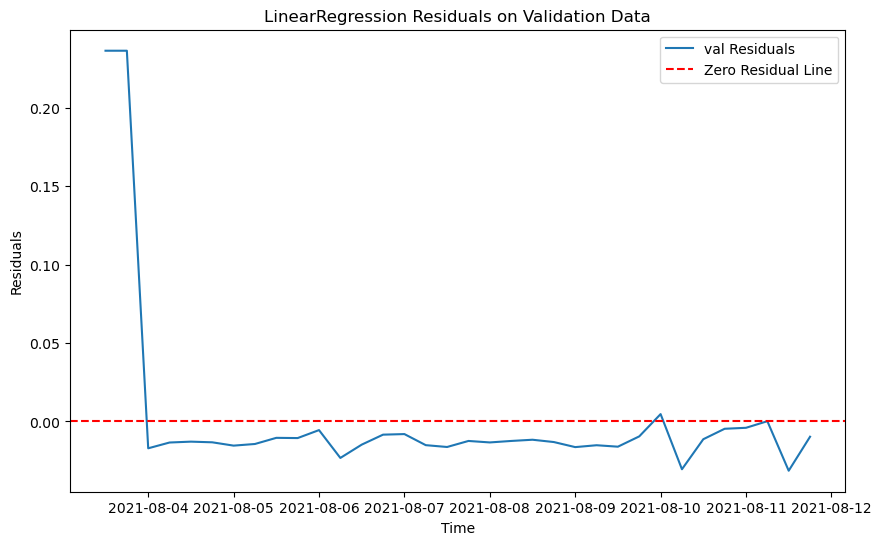

RMSE on training data for LinearRegression: 0.03193759461084738
RMSE on validation data for LinearRegression: 0.05905503157662079
RMSE on test data for LinearRegression: 0.01192367488729116

Best model is LinearRegression with RMSE: 0.05905503157662079
Best model saved as: models\model_246.pkl
data num 33
train_251.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

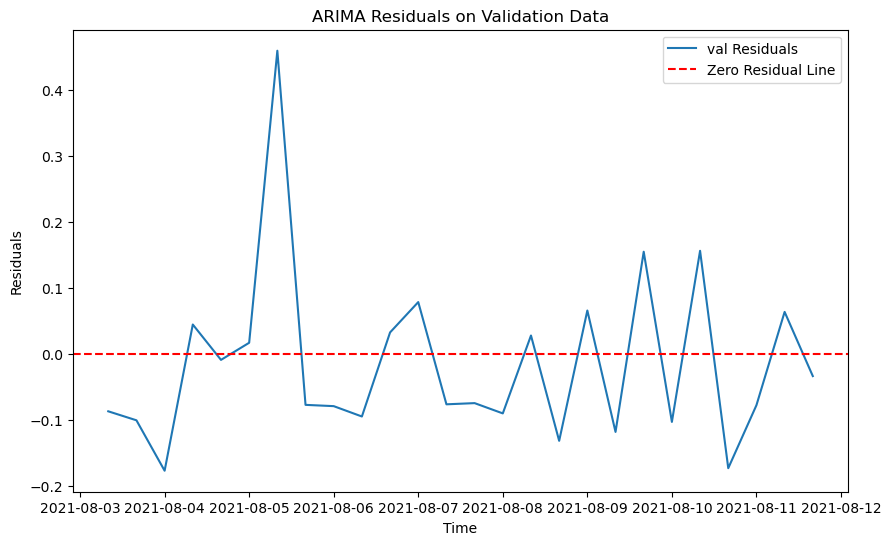

21:45:38 - cmdstanpy - INFO - Chain [1] start processing
21:45:38 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.18147877330503565
RMSE on validation data for ARIMA: 0.1312376852427159
RMSE on test data for ARIMA: 0.31963508927356526


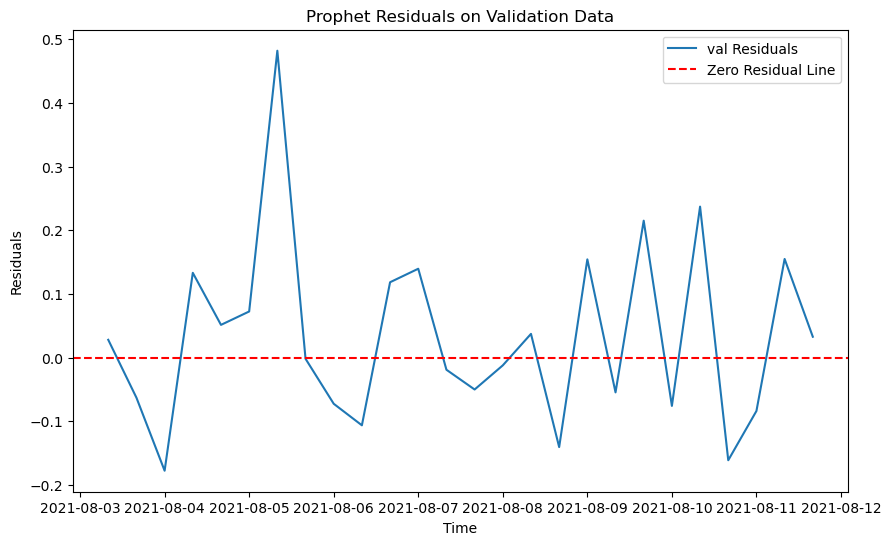

RMSE on training data for Prophet: 0.17665463740054532
RMSE on validation data for Prophet: 0.14693393390800003
RMSE on test data for Prophet: 0.33322517337049995


<Figure size 1000x800 with 0 Axes>

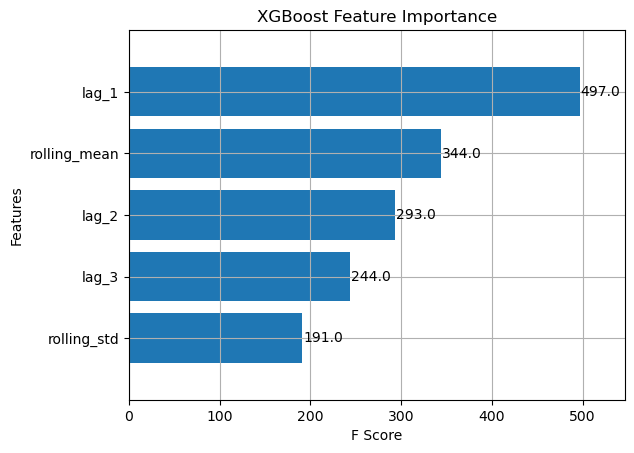

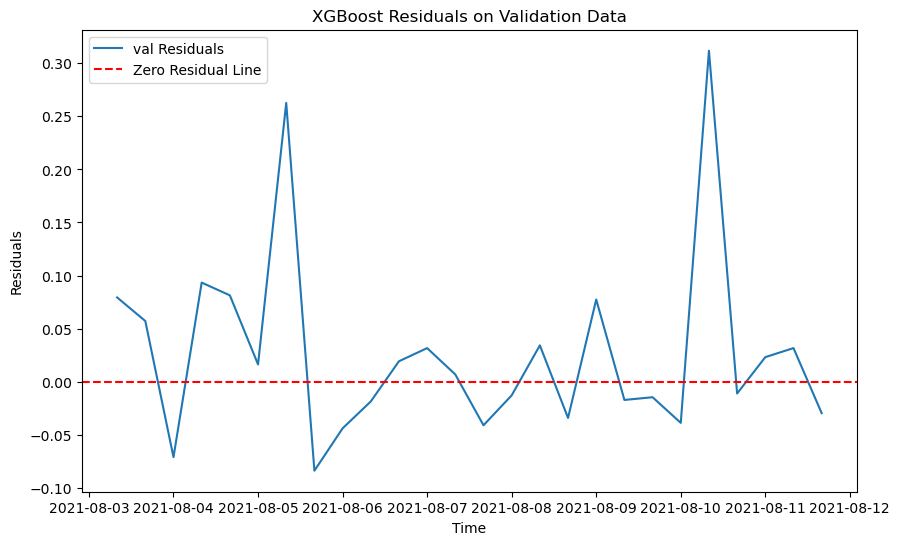

RMSE on training data for XGBoost: 0.007011822927318391
RMSE on validation data for XGBoost: 0.09237927459388684
RMSE on test data for XGBoost: 0.25476542354212095


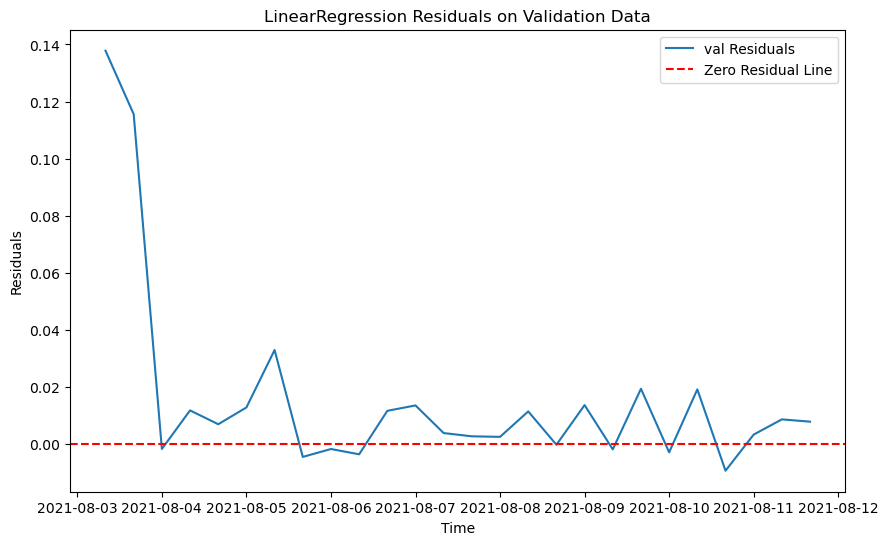

RMSE on training data for LinearRegression: 0.04720044219388779
RMSE on validation data for LinearRegression: 0.03694356838425679
RMSE on test data for LinearRegression: 0.026697972820027914

Best model is LinearRegression with RMSE: 0.03694356838425679
Best model saved as: models\model_251.pkl
data num 34
train_256.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


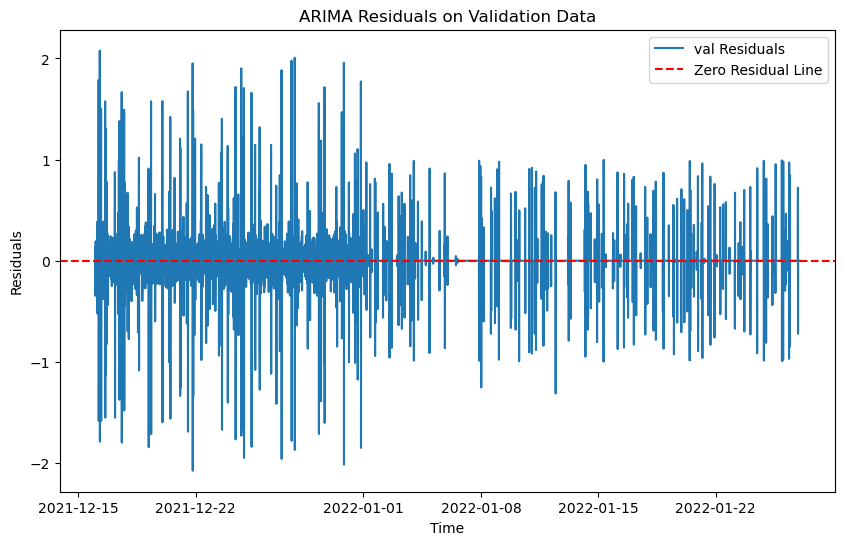

RMSE on training data for ARIMA: 0.21032171014543133
RMSE on validation data for ARIMA: 0.2551851896256802
RMSE on test data for ARIMA: 0.25359796395479844


21:46:08 - cmdstanpy - INFO - Chain [1] start processing
21:46:09 - cmdstanpy - INFO - Chain [1] done processing


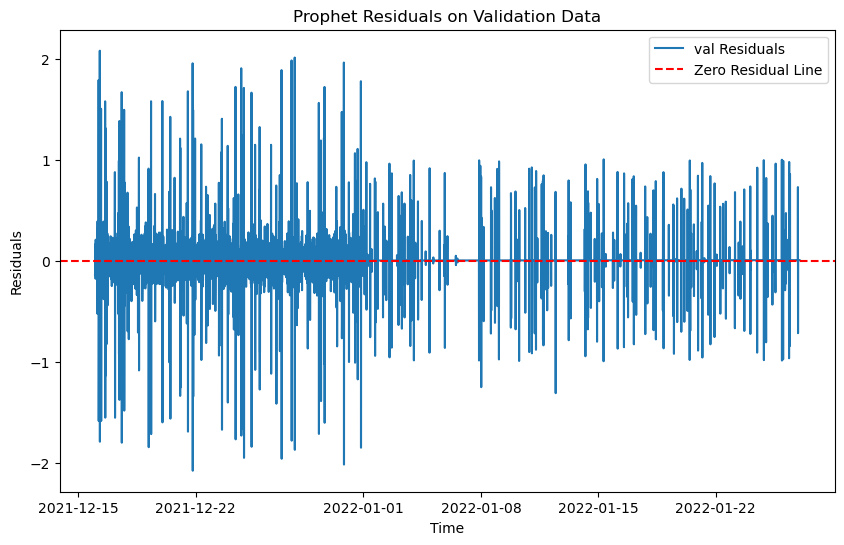

RMSE on training data for Prophet: 0.28714617746796056
RMSE on validation data for Prophet: 0.25520224412403536
RMSE on test data for Prophet: 0.25374870523732784


<Figure size 1000x800 with 0 Axes>

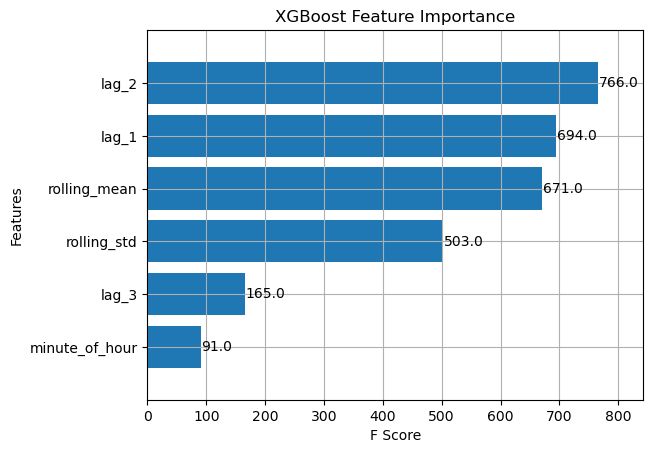

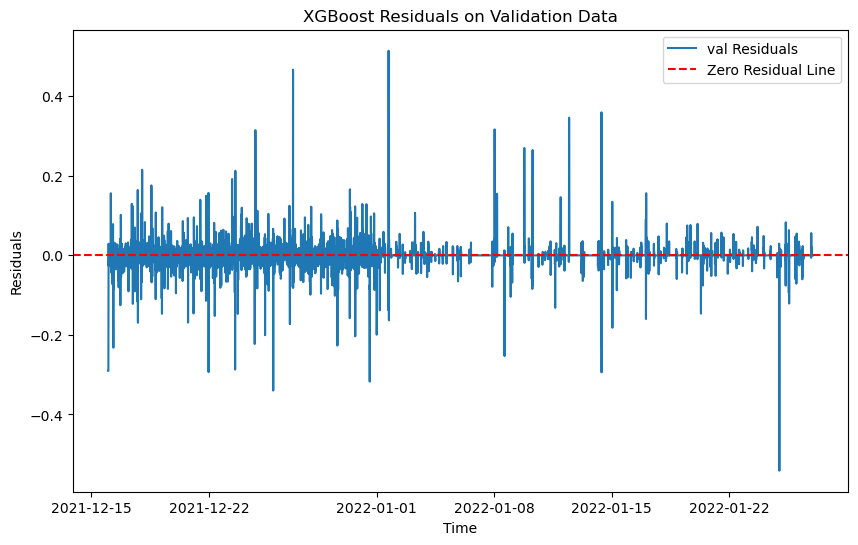

RMSE on training data for XGBoost: 0.02441737596569391
RMSE on validation data for XGBoost: 0.03132459159249342
RMSE on test data for XGBoost: 0.12510160174143853


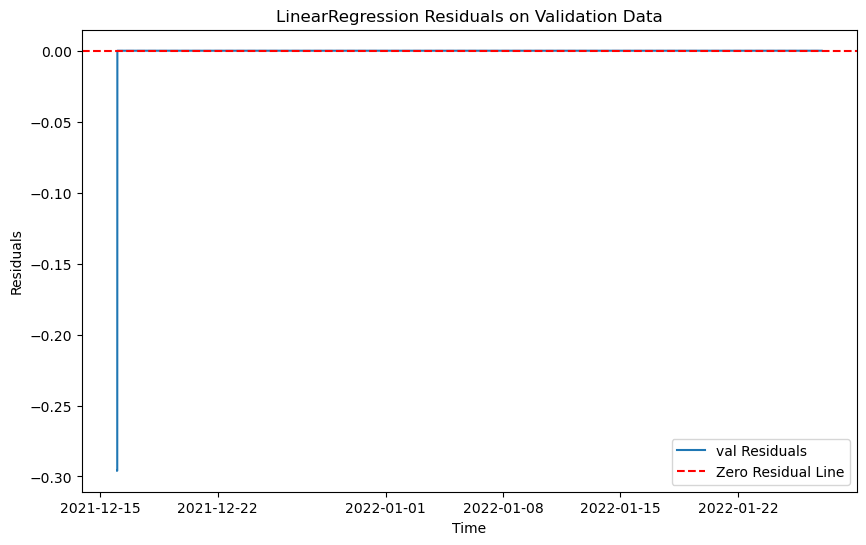

RMSE on training data for LinearRegression: 8.296029681604093e-16
RMSE on validation data for LinearRegression: 0.005381438860317583
RMSE on test data for LinearRegression: 8.317818762139774e-16

Best model is LinearRegression with RMSE: 0.005381438860317583
Best model saved as: models\model_256.pkl
data num 35
train_272.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


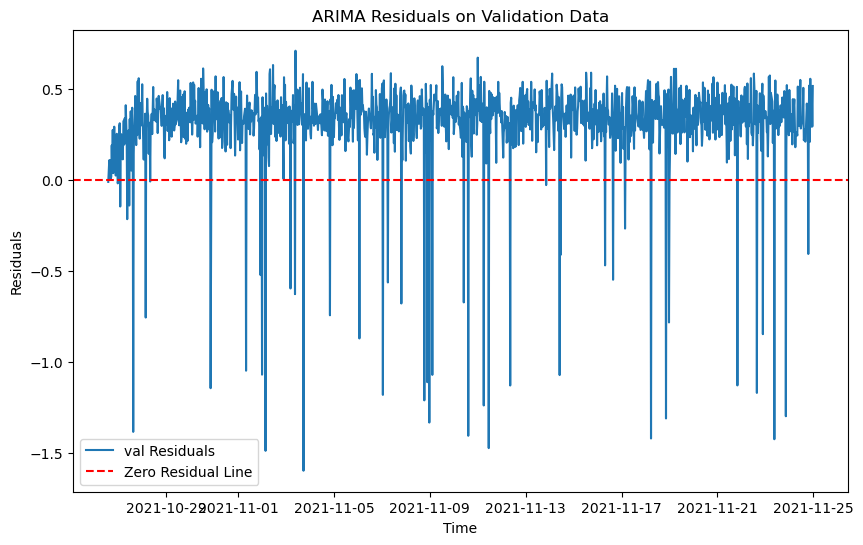

RMSE on training data for ARIMA: 0.27259719019009915
RMSE on validation data for ARIMA: 0.4005919535899154
RMSE on test data for ARIMA: 0.39534097960358705


21:46:27 - cmdstanpy - INFO - Chain [1] start processing
21:46:28 - cmdstanpy - INFO - Chain [1] done processing


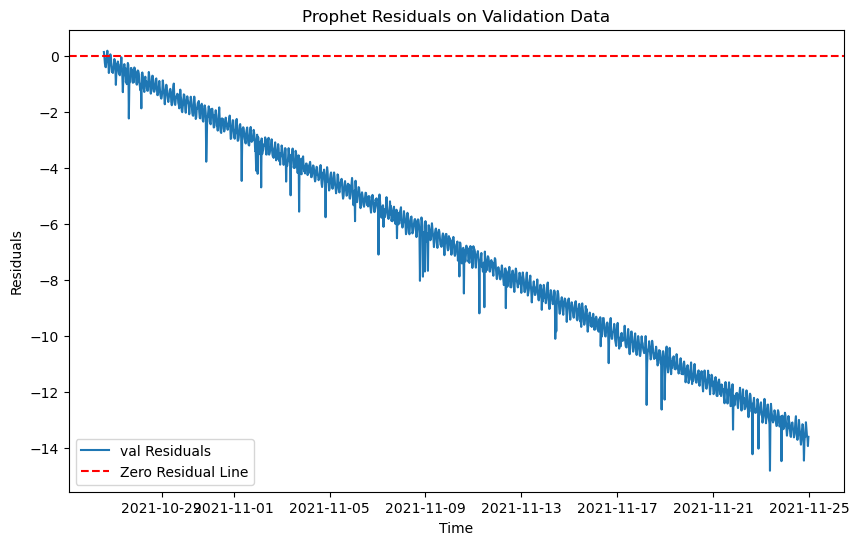

RMSE on training data for Prophet: 0.3407150659041072
RMSE on validation data for Prophet: 7.91355929669705
RMSE on test data for Prophet: 16.81659372712108


<Figure size 1000x800 with 0 Axes>

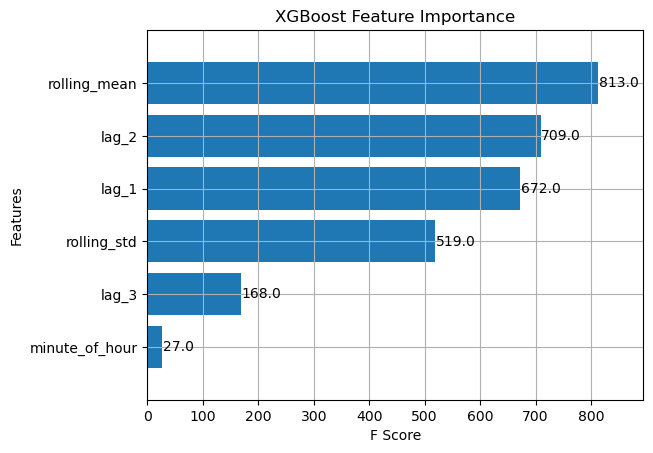

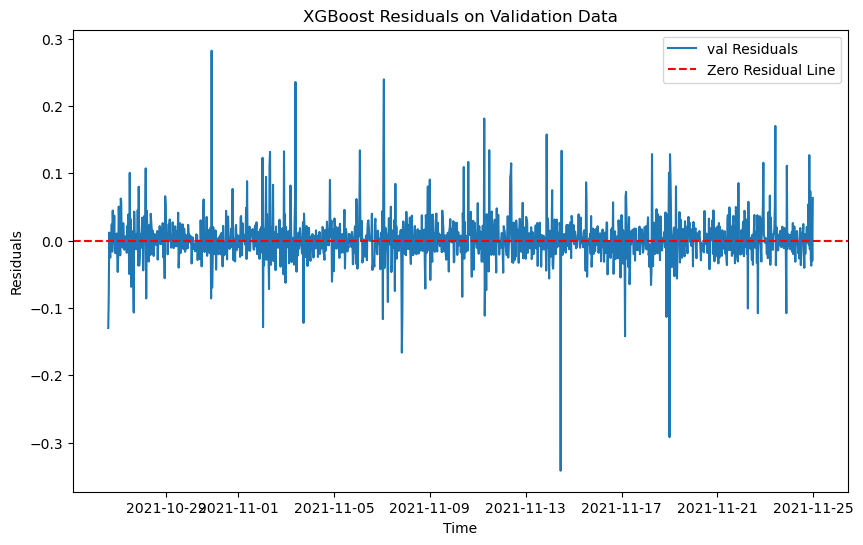

RMSE on training data for XGBoost: 0.032419366140578235
RMSE on validation data for XGBoost: 0.03563915533829694
RMSE on test data for XGBoost: 0.03806178663465327


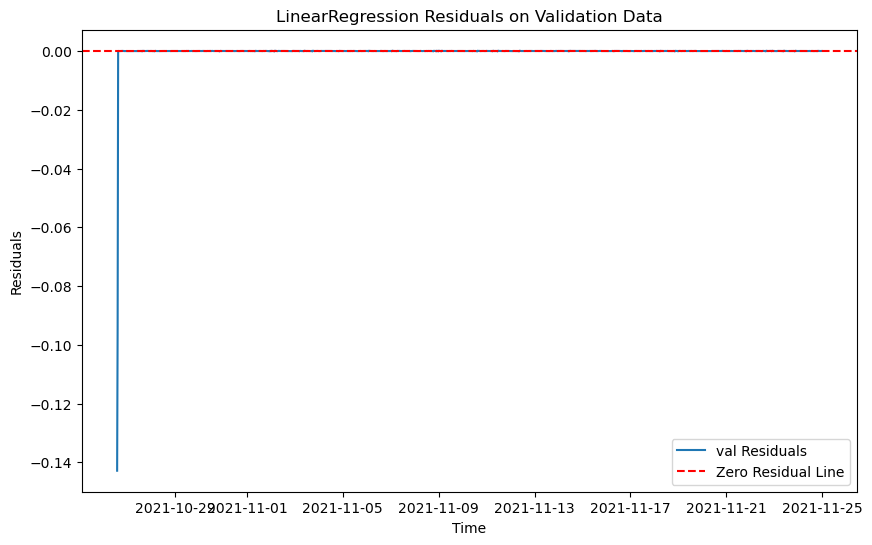

RMSE on training data for LinearRegression: 0.0027178810987553066
RMSE on validation data for LinearRegression: 0.00455878479924253
RMSE on test data for LinearRegression: 0.0009609242401376143

Best model is LinearRegression with RMSE: 0.00455878479924253
Best model saved as: models\model_272.pkl
data num 36
train_287.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


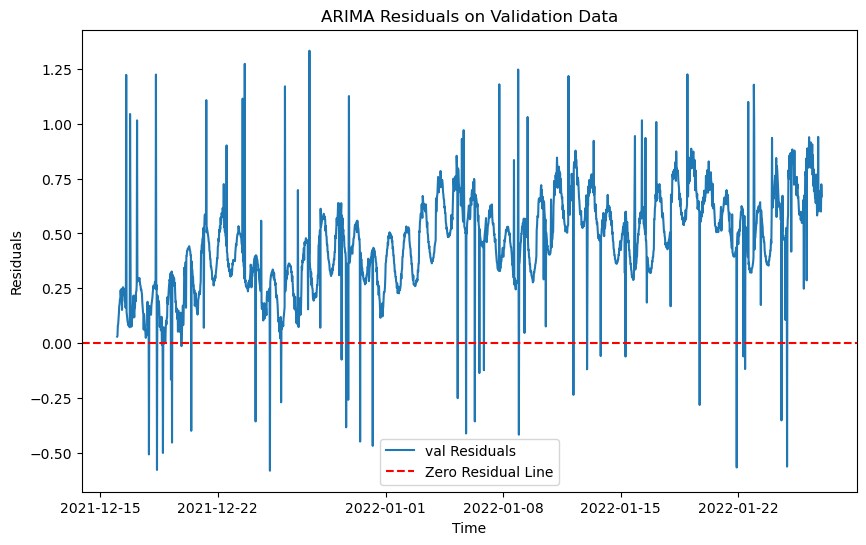

RMSE on training data for ARIMA: 0.18881216244463395
RMSE on validation data for ARIMA: 0.5078341013165749
RMSE on test data for ARIMA: 0.8765859192427039


21:46:38 - cmdstanpy - INFO - Chain [1] start processing
21:46:38 - cmdstanpy - INFO - Chain [1] done processing


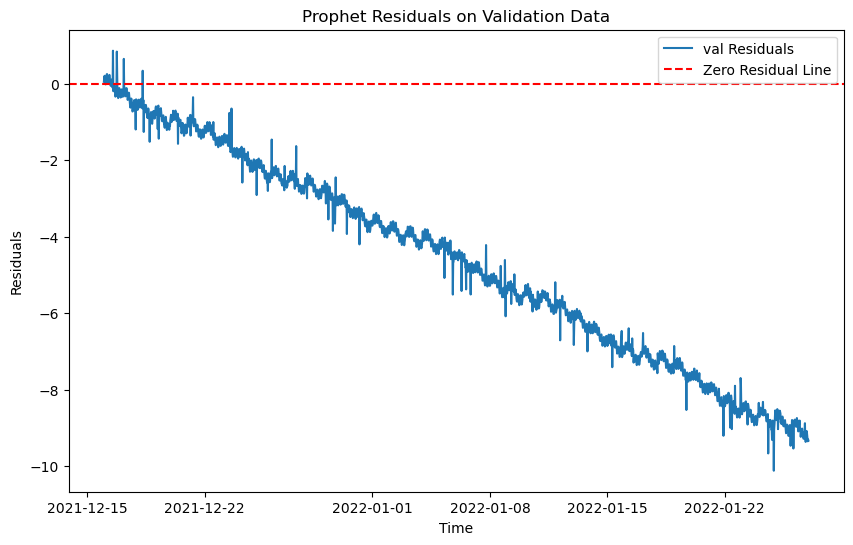

RMSE on training data for Prophet: 0.17577502637607786
RMSE on validation data for Prophet: 5.351269139775138
RMSE on test data for Prophet: 11.362505891537168


<Figure size 1000x800 with 0 Axes>

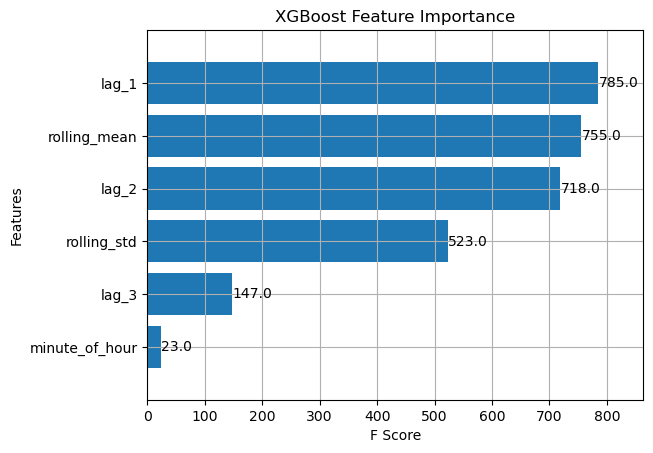

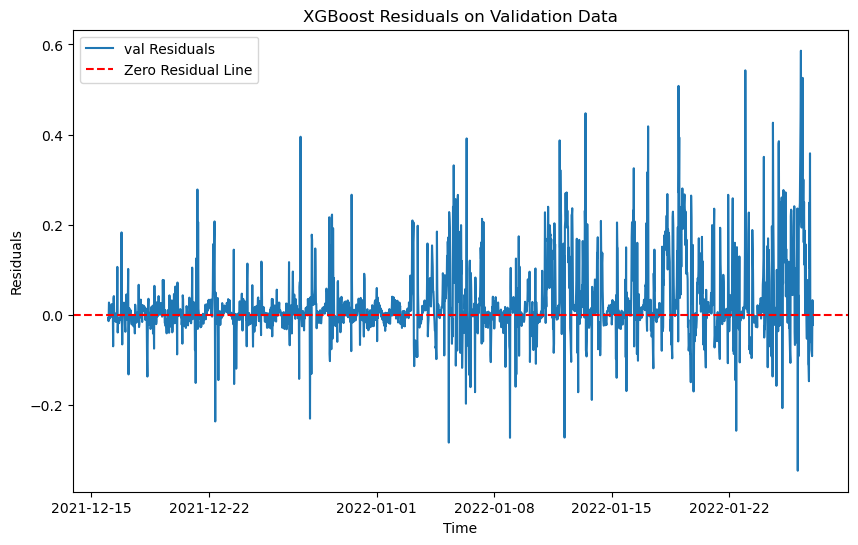

RMSE on training data for XGBoost: 0.02420719236334225
RMSE on validation data for XGBoost: 0.08980204278979048
RMSE on test data for XGBoost: 0.5820864843354457


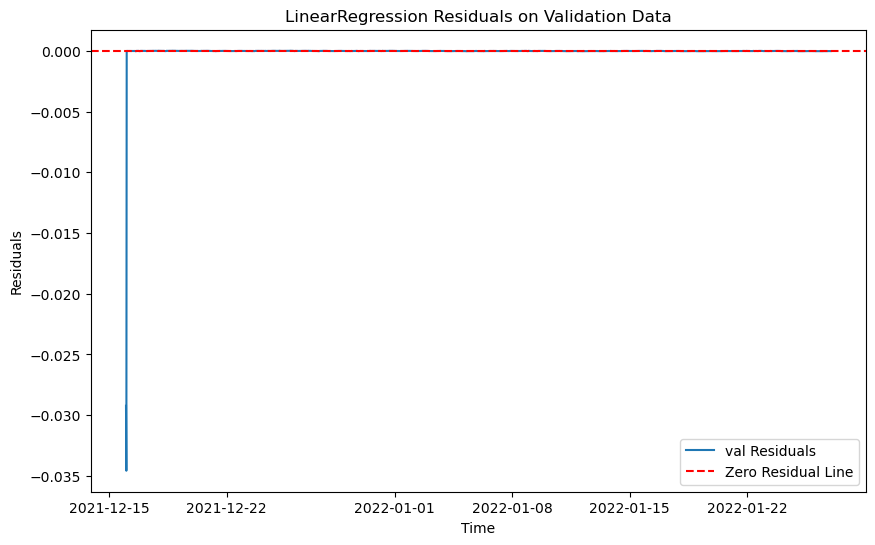

RMSE on training data for LinearRegression: 0.0003679891887080932
RMSE on validation data for LinearRegression: 0.0010084511630899498
RMSE on test data for LinearRegression: 0.0016900412220180255

Best model is LinearRegression with RMSE: 0.0010084511630899498
Best model saved as: models\model_287.pkl
data num 37
train_29.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


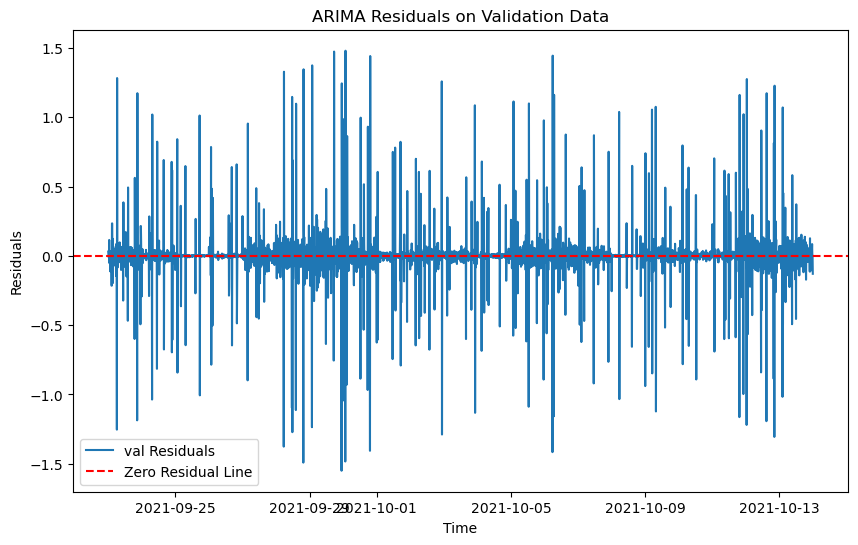

RMSE on training data for ARIMA: 0.1732922768716257
RMSE on validation data for ARIMA: 0.22783962505163527
RMSE on test data for ARIMA: 0.5211417069015637


21:46:56 - cmdstanpy - INFO - Chain [1] start processing
21:46:57 - cmdstanpy - INFO - Chain [1] done processing


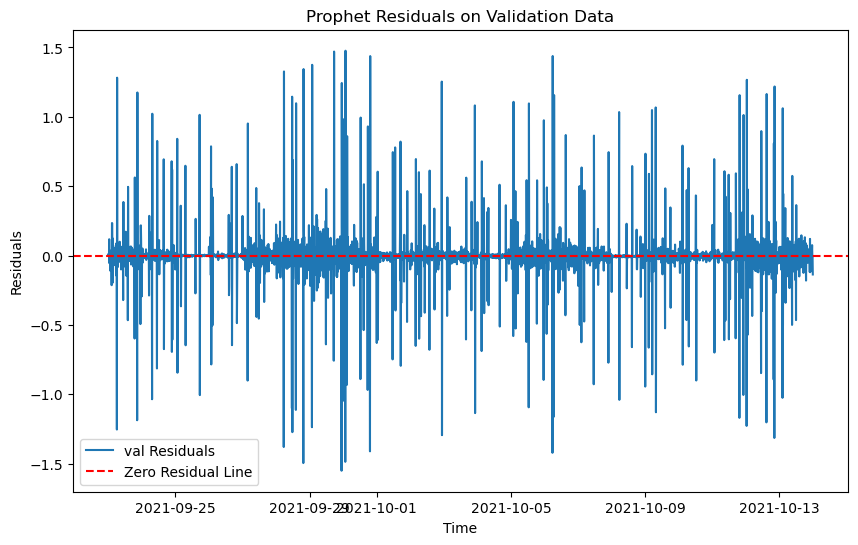

RMSE on training data for Prophet: 0.2249803007484514
RMSE on validation data for Prophet: 0.22787940295475717
RMSE on test data for Prophet: 0.5124691550876537


<Figure size 1000x800 with 0 Axes>

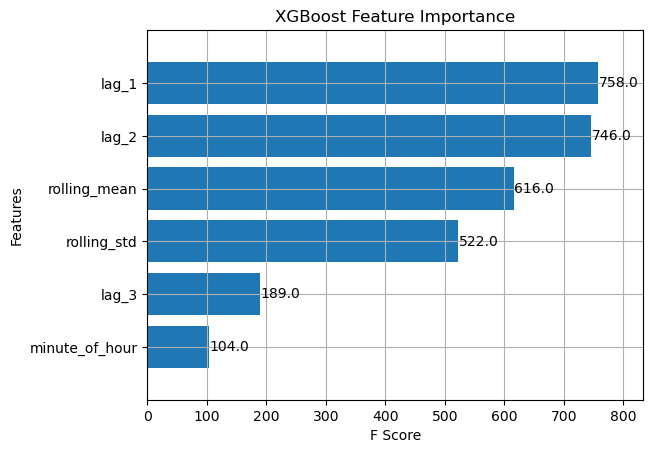

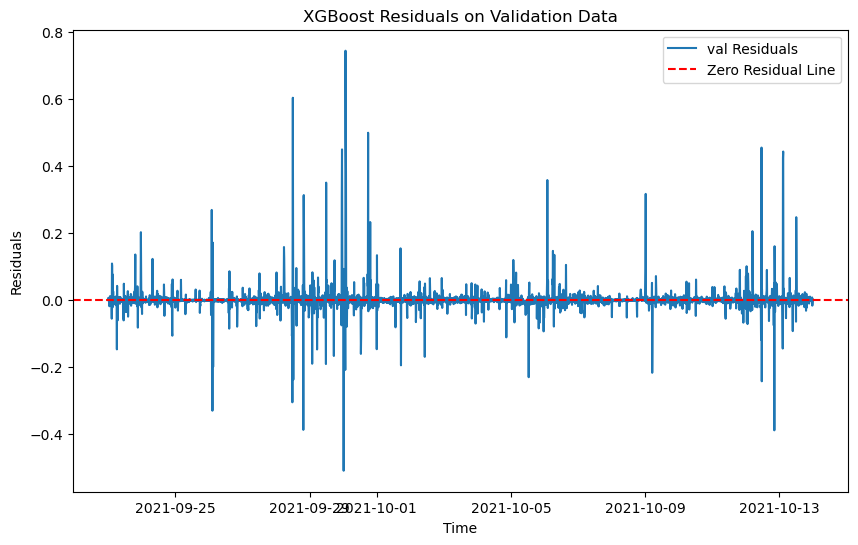

RMSE on training data for XGBoost: 0.01853830234618161
RMSE on validation data for XGBoost: 0.04456046966554709
RMSE on test data for XGBoost: 0.5340641207914324


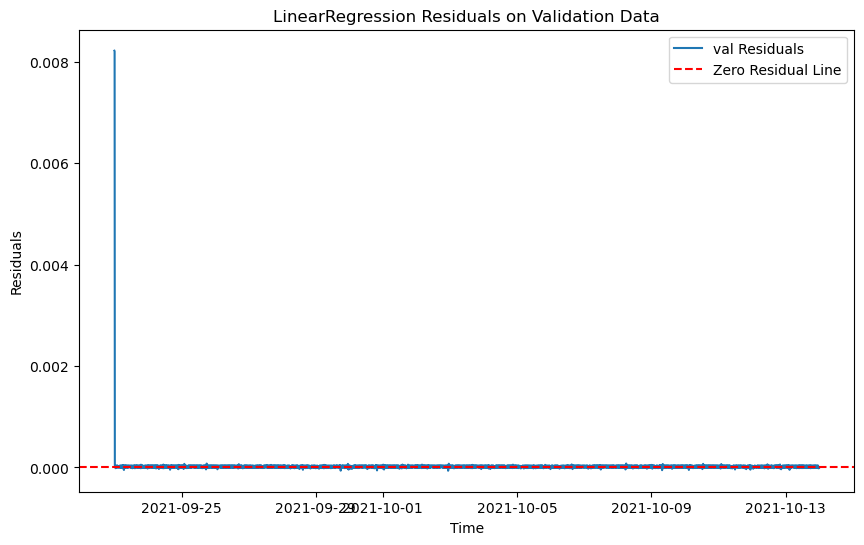

RMSE on training data for LinearRegression: 0.001202172132627272
RMSE on validation data for LinearRegression: 0.00021275425217795043
RMSE on test data for LinearRegression: 0.00116324176060915

Best model is LinearRegression with RMSE: 0.00021275425217795043
Best model saved as: models\model_29.pkl
data num 38
train_290.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


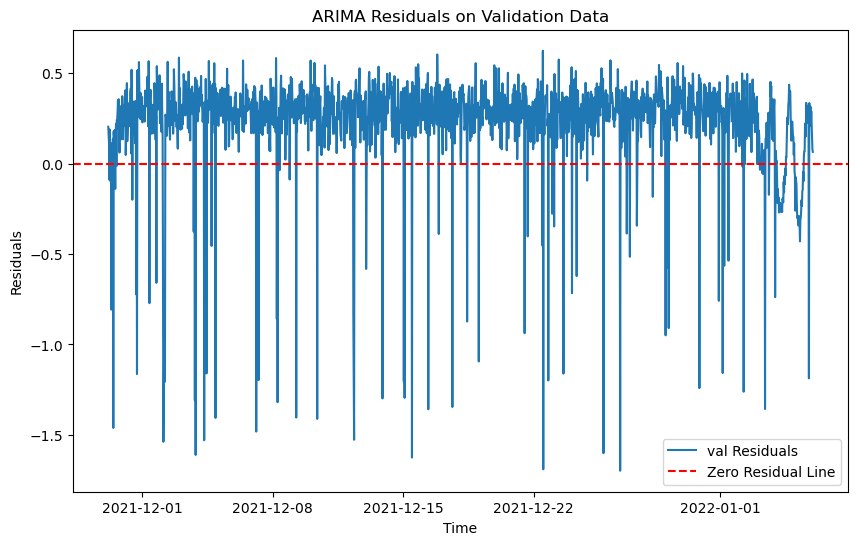

RMSE on training data for ARIMA: 0.273518425664318
RMSE on validation data for ARIMA: 0.3658868170572769
RMSE on test data for ARIMA: 0.31454175282273217


21:47:11 - cmdstanpy - INFO - Chain [1] start processing
21:47:11 - cmdstanpy - INFO - Chain [1] done processing


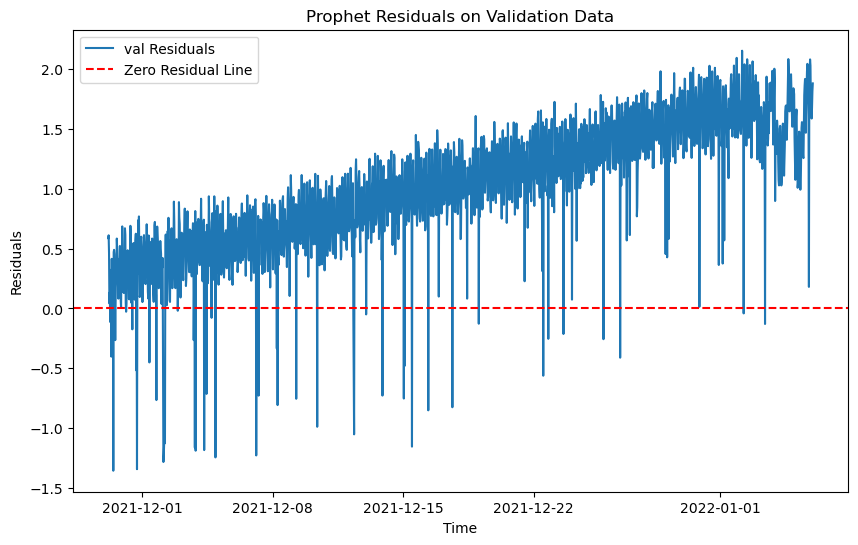

RMSE on training data for Prophet: 0.3531486507835293
RMSE on validation data for Prophet: 1.1516911747942846
RMSE on test data for Prophet: 2.156237352248865


<Figure size 1000x800 with 0 Axes>

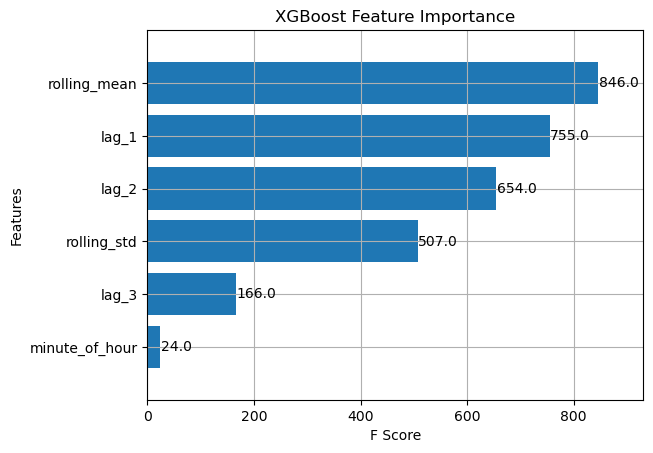

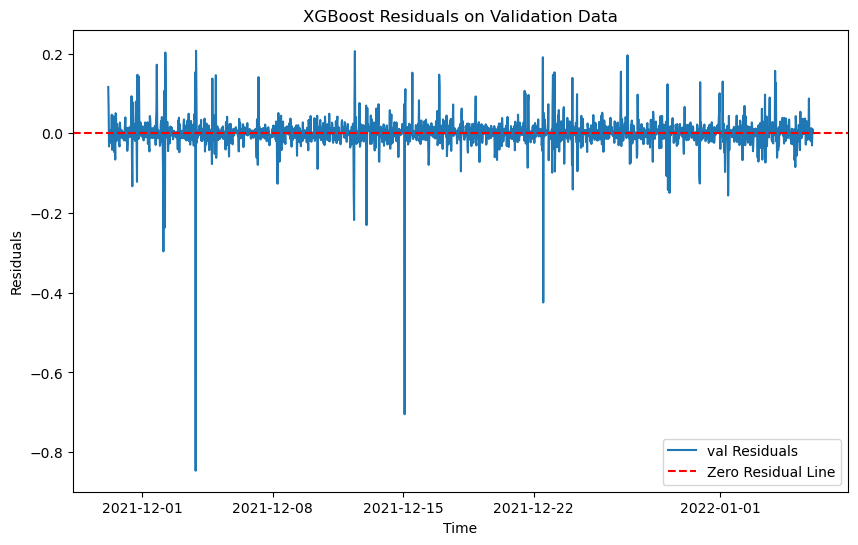

RMSE on training data for XGBoost: 0.03257206561219091
RMSE on validation data for XGBoost: 0.04450351022217576
RMSE on test data for XGBoost: 0.04418379604425551


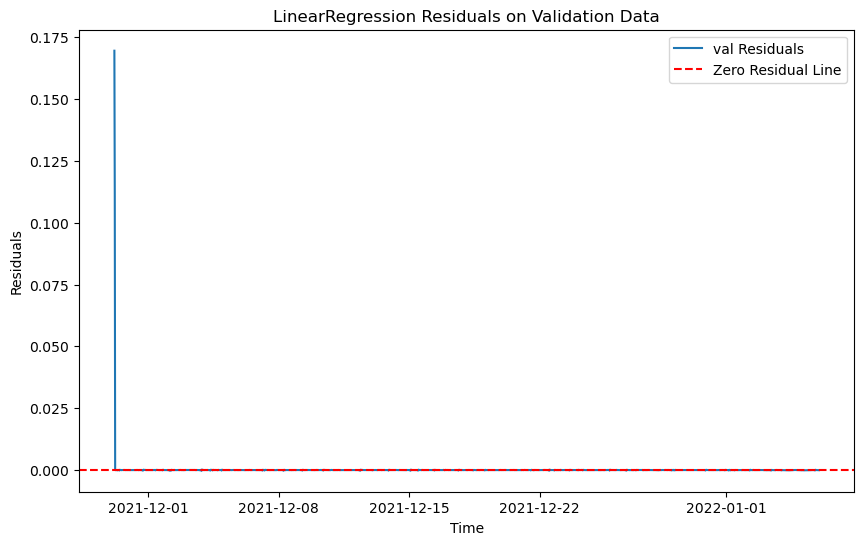

RMSE on training data for LinearRegression: 0.003097017202587107
RMSE on validation data for LinearRegression: 0.004779475750374486
RMSE on test data for LinearRegression: 0.004878473721815655

Best model is LinearRegression with RMSE: 0.004779475750374486
Best model saved as: models\model_290.pkl
data num 39
train_294.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.670206524153393e-23
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

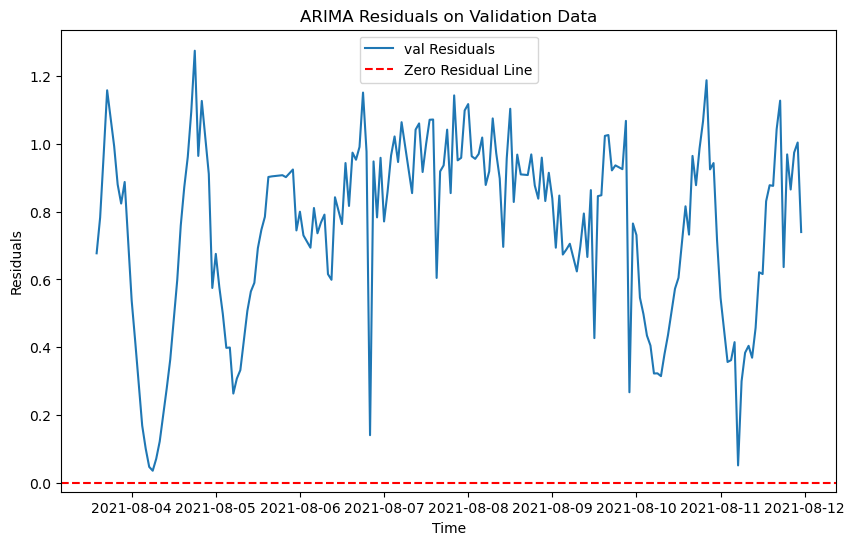

21:47:17 - cmdstanpy - INFO - Chain [1] start processing
21:47:17 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3036582836678384
RMSE on validation data for ARIMA: 0.8021826379062358
RMSE on test data for ARIMA: 0.9156831683137793


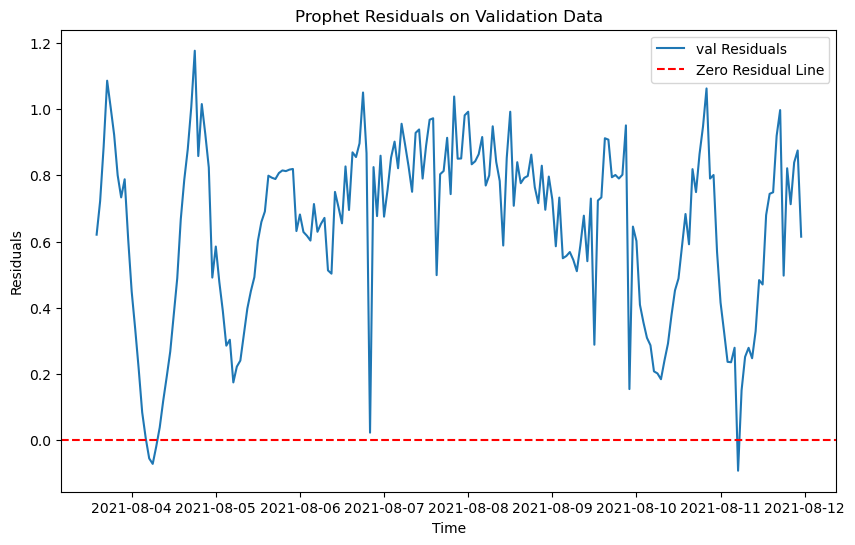

RMSE on training data for Prophet: 0.3298882020451641
RMSE on validation data for Prophet: 0.6972945709763266
RMSE on test data for Prophet: 0.7818857170732701


<Figure size 1000x800 with 0 Axes>

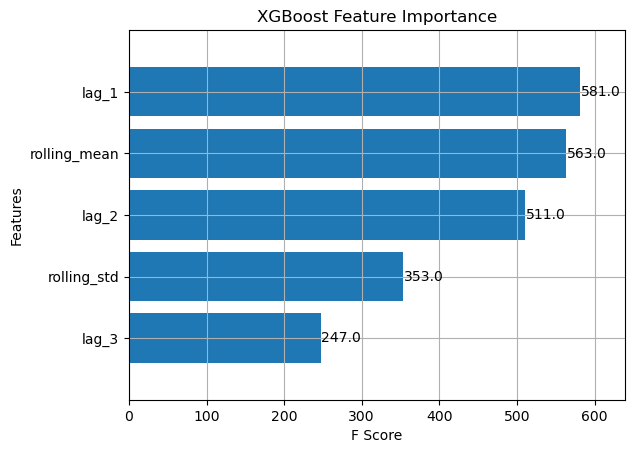

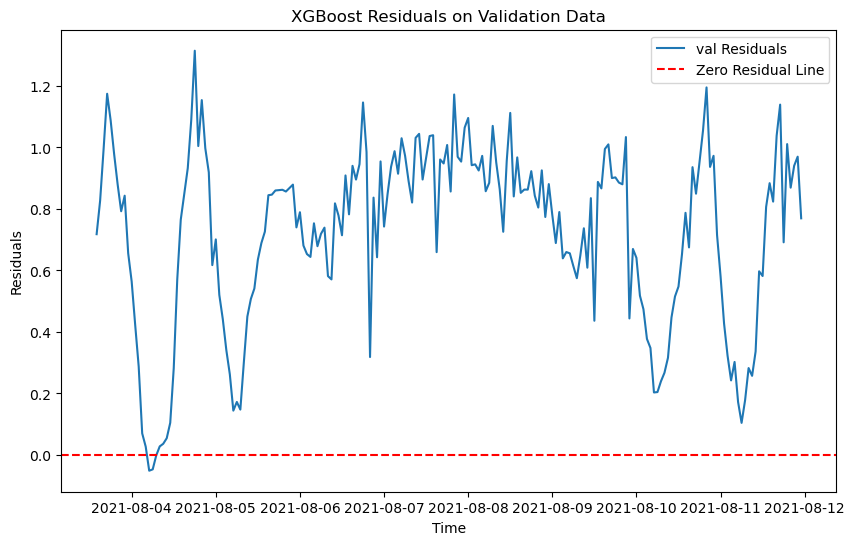

RMSE on training data for XGBoost: 0.018260071734034634
RMSE on validation data for XGBoost: 0.7775432170821625
RMSE on test data for XGBoost: 0.8716276543034098


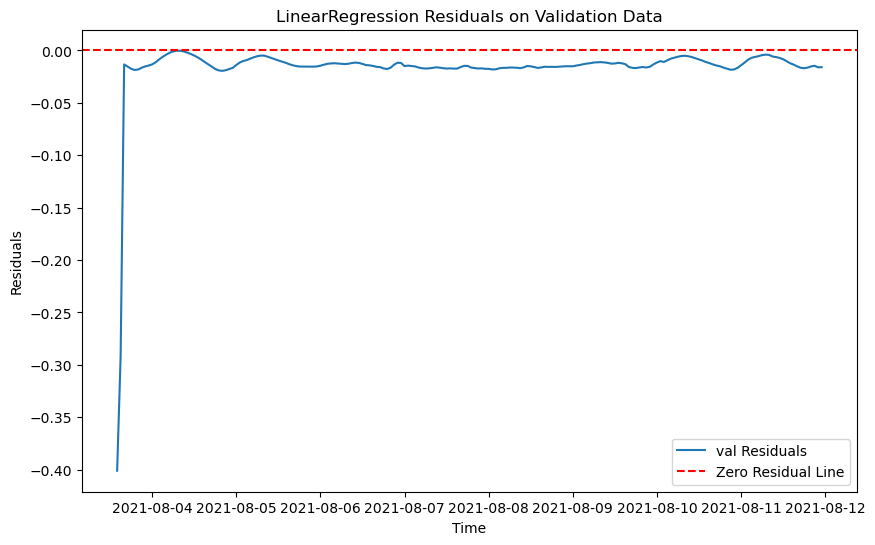

RMSE on training data for LinearRegression: 0.011590536181003929
RMSE on validation data for LinearRegression: 0.037405315063380414
RMSE on test data for LinearRegression: 0.017744576785217882

Best model is LinearRegression with RMSE: 0.037405315063380414
Best model saved as: models\model_294.pkl
data num 40
train_297.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0010057433962599954
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.997192193339609e-05
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

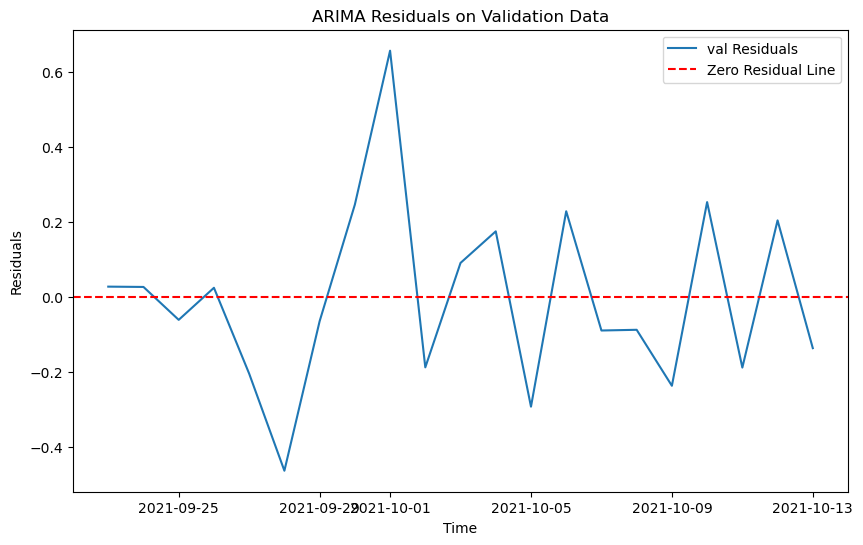

21:47:20 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.37754337003994654
RMSE on validation data for ARIMA: 0.2392378979949784
RMSE on test data for ARIMA: 0.9832471722841034


21:47:20 - cmdstanpy - INFO - Chain [1] done processing


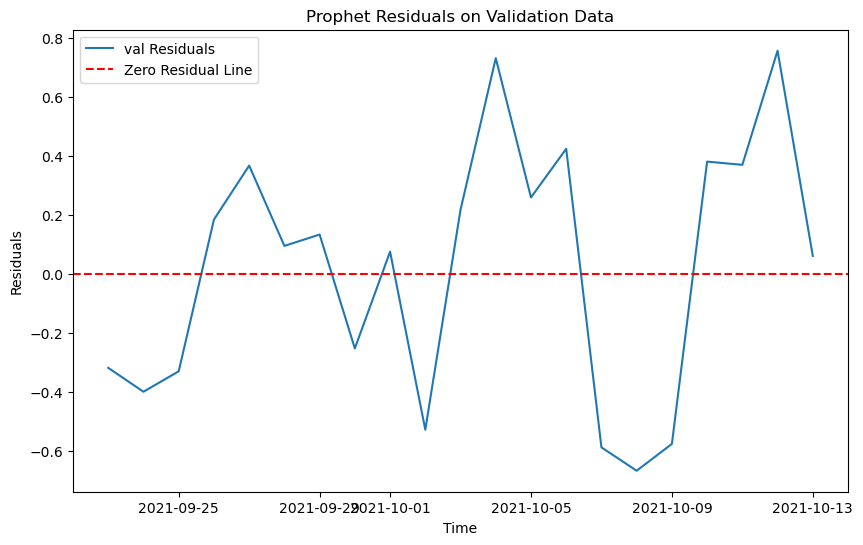

RMSE on training data for Prophet: 0.234317347244668
RMSE on validation data for Prophet: 0.42175789723441487
RMSE on test data for Prophet: 1.0671764861882975


<Figure size 1000x800 with 0 Axes>

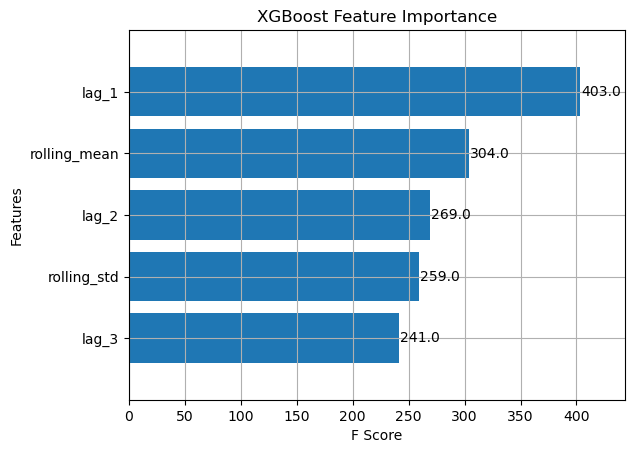

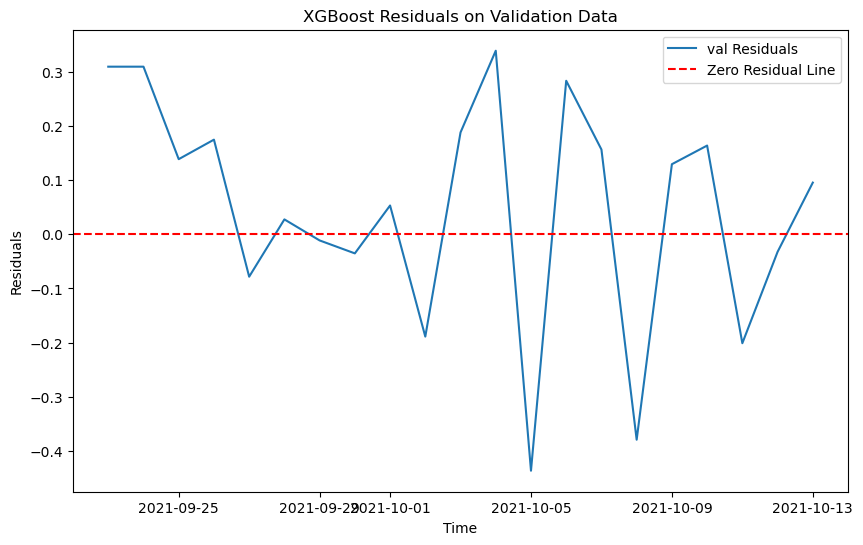

RMSE on training data for XGBoost: 0.04880423986100412
RMSE on validation data for XGBoost: 0.21528911234917283
RMSE on test data for XGBoost: 0.374928870582129


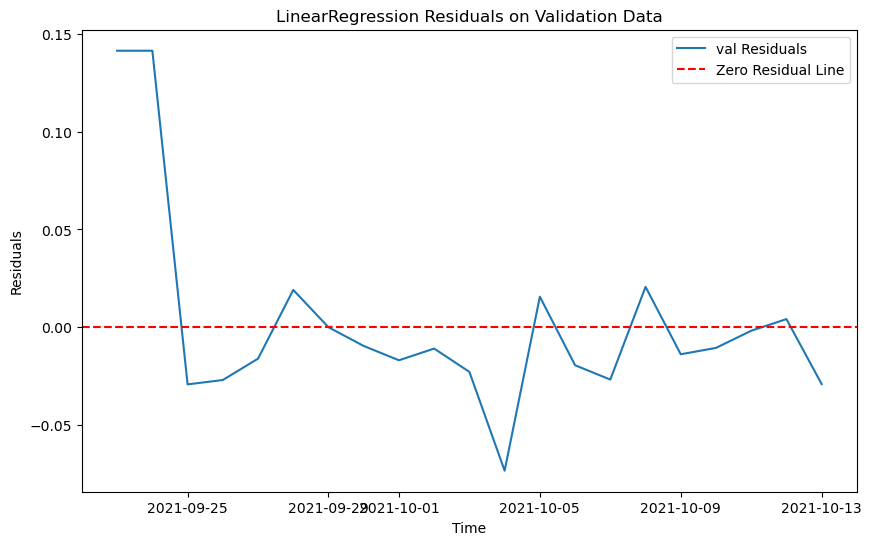

RMSE on training data for LinearRegression: 0.07557191272724989
RMSE on validation data for LinearRegression: 0.0496155185245168
RMSE on test data for LinearRegression: 0.15978204594425008

Best model is LinearRegression with RMSE: 0.0496155185245168
Best model saved as: models\model_297.pkl
data num 41
train_300.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

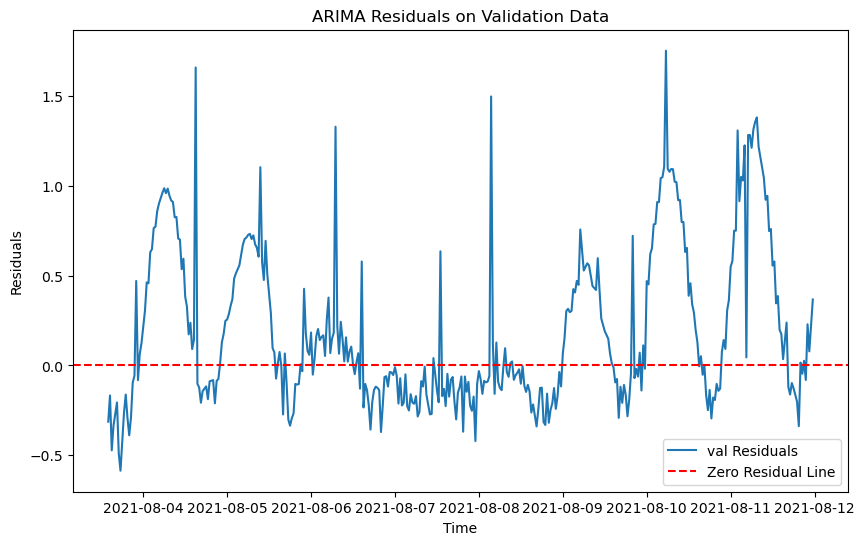

21:47:23 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.24905122048502512
RMSE on validation data for ARIMA: 0.48443945941463207
RMSE on test data for ARIMA: 0.5666309919125856


21:47:23 - cmdstanpy - INFO - Chain [1] done processing


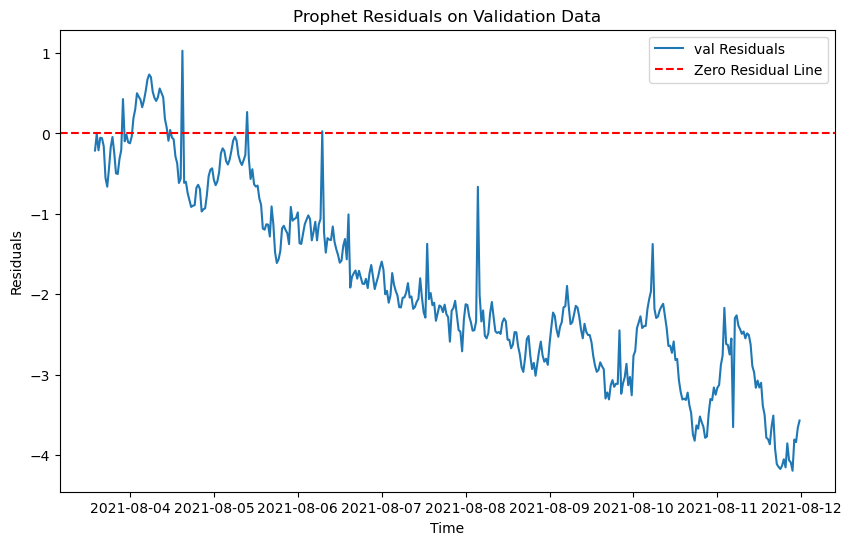

RMSE on training data for Prophet: 0.26052989887024597
RMSE on validation data for Prophet: 2.2097853674137125
RMSE on test data for Prophet: 4.760072678238999


<Figure size 1000x800 with 0 Axes>

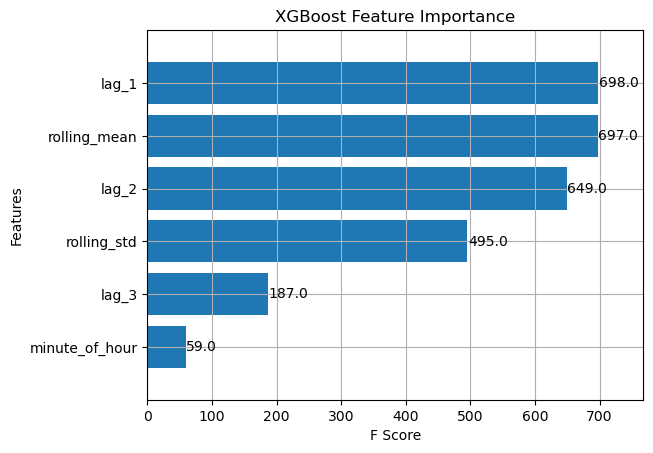

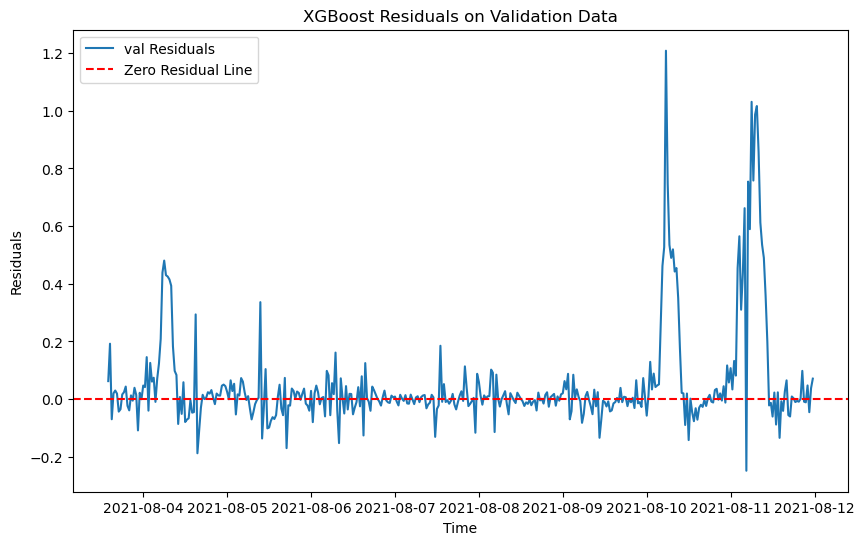

RMSE on training data for XGBoost: 0.017971870536817182
RMSE on validation data for XGBoost: 0.18613094437481048
RMSE on test data for XGBoost: 0.3192841292583385


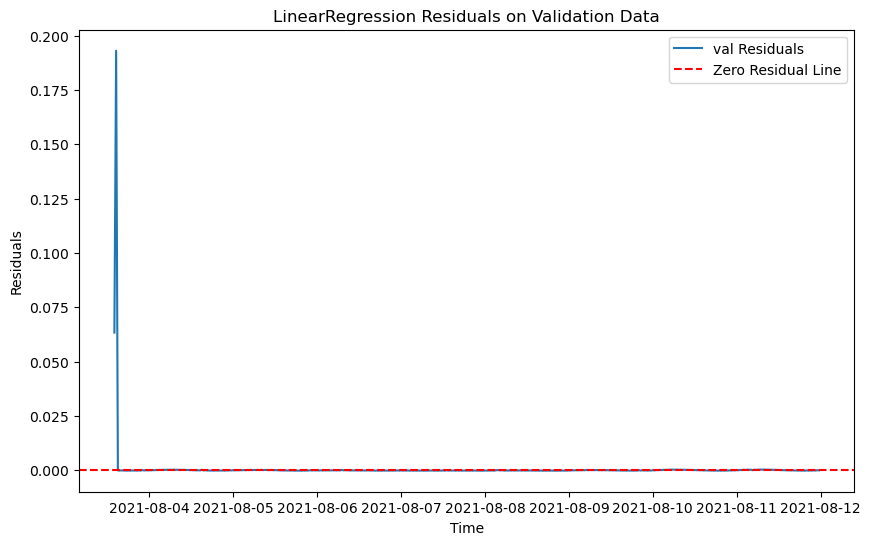

RMSE on training data for LinearRegression: 0.0029004320568403407
RMSE on validation data for LinearRegression: 0.01010675271460343
RMSE on test data for LinearRegression: 0.00907136312640824

Best model is LinearRegression with RMSE: 0.01010675271460343
Best model saved as: models\model_300.pkl
data num 42
train_301.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.5142557964979134e-18
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

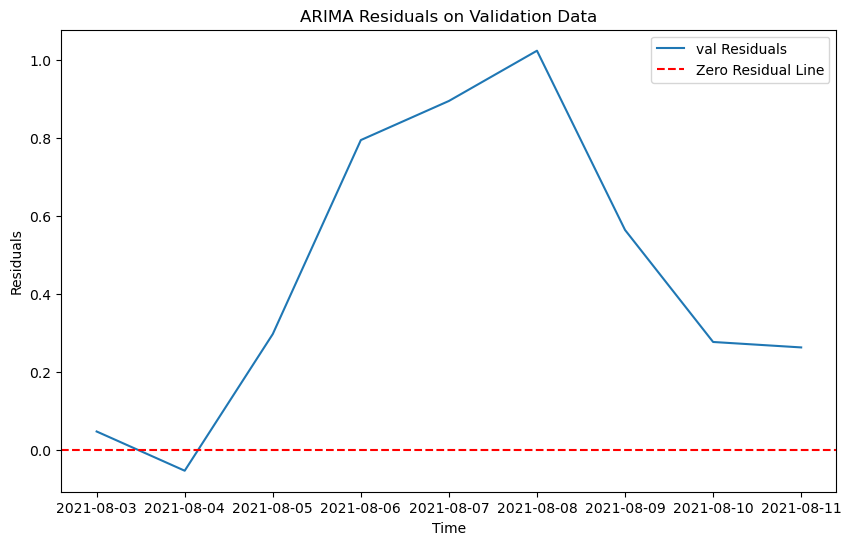

21:47:26 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.5689230163538488
RMSE on validation data for ARIMA: 0.5809888033669675
RMSE on test data for ARIMA: 0.8227013620030168


21:47:26 - cmdstanpy - INFO - Chain [1] done processing


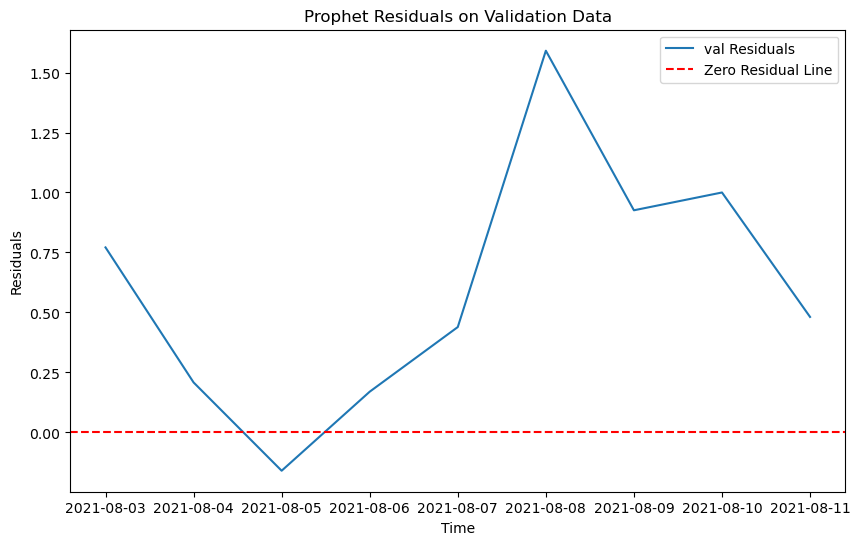

RMSE on training data for Prophet: 0.3702665744201651
RMSE on validation data for Prophet: 0.7821236143792385
RMSE on test data for Prophet: 0.9608820628483558


<Figure size 1000x800 with 0 Axes>

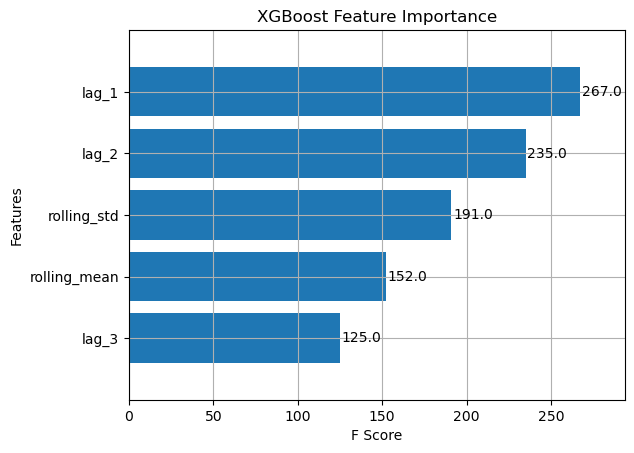

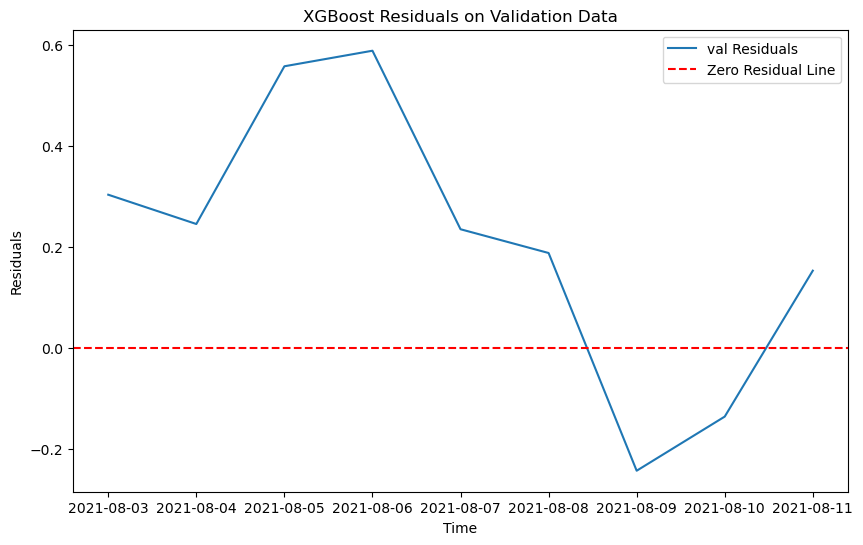

RMSE on training data for XGBoost: 0.012028138182846352
RMSE on validation data for XGBoost: 0.33395981325164
RMSE on test data for XGBoost: 0.3691759611081128


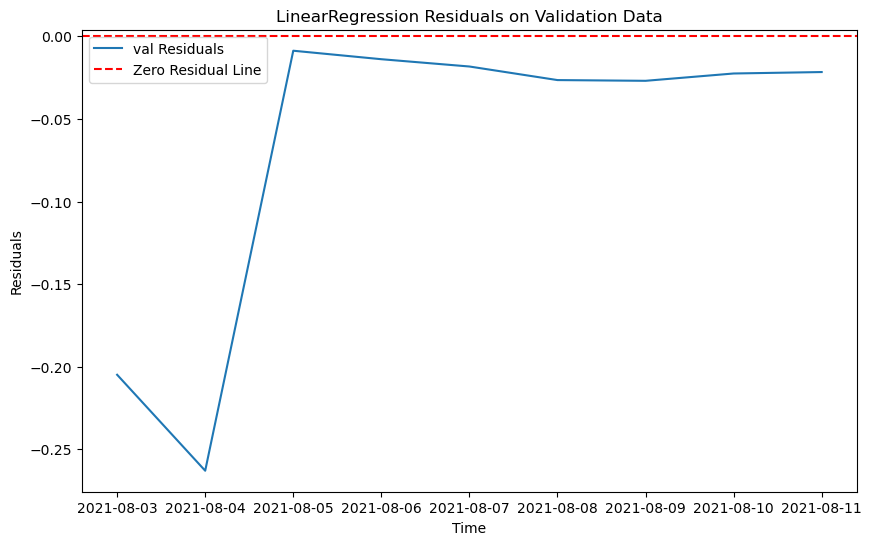

RMSE on training data for LinearRegression: 0.015526577455150837
RMSE on validation data for LinearRegression: 0.11261647030827669
RMSE on test data for LinearRegression: 0.23533937059290952

Best model is LinearRegression with RMSE: 0.11261647030827669
Best model saved as: models\model_301.pkl
data num 43
train_306.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


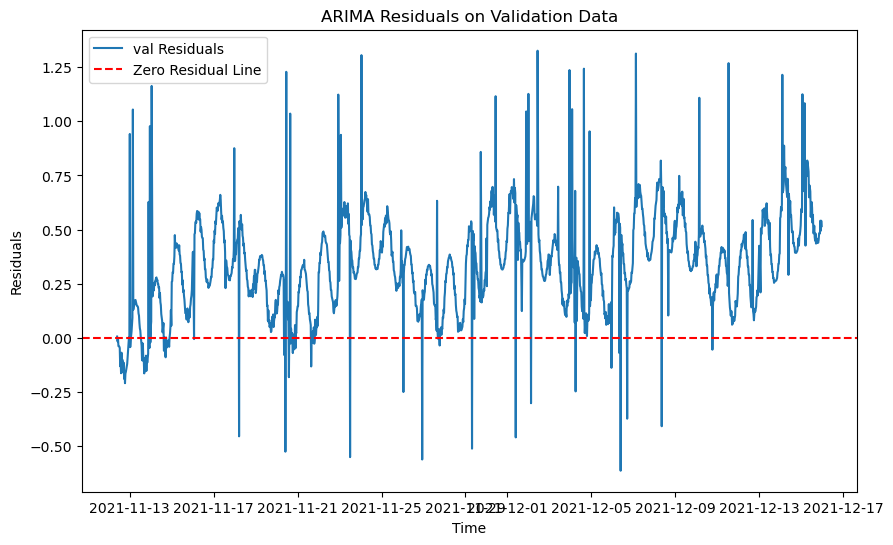

21:47:31 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.17333383646409423
RMSE on validation data for ARIMA: 0.40885103132055356
RMSE on test data for ARIMA: 0.8062670230475212


21:47:32 - cmdstanpy - INFO - Chain [1] done processing


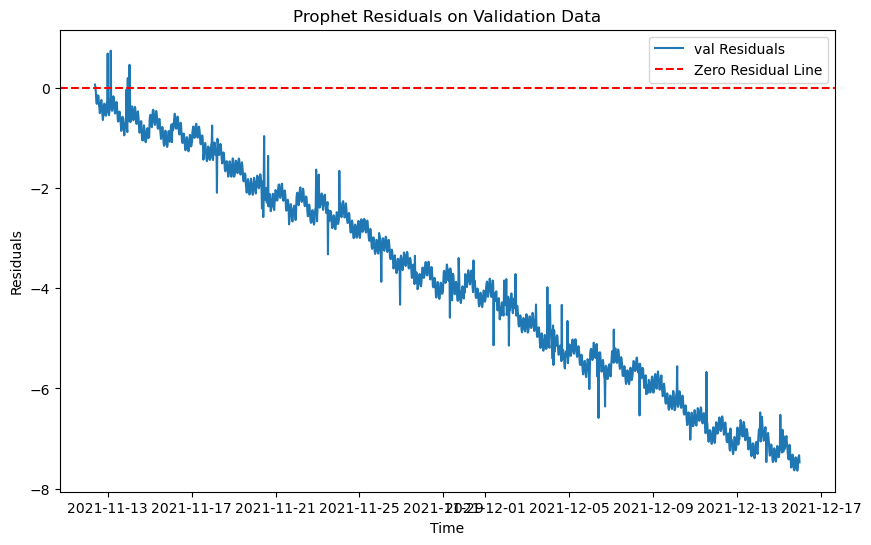

RMSE on training data for Prophet: 0.15905242744632045
RMSE on validation data for Prophet: 4.406850441944885
RMSE on test data for Prophet: 9.04145534411137


<Figure size 1000x800 with 0 Axes>

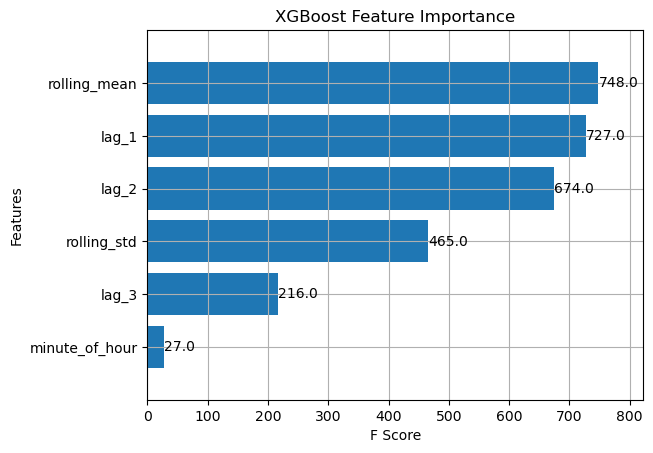

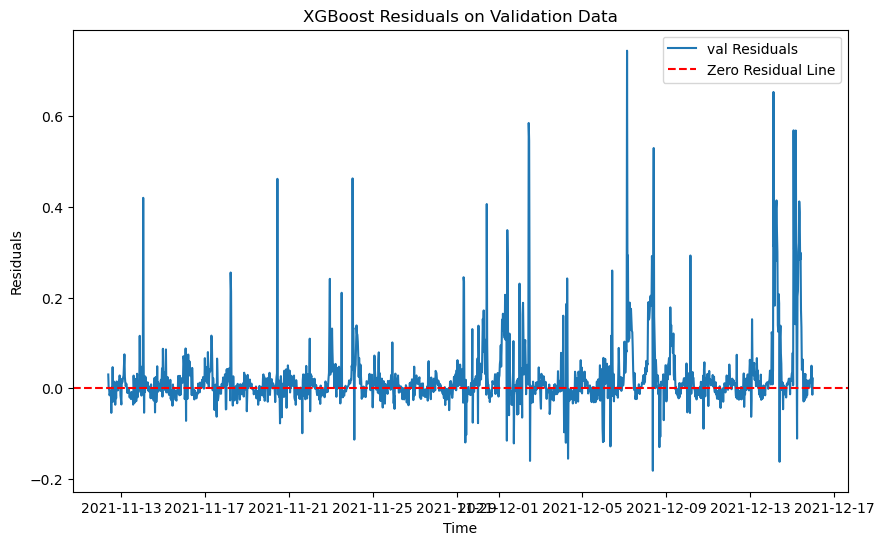

RMSE on training data for XGBoost: 0.023329791301044664
RMSE on validation data for XGBoost: 0.07695330559797743
RMSE on test data for XGBoost: 0.4881652036807046


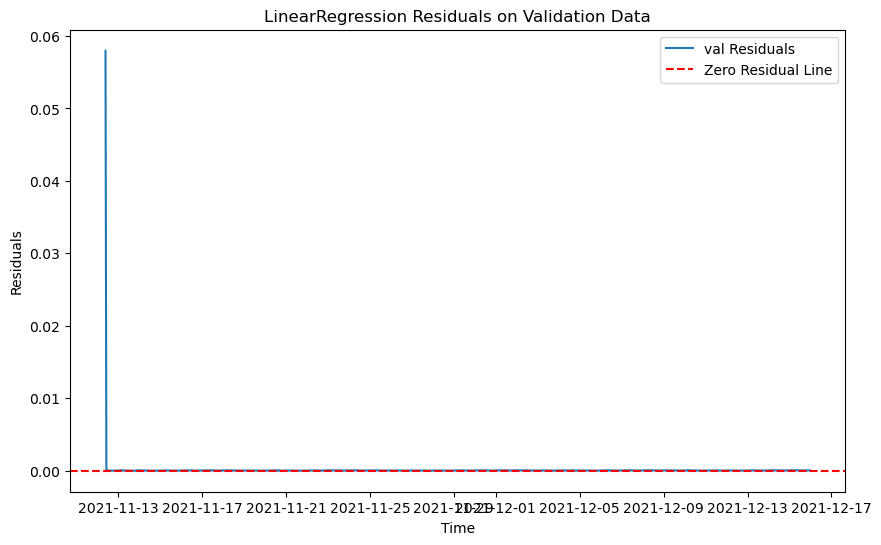

RMSE on training data for LinearRegression: 0.0007671181426655741
RMSE on validation data for LinearRegression: 0.0015903196190586184
RMSE on test data for LinearRegression: 0.011872635383843142

Best model is LinearRegression with RMSE: 0.0015903196190586184
Best model saved as: models\model_306.pkl
data num 44
train_310.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.461749245972653e-25
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.1381354578522735e-11
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

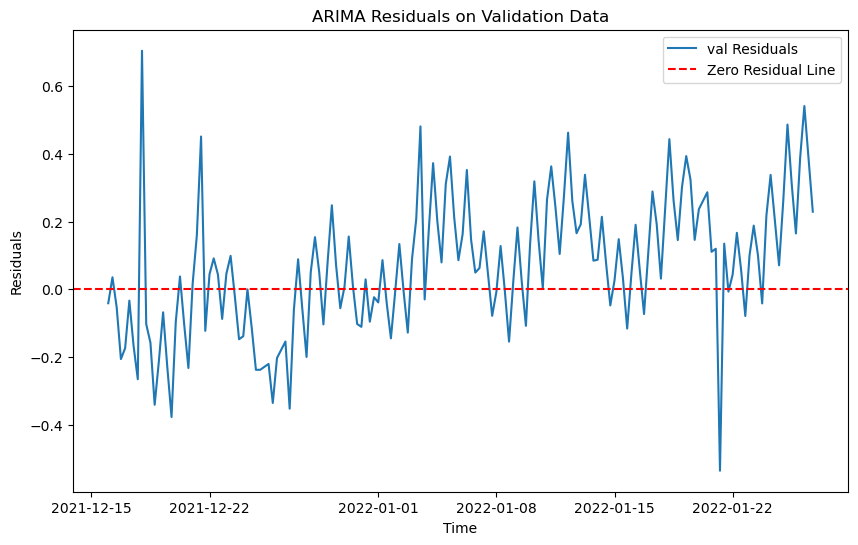

21:47:38 - cmdstanpy - INFO - Chain [1] start processing
21:47:38 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2044751556088535
RMSE on validation data for ARIMA: 0.20895055672187385
RMSE on test data for ARIMA: 0.263623881373044


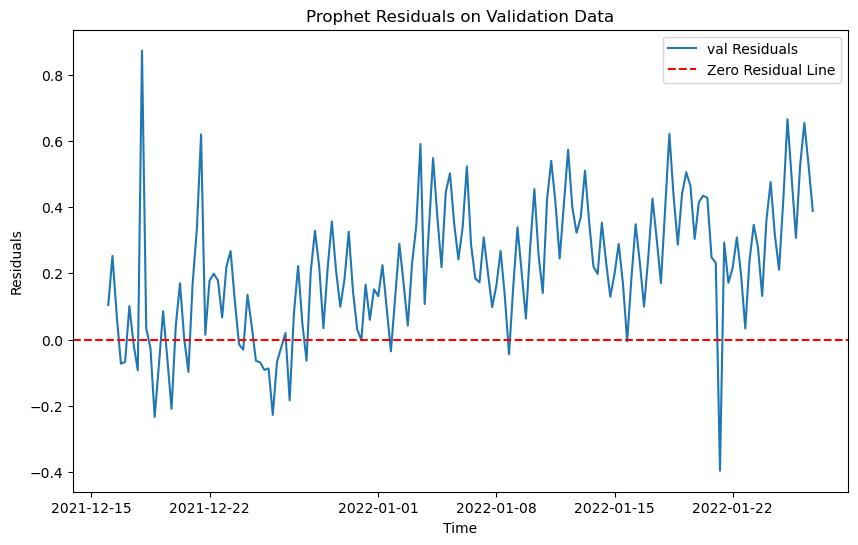

RMSE on training data for Prophet: 0.22971876955807066
RMSE on validation data for Prophet: 0.29354954691439716
RMSE on test data for Prophet: 0.30478874176488124


<Figure size 1000x800 with 0 Axes>

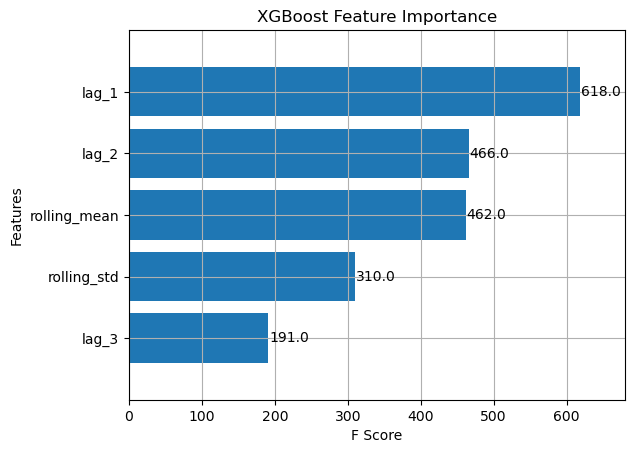

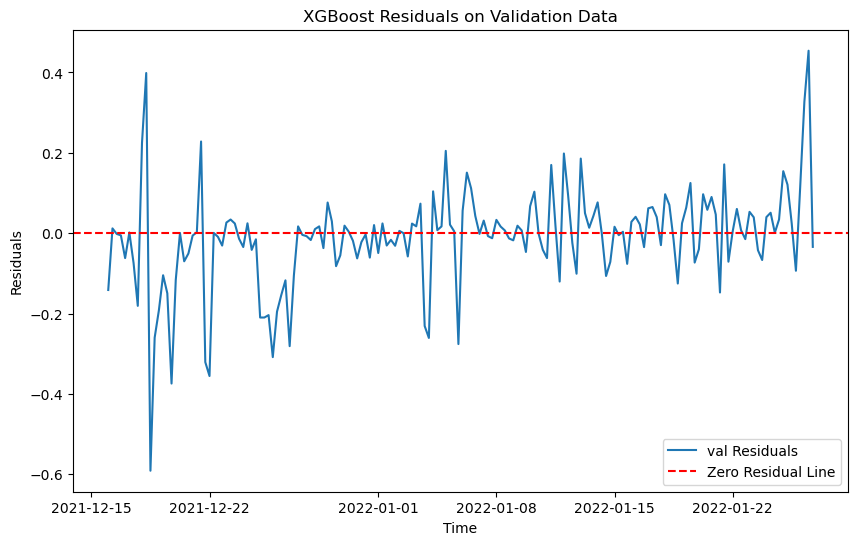

RMSE on training data for XGBoost: 0.01372795129930529
RMSE on validation data for XGBoost: 0.12625453860819627
RMSE on test data for XGBoost: 0.235809551764778


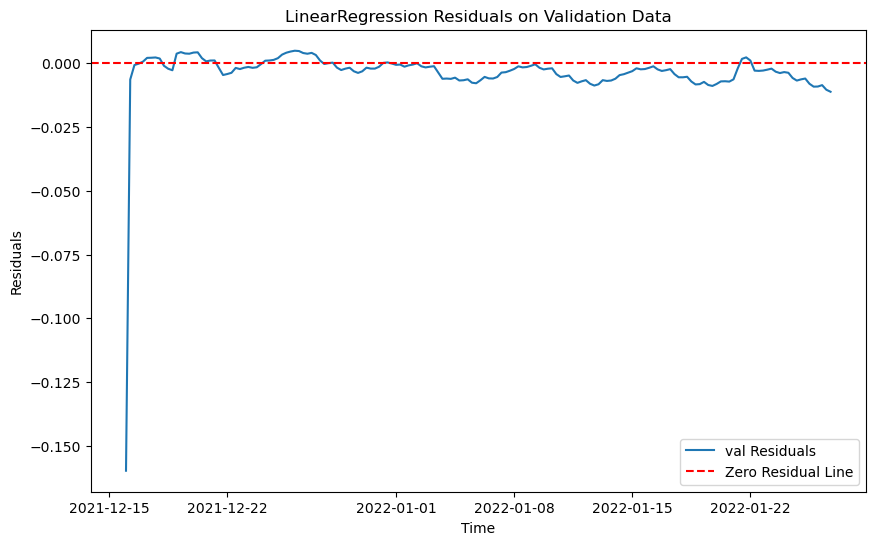

RMSE on training data for LinearRegression: 0.013015535624479845
RMSE on validation data for LinearRegression: 0.013137427523330147
RMSE on test data for LinearRegression: 0.11243688396778334

Best model is LinearRegression with RMSE: 0.013137427523330147
Best model saved as: models\model_310.pkl
data num 45
train_314.csv
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.26182881871719066
The time series is not stationary. Applying differencing 1
New p-value after differencing: 0.0006796039854209826
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

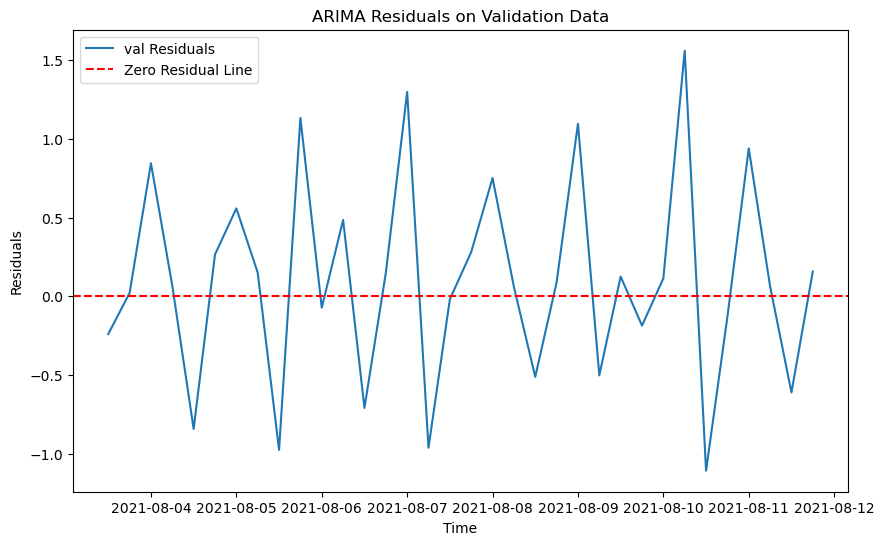

21:47:40 - cmdstanpy - INFO - Chain [1] start processing
21:47:40 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3497886493835688
RMSE on validation data for ARIMA: 0.6624992345175453
RMSE on test data for ARIMA: 0.48633438448572486


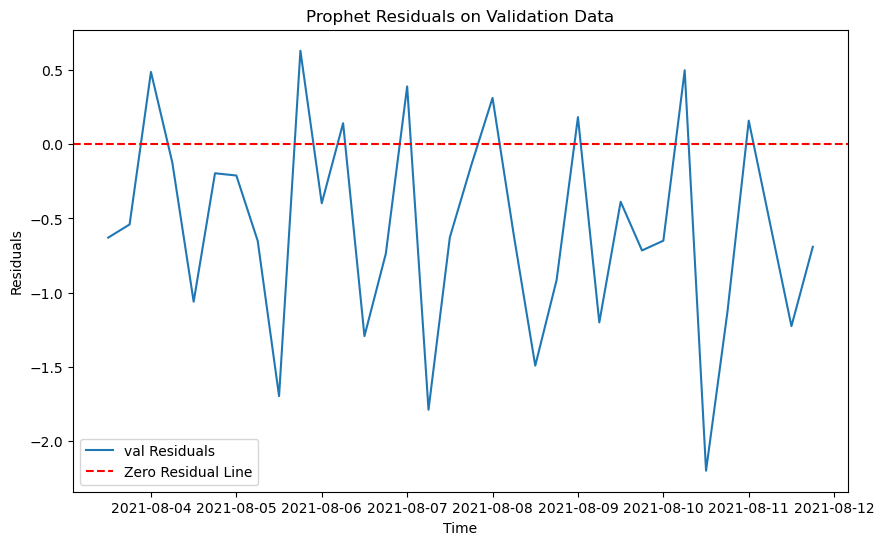

RMSE on training data for Prophet: 0.2089853566800564
RMSE on validation data for Prophet: 0.8865032770416645
RMSE on test data for Prophet: 0.7258567441273694


<Figure size 1000x800 with 0 Axes>

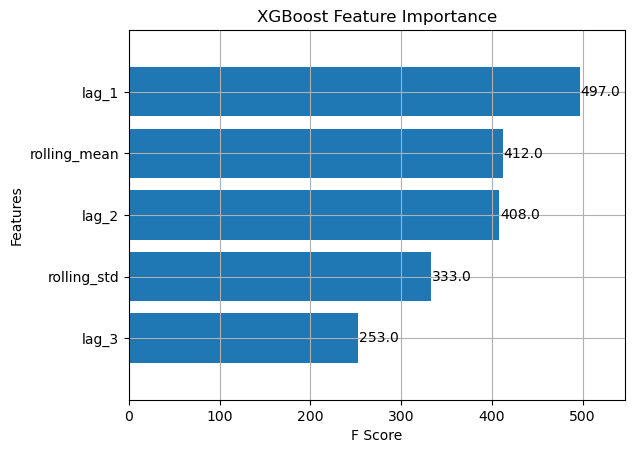

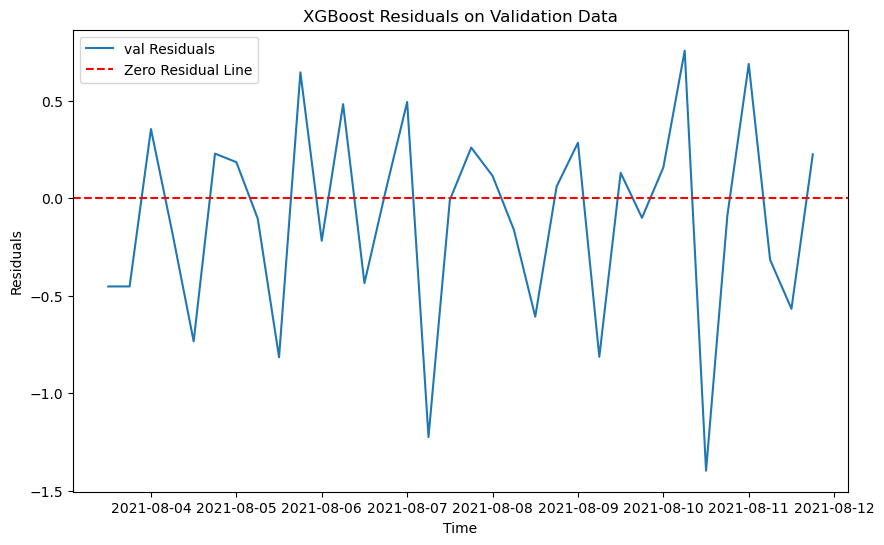

RMSE on training data for XGBoost: 0.019812252981523355
RMSE on validation data for XGBoost: 0.5220532140530654
RMSE on test data for XGBoost: 0.2893300643028522


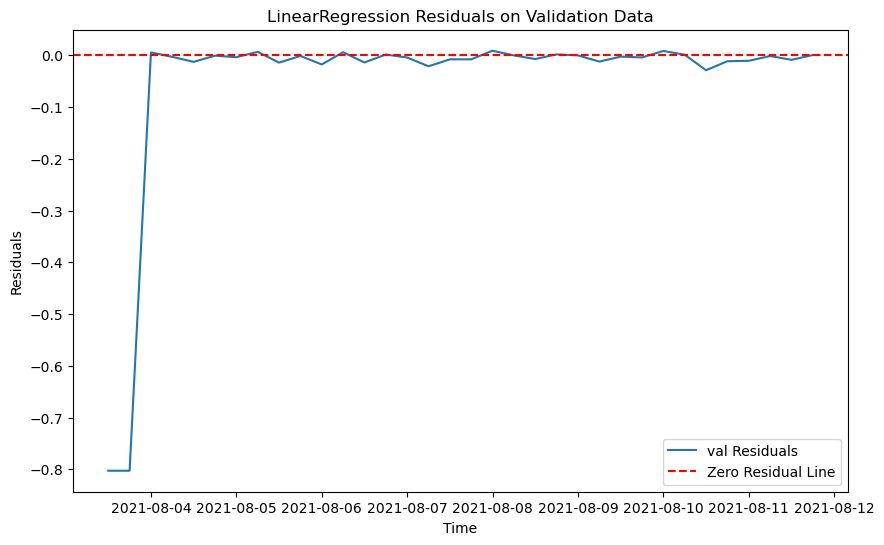

RMSE on training data for LinearRegression: 0.02675990925051791
RMSE on validation data for LinearRegression: 0.19489991539500573
RMSE on test data for LinearRegression: 0.029444011380026145

Best model is LinearRegression with RMSE: 0.19489991539500573
Best model saved as: models\model_314.pkl
data num 46
train_321.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

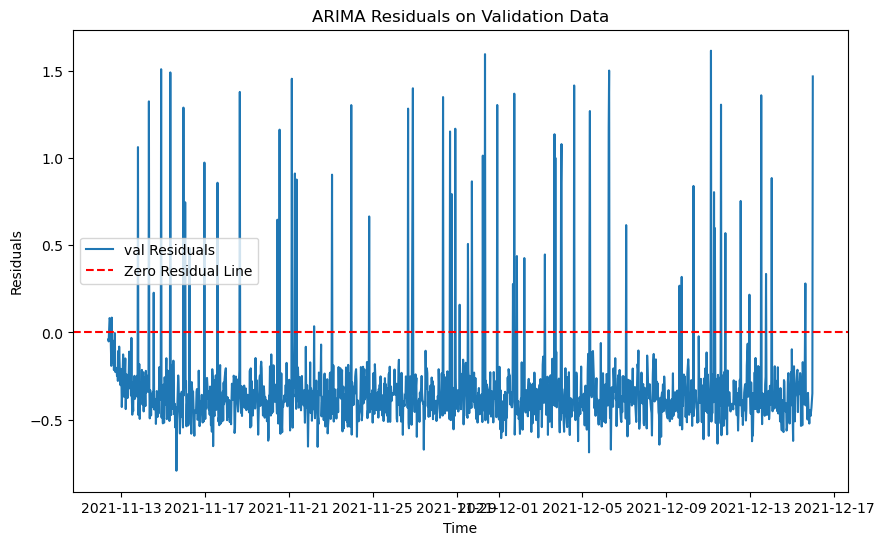

RMSE on training data for ARIMA: 0.27886963571394546
RMSE on validation data for ARIMA: 0.43060623198262704
RMSE on test data for ARIMA: 0.5623498028033889


21:47:48 - cmdstanpy - INFO - Chain [1] start processing
21:47:48 - cmdstanpy - INFO - Chain [1] done processing


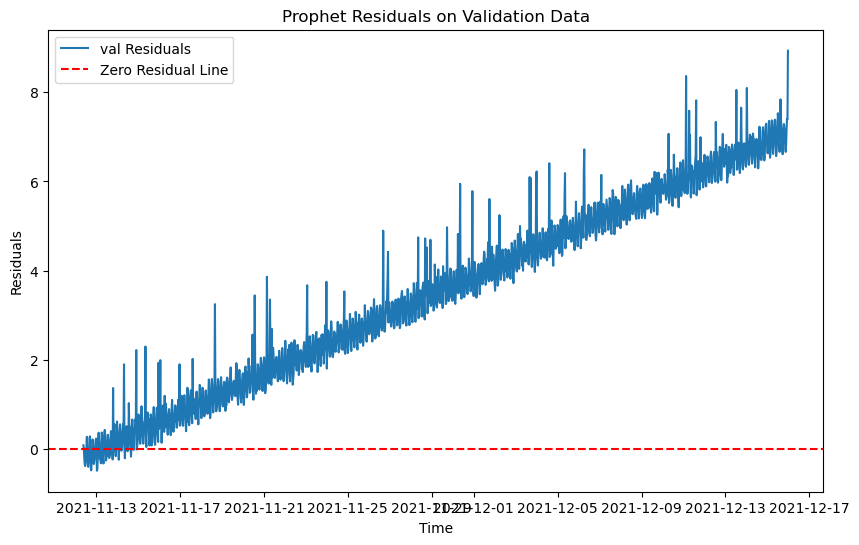

RMSE on training data for Prophet: 0.38686915960795476
RMSE on validation data for Prophet: 4.105703863852328
RMSE on test data for Prophet: 9.328316626087048


<Figure size 1000x800 with 0 Axes>

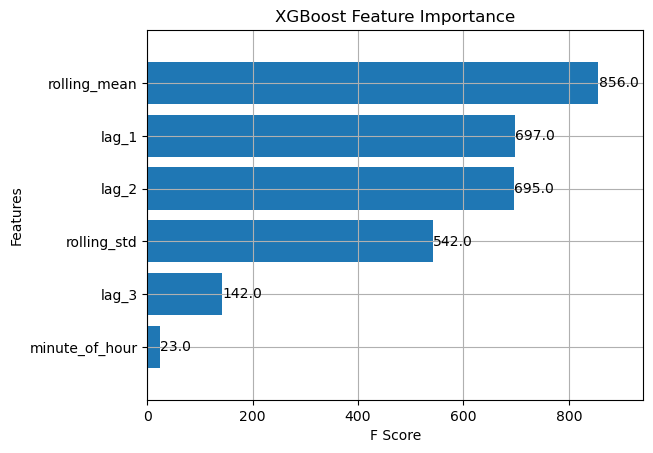

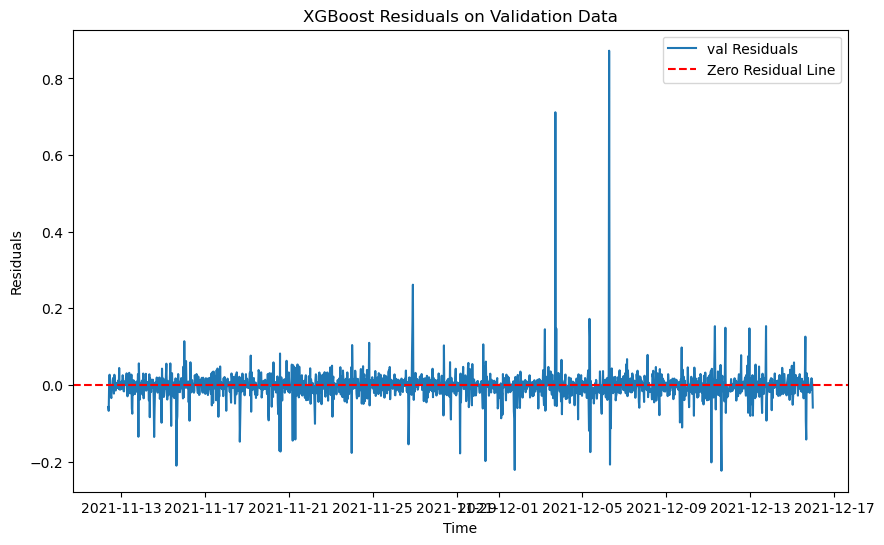

RMSE on training data for XGBoost: 0.03404203055617345
RMSE on validation data for XGBoost: 0.045450797539493874
RMSE on test data for XGBoost: 0.06408076406766075


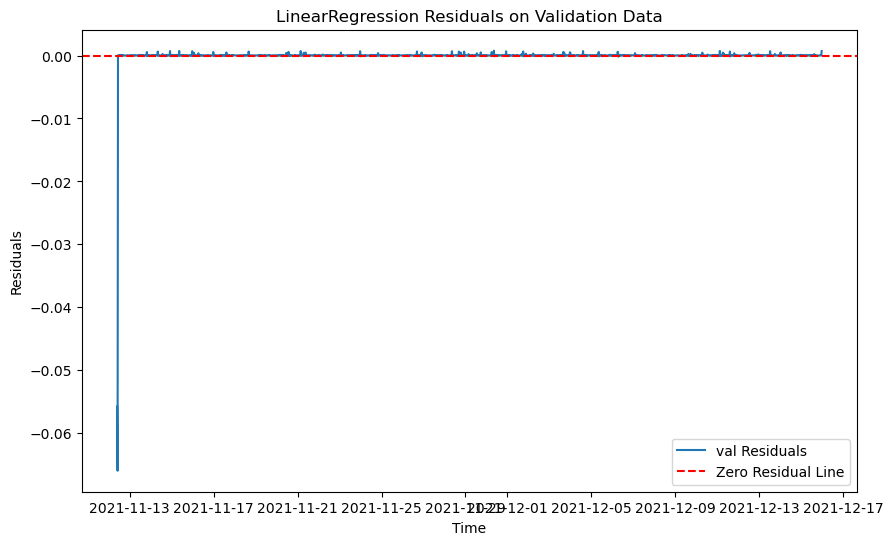

RMSE on training data for LinearRegression: 0.005093320778472452
RMSE on validation data for LinearRegression: 0.002154735288207906
RMSE on test data for LinearRegression: 0.0067982092039135

Best model is LinearRegression with RMSE: 0.002154735288207906
Best model saved as: models\model_321.pkl
data num 47
train_325.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


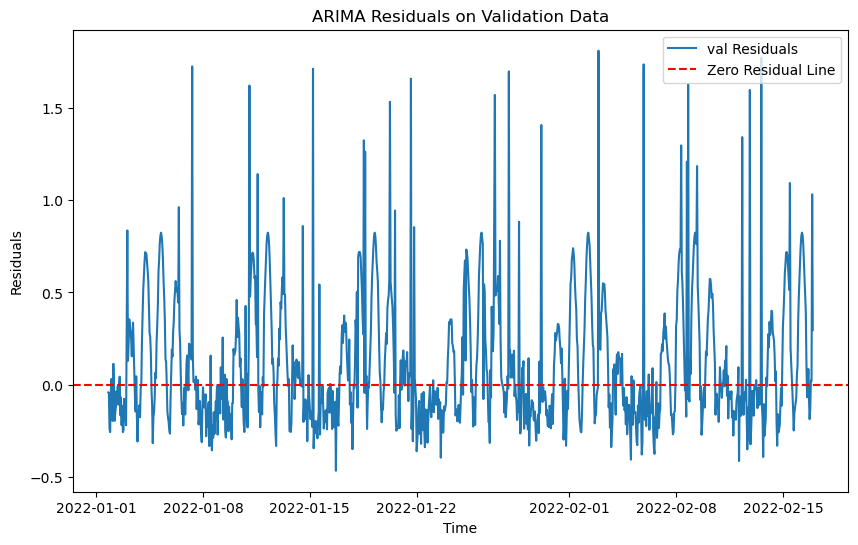

21:47:54 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.2942078839379203
RMSE on validation data for ARIMA: 0.37727240825837755
RMSE on test data for ARIMA: 0.573488178873156


21:47:54 - cmdstanpy - INFO - Chain [1] done processing


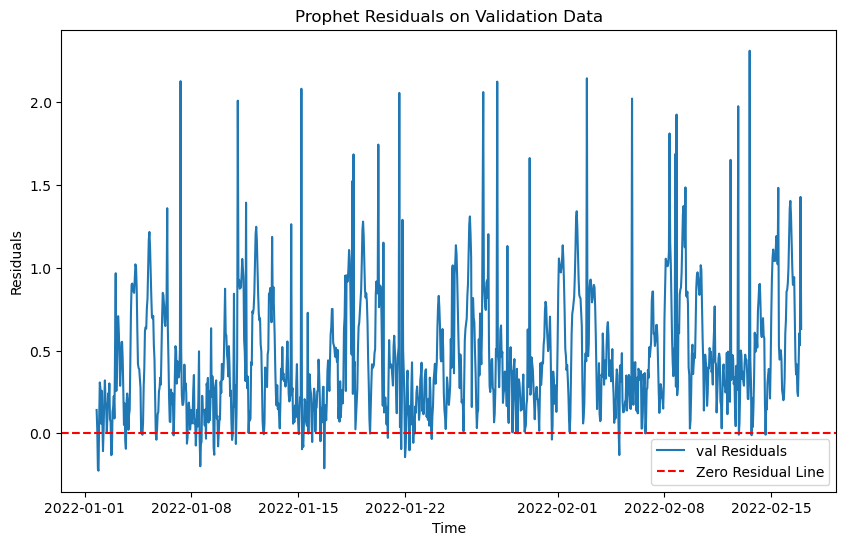

RMSE on training data for Prophet: 0.30265369669239234
RMSE on validation data for Prophet: 0.5943434472322927
RMSE on test data for Prophet: 0.915535352667155


<Figure size 1000x800 with 0 Axes>

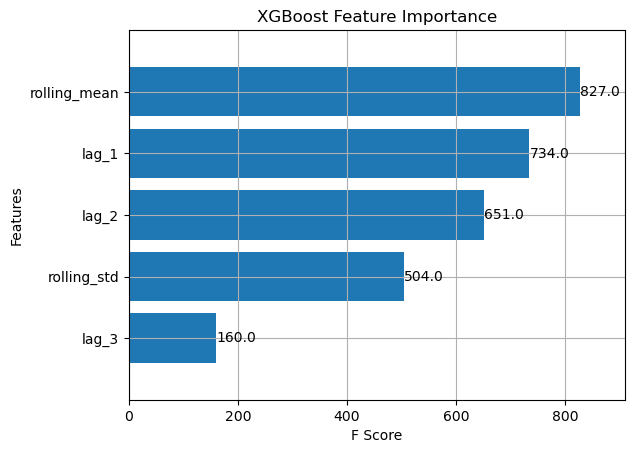

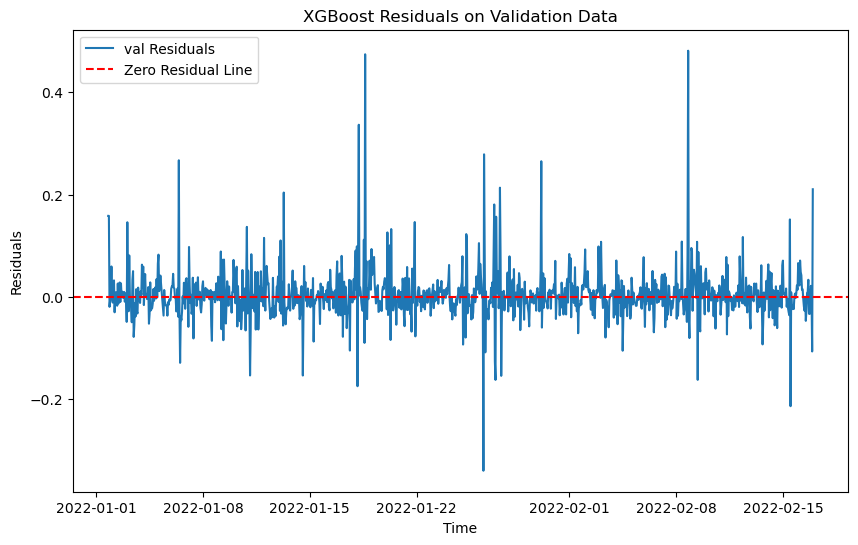

RMSE on training data for XGBoost: 0.023978439177913452
RMSE on validation data for XGBoost: 0.04954199820510939
RMSE on test data for XGBoost: 0.2673750850007987


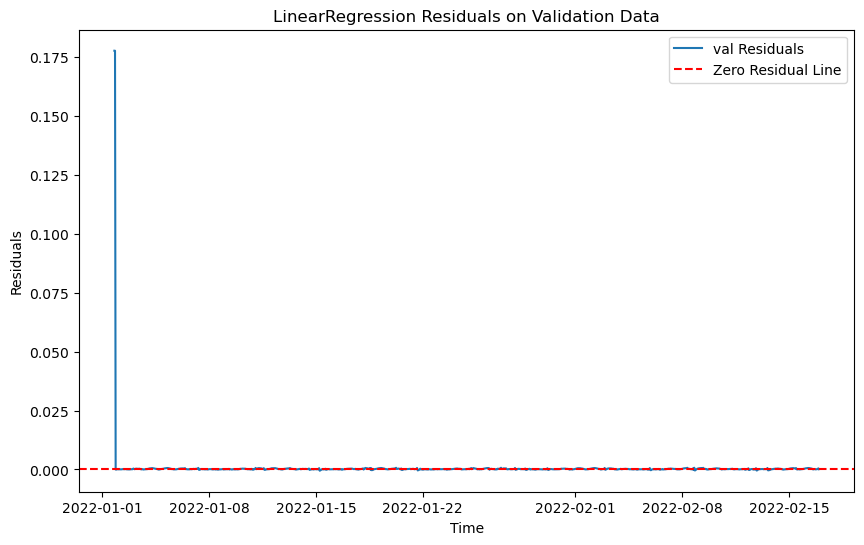

RMSE on training data for LinearRegression: 0.00541727703120343
RMSE on validation data for LinearRegression: 0.007547869400403967
RMSE on test data for LinearRegression: 0.010533026168510227

Best model is LinearRegression with RMSE: 0.007547869400403967
Best model saved as: models\model_325.pkl
data num 48
train_335.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


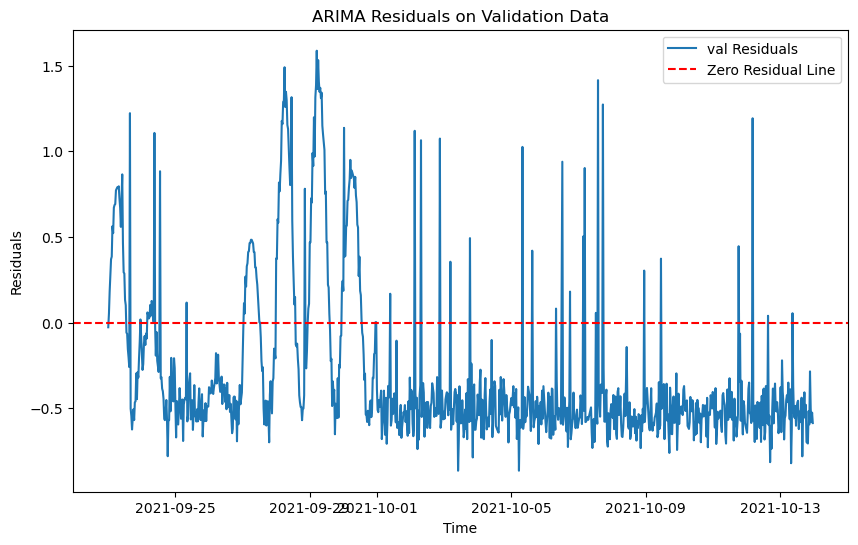

21:48:00 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.26024379391777175
RMSE on validation data for ARIMA: 0.5563074021608118
RMSE on test data for ARIMA: 0.5549943182703915


21:48:00 - cmdstanpy - INFO - Chain [1] done processing


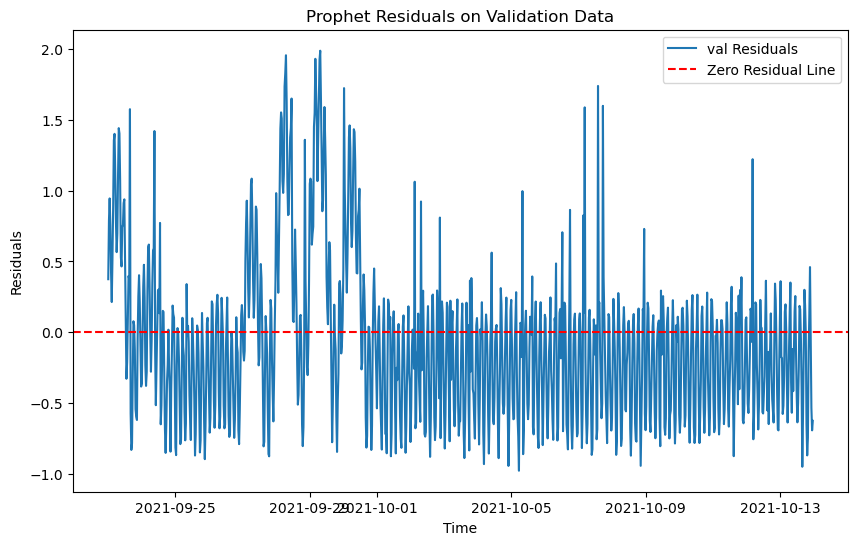

RMSE on training data for Prophet: 0.3270248546409047
RMSE on validation data for Prophet: 0.5653487477152481
RMSE on test data for Prophet: 0.4828046979714439


<Figure size 1000x800 with 0 Axes>

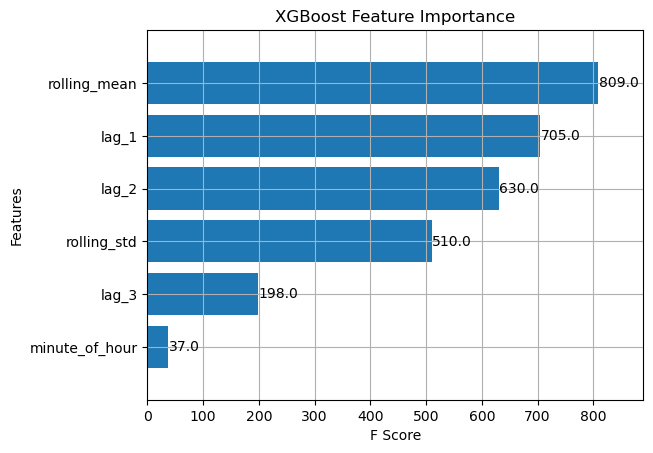

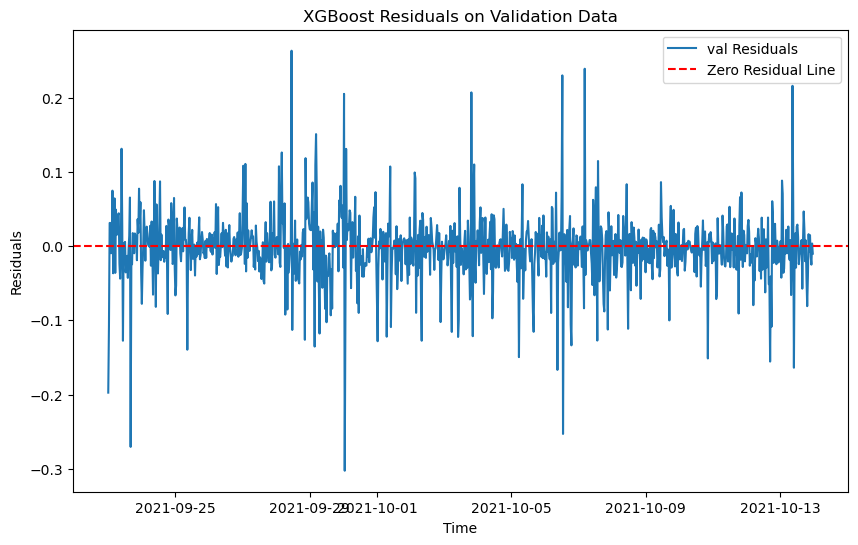

RMSE on training data for XGBoost: 0.03321607392388085
RMSE on validation data for XGBoost: 0.04636689875008117
RMSE on test data for XGBoost: 0.044638444215230146


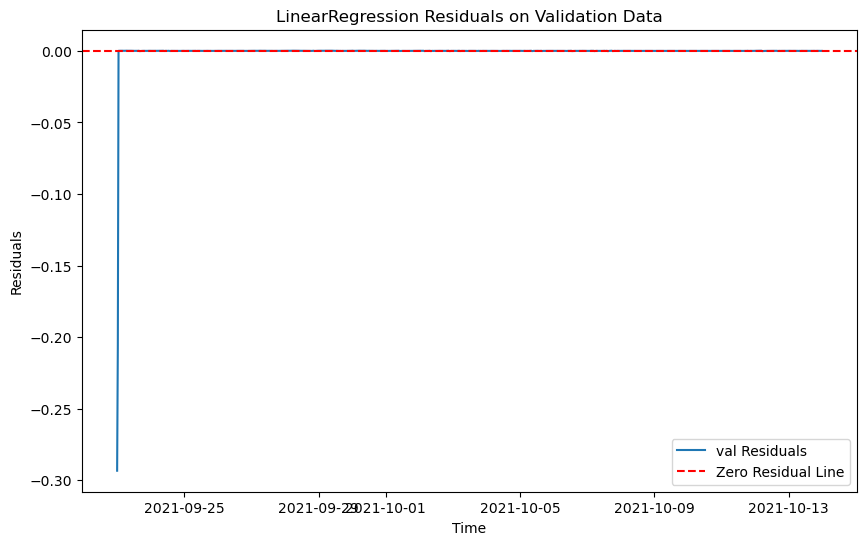

RMSE on training data for LinearRegression: 0.0027742938526376932
RMSE on validation data for LinearRegression: 0.01128869595879622
RMSE on test data for LinearRegression: 0.0020546369401760614

Best model is LinearRegression with RMSE: 0.01128869595879622
Best model saved as: models\model_335.pkl
data num 49
train_338.csv
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.583384407559289e-22
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

New p-value after differencing: 7.585527591508755e-30
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


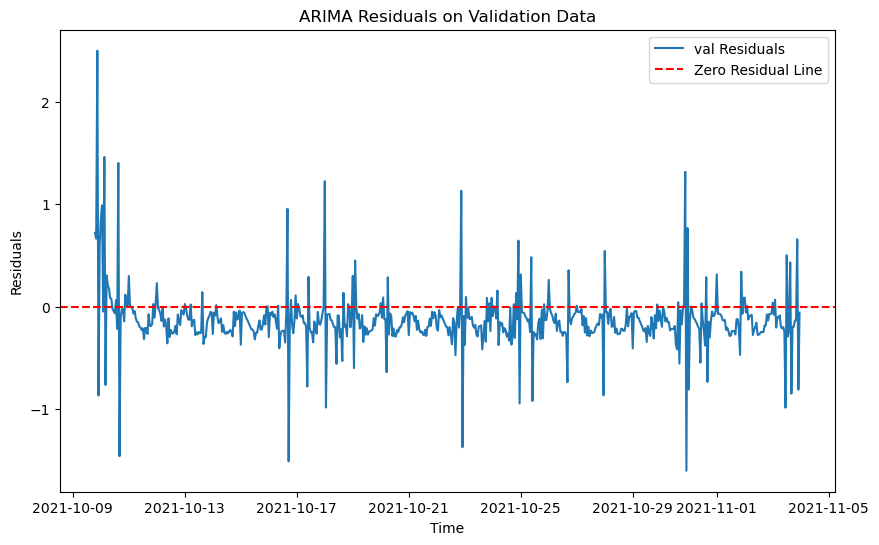

RMSE on training data for ARIMA: 0.22115885619106726
RMSE on validation data for ARIMA: 0.31915272269477796
RMSE on test data for ARIMA: 0.3053488665278436


21:48:04 - cmdstanpy - INFO - Chain [1] start processing
21:48:04 - cmdstanpy - INFO - Chain [1] done processing


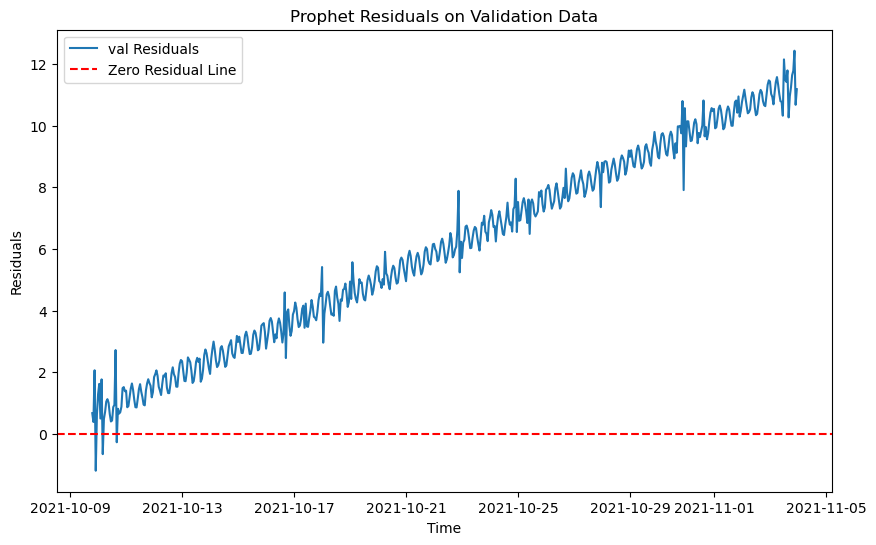

RMSE on training data for Prophet: 0.18465169207701349
RMSE on validation data for Prophet: 6.793479114041086
RMSE on test data for Prophet: 13.970492022377302


<Figure size 1000x800 with 0 Axes>

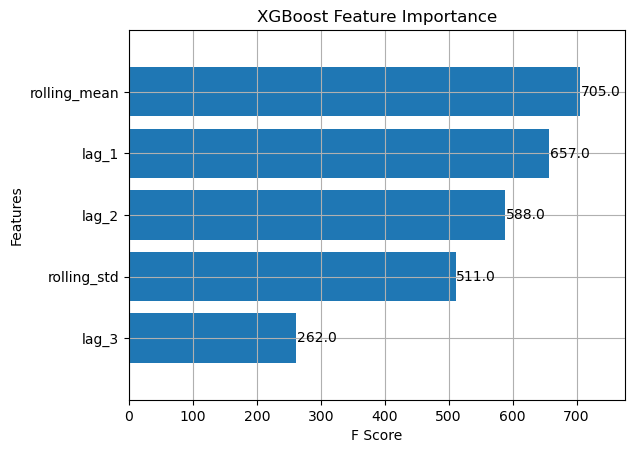

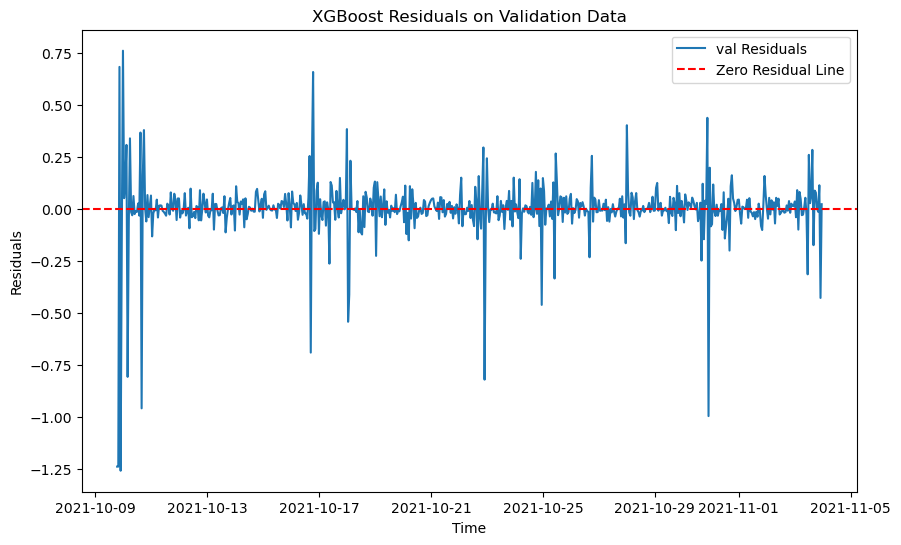

RMSE on training data for XGBoost: 0.02584594353428404
RMSE on validation data for XGBoost: 0.15559233759797297
RMSE on test data for XGBoost: 0.13397942364259333


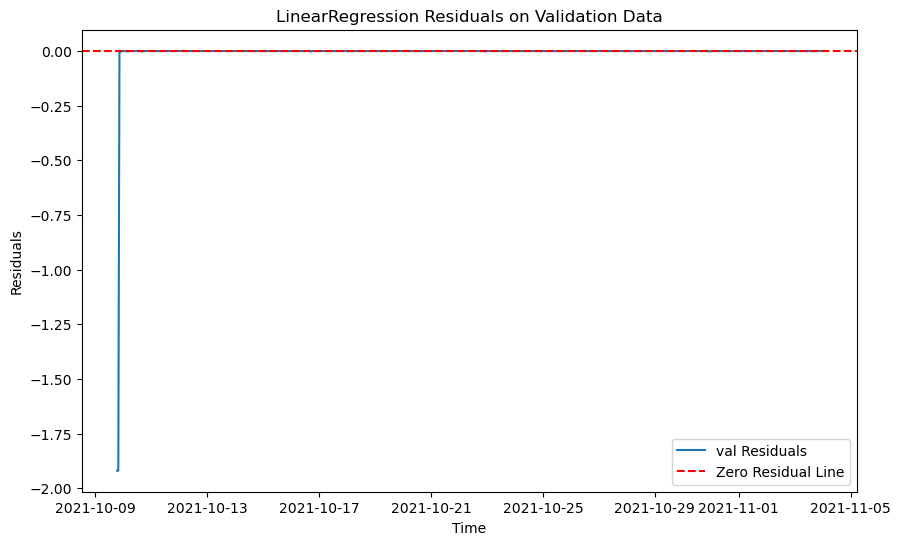

RMSE on training data for LinearRegression: 0.006139193605040218
RMSE on validation data for LinearRegression: 0.1104002367020407
RMSE on test data for LinearRegression: 0.000744763379887436

Best model is LinearRegression with RMSE: 0.1104002367020407
Best model saved as: models\model_338.pkl
data num 50
train_348.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

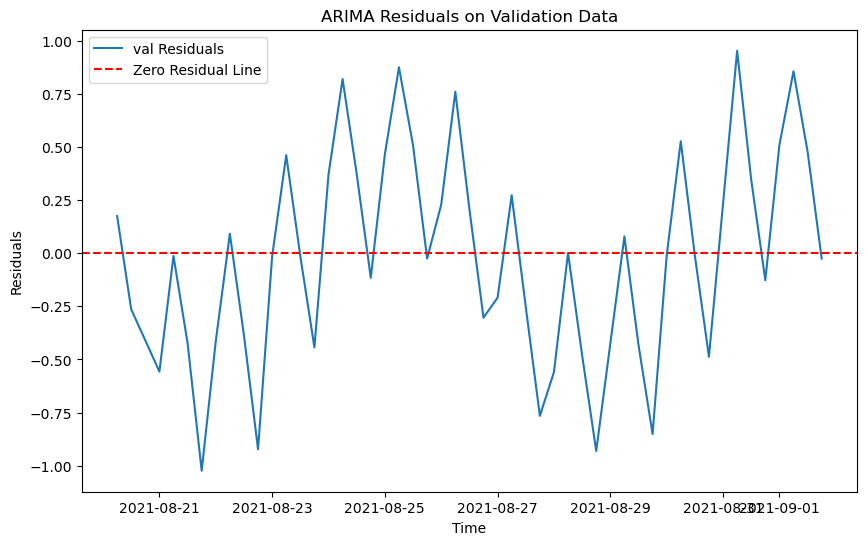

21:48:07 - cmdstanpy - INFO - Chain [1] start processing
21:48:07 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.4199126511113594
RMSE on validation data for ARIMA: 0.4947015588781136
RMSE on test data for ARIMA: 0.4973205337528704


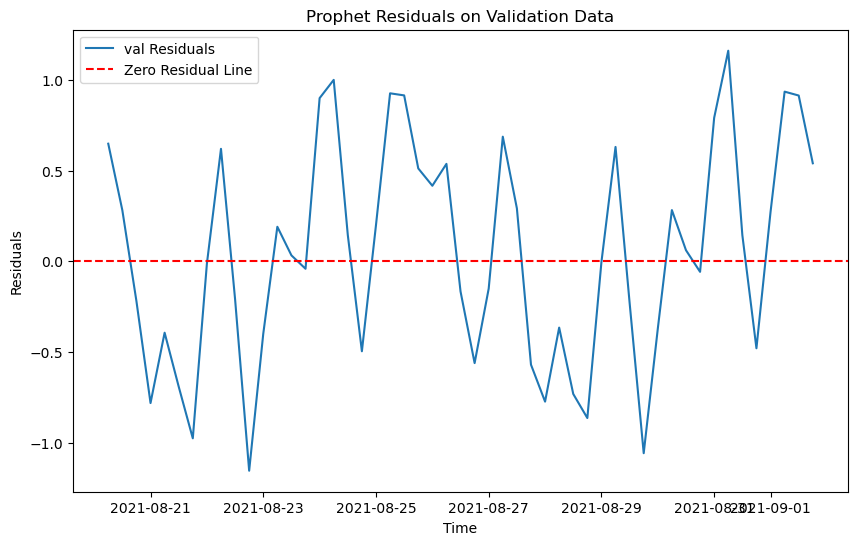

RMSE on training data for Prophet: 0.2156391373809135
RMSE on validation data for Prophet: 0.6046190460942131
RMSE on test data for Prophet: 0.6060952106077473


<Figure size 1000x800 with 0 Axes>

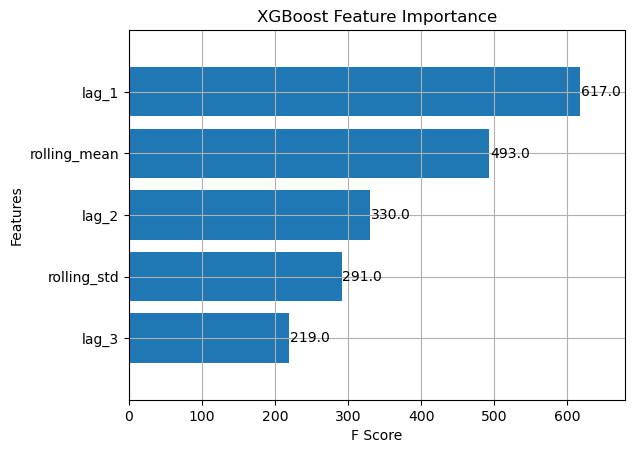

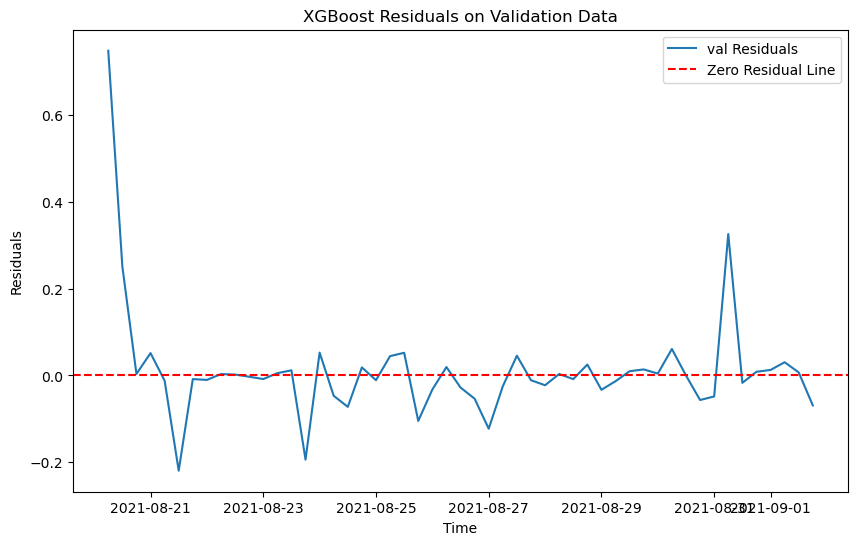

RMSE on training data for XGBoost: 0.026626639910156687
RMSE on validation data for XGBoost: 0.13191334963120796
RMSE on test data for XGBoost: 0.1252134279180702


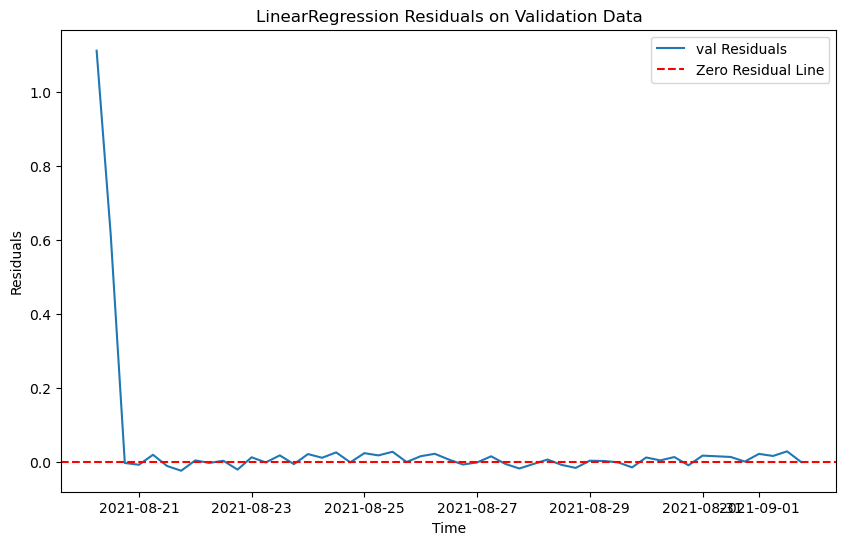

RMSE on training data for LinearRegression: 0.06331460968480765
RMSE on validation data for LinearRegression: 0.1784505612561017
RMSE on test data for LinearRegression: 0.040318120963115586

Best model is XGBoost with RMSE: 0.13191334963120796
Best model saved as: models\model_348.pkl
data num 51
train_352.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


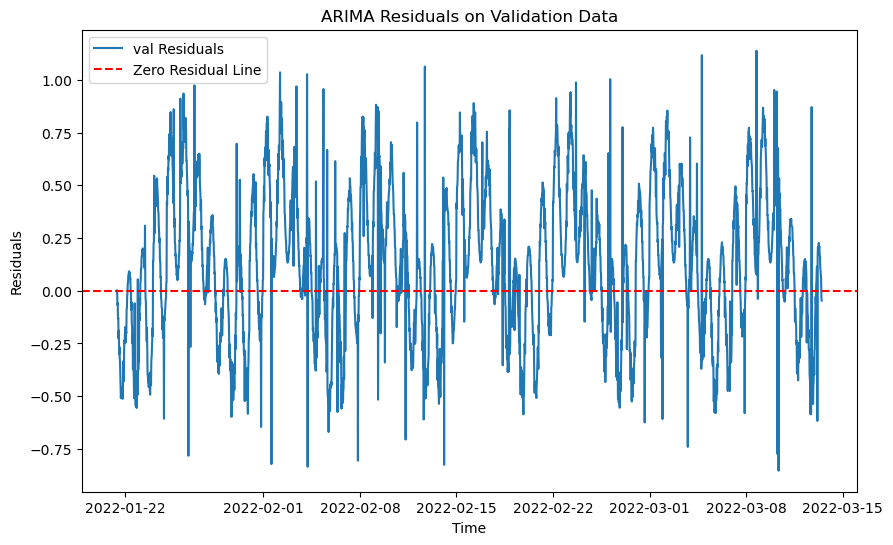

RMSE on training data for ARIMA: 0.18577860814554503
RMSE on validation data for ARIMA: 0.37635230164100403
RMSE on test data for ARIMA: 0.5602014975394924


21:48:14 - cmdstanpy - INFO - Chain [1] start processing
21:48:15 - cmdstanpy - INFO - Chain [1] done processing


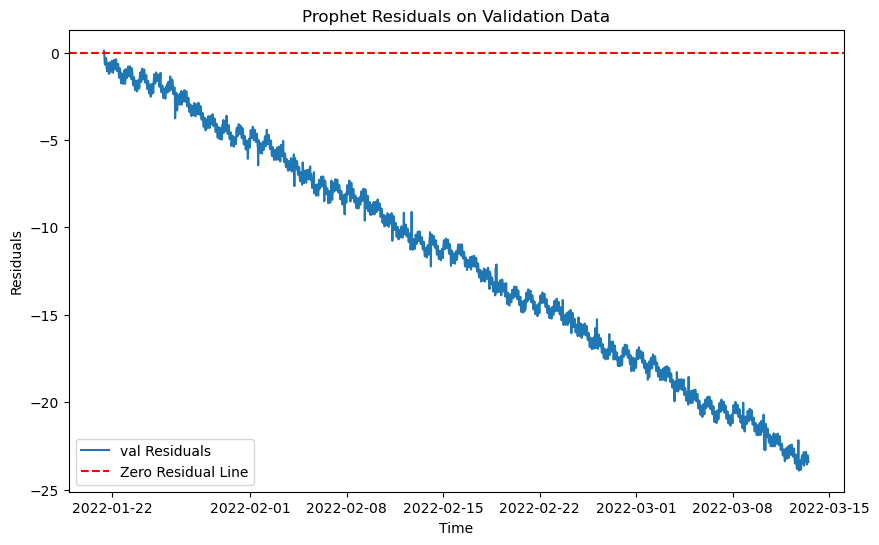

RMSE on training data for Prophet: 0.1728665360866145
RMSE on validation data for Prophet: 13.534640200797641
RMSE on test data for Prophet: 28.427010962267055


<Figure size 1000x800 with 0 Axes>

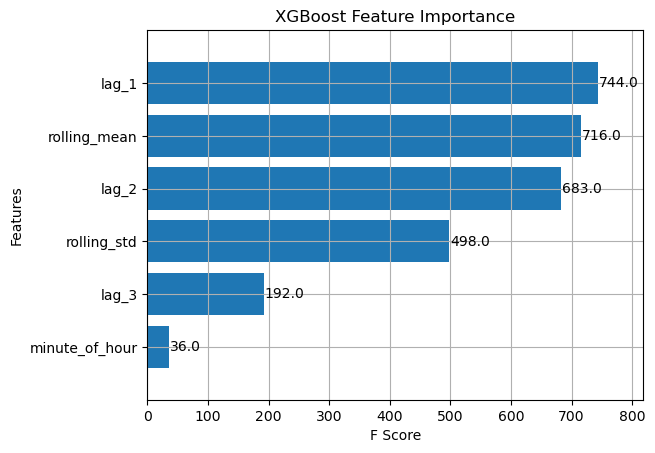

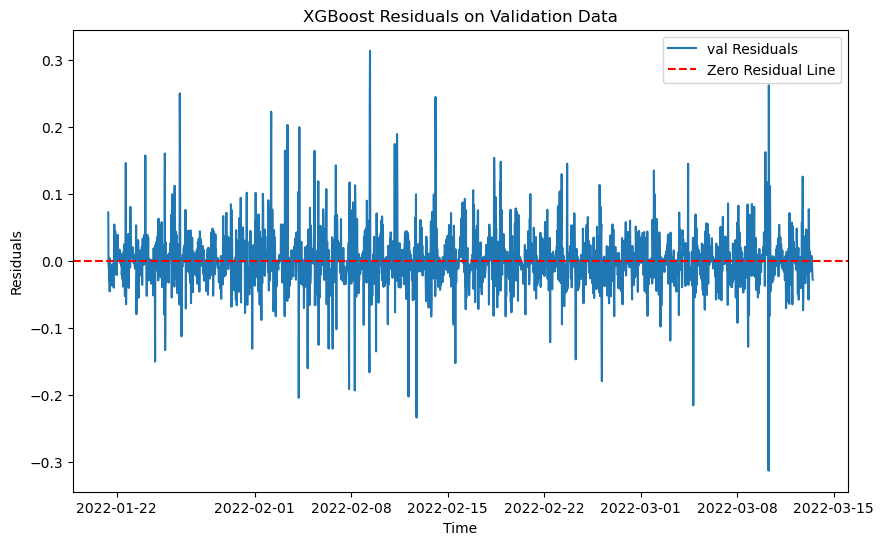

RMSE on training data for XGBoost: 0.031232371554372973
RMSE on validation data for XGBoost: 0.040655311864106154
RMSE on test data for XGBoost: 0.10055313187103554


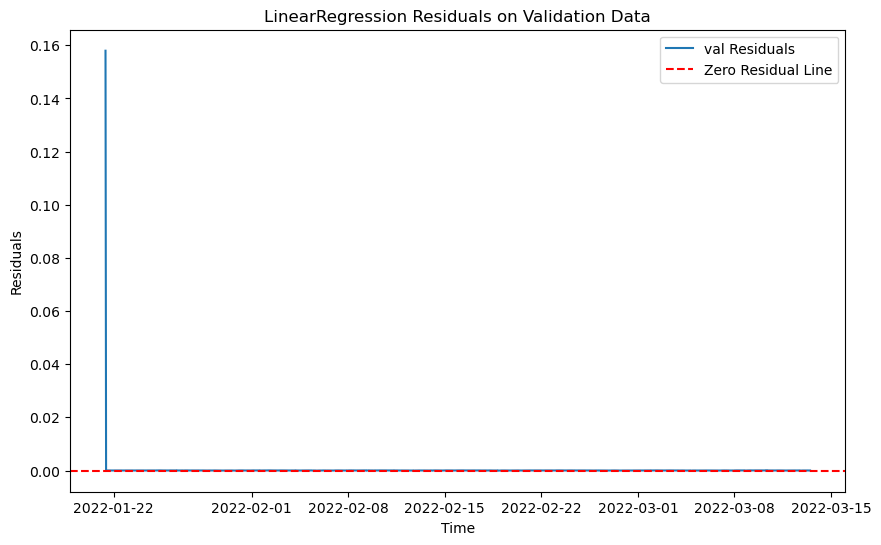

RMSE on training data for LinearRegression: 0.0010774792807863825
RMSE on validation data for LinearRegression: 0.0035665747221333005
RMSE on test data for LinearRegression: 0.008984616851352633

Best model is LinearRegression with RMSE: 0.0035665747221333005
Best model saved as: models\model_352.pkl
data num 52
train_354.csv
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.6193126883766205e-18
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

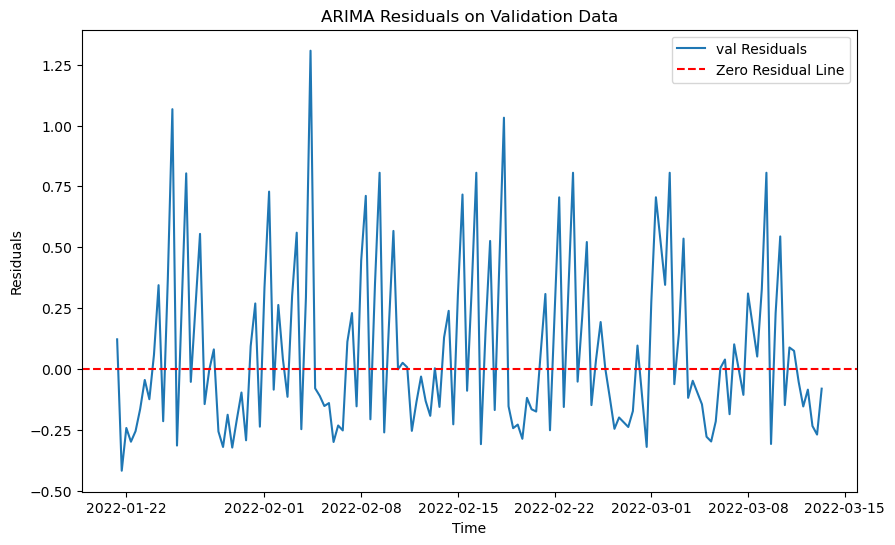

21:48:21 - cmdstanpy - INFO - Chain [1] start processing
21:48:21 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.32591340079340286
RMSE on validation data for ARIMA: 0.3477518538173284
RMSE on test data for ARIMA: 1.1354287703129131


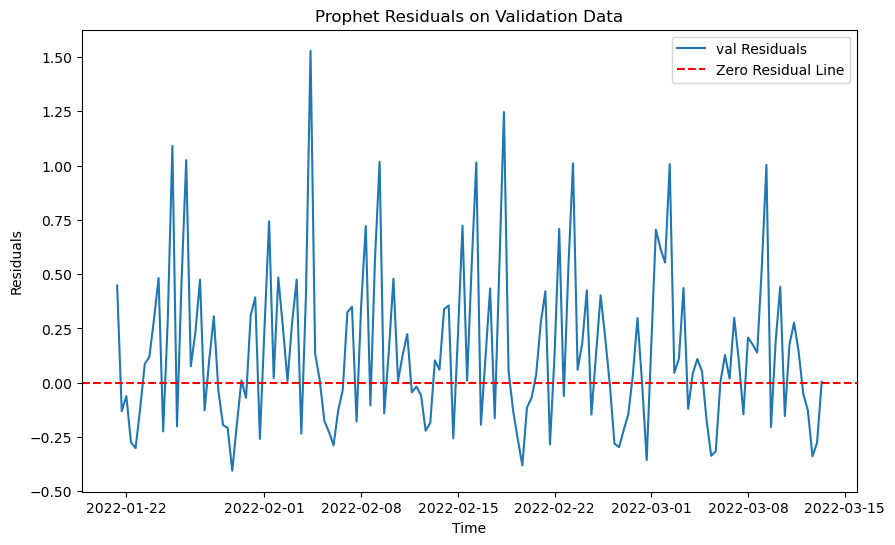

RMSE on training data for Prophet: 0.30222751257280106
RMSE on validation data for Prophet: 0.3913322861906513
RMSE on test data for Prophet: 1.1833210594480263


<Figure size 1000x800 with 0 Axes>

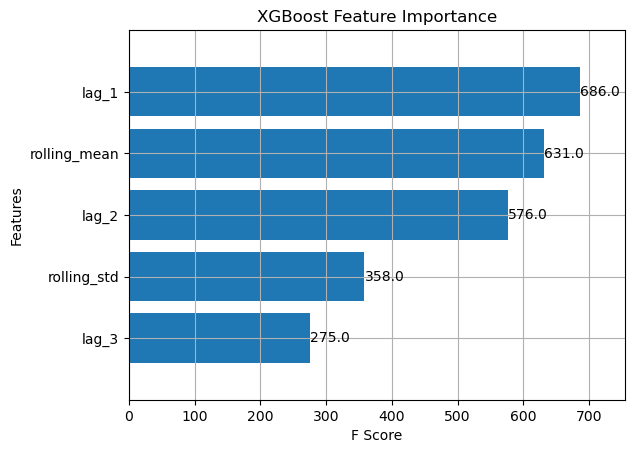

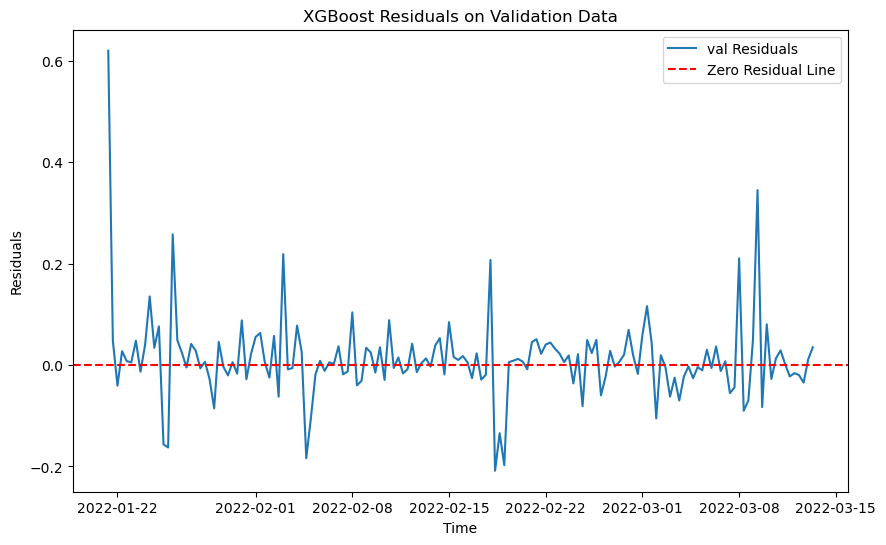

RMSE on training data for XGBoost: 0.01690275477683952
RMSE on validation data for XGBoost: 0.08623807679902207
RMSE on test data for XGBoost: 0.8791443515623638


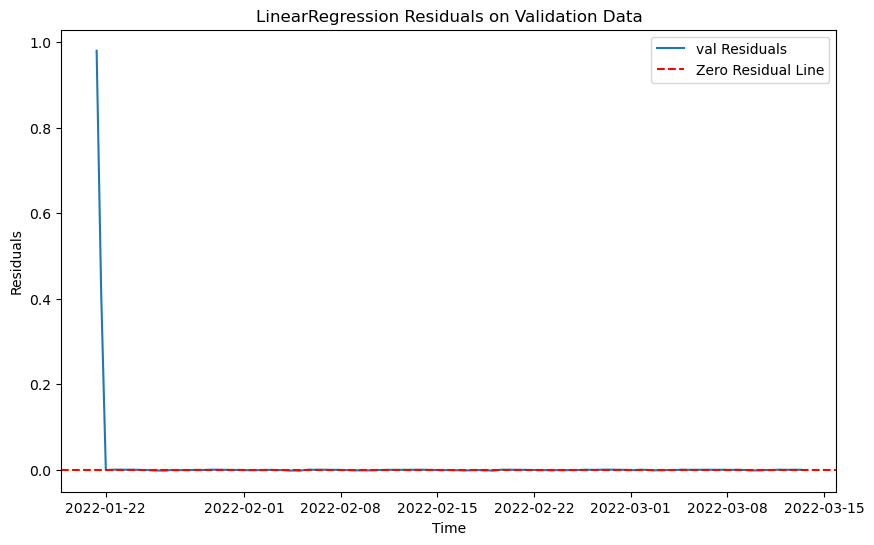

RMSE on training data for LinearRegression: 0.016338487095094723
RMSE on validation data for LinearRegression: 0.0855839204069855
RMSE on test data for LinearRegression: 0.006680259511788996

Best model is LinearRegression with RMSE: 0.0855839204069855
Best model saved as: models\model_354.pkl
data num 53
train_361.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.9458138301205273e-28
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


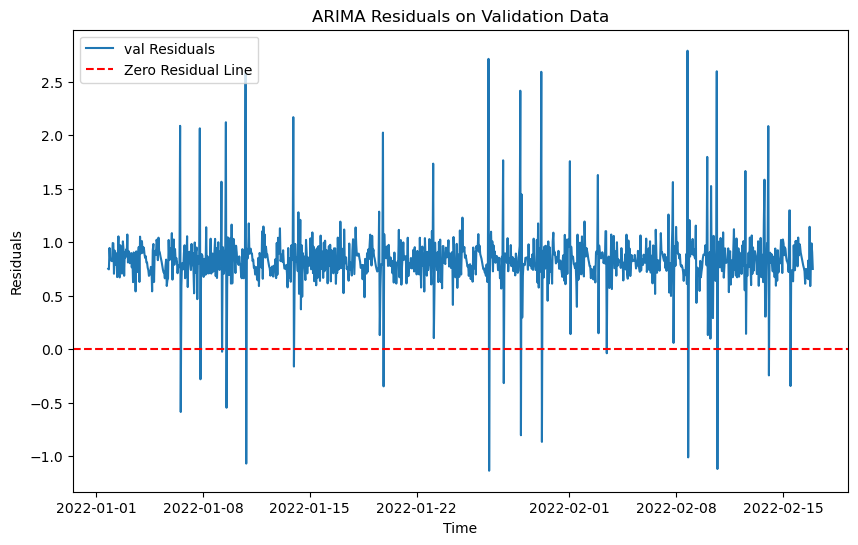

RMSE on training data for ARIMA: 0.2815927644653189
RMSE on validation data for ARIMA: 0.8771612092236515
RMSE on test data for ARIMA: 0.5728401772869146


21:48:25 - cmdstanpy - INFO - Chain [1] start processing
21:48:25 - cmdstanpy - INFO - Chain [1] done processing


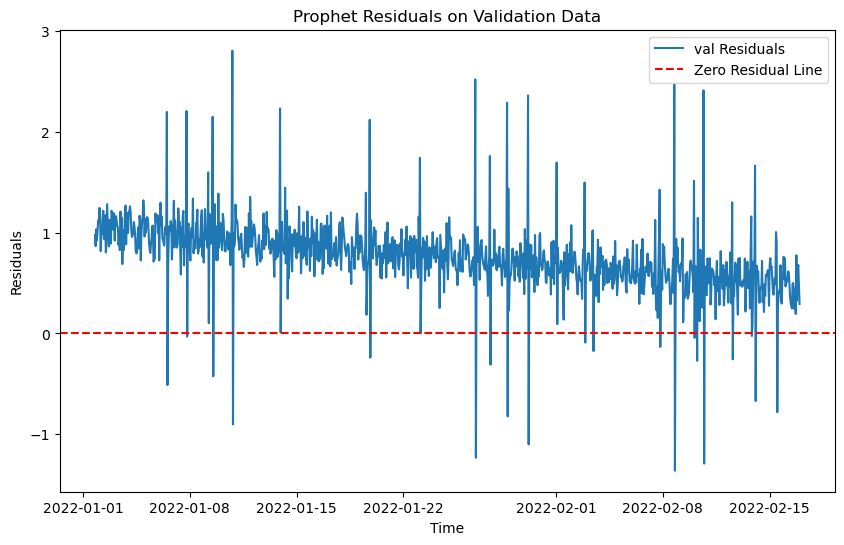

RMSE on training data for Prophet: 0.292705757832955
RMSE on validation data for Prophet: 0.8359707531020232
RMSE on test data for Prophet: 0.5817392936731403


<Figure size 1000x800 with 0 Axes>

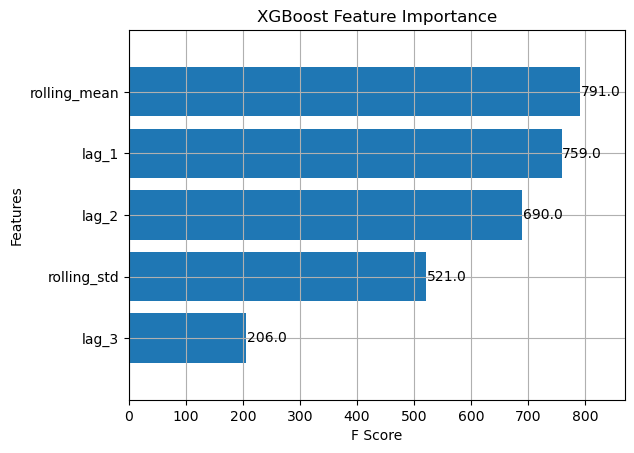

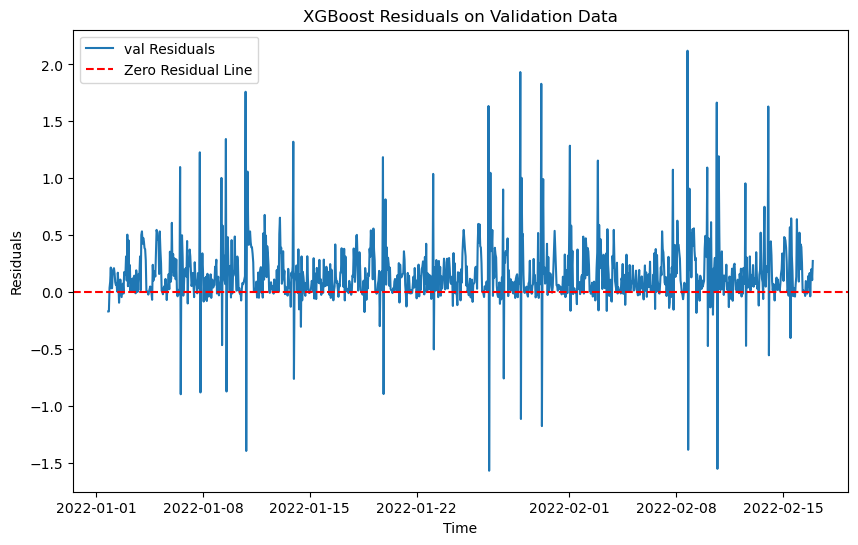

RMSE on training data for XGBoost: 0.02201339095166039
RMSE on validation data for XGBoost: 0.3198568455990877
RMSE on test data for XGBoost: 0.3243031942016554


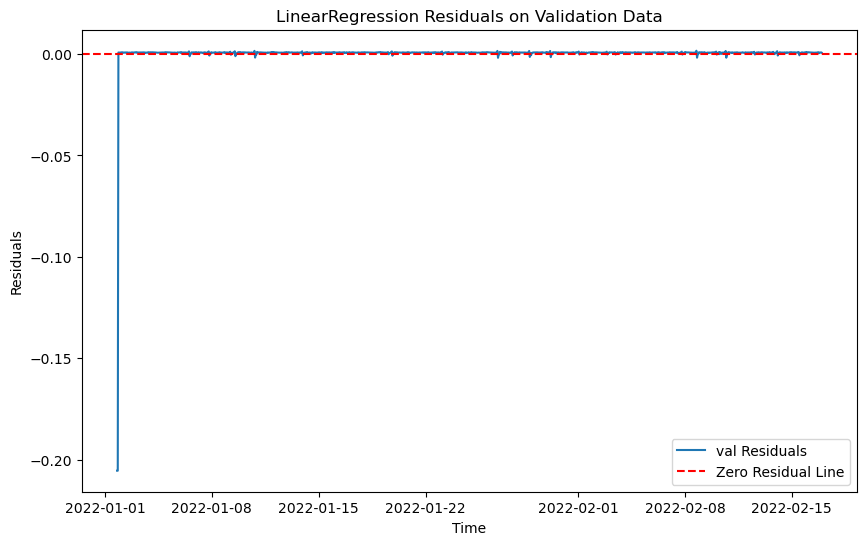

RMSE on training data for LinearRegression: 0.006322751802287277
RMSE on validation data for LinearRegression: 0.008756245438563636
RMSE on test data for LinearRegression: 0.01019705103724681

Best model is LinearRegression with RMSE: 0.008756245438563636
Best model saved as: models\model_361.pkl
data num 54
train_367.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


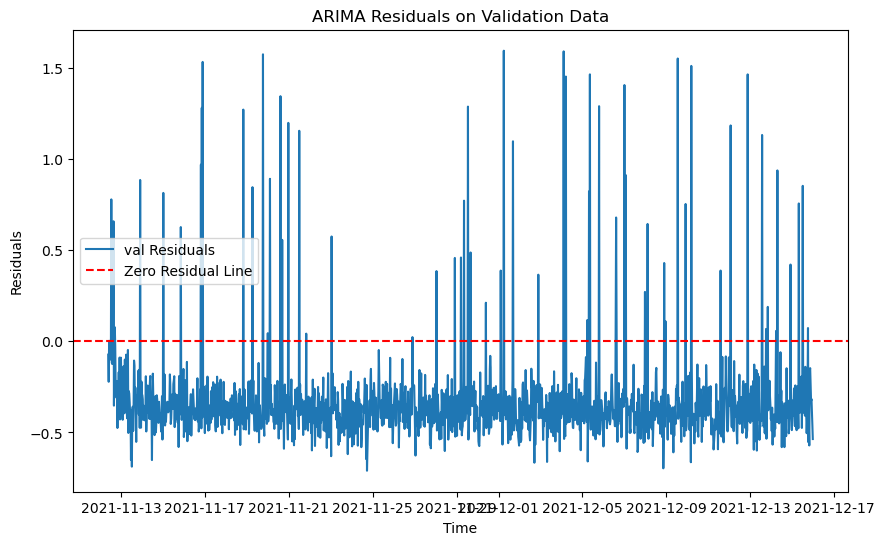

21:48:31 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.28364006062276387
RMSE on validation data for ARIMA: 0.42267013057432384
RMSE on test data for ARIMA: 0.5682948615053403


21:48:32 - cmdstanpy - INFO - Chain [1] done processing


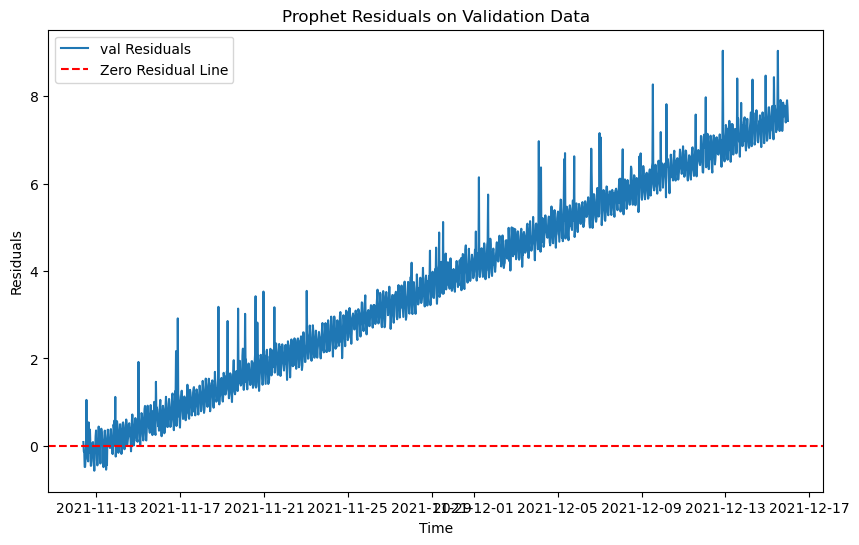

RMSE on training data for Prophet: 0.3902475314813543
RMSE on validation data for Prophet: 4.378976340155685
RMSE on test data for Prophet: 9.94060000804108


<Figure size 1000x800 with 0 Axes>

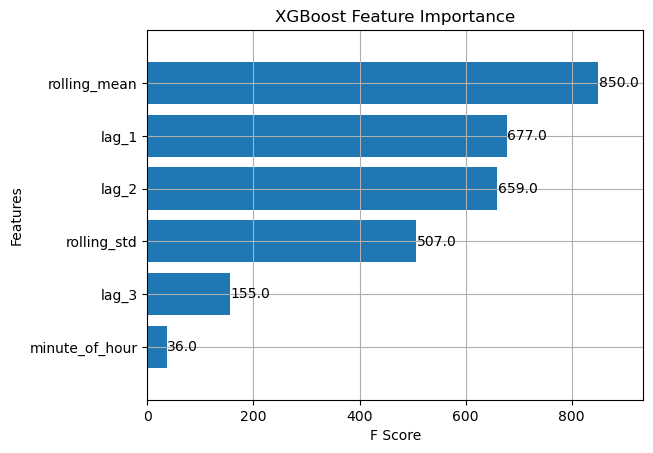

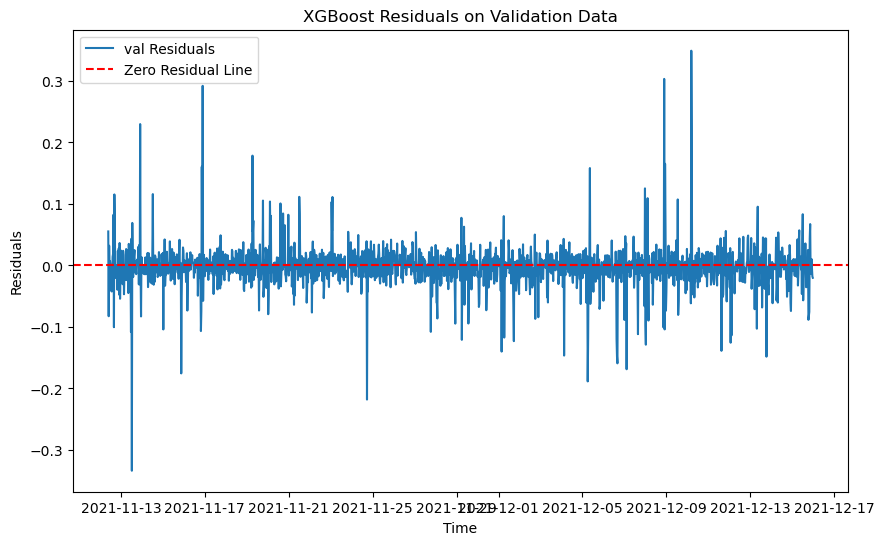

RMSE on training data for XGBoost: 0.03490496479503361
RMSE on validation data for XGBoost: 0.03684436136301369
RMSE on test data for XGBoost: 0.05708794364603982


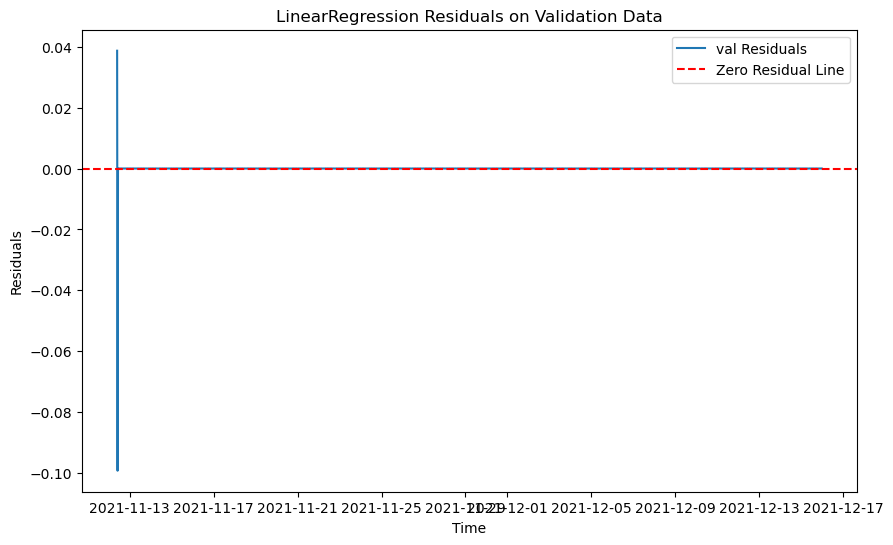

RMSE on training data for LinearRegression: 0.000597738493148451
RMSE on validation data for LinearRegression: 0.0026518548878710097
RMSE on test data for LinearRegression: 0.003949599260291929

Best model is LinearRegression with RMSE: 0.0026518548878710097
Best model saved as: models\model_367.pkl
data num 55
train_370.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

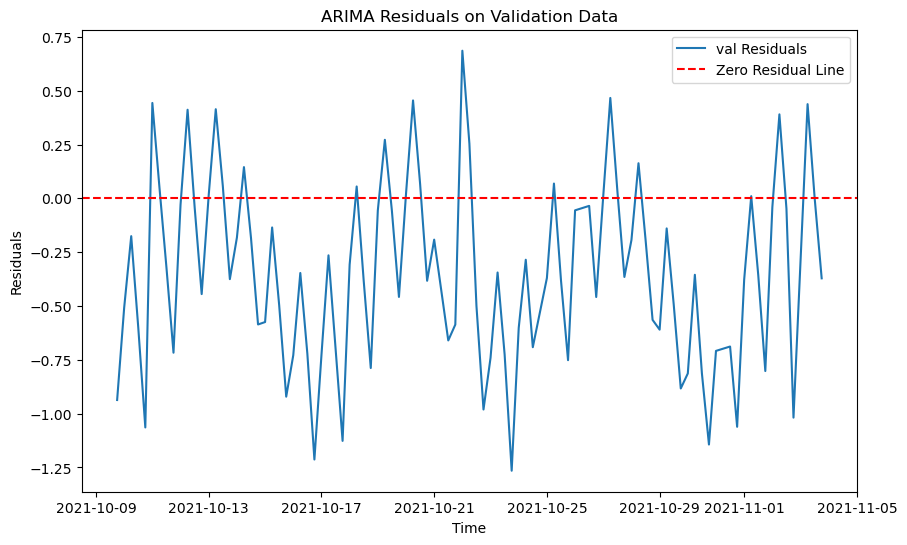

21:48:36 - cmdstanpy - INFO - Chain [1] start processing
21:48:36 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.35820498995382277
RMSE on validation data for ARIMA: 0.5487351098776847
RMSE on test data for ARIMA: 0.5581129898080165


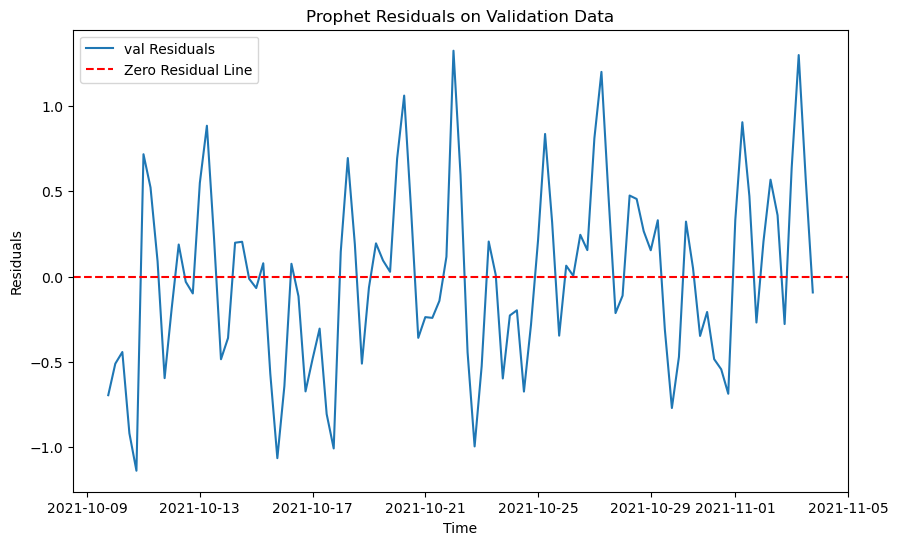

RMSE on training data for Prophet: 0.2057454900274566
RMSE on validation data for Prophet: 0.5277510914269358
RMSE on test data for Prophet: 0.6288146691335454


<Figure size 1000x800 with 0 Axes>

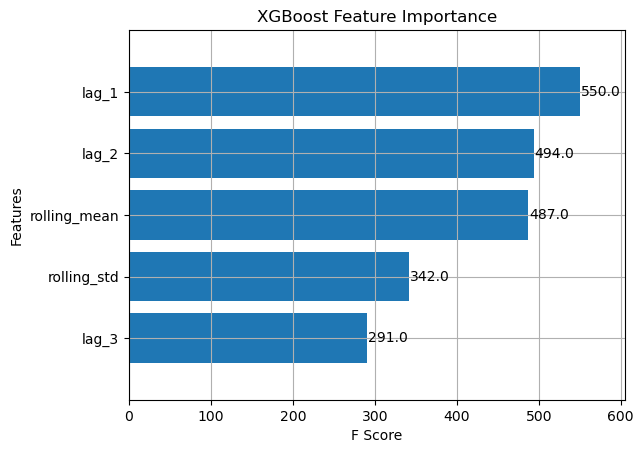

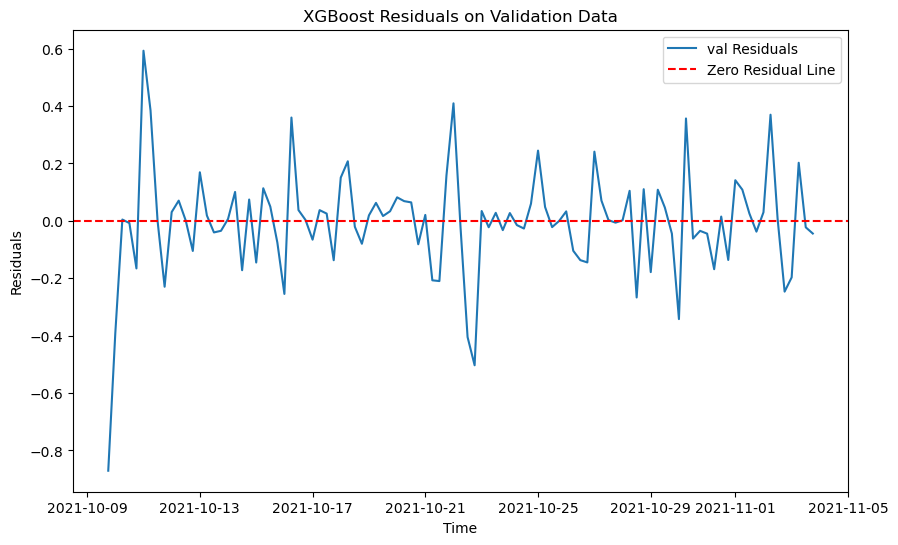

RMSE on training data for XGBoost: 0.01604569430168136
RMSE on validation data for XGBoost: 0.18846535589497845
RMSE on test data for XGBoost: 0.17901176812100403


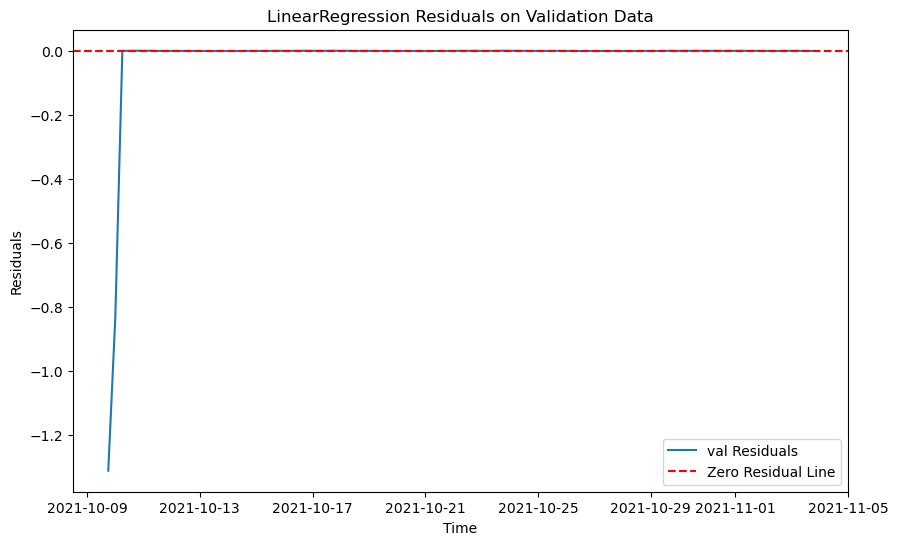

RMSE on training data for LinearRegression: 0.00897635547021933
RMSE on validation data for LinearRegression: 0.15473429283190918
RMSE on test data for LinearRegression: 0.10961612502800658

Best model is LinearRegression with RMSE: 0.15473429283190918
Best model saved as: models\model_370.pkl
data num 56
train_383.csv
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

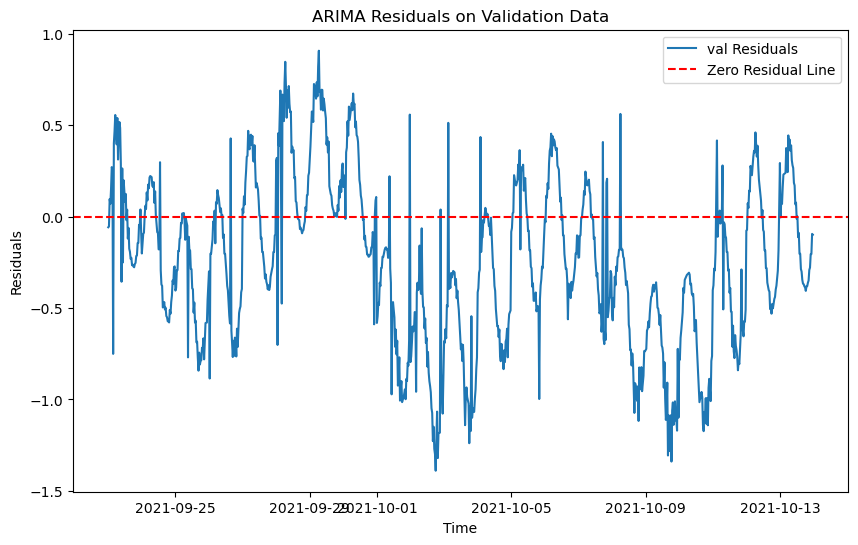

21:48:40 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.20280943739408747
RMSE on validation data for ARIMA: 0.5175274311993984
RMSE on test data for ARIMA: 0.5744956996859956


21:48:40 - cmdstanpy - INFO - Chain [1] done processing


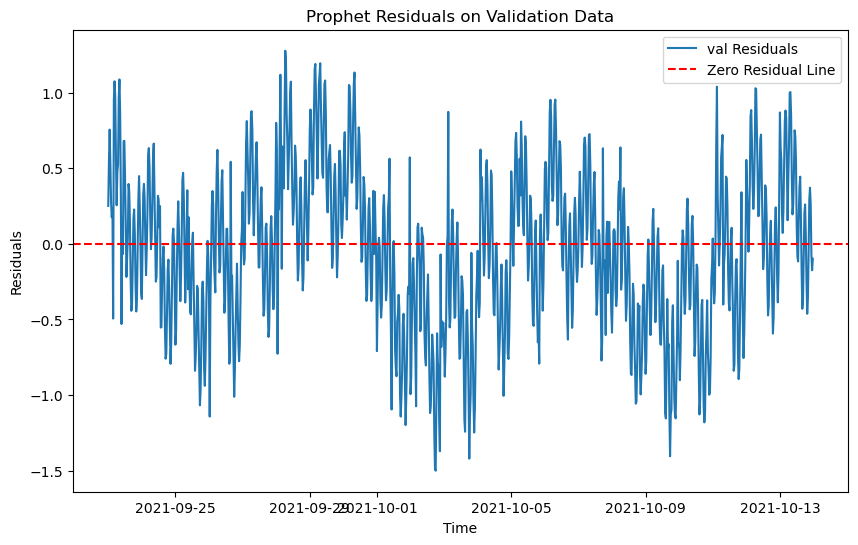

RMSE on training data for Prophet: 0.17904778980017008
RMSE on validation data for Prophet: 0.5249049796335363
RMSE on test data for Prophet: 0.5202462080320388


<Figure size 1000x800 with 0 Axes>

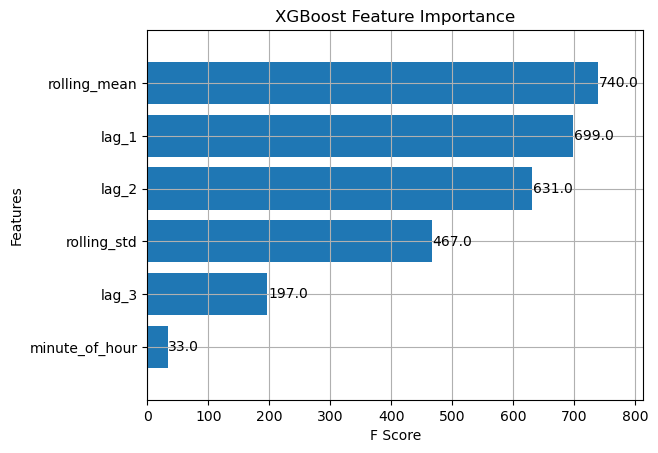

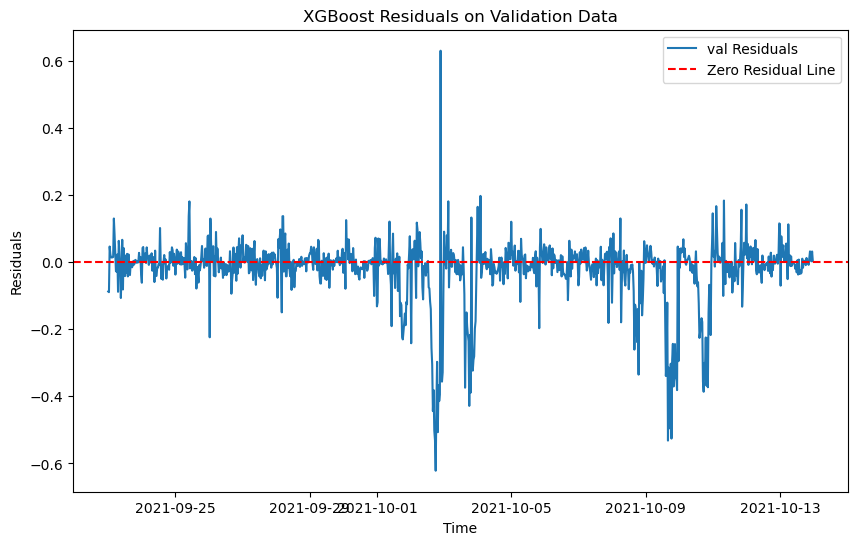

RMSE on training data for XGBoost: 0.029771781789009827
RMSE on validation data for XGBoost: 0.10169512611067667
RMSE on test data for XGBoost: 0.1280771840619939


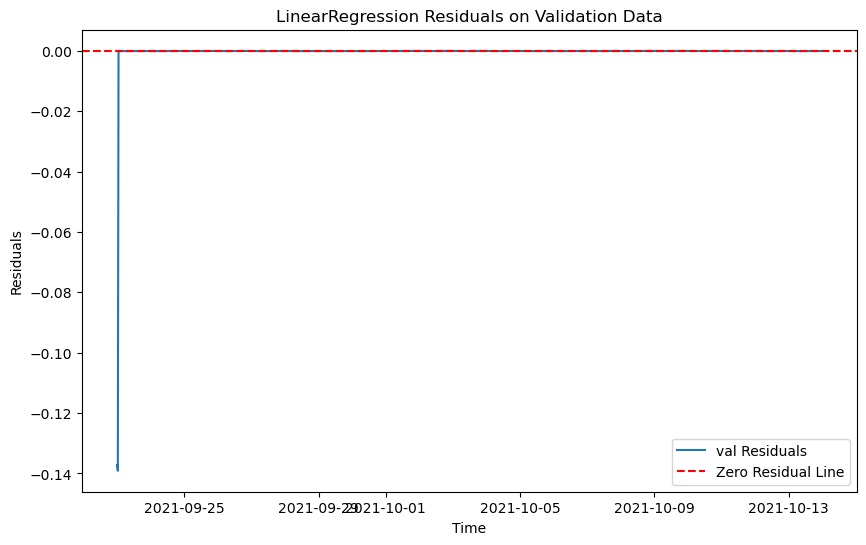

RMSE on training data for LinearRegression: 0.001204143485890151
RMSE on validation data for LinearRegression: 0.0061554446993059946
RMSE on test data for LinearRegression: 0.0031199123858843625

Best model is LinearRegression with RMSE: 0.0061554446993059946
Best model saved as: models\model_383.pkl
data num 57
train_386.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


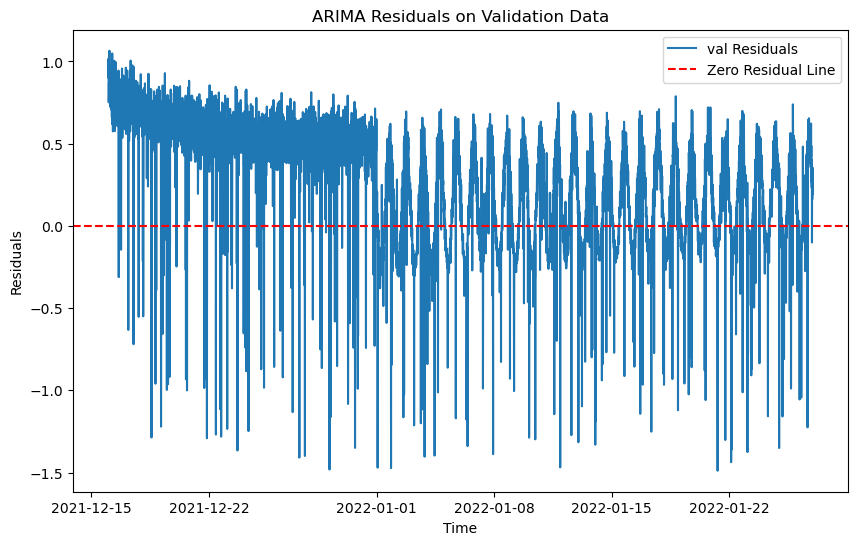

RMSE on training data for ARIMA: 0.25230174052517673
RMSE on validation data for ARIMA: 0.45781040804429396
RMSE on test data for ARIMA: 0.4079461344318417


21:48:52 - cmdstanpy - INFO - Chain [1] start processing
21:48:58 - cmdstanpy - INFO - Chain [1] done processing


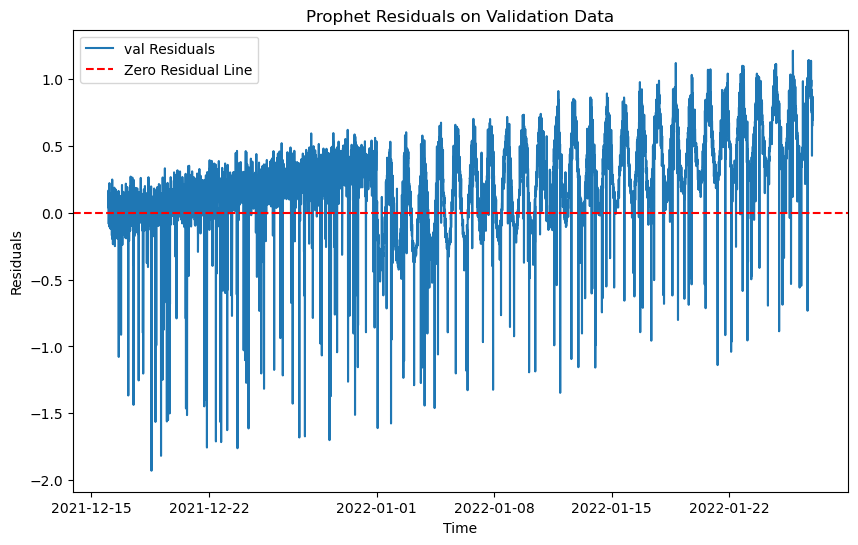

RMSE on training data for Prophet: 0.37096841529000957
RMSE on validation data for Prophet: 0.4288859527136899
RMSE on test data for Prophet: 1.1454421763097813


<Figure size 1000x800 with 0 Axes>

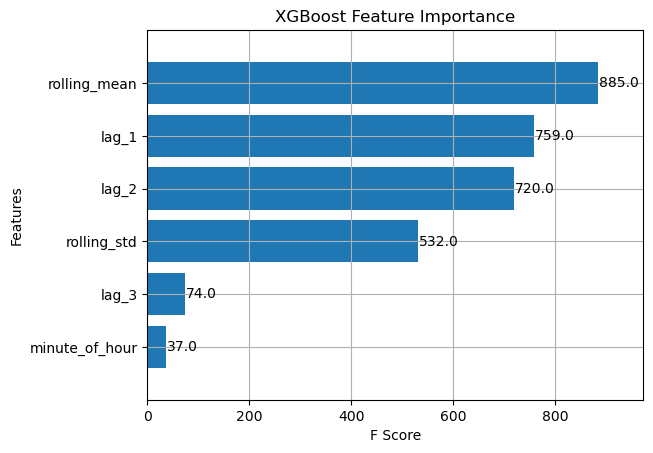

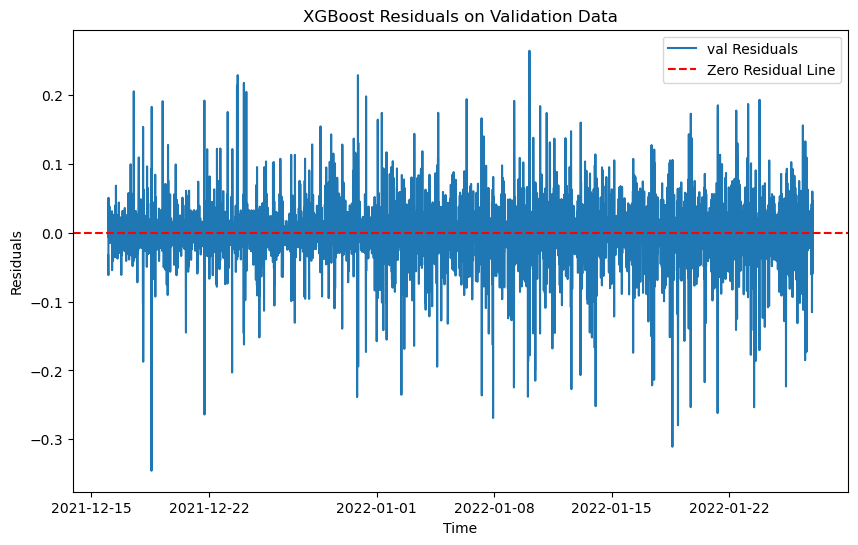

RMSE on training data for XGBoost: 0.03998019430144207
RMSE on validation data for XGBoost: 0.04128887379039516
RMSE on test data for XGBoost: 0.0473277496493659


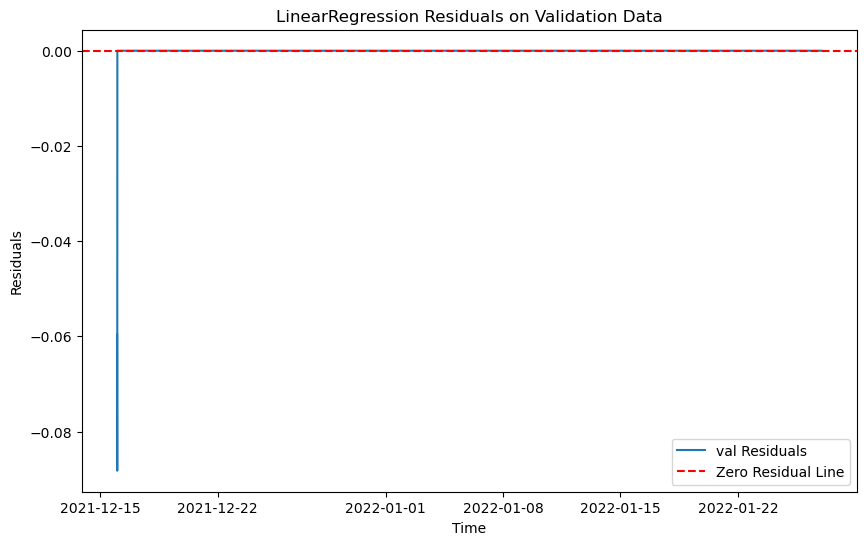

RMSE on training data for LinearRegression: 1.0059399870984012e-06
RMSE on validation data for LinearRegression: 0.001369595762321376
RMSE on test data for LinearRegression: 0.02607824561327941

Best model is LinearRegression with RMSE: 0.001369595762321376
Best model saved as: models\model_386.pkl
data num 58
train_39.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive 

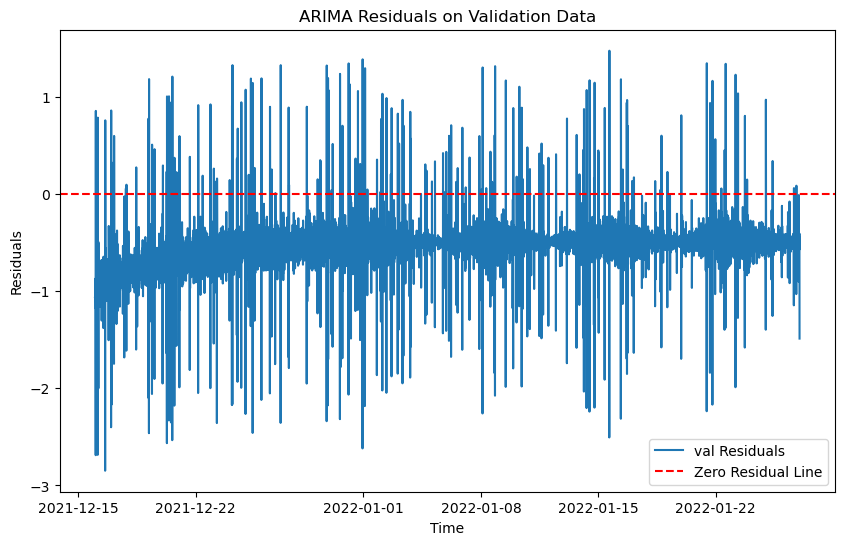

RMSE on training data for ARIMA: 0.24790606285483763
RMSE on validation data for ARIMA: 0.6345661337842557
RMSE on test data for ARIMA: 0.4090883665304084


21:49:32 - cmdstanpy - INFO - Chain [1] start processing
21:49:37 - cmdstanpy - INFO - Chain [1] done processing


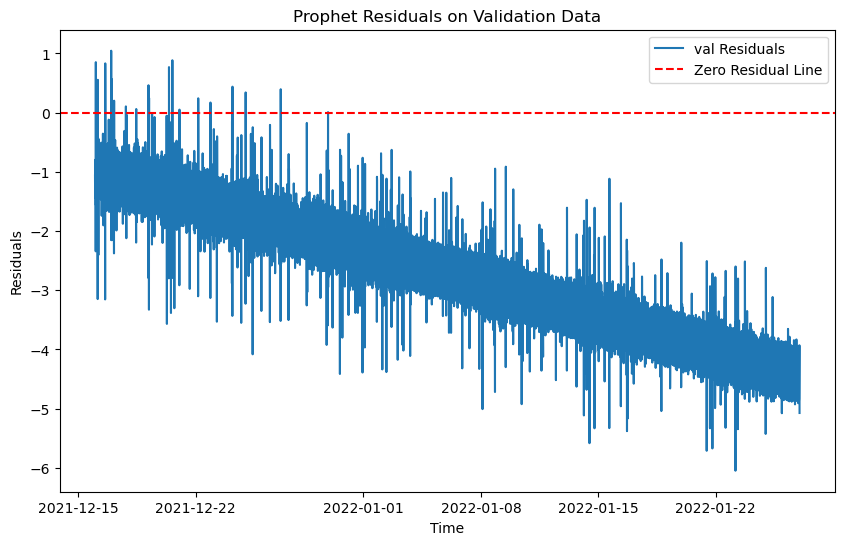

RMSE on training data for Prophet: 0.3892958621786003
RMSE on validation data for Prophet: 2.918603051635861
RMSE on test data for Prophet: 4.424617968673102


<Figure size 1000x800 with 0 Axes>

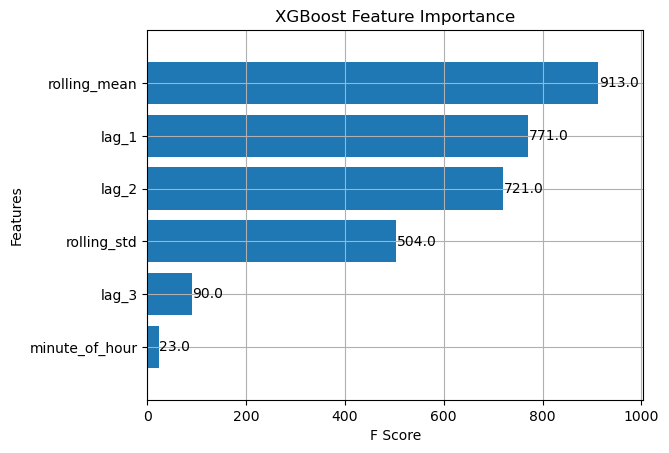

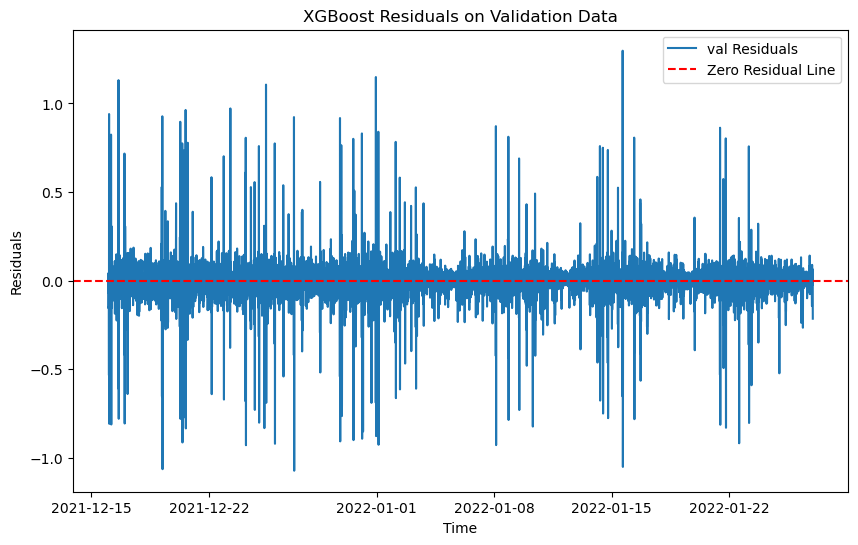

RMSE on training data for XGBoost: 0.03589971019298641
RMSE on validation data for XGBoost: 0.1365430512108233
RMSE on test data for XGBoost: 0.044553934050859646


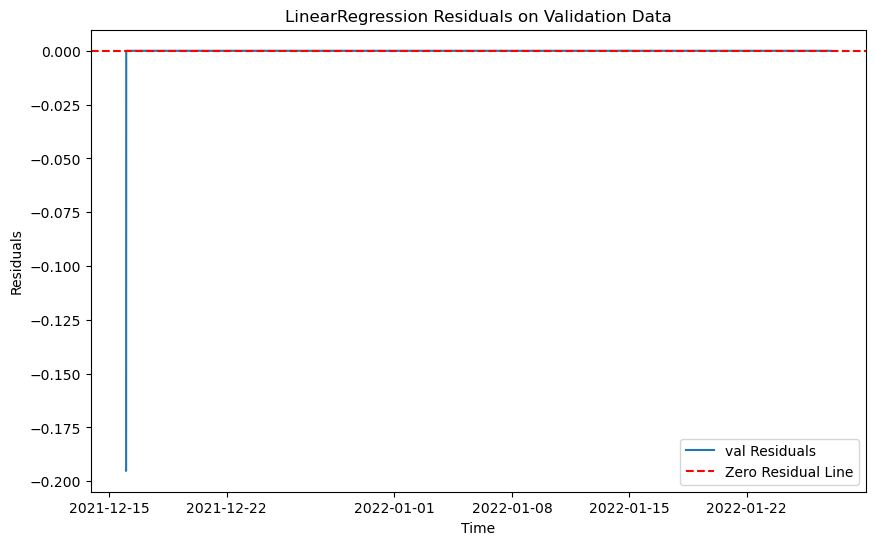

RMSE on training data for LinearRegression: 0.00046833639615565713
RMSE on validation data for LinearRegression: 0.00354746309331006
RMSE on test data for LinearRegression: 0.0011271297738213002

Best model is LinearRegression with RMSE: 0.00354746309331006
Best model saved as: models\model_39.pkl
data num 59
train_391.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

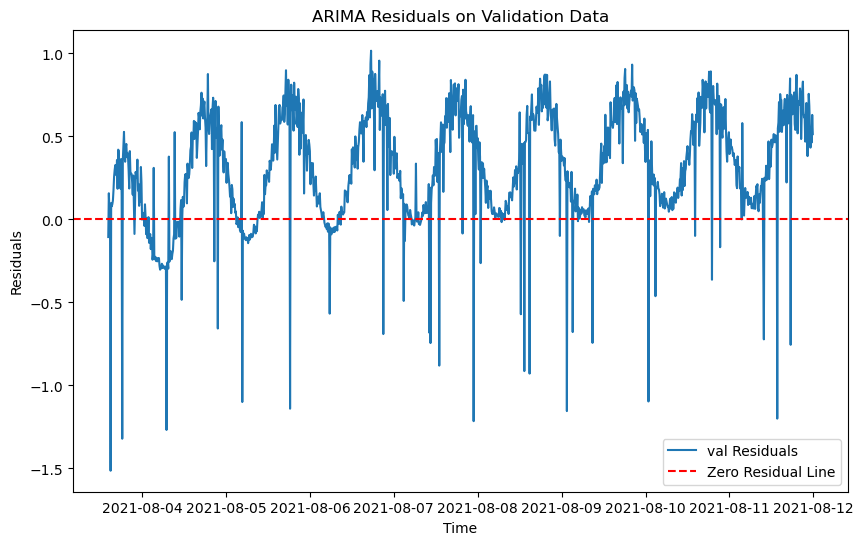

21:49:54 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.22586352598677528
RMSE on validation data for ARIMA: 0.4595009690135597
RMSE on test data for ARIMA: 0.6070090094233139


21:49:54 - cmdstanpy - INFO - Chain [1] done processing


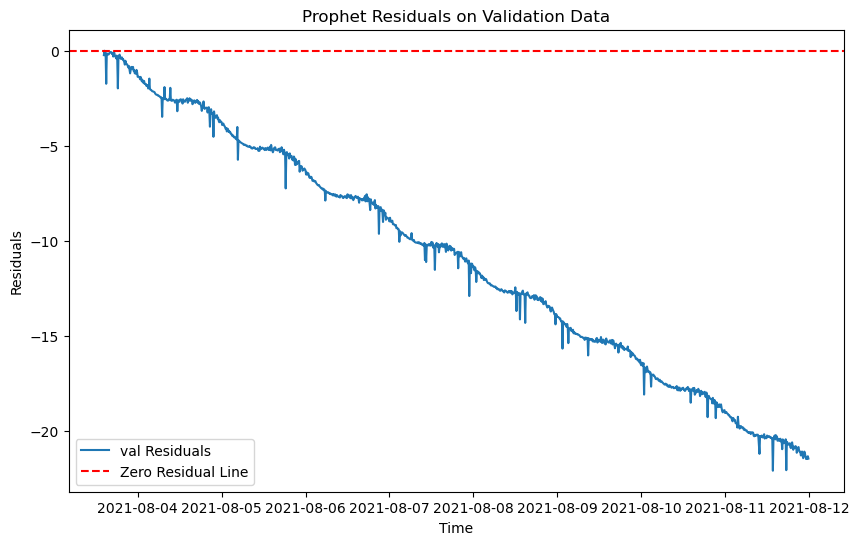

RMSE on training data for Prophet: 0.2253113343668988
RMSE on validation data for Prophet: 12.542935642537026
RMSE on test data for Prophet: 26.45257947817136


<Figure size 1000x800 with 0 Axes>

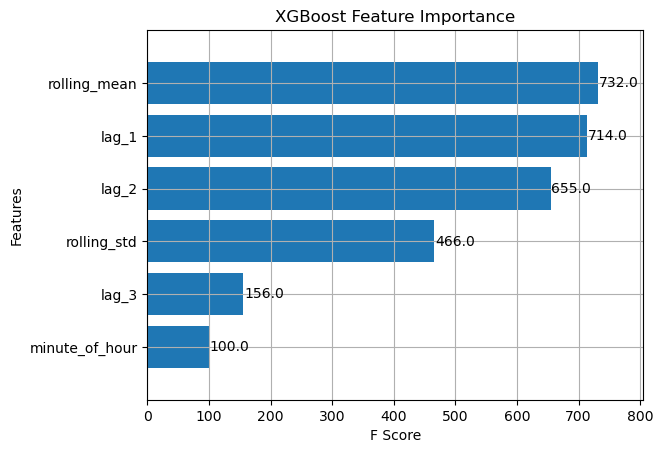

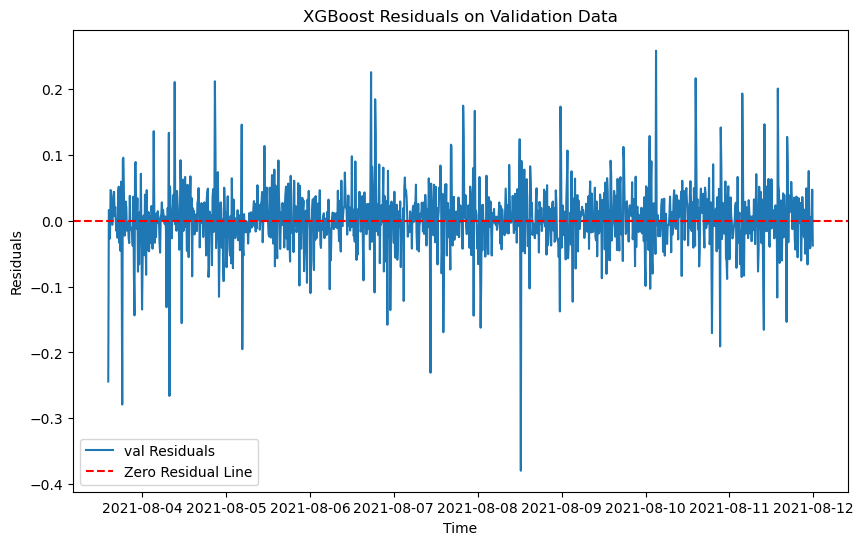

RMSE on training data for XGBoost: 0.03609781940024581
RMSE on validation data for XGBoost: 0.0505576582922952
RMSE on test data for XGBoost: 0.05777956332887493


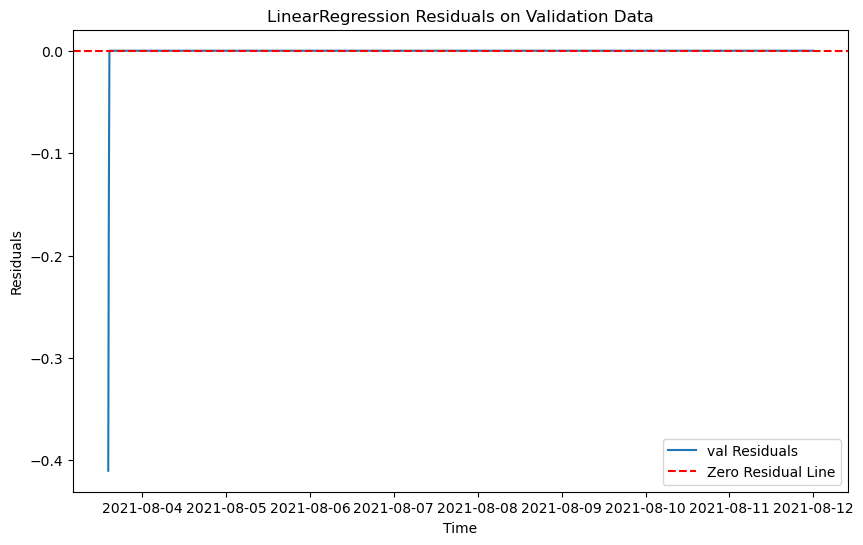

RMSE on training data for LinearRegression: 3.527206622174194e-05
RMSE on validation data for LinearRegression: 0.012552196720023452
RMSE on test data for LinearRegression: 0.005439302101750738

Best model is LinearRegression with RMSE: 0.012552196720023452
Best model saved as: models\model_391.pkl
data num 60
train_397.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 6.038033778816113e-12
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.4323629603026943e-11
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

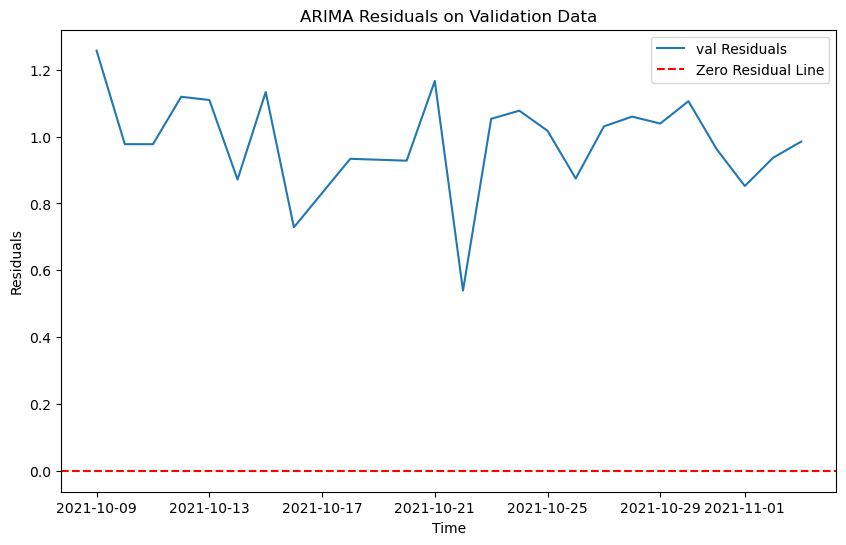

21:49:58 - cmdstanpy - INFO - Chain [1] start processing
21:49:58 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.28330618562108406
RMSE on validation data for ARIMA: 0.9914857498422164
RMSE on test data for ARIMA: 0.38233769776094234


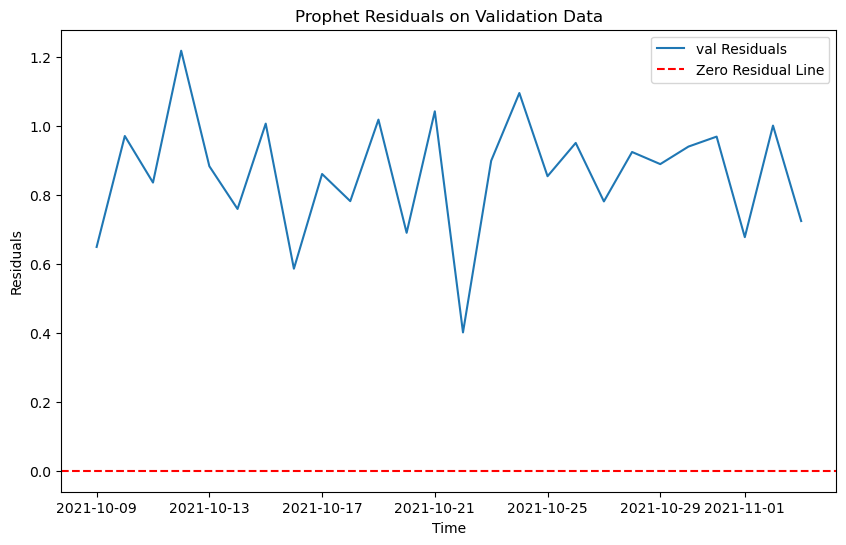

RMSE on training data for Prophet: 0.33517779905168227
RMSE on validation data for Prophet: 0.8791618381466001
RMSE on test data for Prophet: 0.4243273666543337


<Figure size 1000x800 with 0 Axes>

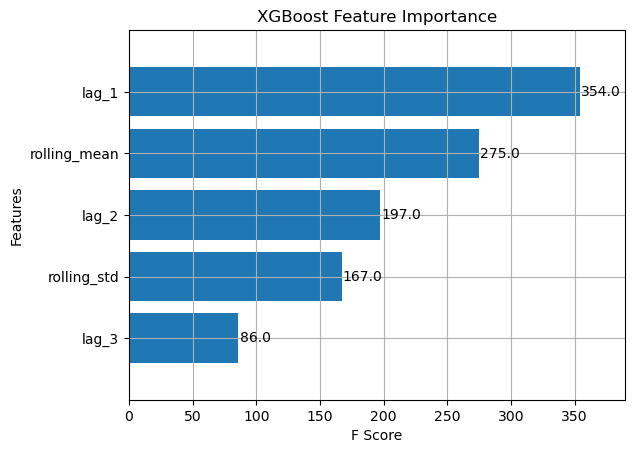

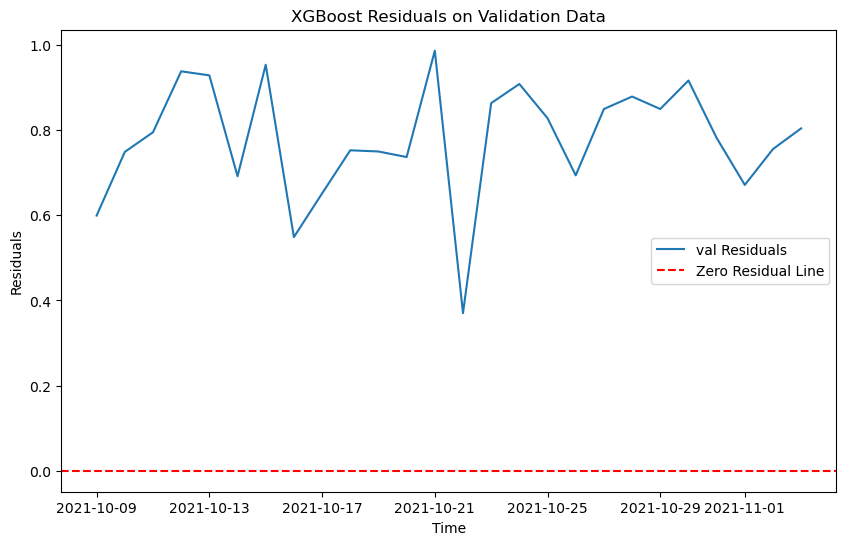

RMSE on training data for XGBoost: 0.013973043623557576
RMSE on validation data for XGBoost: 0.7911456748209548
RMSE on test data for XGBoost: 0.22362821326404886


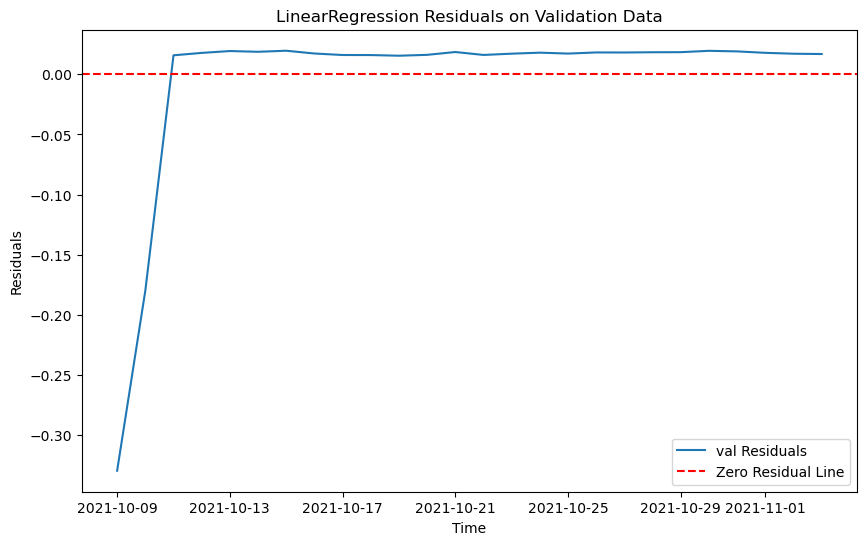

RMSE on training data for LinearRegression: 0.0220028204157127
RMSE on validation data for LinearRegression: 0.07553732649904003
RMSE on test data for LinearRegression: 0.03226312154356529

Best model is LinearRegression with RMSE: 0.07553732649904003
Best model saved as: models\model_397.pkl
data num 61
train_401.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


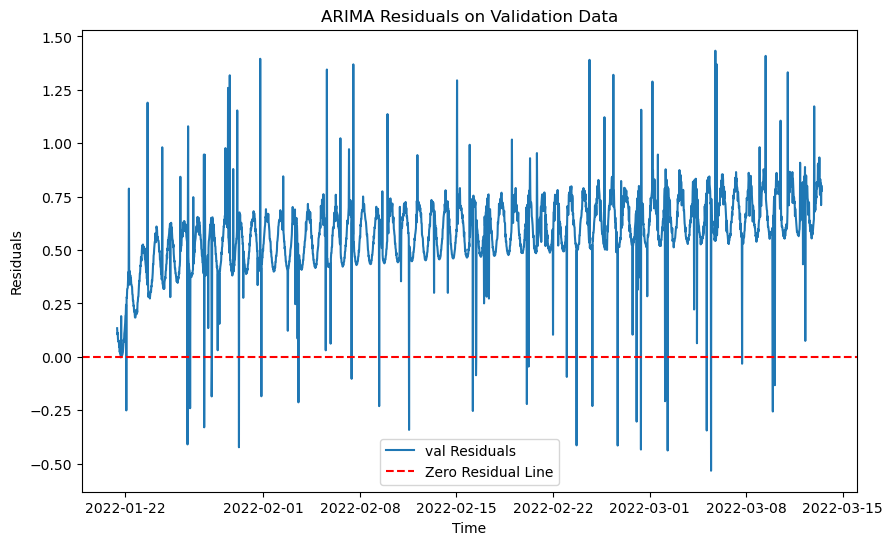

RMSE on training data for ARIMA: 0.1959116576832053
RMSE on validation data for ARIMA: 0.6085872453512483
RMSE on test data for ARIMA: 1.0610527715117273


21:50:08 - cmdstanpy - INFO - Chain [1] start processing
21:50:10 - cmdstanpy - INFO - Chain [1] done processing


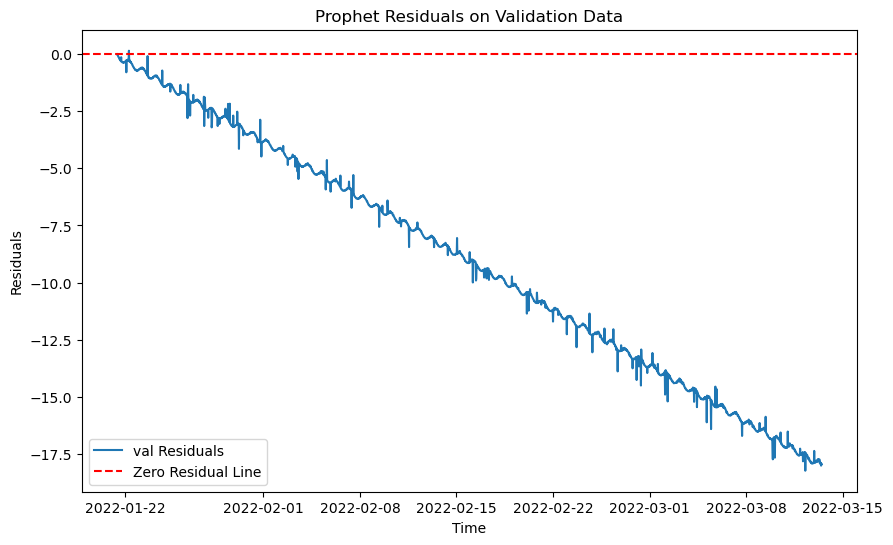

RMSE on training data for Prophet: 0.18135033632208863
RMSE on validation data for Prophet: 10.43524909063265
RMSE on test data for Prophet: 21.97942477002806


<Figure size 1000x800 with 0 Axes>

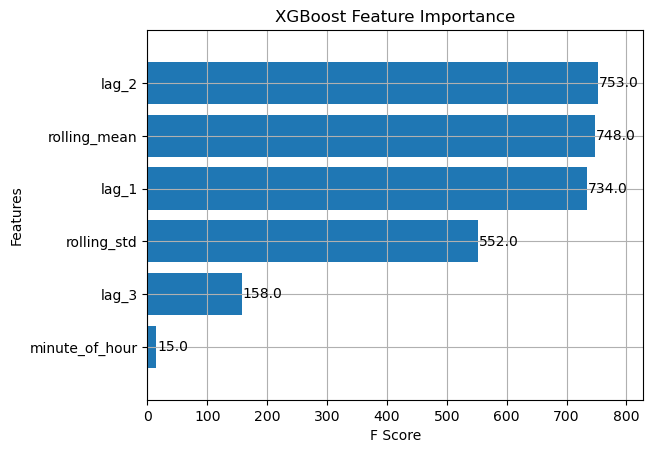

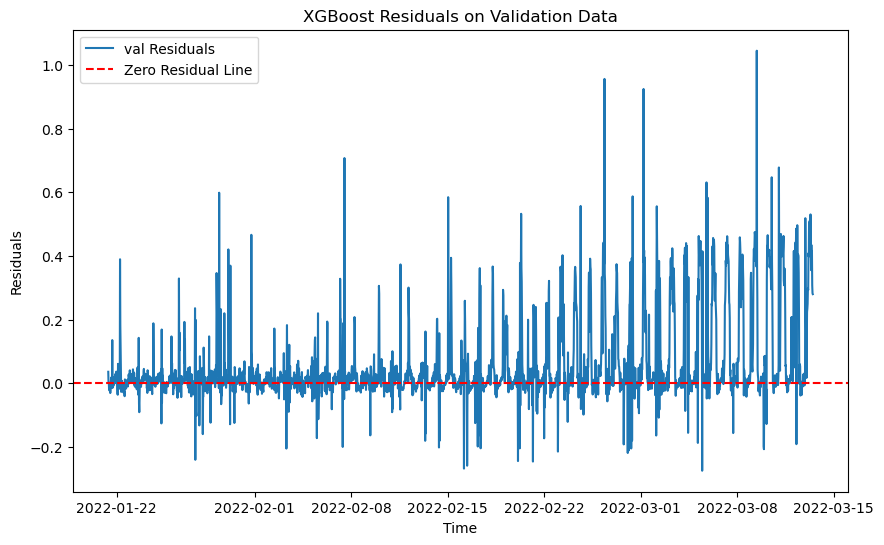

RMSE on training data for XGBoost: 0.025549707574047453
RMSE on validation data for XGBoost: 0.14422085447103586
RMSE on test data for XGBoost: 0.6986009631232335


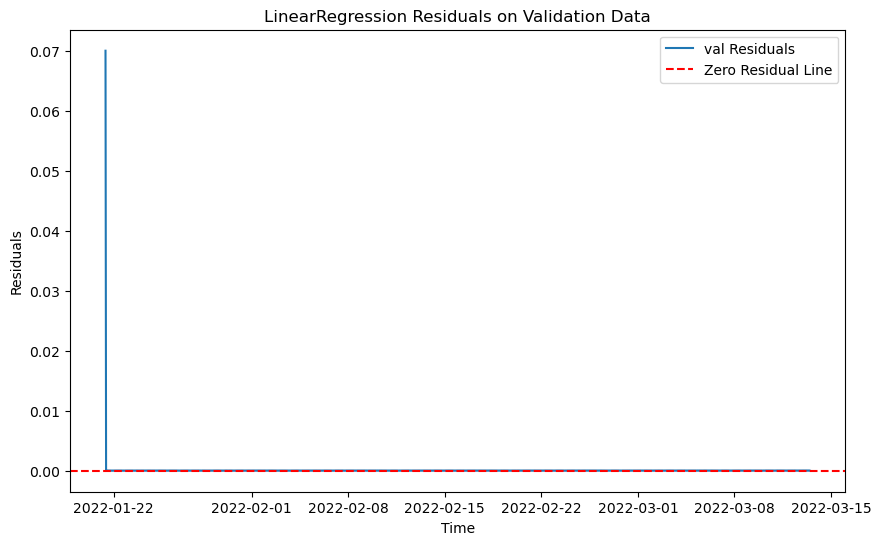

RMSE on training data for LinearRegression: 0.0007332077645726594
RMSE on validation data for LinearRegression: 0.001578709874829722
RMSE on test data for LinearRegression: 0.0004734747375969686

Best model is LinearRegression with RMSE: 0.001578709874829722
Best model saved as: models\model_401.pkl
data num 62
train_42.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.6970784766258444e-23
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.597537829324433e-18
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

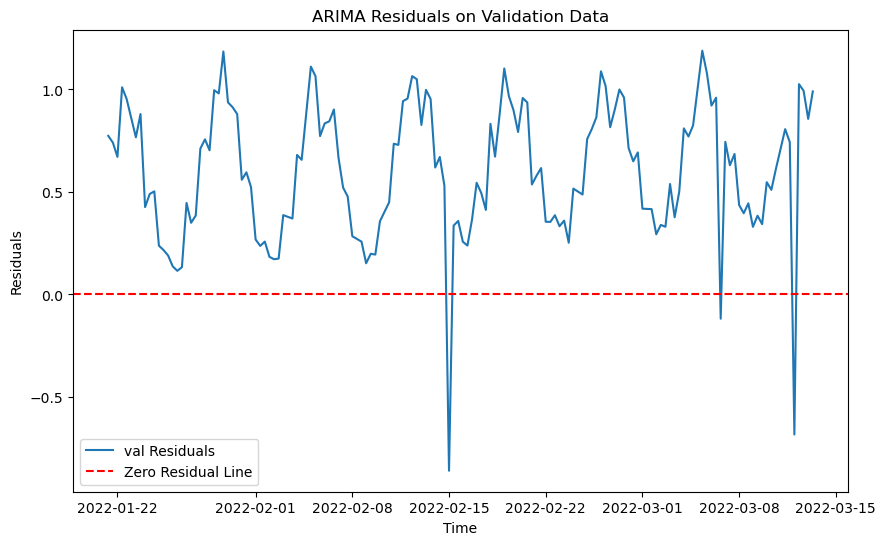

21:50:16 - cmdstanpy - INFO - Chain [1] start processing
21:50:16 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.35745927325594073
RMSE on validation data for ARIMA: 0.684923590205275
RMSE on test data for ARIMA: 0.3227282615687546


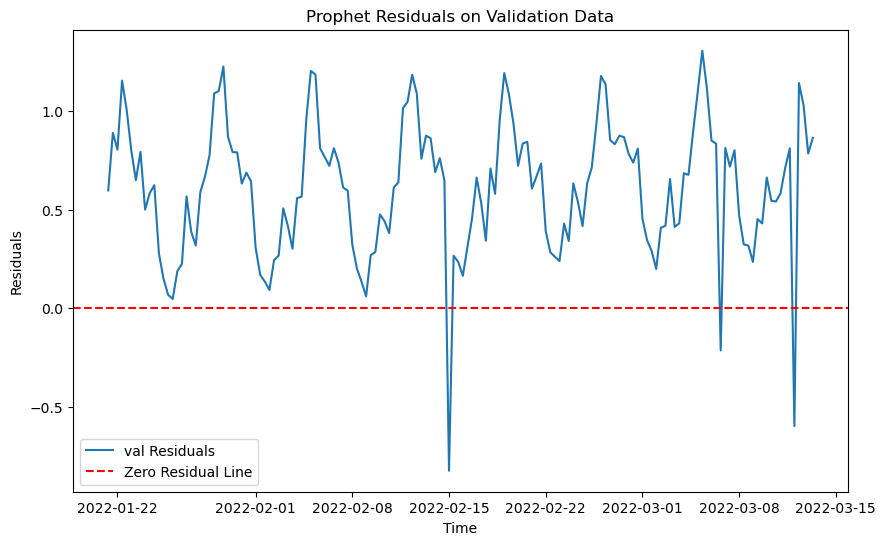

RMSE on training data for Prophet: 0.38528286072224077
RMSE on validation data for Prophet: 0.6946628050311775
RMSE on test data for Prophet: 0.3300513388405933


<Figure size 1000x800 with 0 Axes>

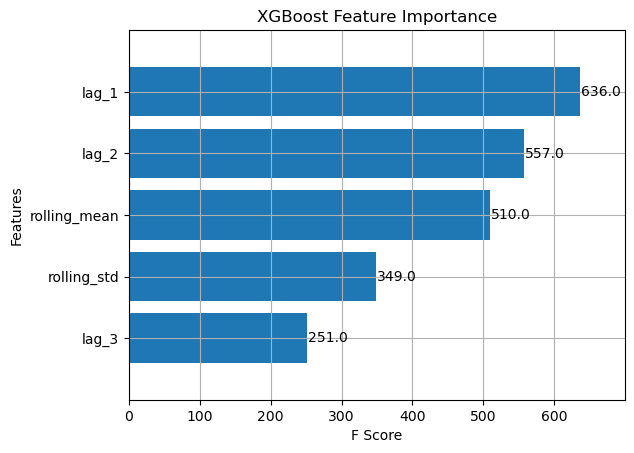

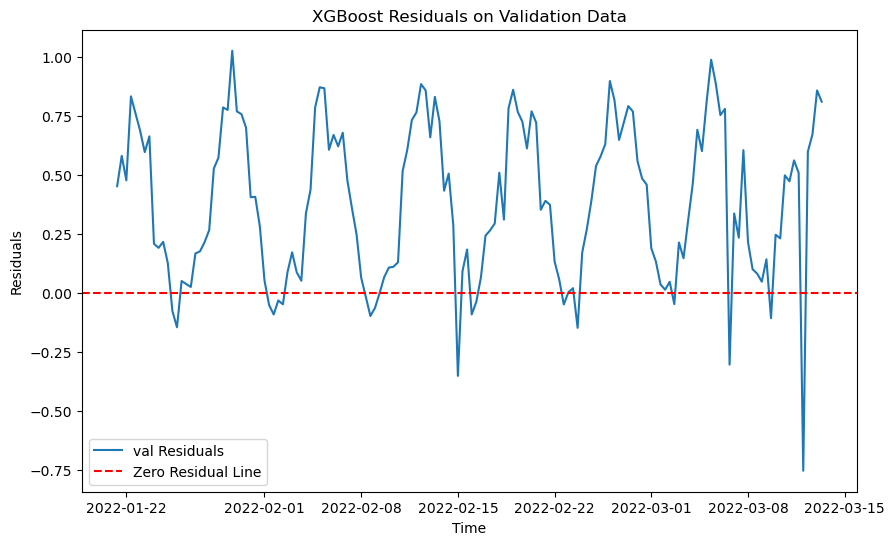

RMSE on training data for XGBoost: 0.019586822466201064
RMSE on validation data for XGBoost: 0.5046421233737519
RMSE on test data for XGBoost: 0.09530587303835693


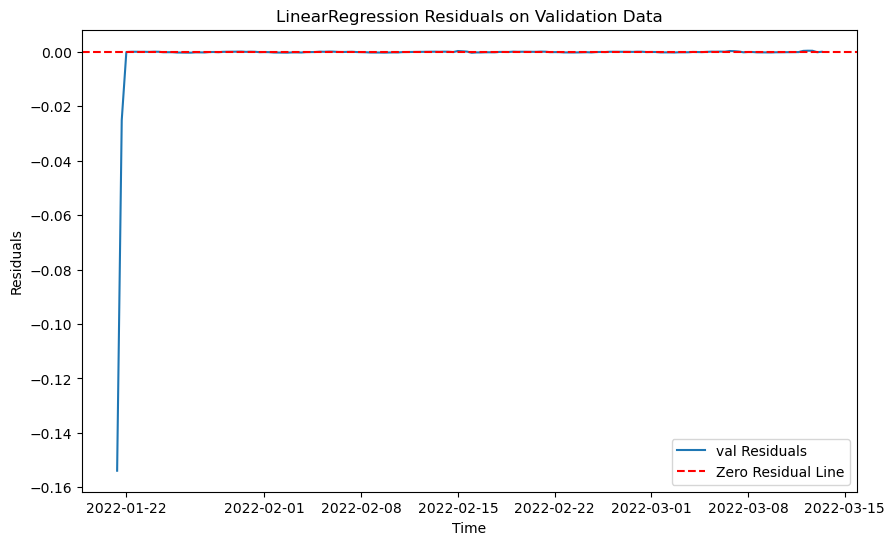

RMSE on training data for LinearRegression: 0.003987535723085825
RMSE on validation data for LinearRegression: 0.012566894880673933
RMSE on test data for LinearRegression: 0.01936434782014099

Best model is LinearRegression with RMSE: 0.012566894880673933
Best model saved as: models\model_42.pkl
data num 63
train_421.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.385360485748246e-15
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.9980848317653892
The time series is not stationary. Applying differencing 1
New p-value after differencing: 0.6152514349966127
The time series is not stationary. Applying differencing 2
New p-value after differencing: 0.14572000347379377
The time series is not stationary. Applying differencing 3
New p-value after differencing: 6.089666245969036e-10
The differenced time series is stationary.
The time series is not stationary.

C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

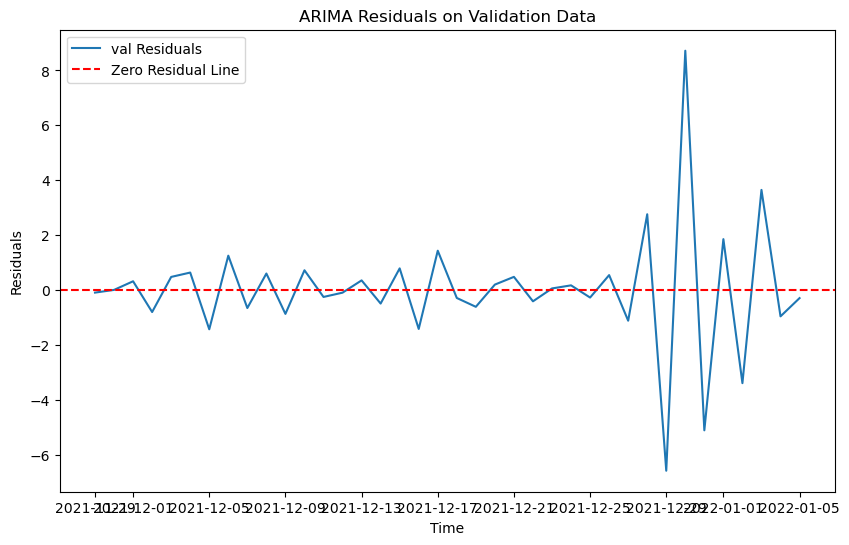

21:50:18 - cmdstanpy - INFO - Chain [1] start processing
21:50:18 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.26935240984262687
RMSE on validation data for ARIMA: 2.2772571325963464
RMSE on test data for ARIMA: 0.19539420570483085


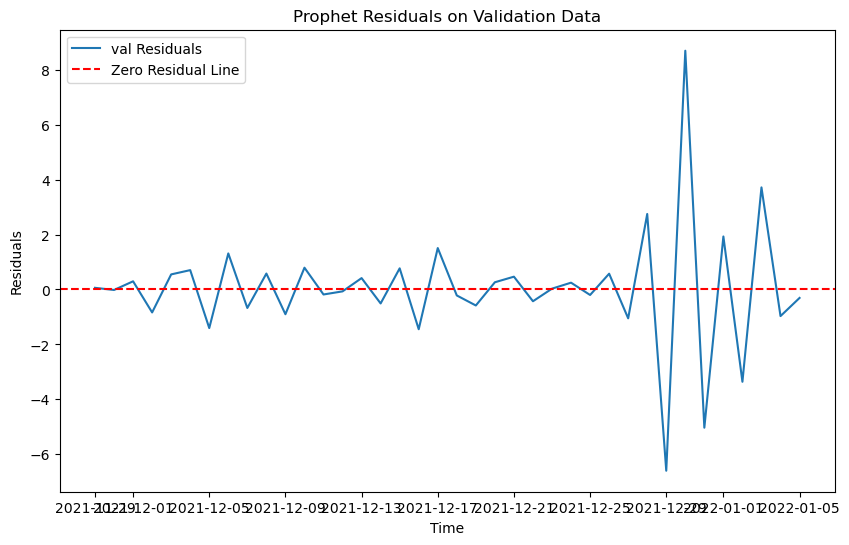

RMSE on training data for Prophet: 0.3492143791614073
RMSE on validation data for Prophet: 2.2777417979122556
RMSE on test data for Prophet: 0.1977401860293246


<Figure size 1000x800 with 0 Axes>

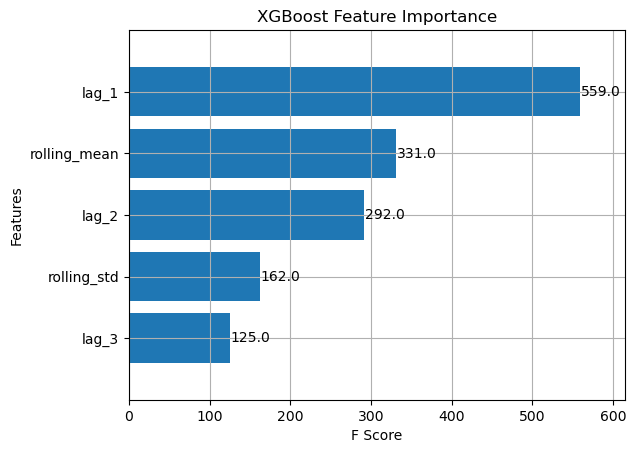

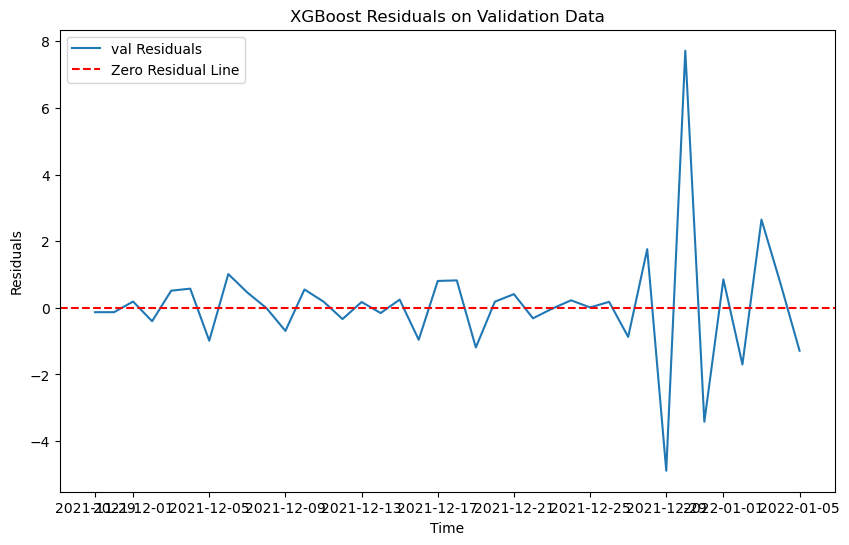

RMSE on training data for XGBoost: 0.00638854424656144
RMSE on validation data for XGBoost: 1.7769977761715923
RMSE on test data for XGBoost: 0.18784608900187516


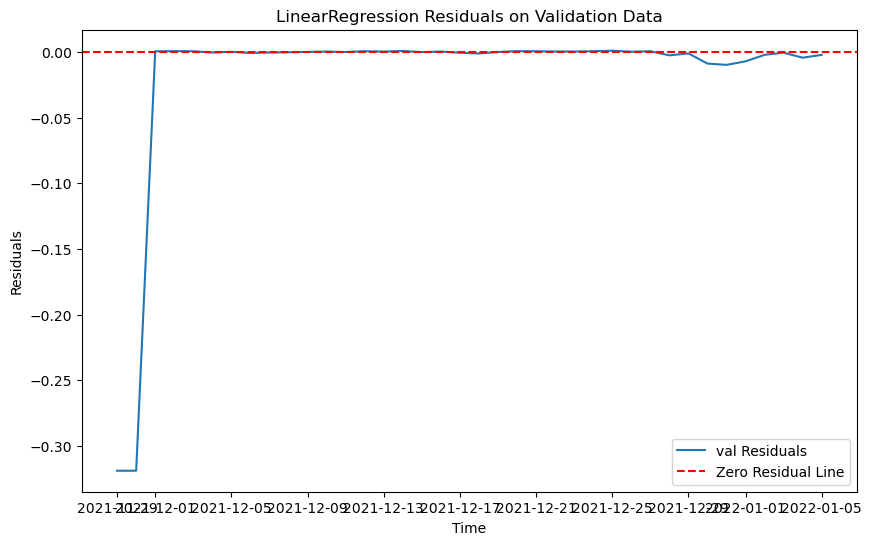

RMSE on training data for LinearRegression: 0.005884205099234387
RMSE on validation data for LinearRegression: 0.07319551598192281
RMSE on test data for LinearRegression: 0.0892445178729993

Best model is LinearRegression with RMSE: 0.07319551598192281
Best model saved as: models\model_421.pkl
data num 64
train_428.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


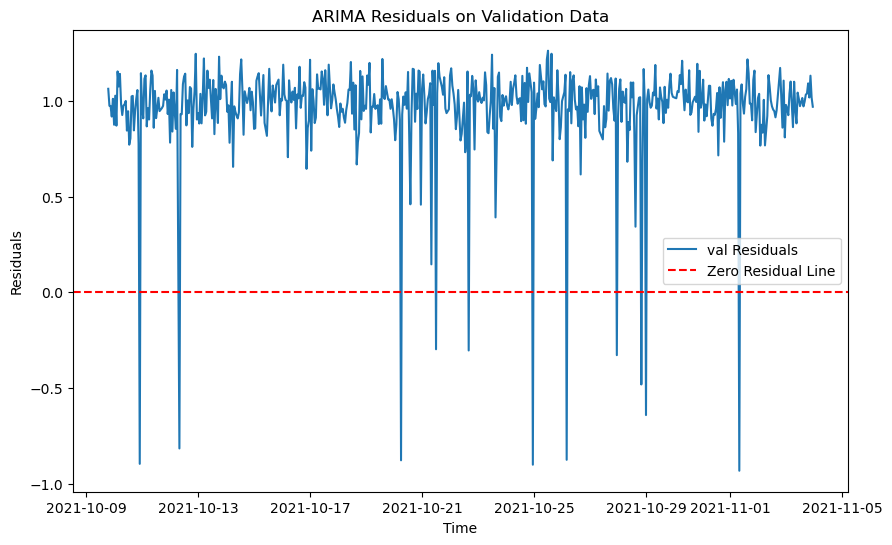

RMSE on training data for ARIMA: 0.27852783478046567
RMSE on validation data for ARIMA: 0.9962731814539416
RMSE on test data for ARIMA: 0.9839975097749547


21:50:22 - cmdstanpy - INFO - Chain [1] start processing
21:50:22 - cmdstanpy - INFO - Chain [1] done processing


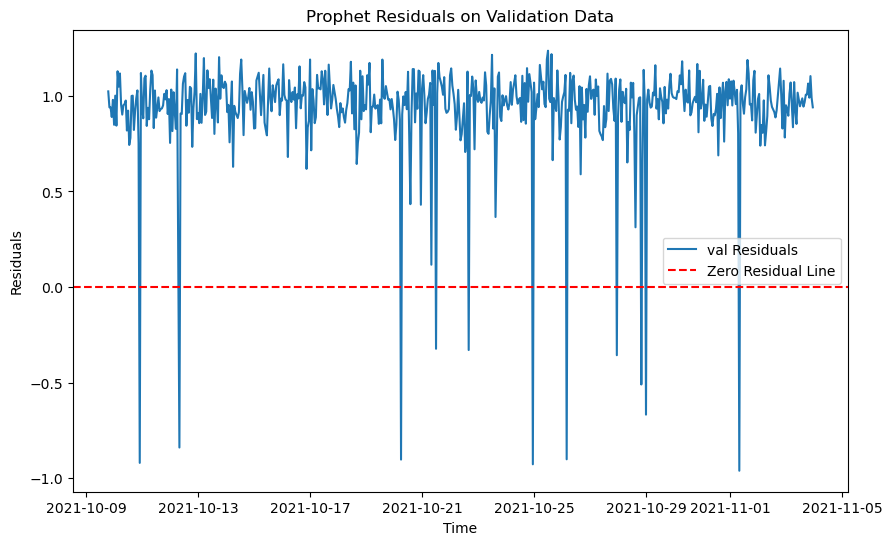

RMSE on training data for Prophet: 0.2678545729145303
RMSE on validation data for Prophet: 0.9712681889756789
RMSE on test data for Prophet: 0.9572569040471195


<Figure size 1000x800 with 0 Axes>

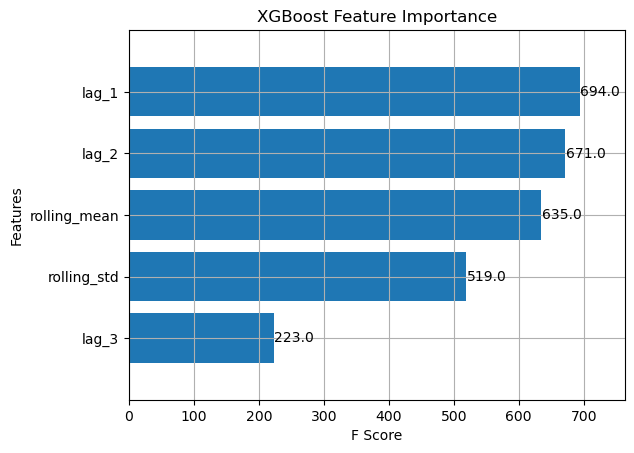

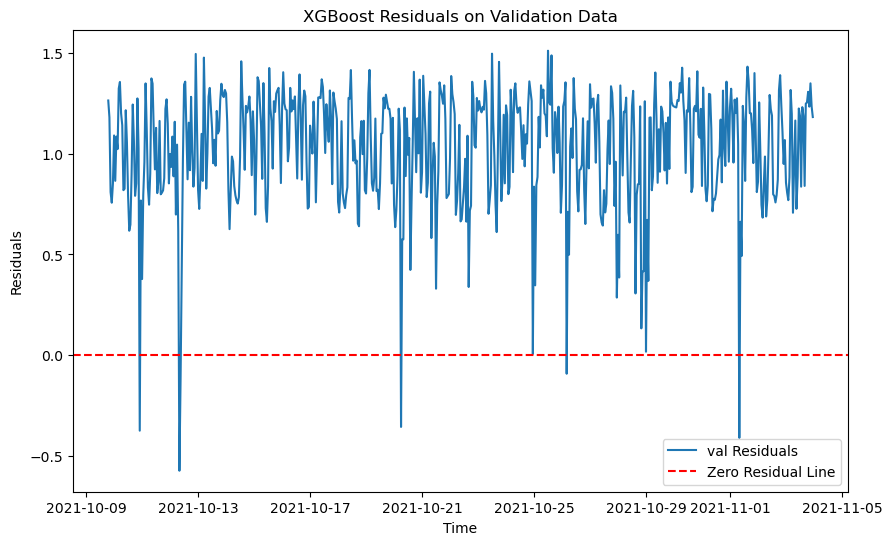

RMSE on training data for XGBoost: 0.02263086077506703
RMSE on validation data for XGBoost: 1.0668467593471154
RMSE on test data for XGBoost: 1.0381037033217906


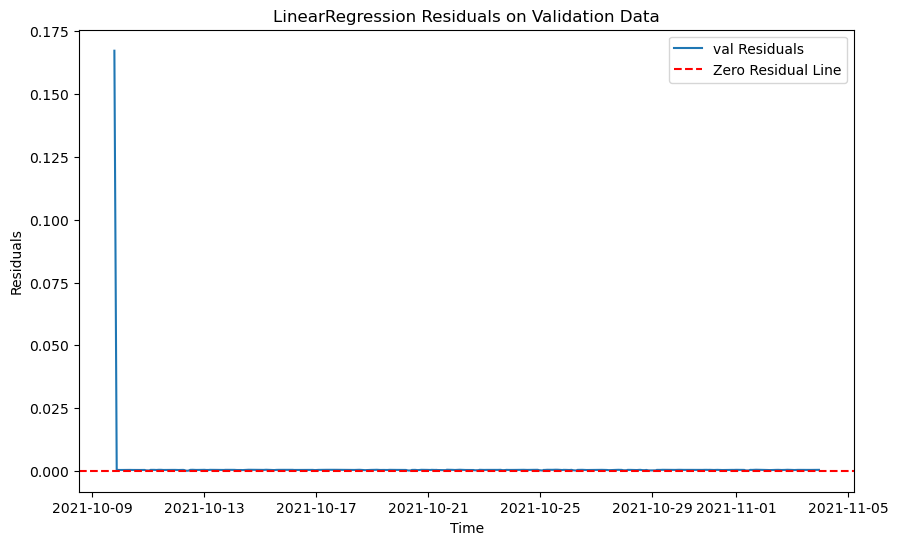

RMSE on training data for LinearRegression: 0.001198842346538214
RMSE on validation data for LinearRegression: 0.007606063983862935
RMSE on test data for LinearRegression: 0.0011447988776278892

Best model is LinearRegression with RMSE: 0.007606063983862935
Best model saved as: models\model_428.pkl
data num 65
train_429.csv
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.289948546364881e-15
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

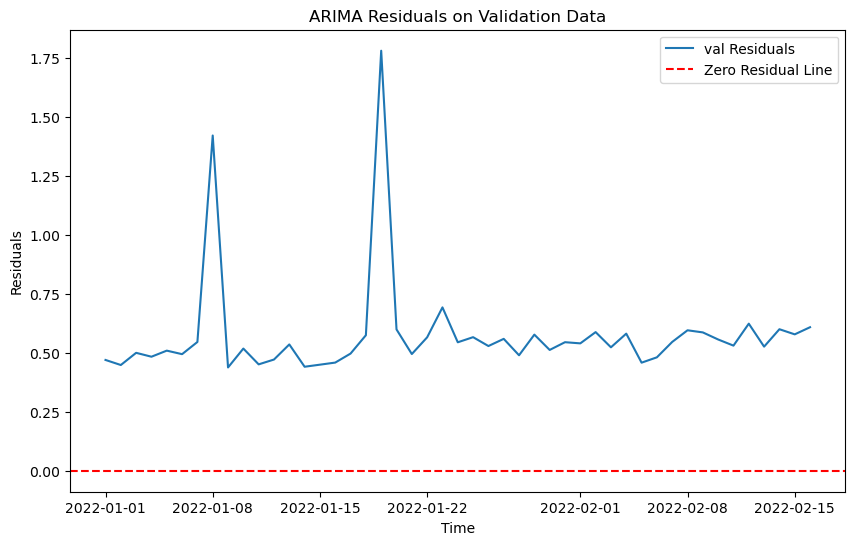

21:50:25 - cmdstanpy - INFO - Chain [1] start processing
21:50:25 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2694015436814393
RMSE on validation data for ARIMA: 0.6188683445410215
RMSE on test data for ARIMA: 0.9556905099636324


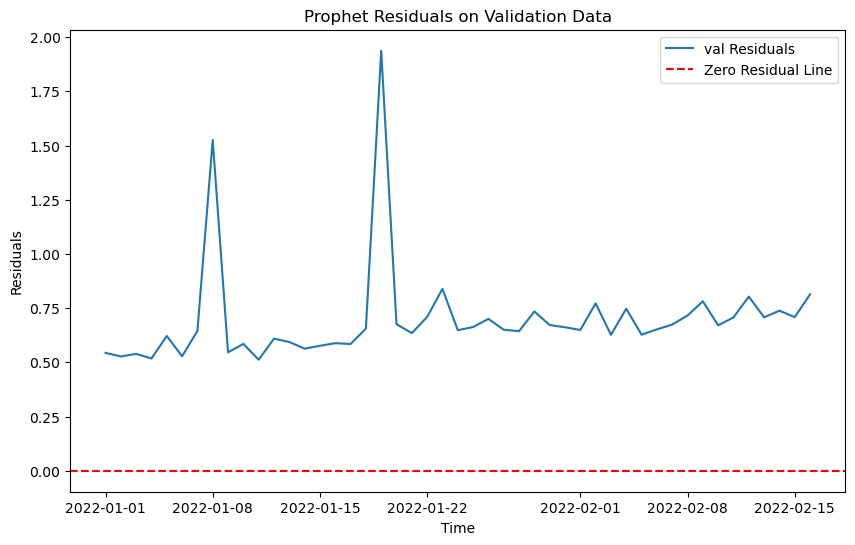

RMSE on training data for Prophet: 0.26571004129056236
RMSE on validation data for Prophet: 0.7371442594732198
RMSE on test data for Prophet: 1.1126373771513516


<Figure size 1000x800 with 0 Axes>

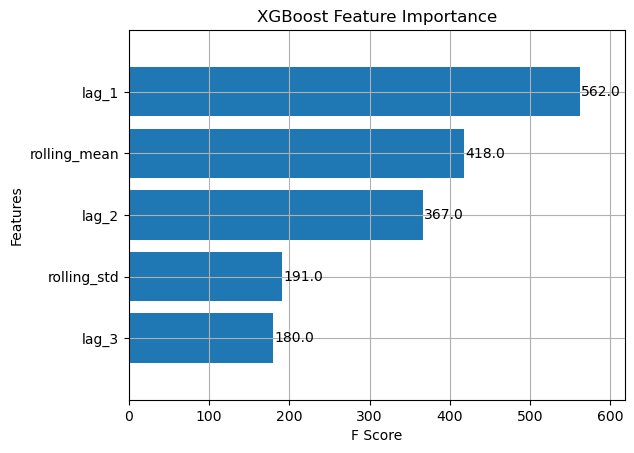

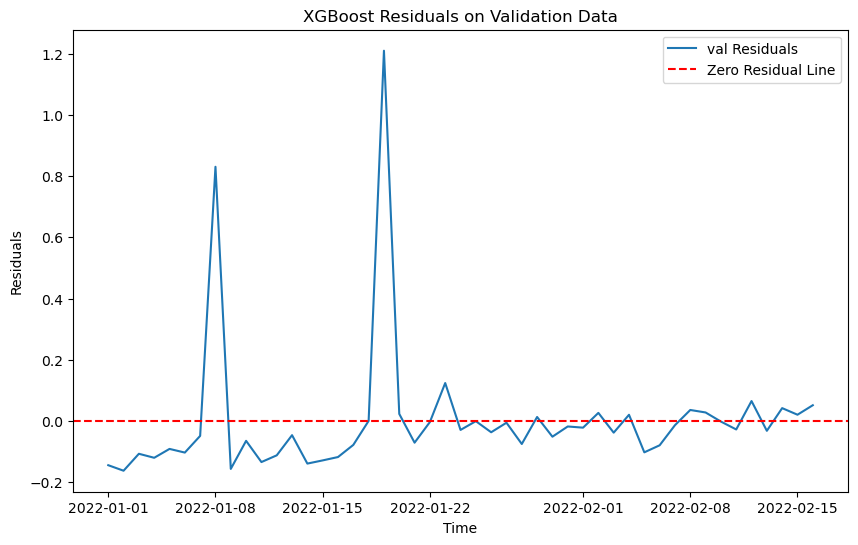

RMSE on training data for XGBoost: 0.10258593584763781
RMSE on validation data for XGBoost: 0.22734210226449303
RMSE on test data for XGBoost: 0.4795961245285994


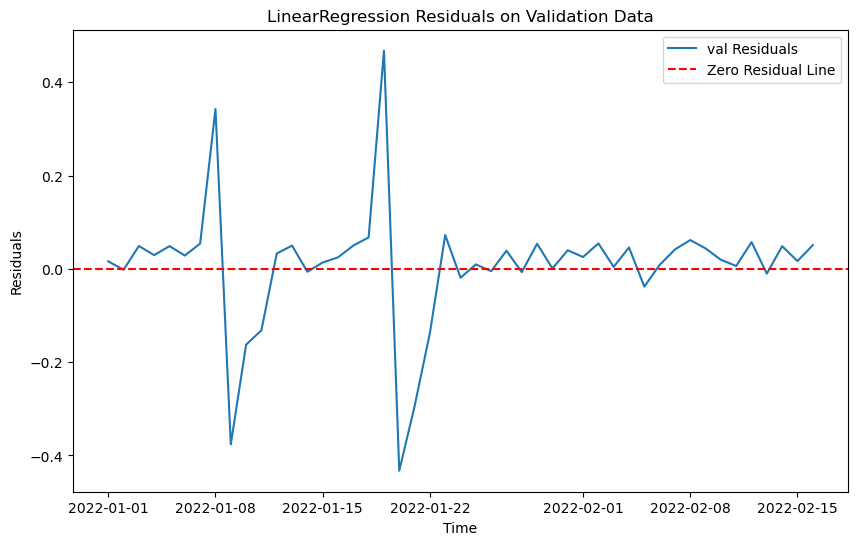

RMSE on training data for LinearRegression: 0.1934827770854561
RMSE on validation data for LinearRegression: 0.13613522687298996
RMSE on test data for LinearRegression: 0.20161575665240744

Best model is LinearRegression with RMSE: 0.13613522687298996
Best model saved as: models\model_429.pkl
data num 66
train_43.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.049466964258401e-13
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

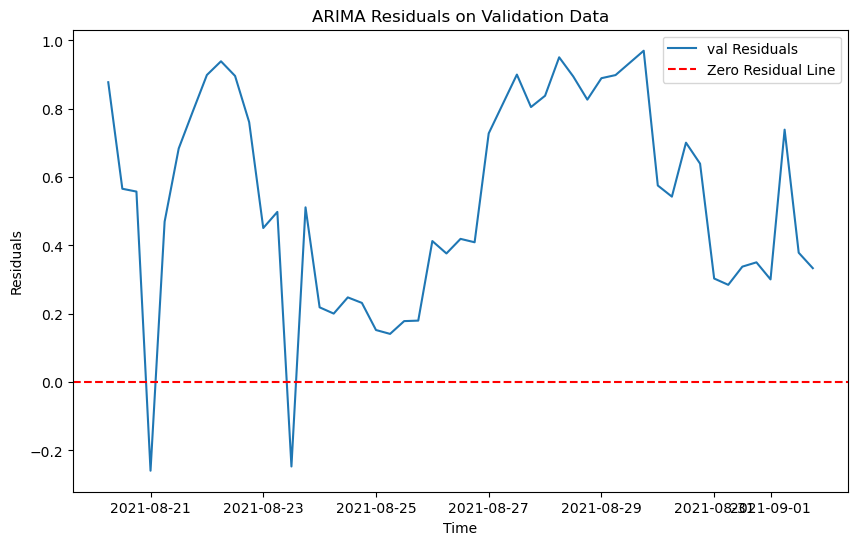

21:50:27 - cmdstanpy - INFO - Chain [1] start processing
21:50:27 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2663907317062414
RMSE on validation data for ARIMA: 0.619613128432013
RMSE on test data for ARIMA: 0.8199127200502007


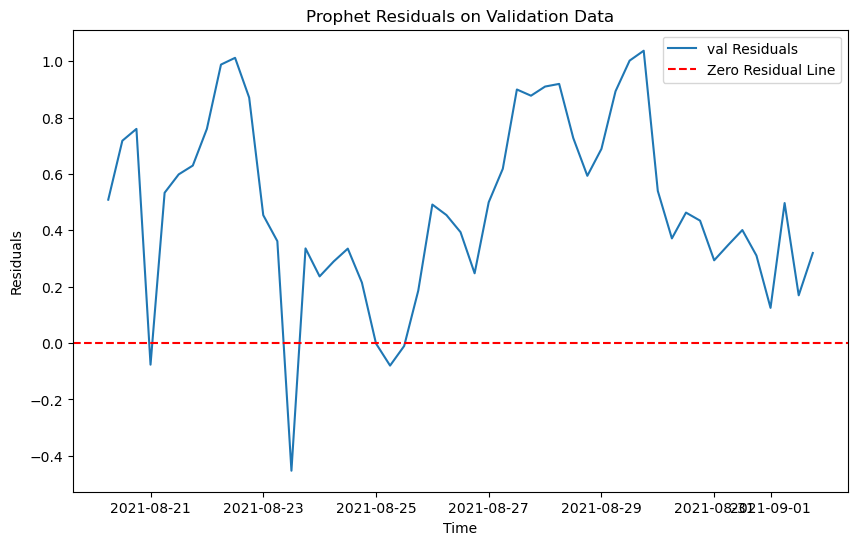

RMSE on training data for Prophet: 0.26705200998606377
RMSE on validation data for Prophet: 0.5808266577256352
RMSE on test data for Prophet: 0.7577857774435103


<Figure size 1000x800 with 0 Axes>

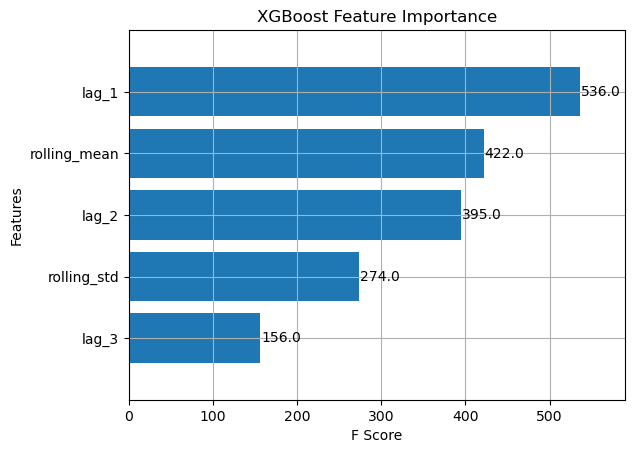

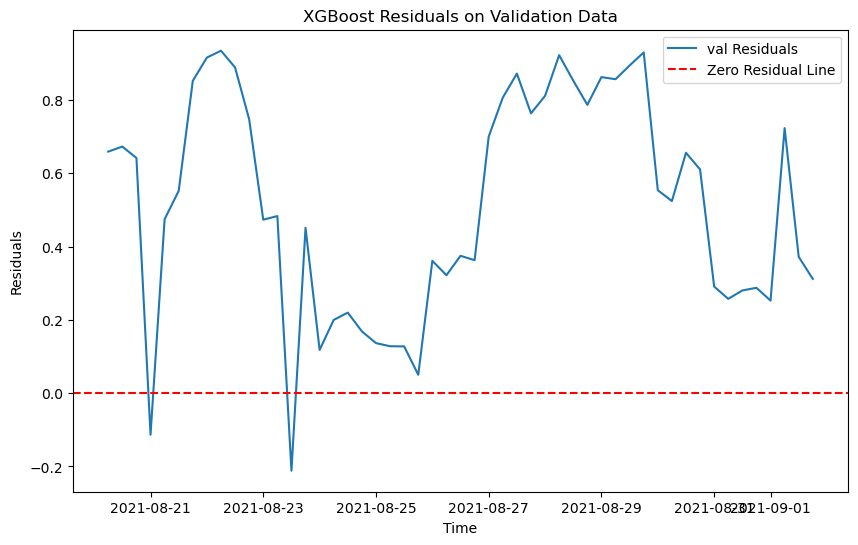

RMSE on training data for XGBoost: 0.019640542790828486
RMSE on validation data for XGBoost: 0.5943116929208754
RMSE on test data for XGBoost: 0.7767801785590033


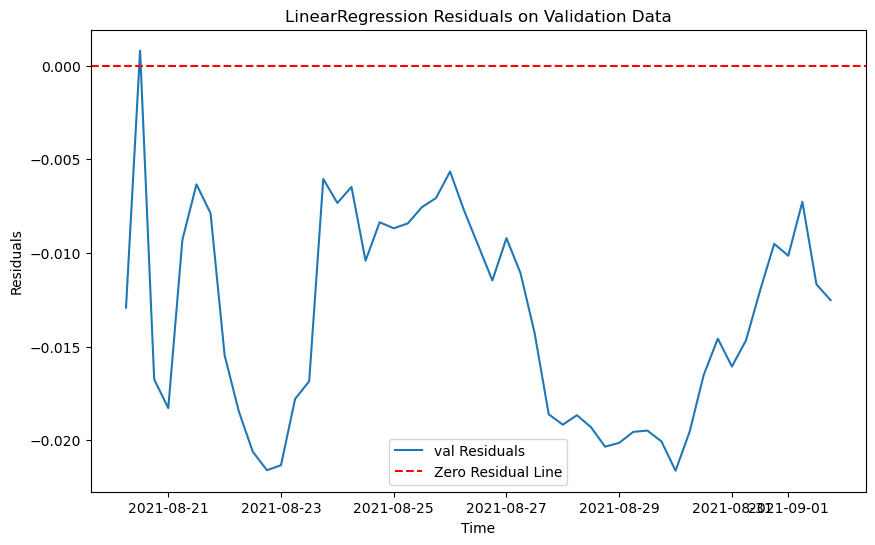

RMSE on training data for LinearRegression: 0.031095126519990933
RMSE on validation data for LinearRegression: 0.014487729652620124
RMSE on test data for LinearRegression: 0.017928027653014884

Best model is LinearRegression with RMSE: 0.014487729652620124
Best model saved as: models\model_43.pkl
data num 67
train_430.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.343815814753625e-05
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

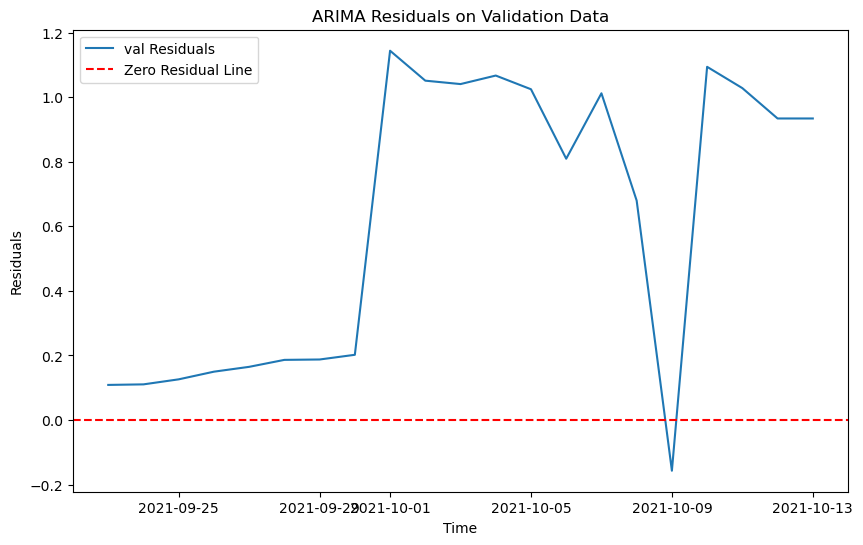

21:50:29 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.18318700741347171
RMSE on validation data for ARIMA: 0.7575828632271291
RMSE on test data for ARIMA: 0.9843390561415799


21:50:29 - cmdstanpy - INFO - Chain [1] done processing


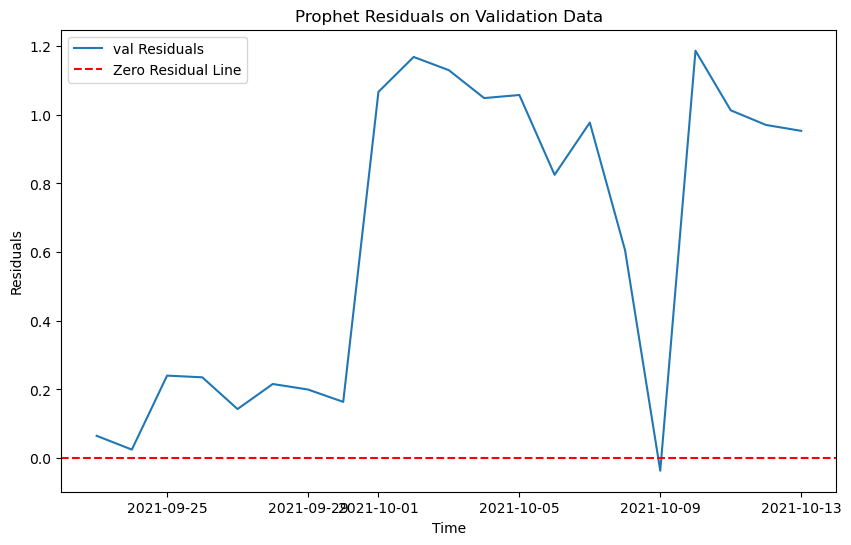

RMSE on training data for Prophet: 0.20746763142984573
RMSE on validation data for Prophet: 0.7725853581228318
RMSE on test data for Prophet: 1.0106888606136304


<Figure size 1000x800 with 0 Axes>

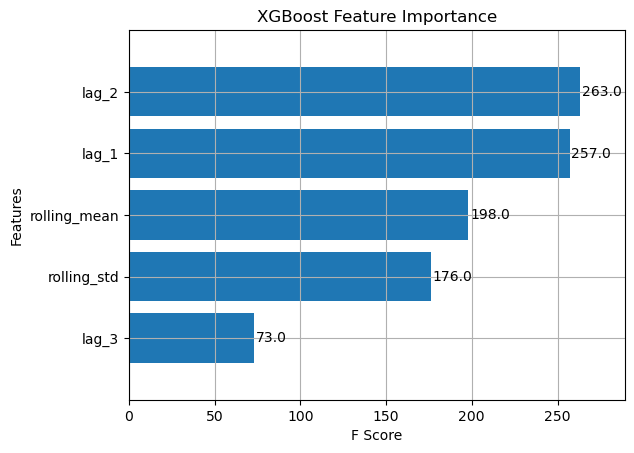

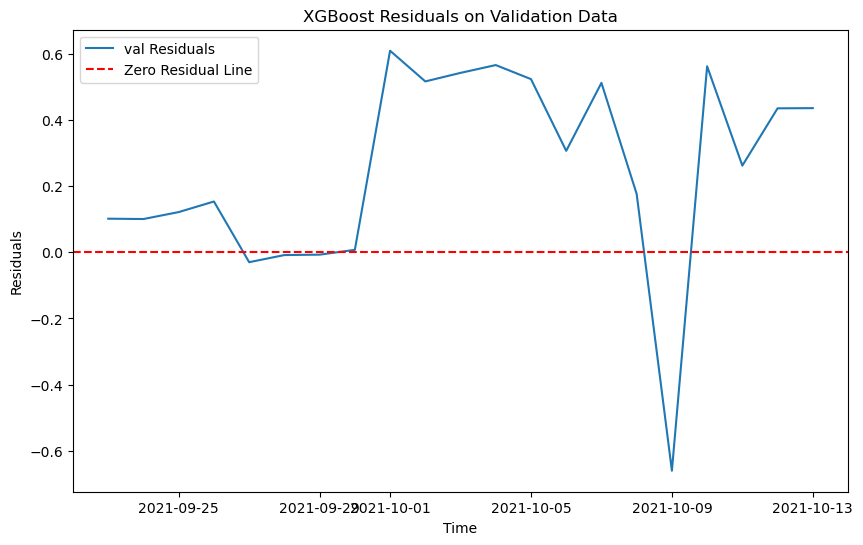

RMSE on training data for XGBoost: 0.03266039085028955
RMSE on validation data for XGBoost: 0.3886946894503029
RMSE on test data for XGBoost: 0.5382774992118486


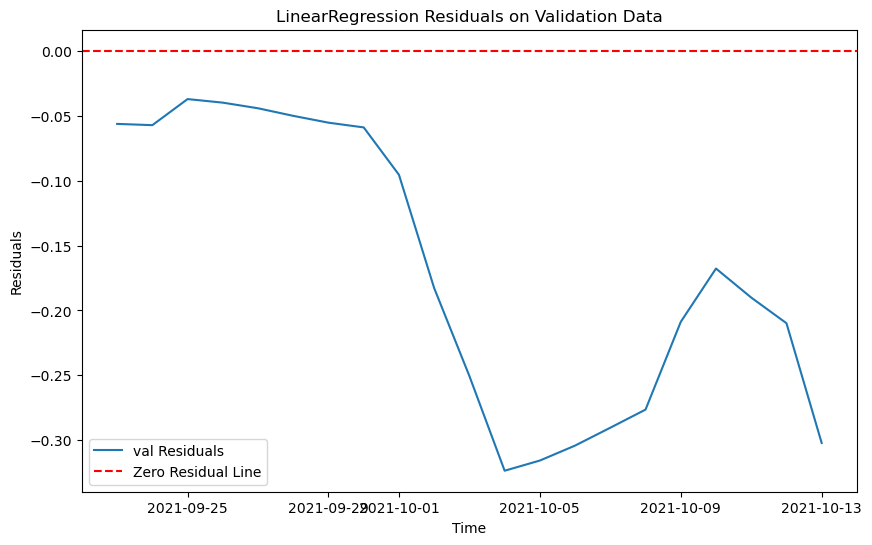

RMSE on training data for LinearRegression: 0.04866037246717091
RMSE on validation data for LinearRegression: 0.19834869046832773
RMSE on test data for LinearRegression: 0.6439784478668438

Best model is LinearRegression with RMSE: 0.19834869046832773
Best model saved as: models\model_430.pkl
data num 68
train_435.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


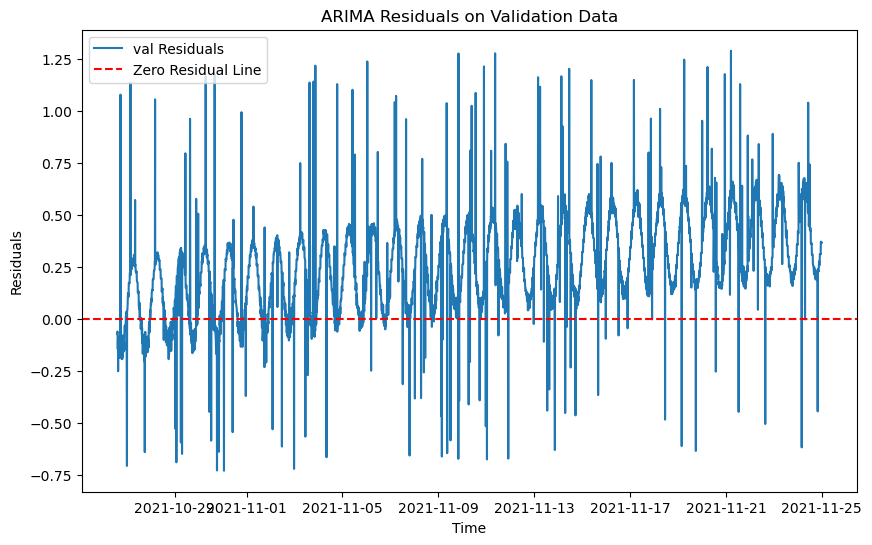

RMSE on training data for ARIMA: 0.1782198873183729
RMSE on validation data for ARIMA: 0.34326795277037064
RMSE on test data for ARIMA: 0.798211532861818


21:50:38 - cmdstanpy - INFO - Chain [1] start processing
21:50:42 - cmdstanpy - INFO - Chain [1] done processing


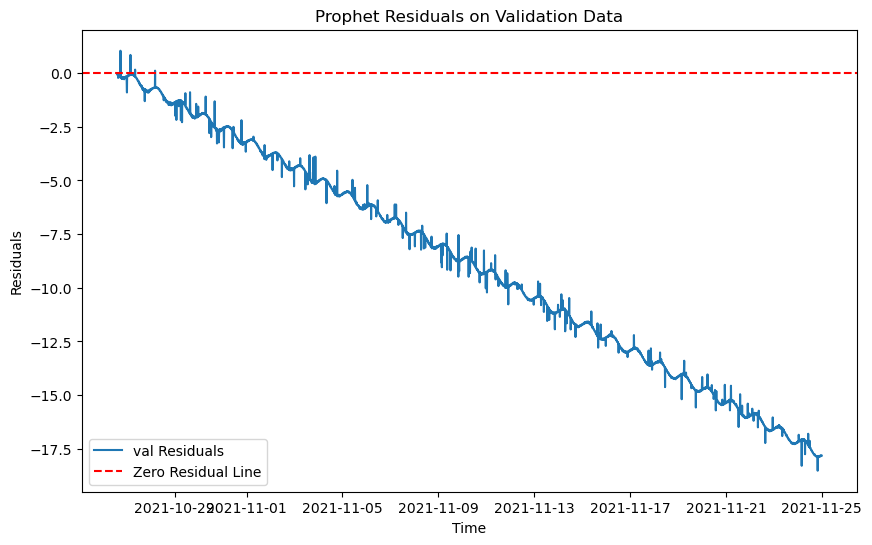

RMSE on training data for Prophet: 0.1686370125022118
RMSE on validation data for Prophet: 10.228469664402827
RMSE on test data for Prophet: 21.728002823681276


<Figure size 1000x800 with 0 Axes>

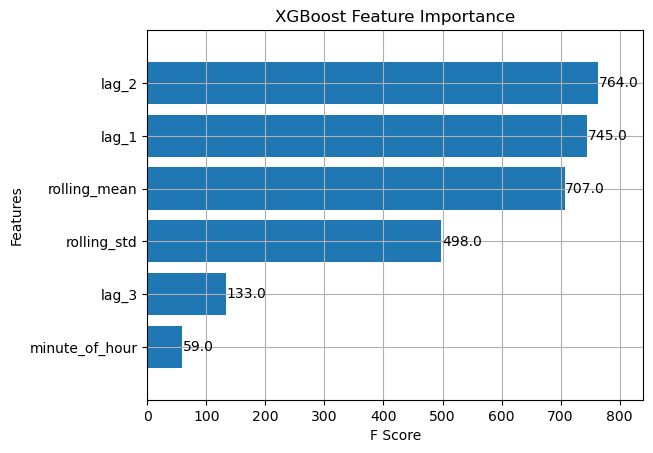

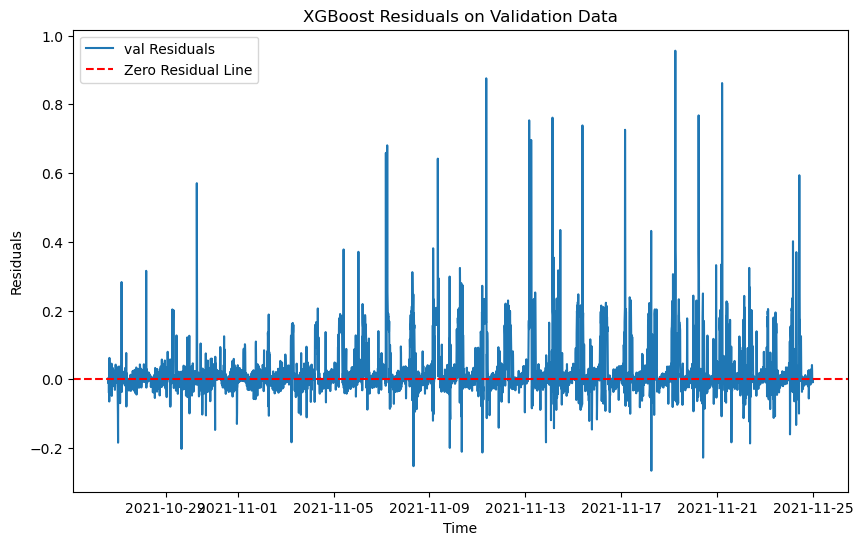

RMSE on training data for XGBoost: 0.026795977204893004
RMSE on validation data for XGBoost: 0.0852951989484793
RMSE on test data for XGBoost: 0.22876682509309185


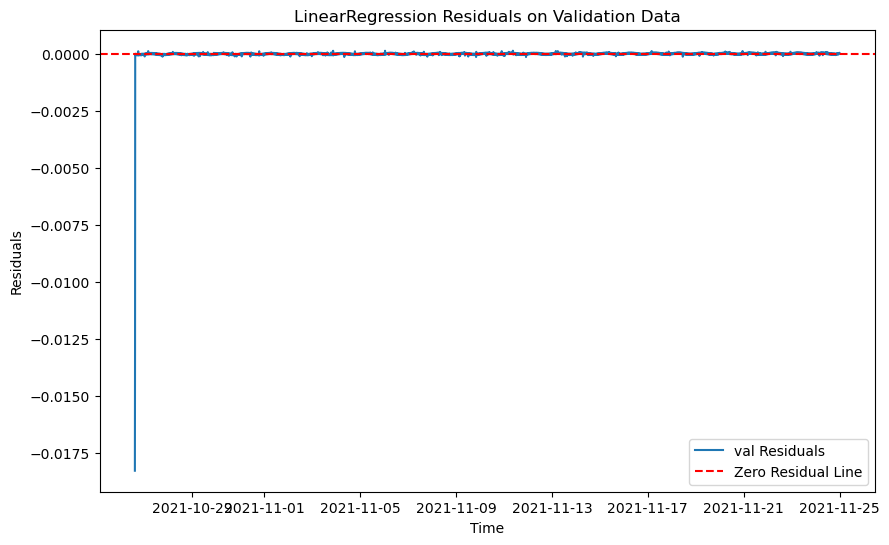

RMSE on training data for LinearRegression: 0.001668762424909949
RMSE on validation data for LinearRegression: 0.00034680508038852466
RMSE on test data for LinearRegression: 0.008763470026974127

Best model is LinearRegression with RMSE: 0.00034680508038852466
Best model saved as: models\model_435.pkl
data num 69
train_437.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


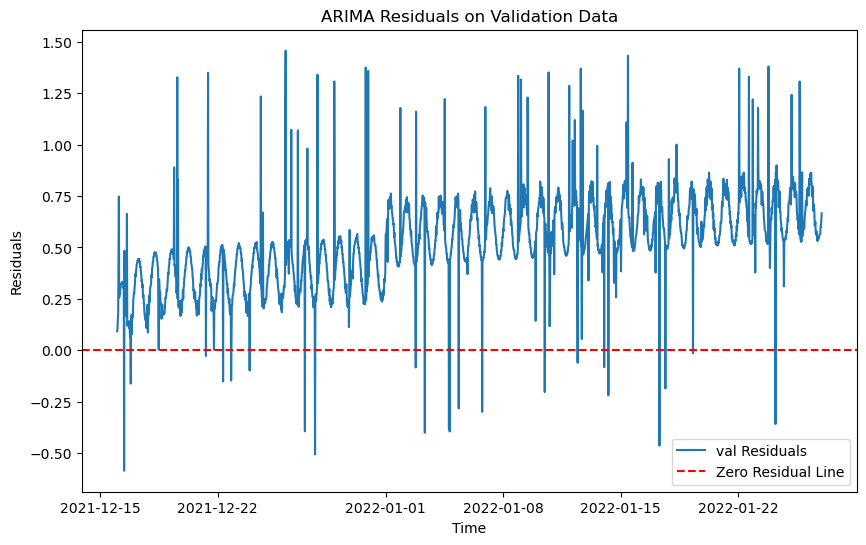

RMSE on training data for ARIMA: 0.203496588169329
RMSE on validation data for ARIMA: 0.5685525452702275
RMSE on test data for ARIMA: 0.9836370197775587


21:50:56 - cmdstanpy - INFO - Chain [1] start processing
21:50:57 - cmdstanpy - INFO - Chain [1] done processing


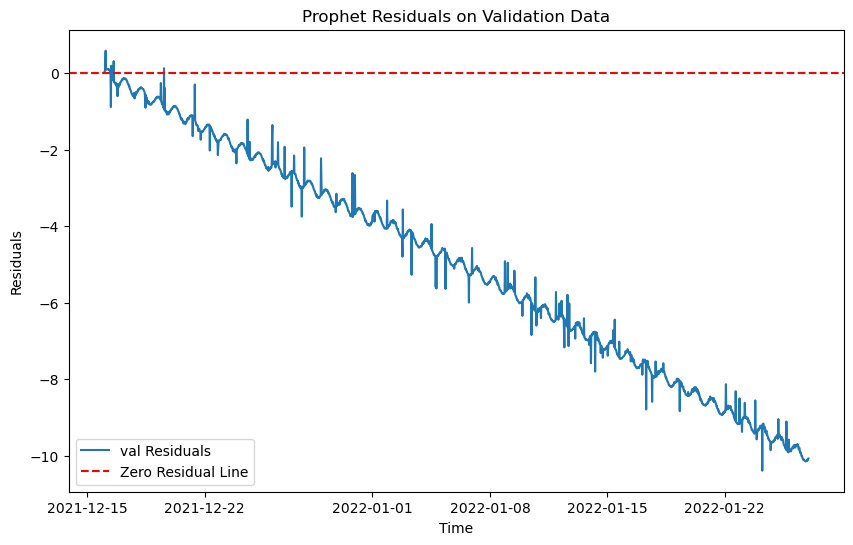

RMSE on training data for Prophet: 0.18811248243109382
RMSE on validation data for Prophet: 5.768564456162747
RMSE on test data for Prophet: 12.263263896796845


<Figure size 1000x800 with 0 Axes>

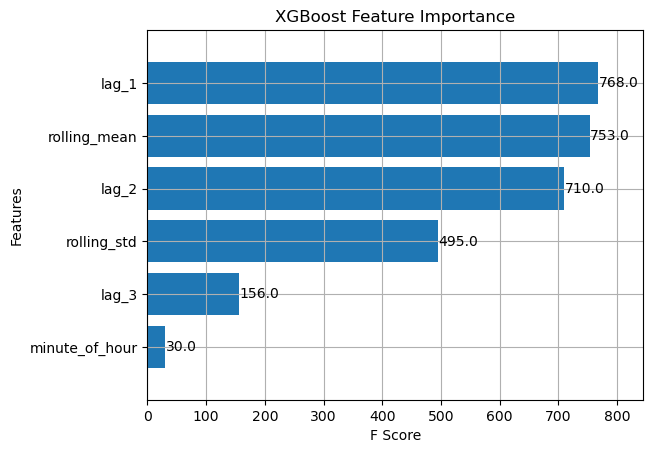

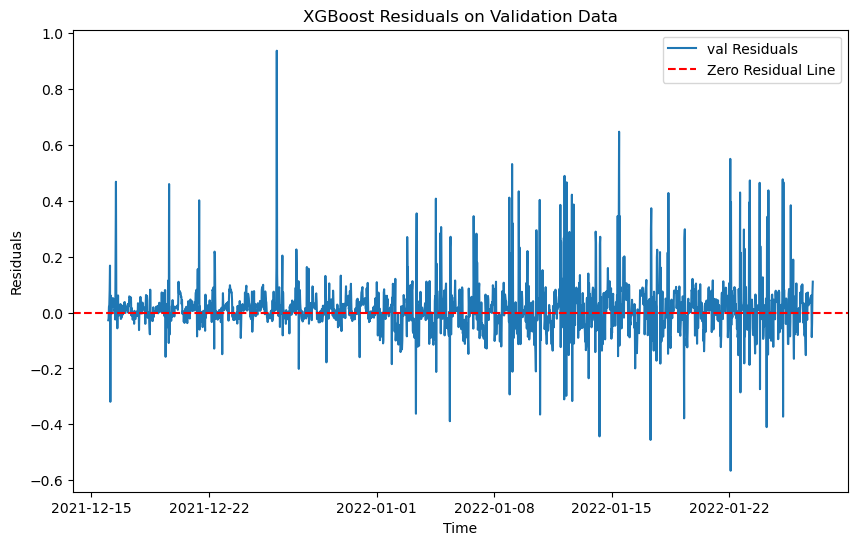

RMSE on training data for XGBoost: 0.025310492942015938
RMSE on validation data for XGBoost: 0.09480241774525797
RMSE on test data for XGBoost: 0.4941508074276807


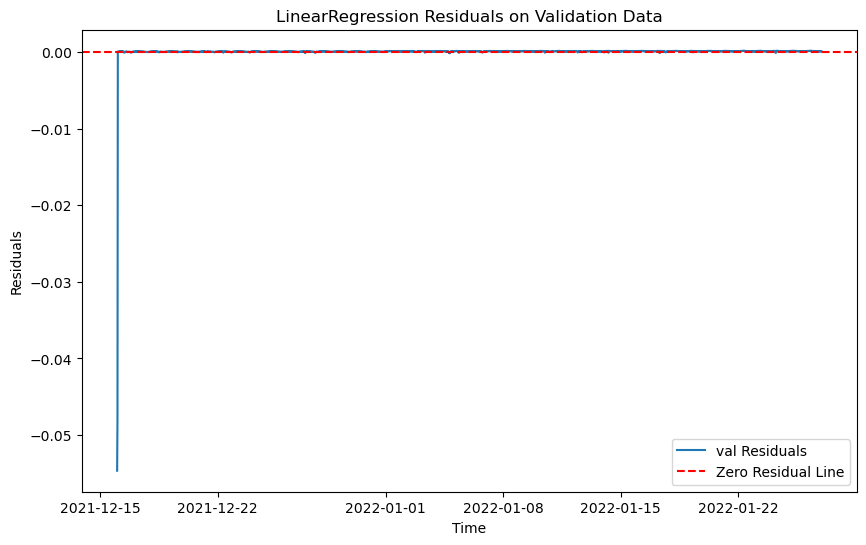

RMSE on training data for LinearRegression: 0.0022136276474408884
RMSE on validation data for LinearRegression: 0.0016240213626505977
RMSE on test data for LinearRegression: 0.0012870209878725843

Best model is LinearRegression with RMSE: 0.0016240213626505977
Best model saved as: models\model_437.pkl
data num 70
train_439.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.3681792595912466e-09
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

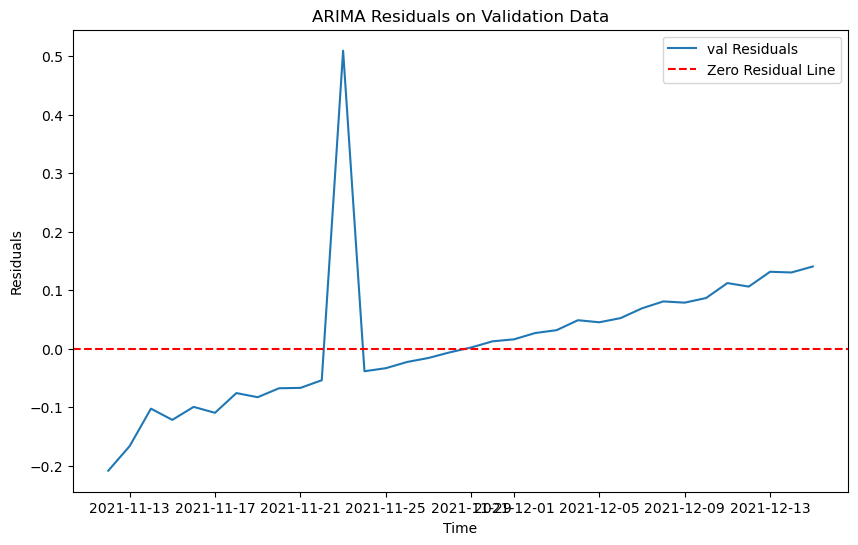

21:51:03 - cmdstanpy - INFO - Chain [1] start processing
21:51:03 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.17782516633930456
RMSE on validation data for ARIMA: 0.12338839994049111
RMSE on test data for ARIMA: 0.6742547023721135


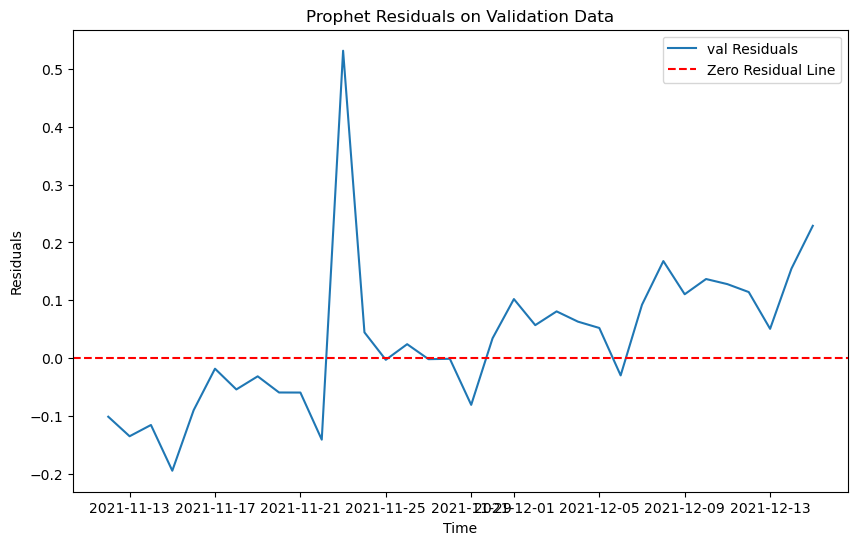

RMSE on training data for Prophet: 0.22875608173179662
RMSE on validation data for Prophet: 0.13456790747885983
RMSE on test data for Prophet: 0.6939346476057832


<Figure size 1000x800 with 0 Axes>

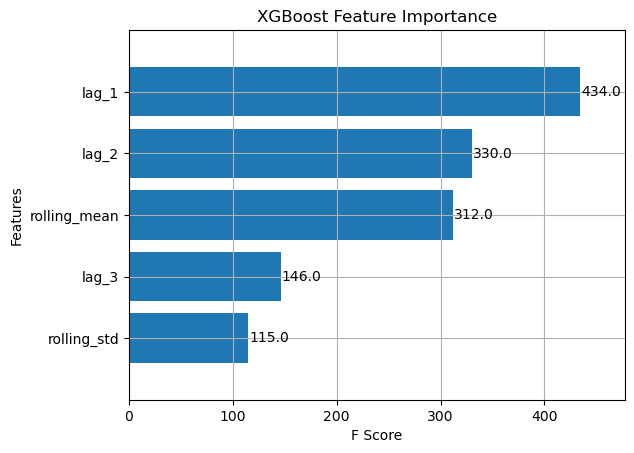

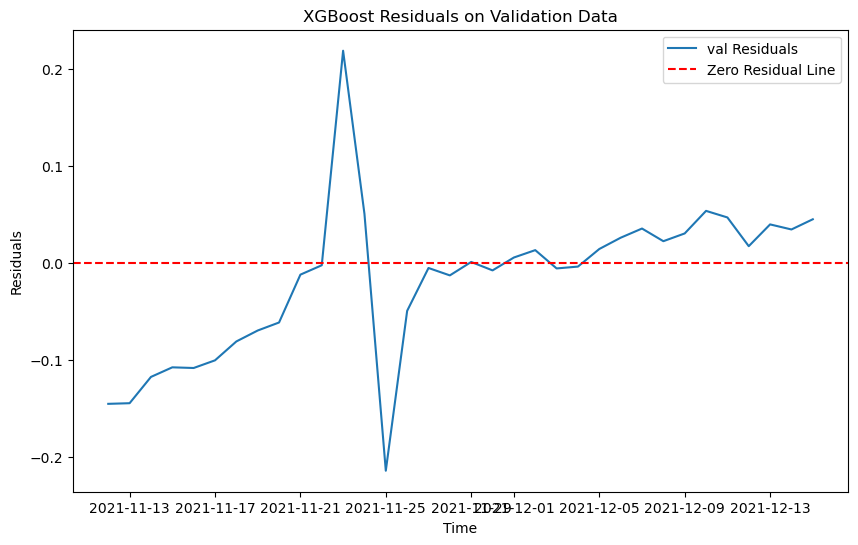

RMSE on training data for XGBoost: 0.008305675818661321
RMSE on validation data for XGBoost: 0.08012428758984208
RMSE on test data for XGBoost: 0.4090111177065526


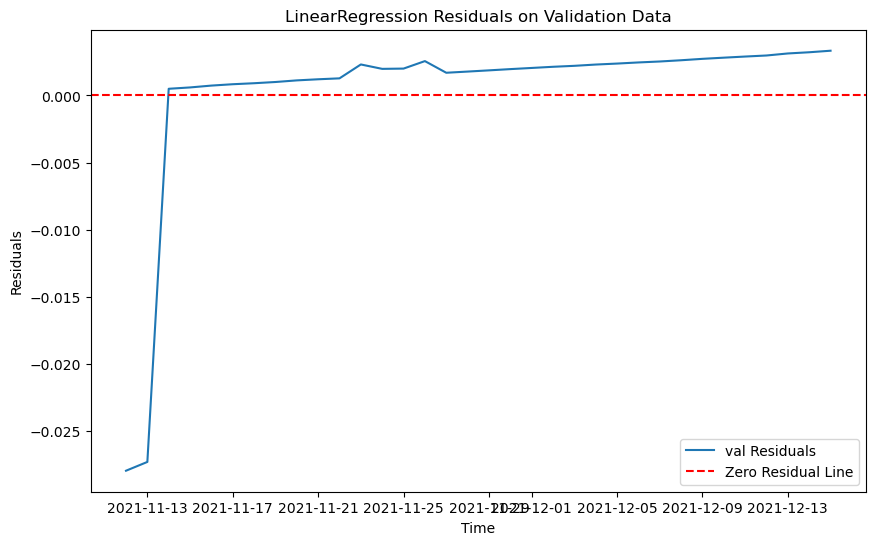

RMSE on training data for LinearRegression: 0.012540222400972655
RMSE on validation data for LinearRegression: 0.007021873720961488
RMSE on test data for LinearRegression: 0.057274128345134526

Best model is LinearRegression with RMSE: 0.007021873720961488
Best model saved as: models\model_439.pkl
data num 71
train_440.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


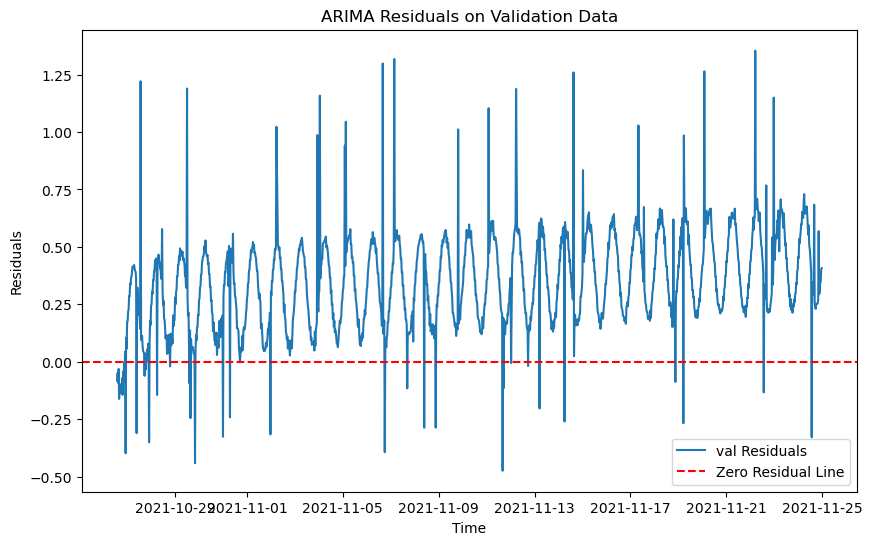

RMSE on training data for ARIMA: 0.1816533900066025
RMSE on validation data for ARIMA: 0.40823587024051894
RMSE on test data for ARIMA: 0.8335230753564462


21:51:09 - cmdstanpy - INFO - Chain [1] start processing
21:51:09 - cmdstanpy - INFO - Chain [1] done processing


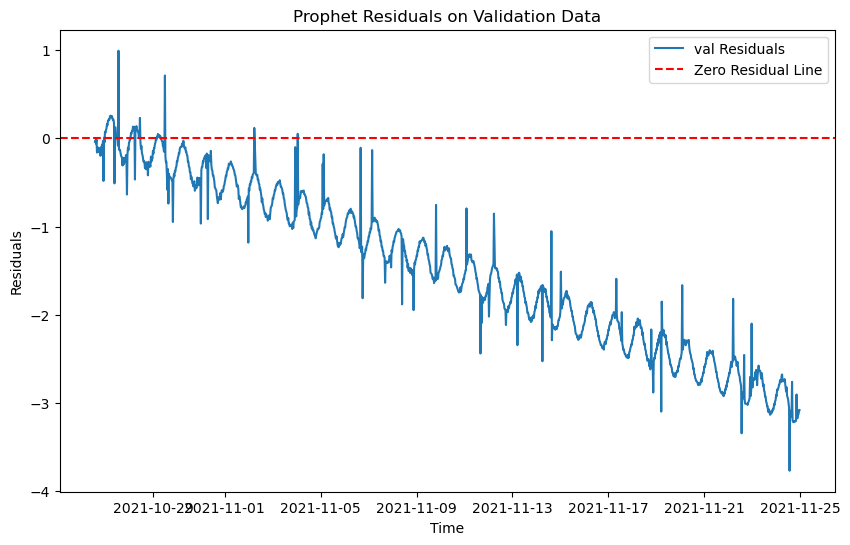

RMSE on training data for Prophet: 0.1642140134181048
RMSE on validation data for Prophet: 1.7272930395102324
RMSE on test data for Prophet: 3.4925392961136077


<Figure size 1000x800 with 0 Axes>

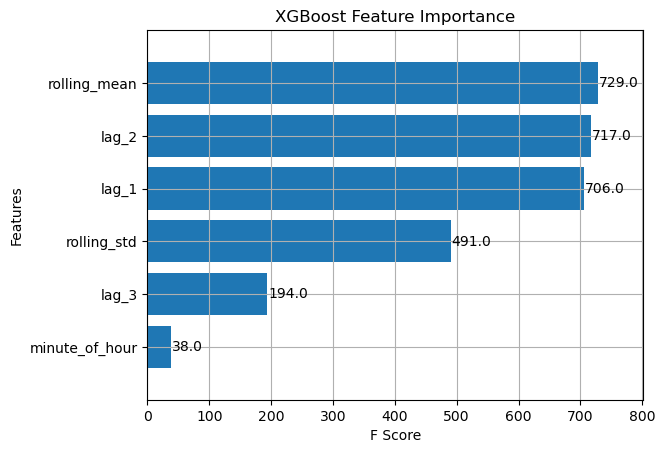

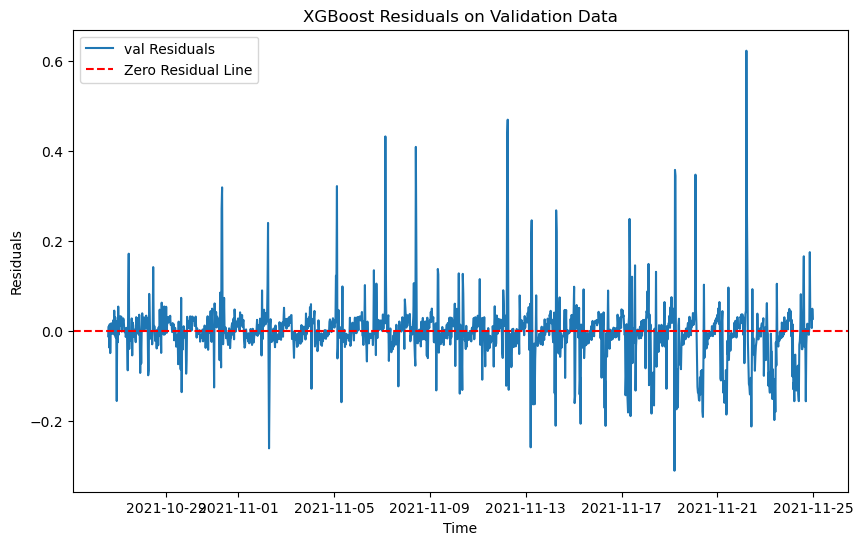

RMSE on training data for XGBoost: 0.02402274381249188
RMSE on validation data for XGBoost: 0.06509991473702623
RMSE on test data for XGBoost: 0.41751842561948926


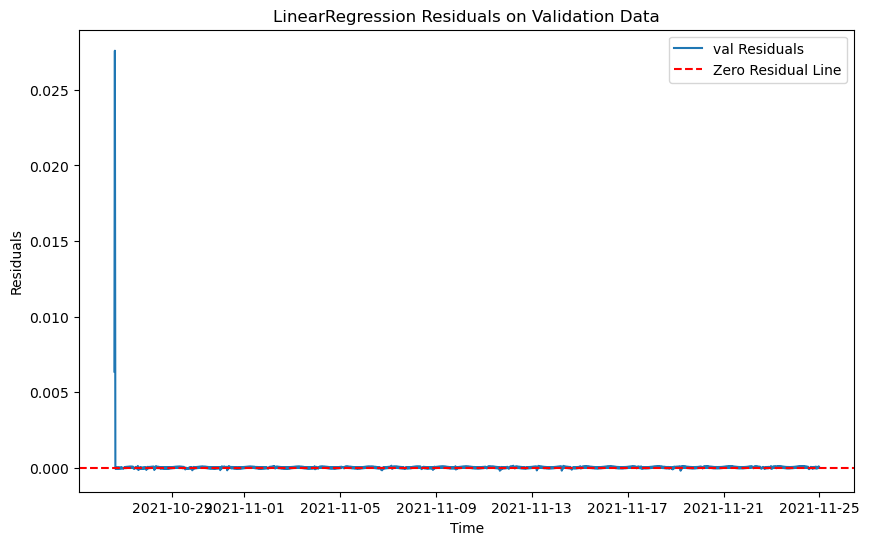

RMSE on training data for LinearRegression: 0.0027532160903027195
RMSE on validation data for LinearRegression: 0.0007559560824640433
RMSE on test data for LinearRegression: 0.0011862367106397866

Best model is LinearRegression with RMSE: 0.0007559560824640433
Best model saved as: models\model_440.pkl
data num 72
train_446.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0022653165878215014
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

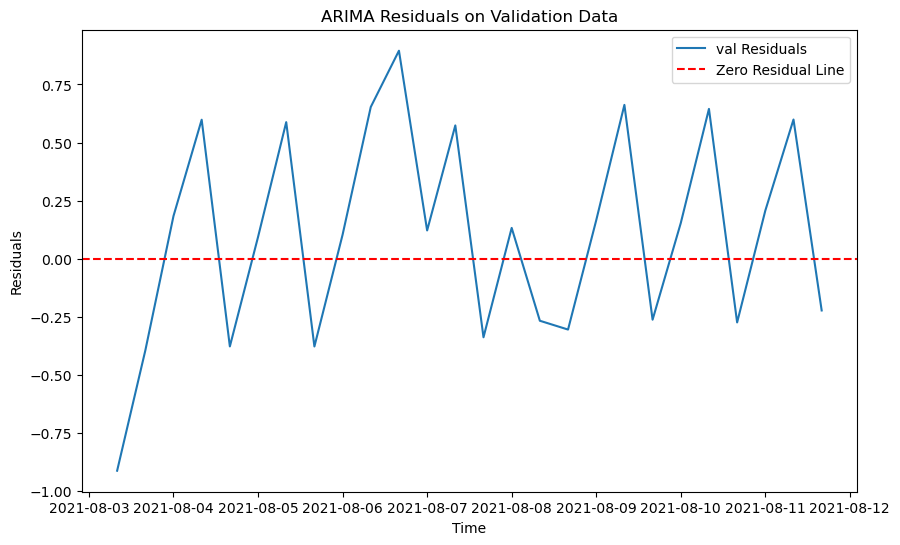

21:51:13 - cmdstanpy - INFO - Chain [1] start processing
21:51:13 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3840820113961307
RMSE on validation data for ARIMA: 0.4557582011252638
RMSE on test data for ARIMA: 0.568183165255661


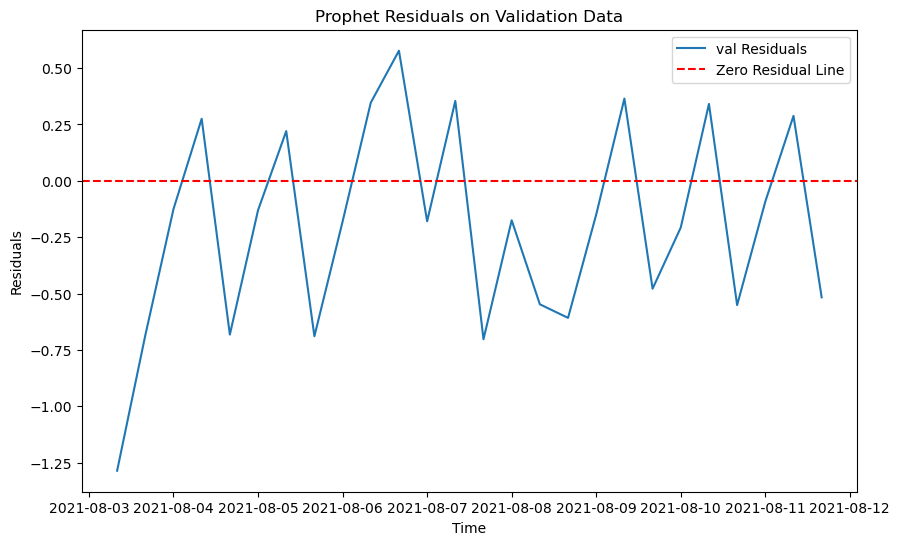

RMSE on training data for Prophet: 0.3009917066954397
RMSE on validation data for Prophet: 0.4906422770398952
RMSE on test data for Prophet: 0.4157644839930861


<Figure size 1000x800 with 0 Axes>

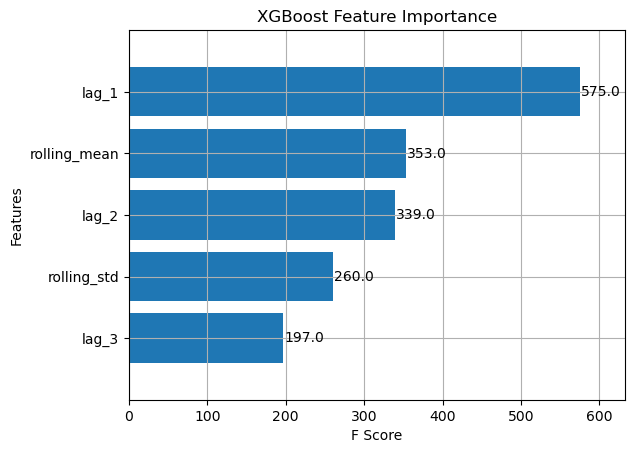

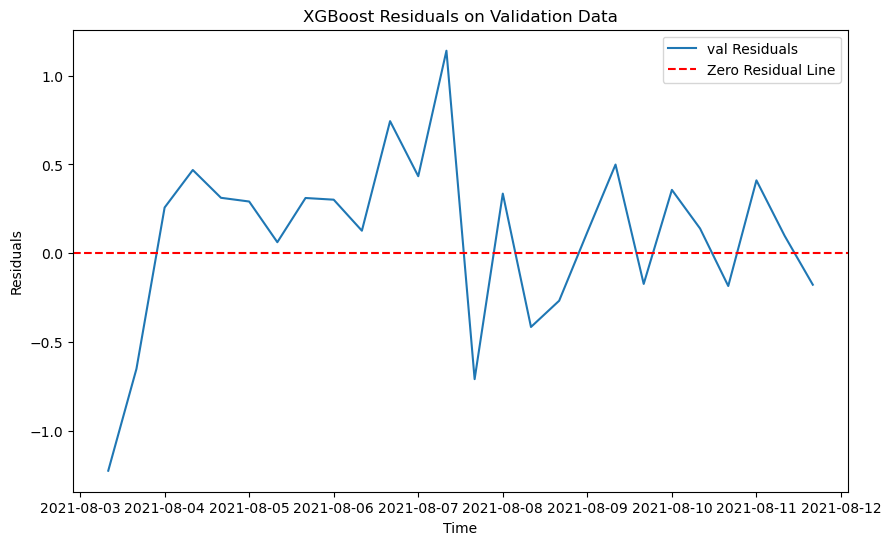

RMSE on training data for XGBoost: 0.11656785398568702
RMSE on validation data for XGBoost: 0.48774261747873243
RMSE on test data for XGBoost: 0.6602530690118324


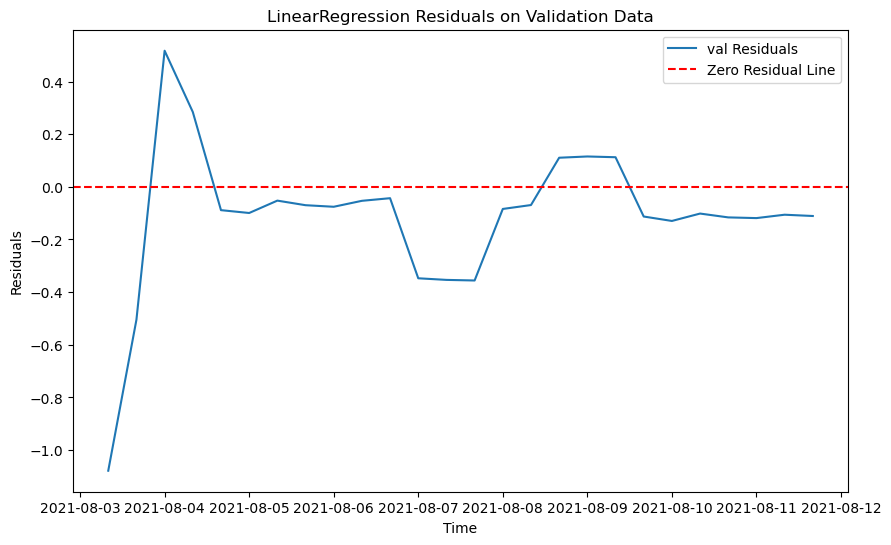

RMSE on training data for LinearRegression: 0.17502400952395197
RMSE on validation data for LinearRegression: 0.2983327385622688
RMSE on test data for LinearRegression: 0.27908850744682184

Best model is LinearRegression with RMSE: 0.2983327385622688
Best model saved as: models\model_446.pkl
data num 73
train_447.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

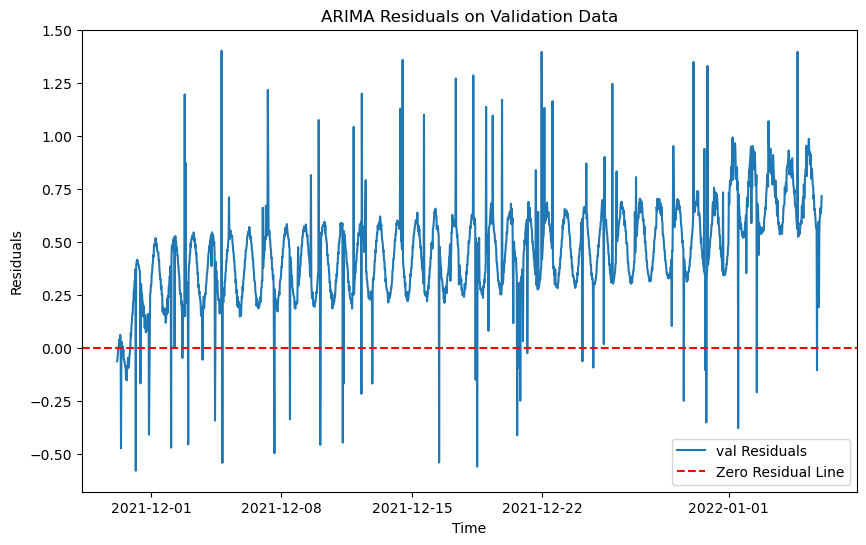

RMSE on training data for ARIMA: 0.18809847143776126
RMSE on validation data for ARIMA: 0.5087115446215006
RMSE on test data for ARIMA: 0.9935536519748673


21:51:19 - cmdstanpy - INFO - Chain [1] start processing
21:51:20 - cmdstanpy - INFO - Chain [1] done processing


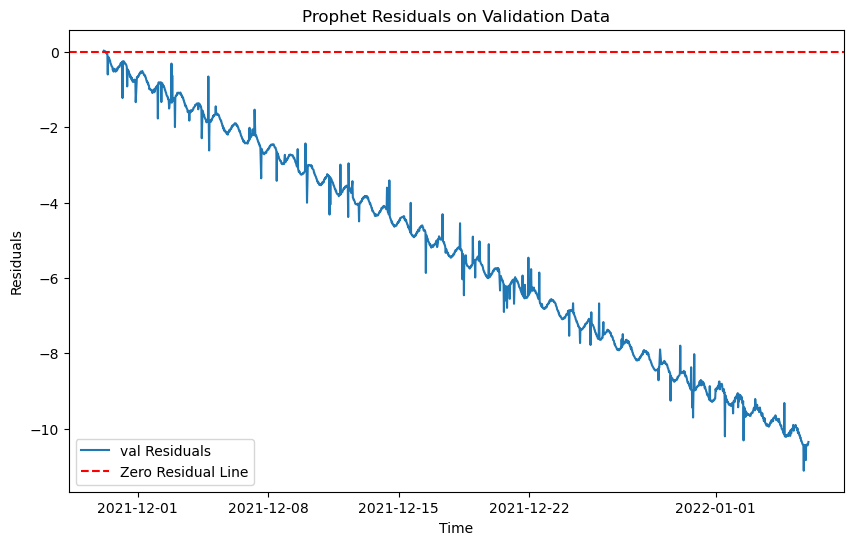

RMSE on training data for Prophet: 0.17150978367234626
RMSE on validation data for Prophet: 6.088664138198917
RMSE on test data for Prophet: 12.635050857244469


<Figure size 1000x800 with 0 Axes>

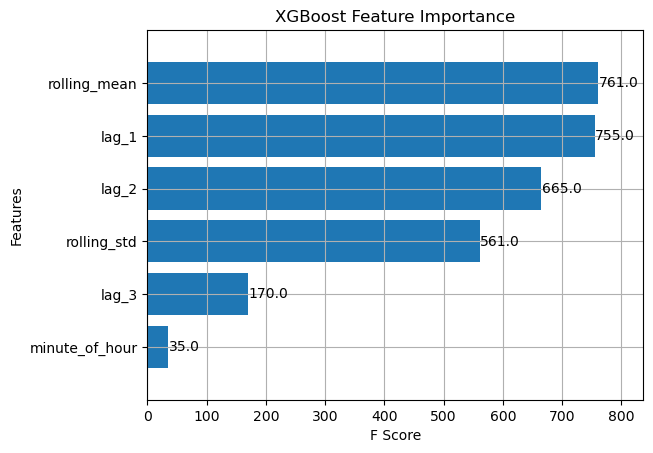

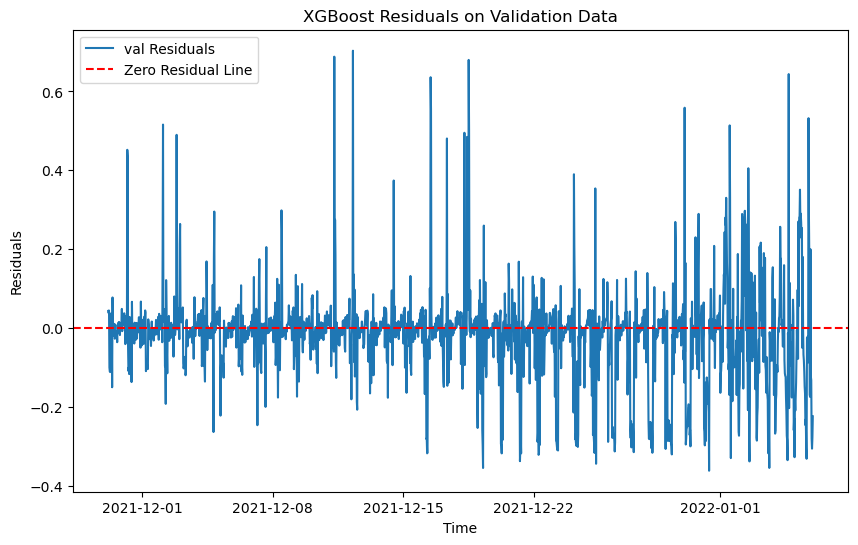

RMSE on training data for XGBoost: 0.023986727137296916
RMSE on validation data for XGBoost: 0.12006550602579891
RMSE on test data for XGBoost: 0.3968006702411032


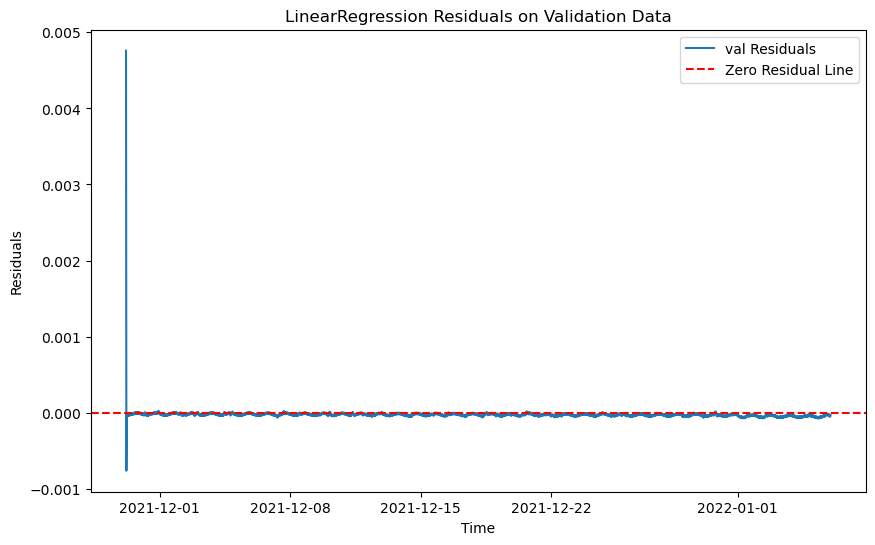

RMSE on training data for LinearRegression: 0.0008719433817289509
RMSE on validation data for LinearRegression: 0.00011735693646846879
RMSE on test data for LinearRegression: 0.0022817664870038844

Best model is LinearRegression with RMSE: 0.00011735693646846879
Best model saved as: models\model_447.pkl
data num 74
train_451.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.992022655019835e-15
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.8363688193100543e-10
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

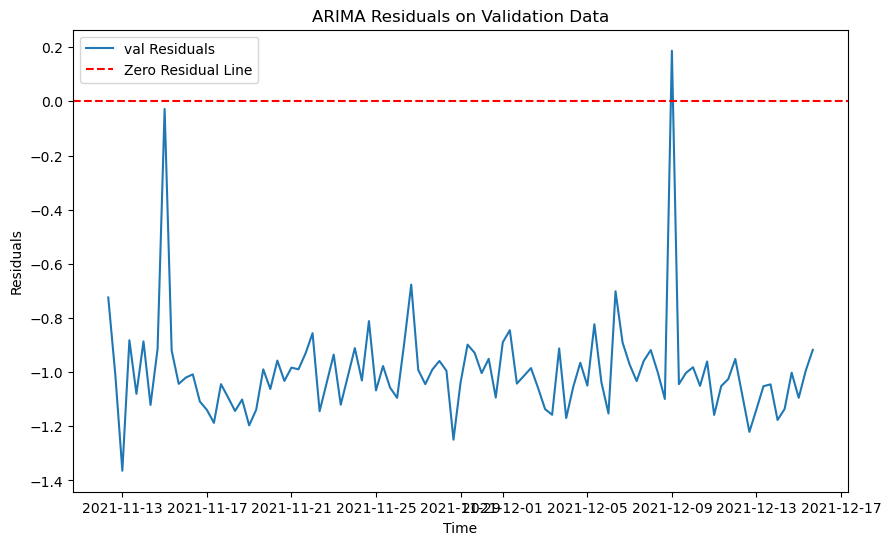

21:51:27 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.6448219140149211
RMSE on validation data for ARIMA: 1.0142254111163642
RMSE on test data for ARIMA: 1.1076807372405213


21:51:27 - cmdstanpy - INFO - Chain [1] done processing


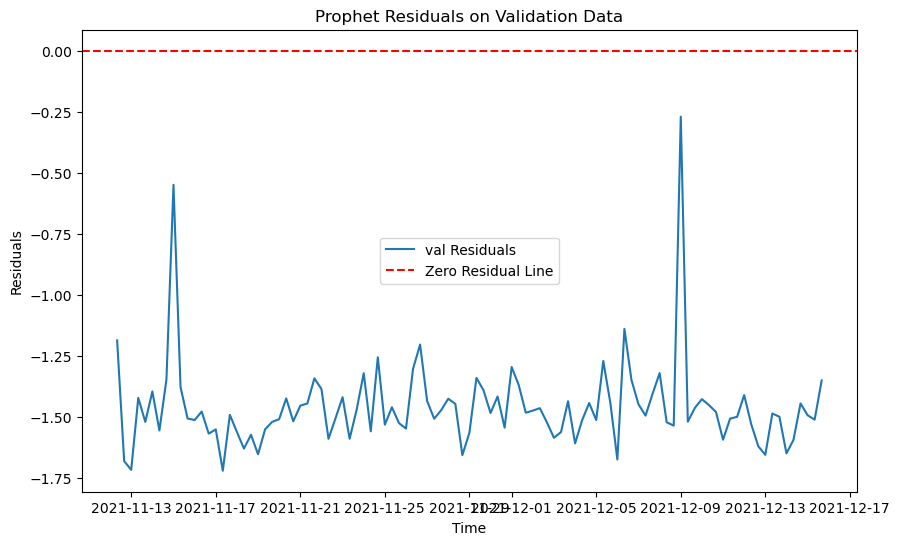

RMSE on training data for Prophet: 0.7179191609625051
RMSE on validation data for Prophet: 1.4718890588374356
RMSE on test data for Prophet: 1.2013269776415159


<Figure size 1000x800 with 0 Axes>

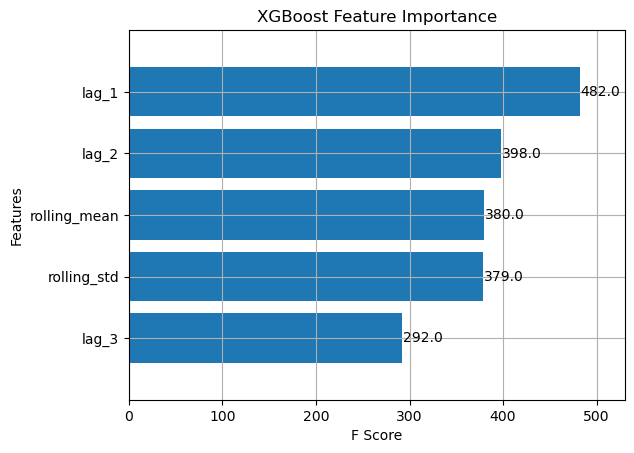

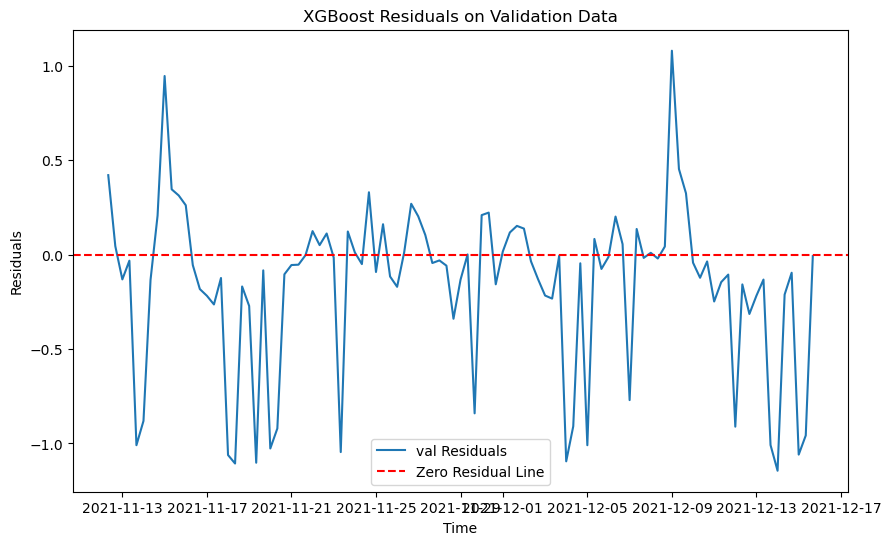

RMSE on training data for XGBoost: 0.11687221814955663
RMSE on validation data for XGBoost: 0.470320858324465
RMSE on test data for XGBoost: 0.22855684026223713


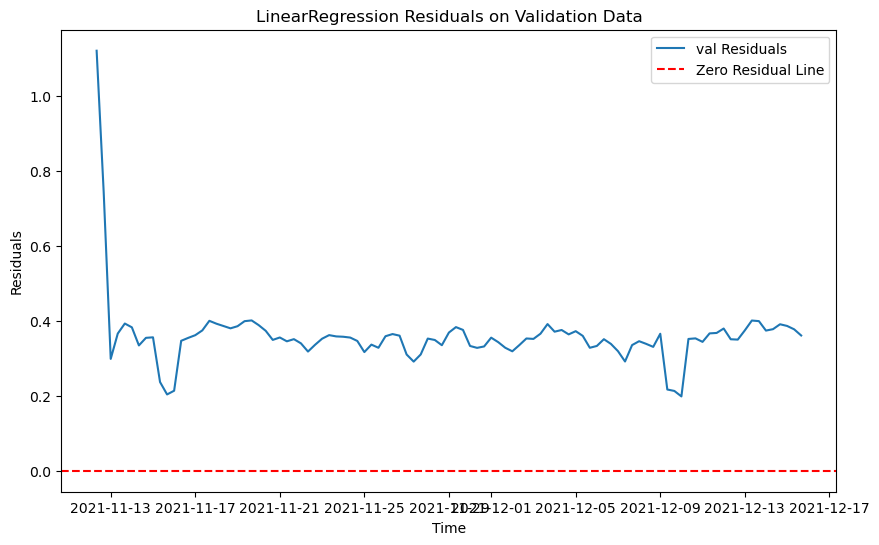

RMSE on training data for LinearRegression: 0.18436047455501797
RMSE on validation data for LinearRegression: 0.37049855625898526
RMSE on test data for LinearRegression: 0.08710153214967685

Best model is LinearRegression with RMSE: 0.37049855625898526
Best model saved as: models\model_451.pkl
data num 75
train_453.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)


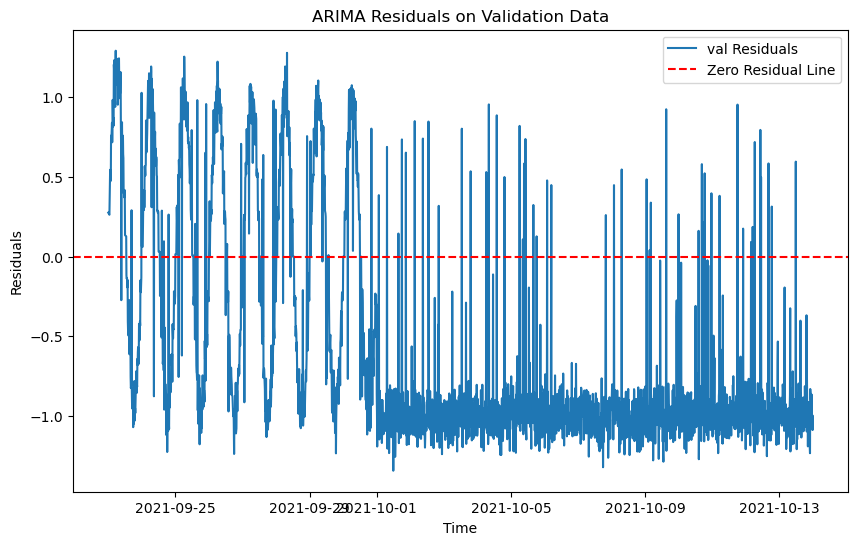

RMSE on training data for ARIMA: 0.24298085210815468
RMSE on validation data for ARIMA: 0.8955813234231509
RMSE on test data for ARIMA: 0.9839918115610183


21:51:37 - cmdstanpy - INFO - Chain [1] start processing
21:51:38 - cmdstanpy - INFO - Chain [1] done processing


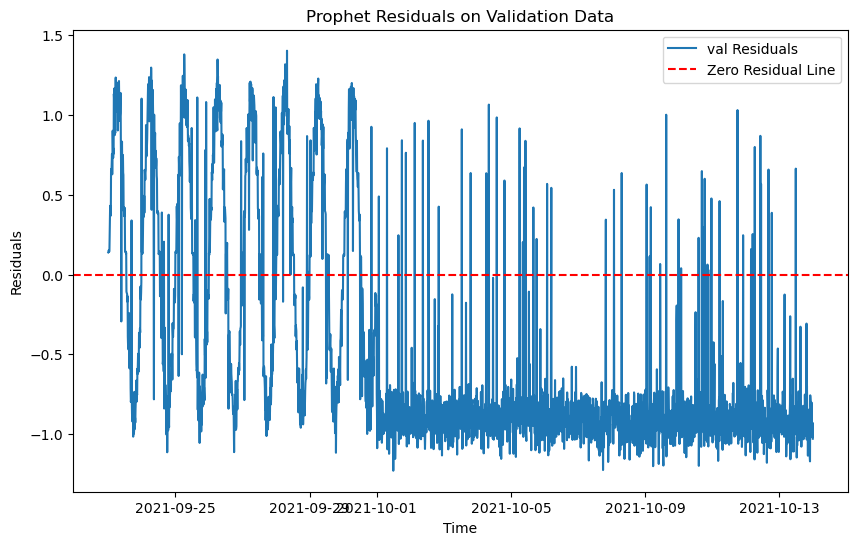

RMSE on training data for Prophet: 0.20898720551880987
RMSE on validation data for Prophet: 0.839172157896166
RMSE on test data for Prophet: 0.9316178445112705


<Figure size 1000x800 with 0 Axes>

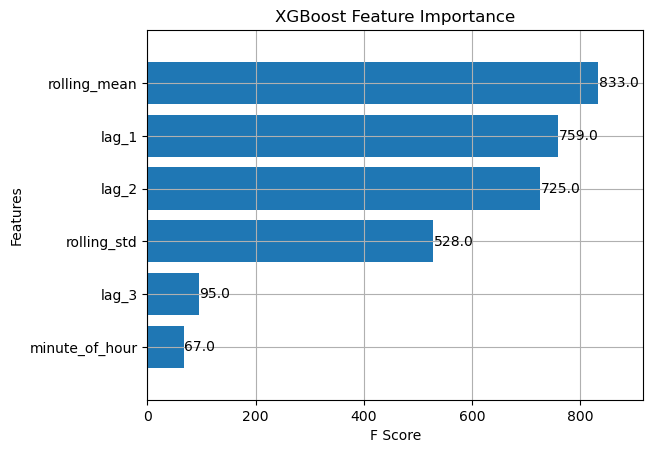

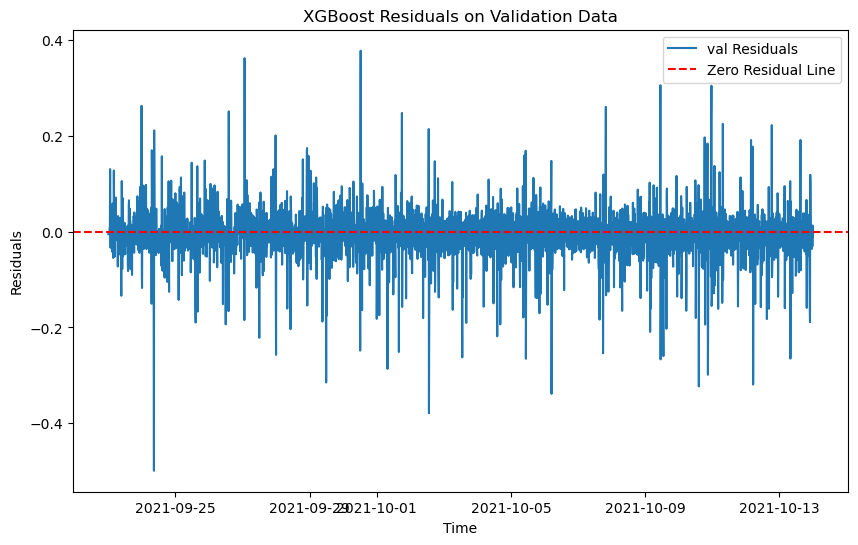

RMSE on training data for XGBoost: 0.03966637679092277
RMSE on validation data for XGBoost: 0.056198098069237
RMSE on test data for XGBoost: 0.05340220056936316


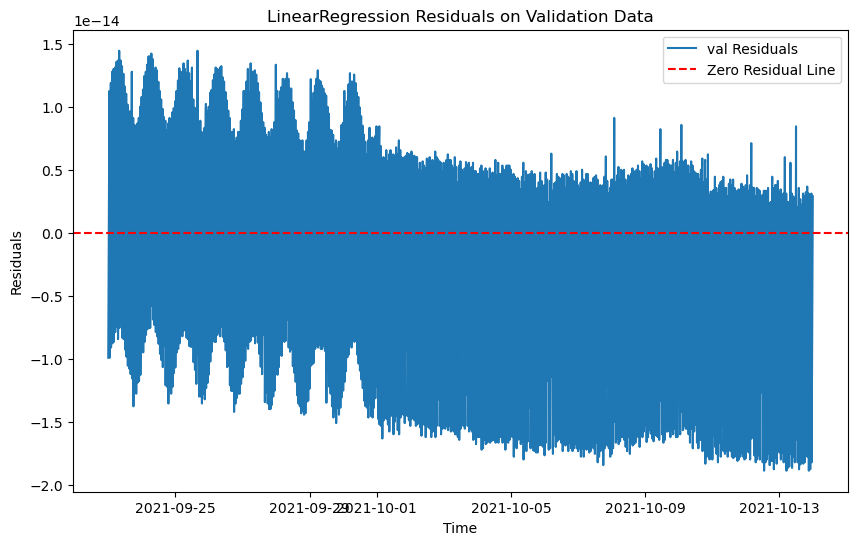

RMSE on training data for LinearRegression: 7.506597525689665e-15
RMSE on validation data for LinearRegression: 8.71775556181698e-15
RMSE on test data for LinearRegression: 0.0025529358258343294

Best model is LinearRegression with RMSE: 8.71775556181698e-15
Best model saved as: models\model_453.pkl
data num 76
train_461.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 3.0625642514089336e-18
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 6.648042341150349e-14
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

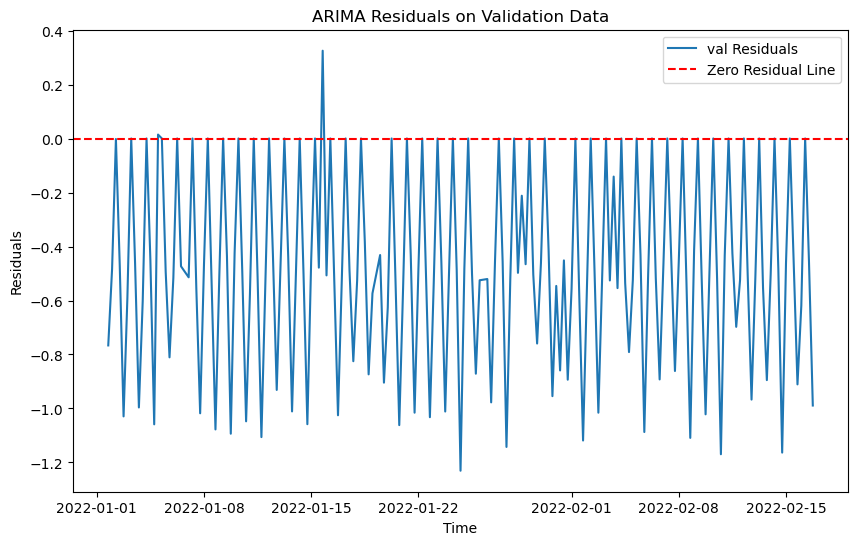

21:51:46 - cmdstanpy - INFO - Chain [1] start processing
21:51:46 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3395137575256528
RMSE on validation data for ARIMA: 0.6000209548890922
RMSE on test data for ARIMA: 0.7966144656474167


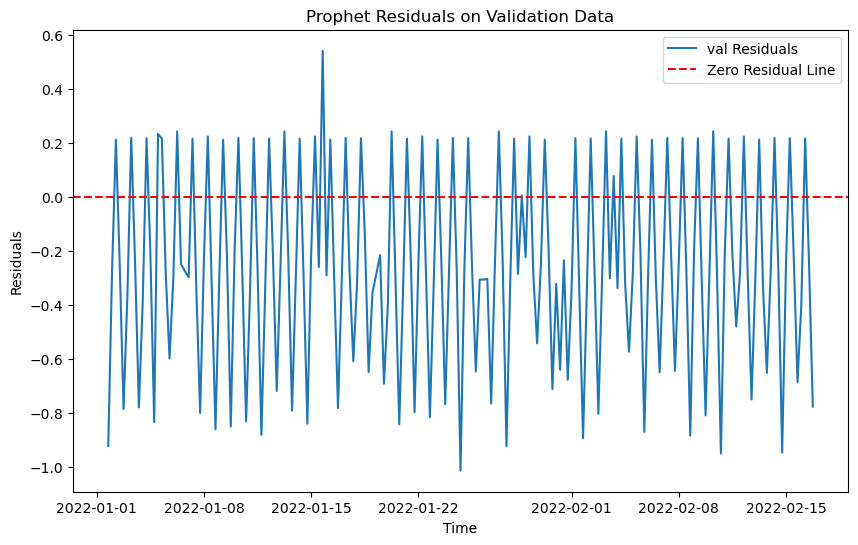

RMSE on training data for Prophet: 0.41483590103904733
RMSE on validation data for Prophet: 0.44368132178273756
RMSE on test data for Prophet: 0.827177882652737


<Figure size 1000x800 with 0 Axes>

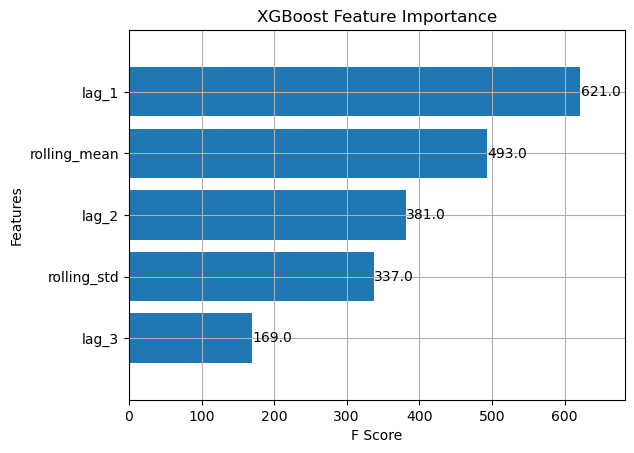

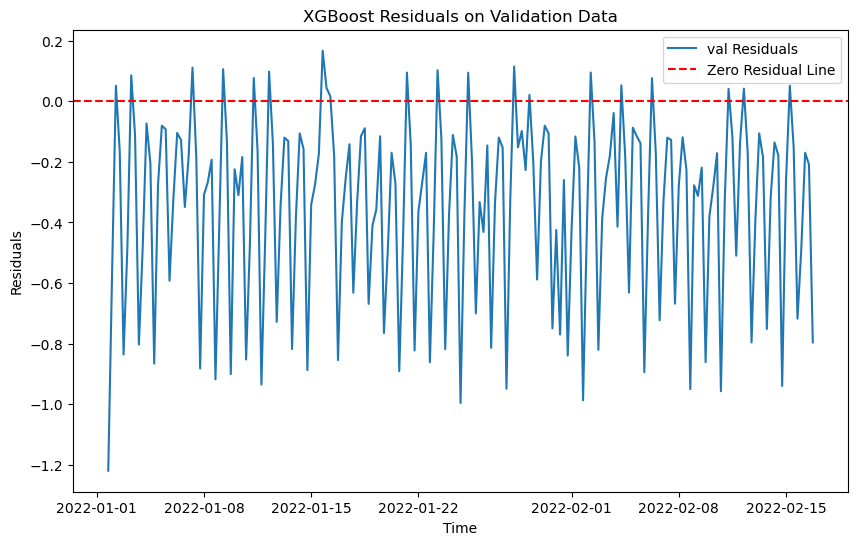

RMSE on training data for XGBoost: 0.022154753842707098
RMSE on validation data for XGBoost: 0.4589304272819596
RMSE on test data for XGBoost: 0.2745129898815993


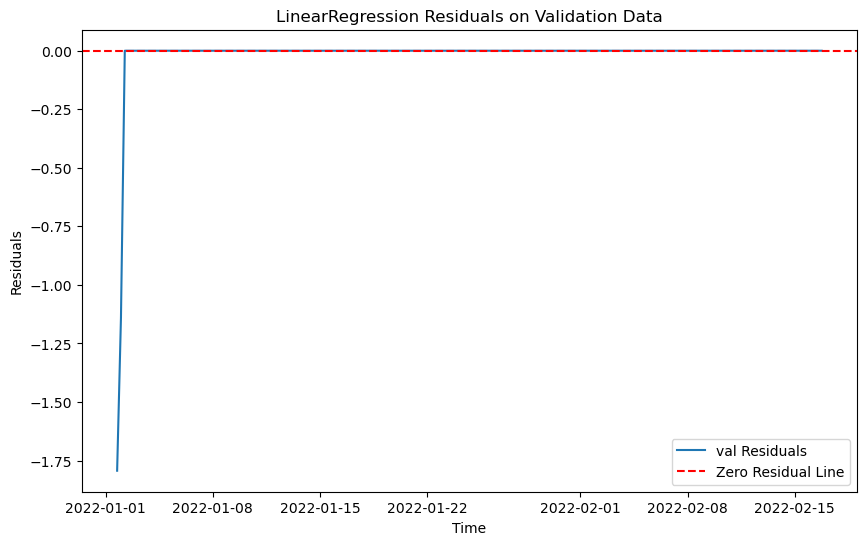

RMSE on training data for LinearRegression: 6.321321194802656e-16
RMSE on validation data for LinearRegression: 0.15625727259013328
RMSE on test data for LinearRegression: 0.03298687608369054

Best model is LinearRegression with RMSE: 0.15625727259013328
Best model saved as: models\model_461.pkl
data num 77
train_462.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.0208362757894472e-12
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.642435434167822e-05
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 8.907834428604001e-10
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

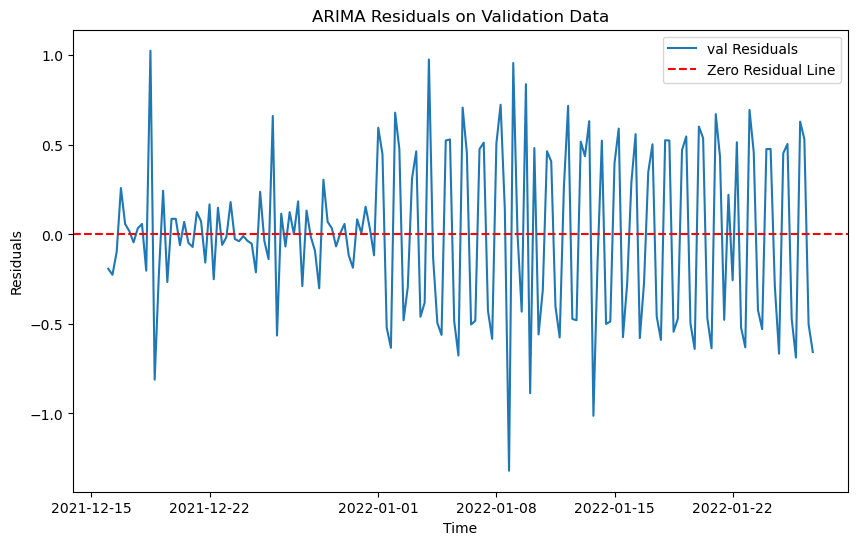

RMSE on training data for ARIMA: 0.3225381584276211
RMSE on validation data for ARIMA: 0.4543309153415043
RMSE on test data for ARIMA: 0.6693893301373384


21:51:49 - cmdstanpy - INFO - Chain [1] start processing
21:51:49 - cmdstanpy - INFO - Chain [1] done processing


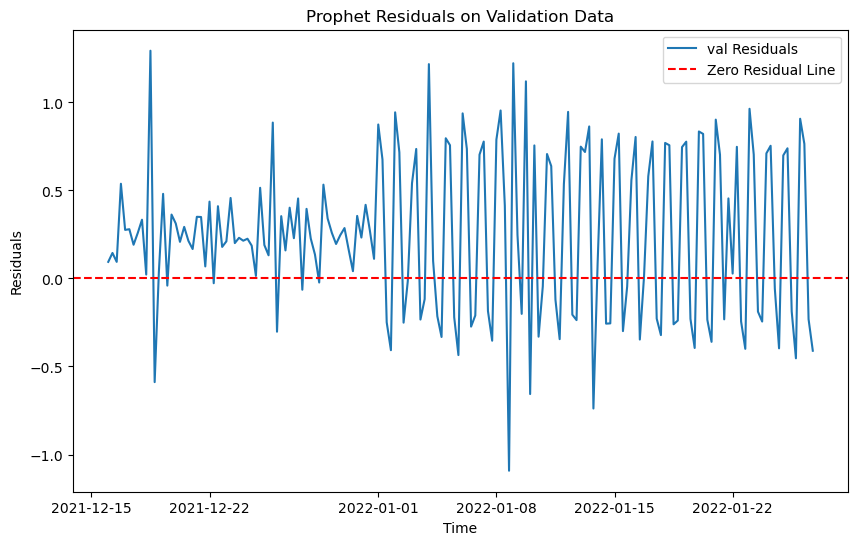

RMSE on training data for Prophet: 0.37814546459711124
RMSE on validation data for Prophet: 0.5192979402215726
RMSE on test data for Prophet: 0.7168887100994862


<Figure size 1000x800 with 0 Axes>

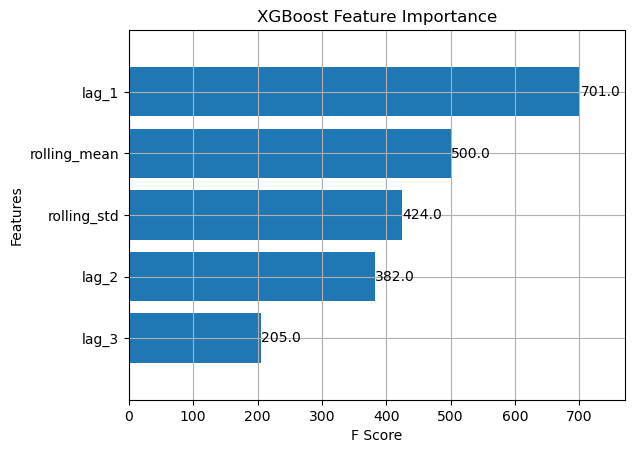

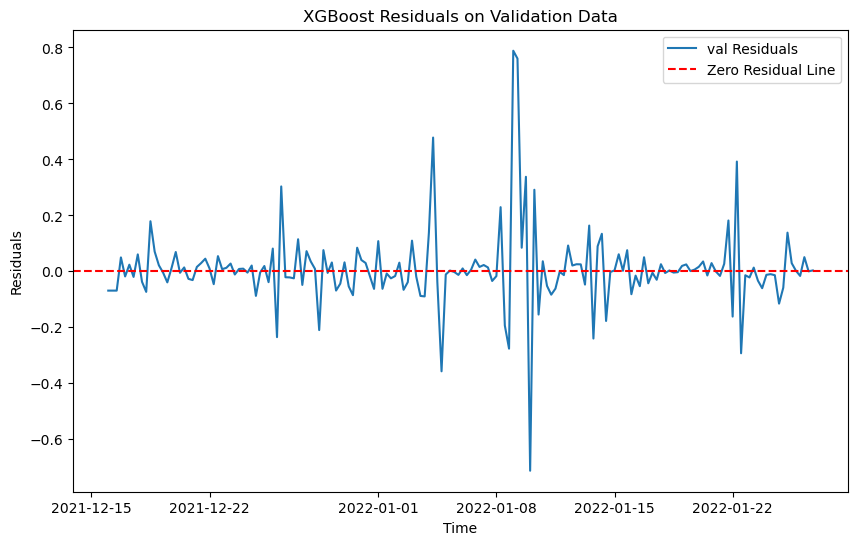

RMSE on training data for XGBoost: 0.03520836549950158
RMSE on validation data for XGBoost: 0.14295020286727153
RMSE on test data for XGBoost: 0.4226990712817124


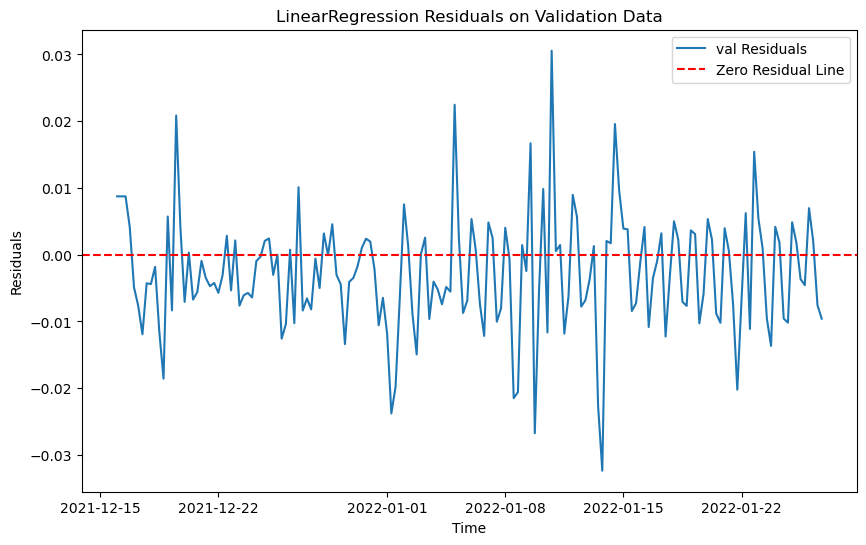

RMSE on training data for LinearRegression: 0.05078293603234379
RMSE on validation data for LinearRegression: 0.009187597853692813
RMSE on test data for LinearRegression: 0.06701709668820725

Best model is LinearRegression with RMSE: 0.009187597853692813
Best model saved as: models\model_462.pkl
data num 78
train_465.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


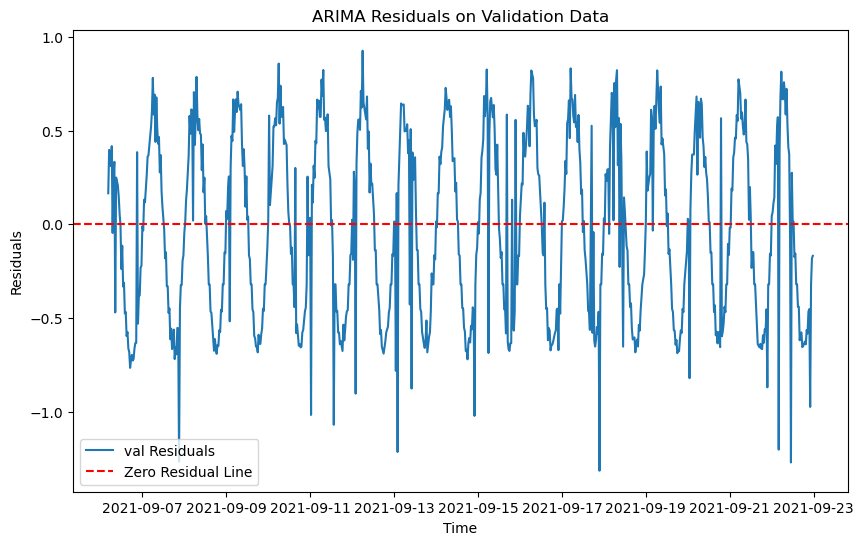

RMSE on training data for ARIMA: 0.23213746037448632
RMSE on validation data for ARIMA: 0.4844750515724837
RMSE on test data for ARIMA: 0.7364052206066846


21:51:53 - cmdstanpy - INFO - Chain [1] start processing
21:51:54 - cmdstanpy - INFO - Chain [1] done processing


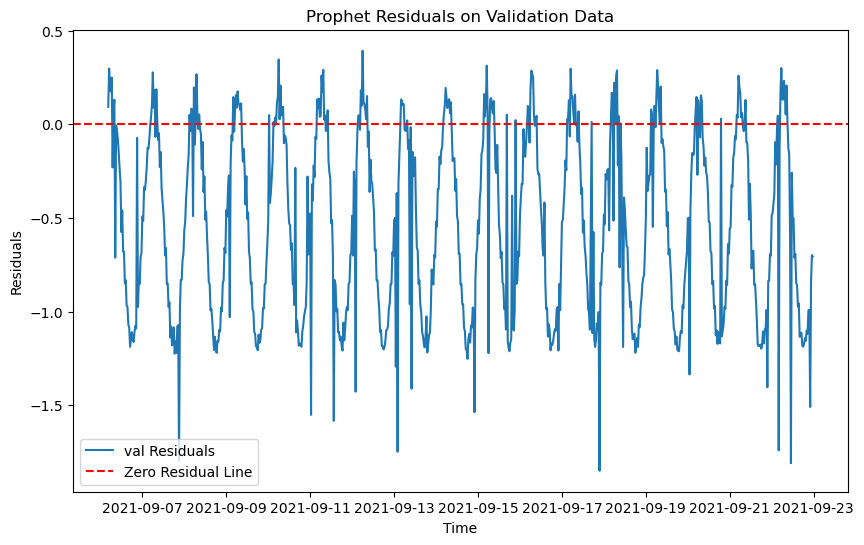

RMSE on training data for Prophet: 0.1811417415751452
RMSE on validation data for Prophet: 0.7248270180007923
RMSE on test data for Prophet: 1.1609375224116447


<Figure size 1000x800 with 0 Axes>

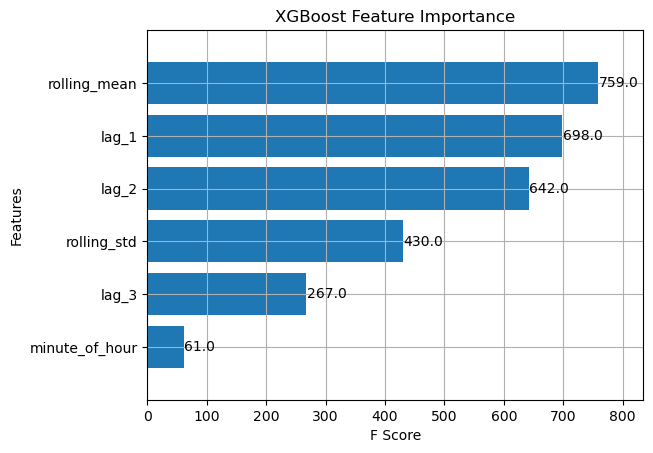

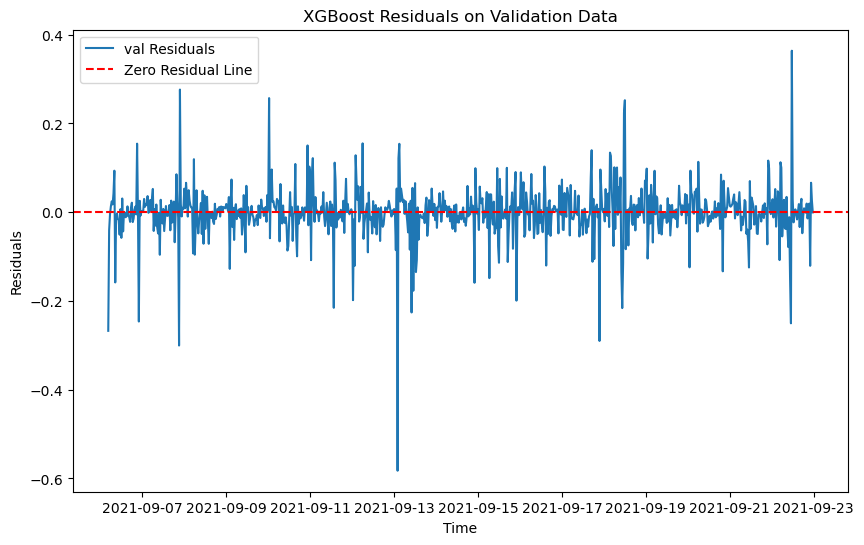

RMSE on training data for XGBoost: 0.026032191838815635
RMSE on validation data for XGBoost: 0.059802703554978305
RMSE on test data for XGBoost: 0.3824583431267752


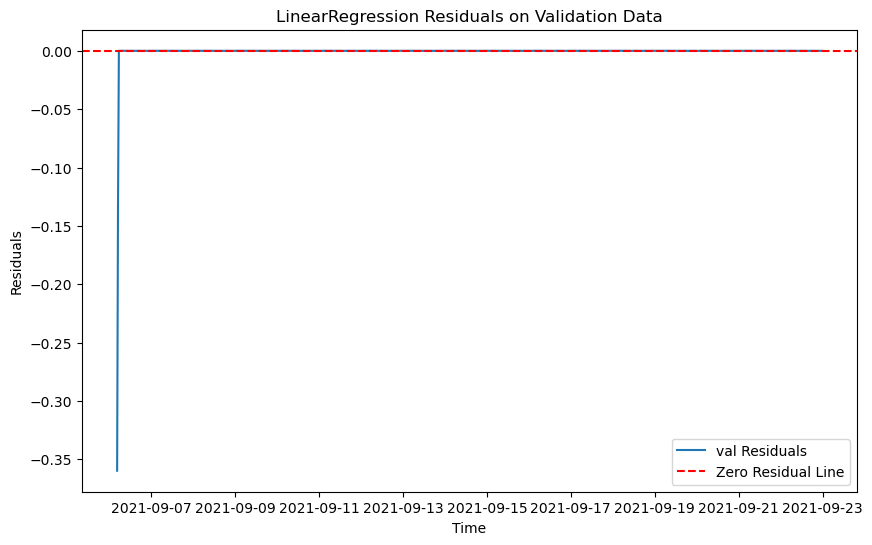

RMSE on training data for LinearRegression: 0.0026938473956552218
RMSE on validation data for LinearRegression: 0.013512502827211297
RMSE on test data for LinearRegression: 0.004112755942999715

Best model is LinearRegression with RMSE: 0.013512502827211297
Best model saved as: models\model_465.pkl
data num 79
train_469.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.7786084565460892e-09
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.159334855026786e-07
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 8.062532133316275e-25
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

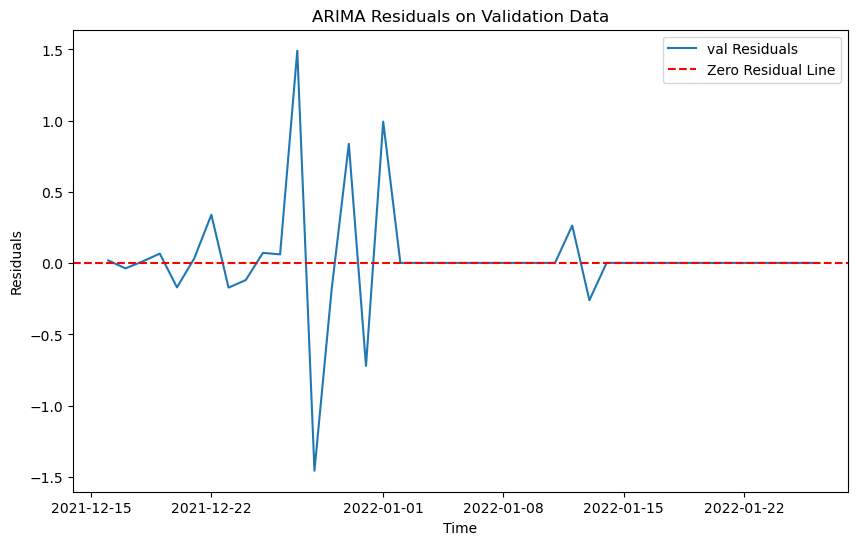

21:51:58 - cmdstanpy - INFO - Chain [1] start processing
21:51:58 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.2072087334024685
RMSE on validation data for ARIMA: 0.40601328312405194
RMSE on test data for ARIMA: 0.23149300377387033


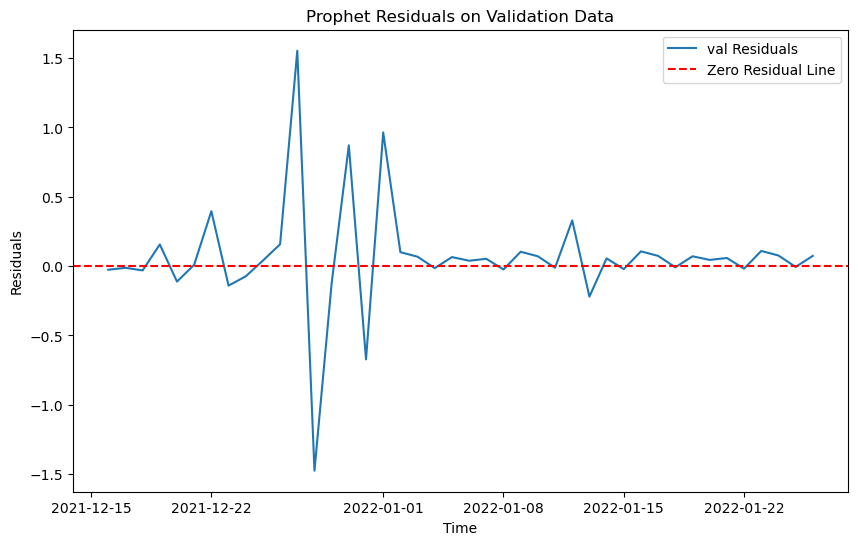

RMSE on training data for Prophet: 0.2168932402287773
RMSE on validation data for Prophet: 0.41535867847910524
RMSE on test data for Prophet: 0.24290961805744837


<Figure size 1000x800 with 0 Axes>

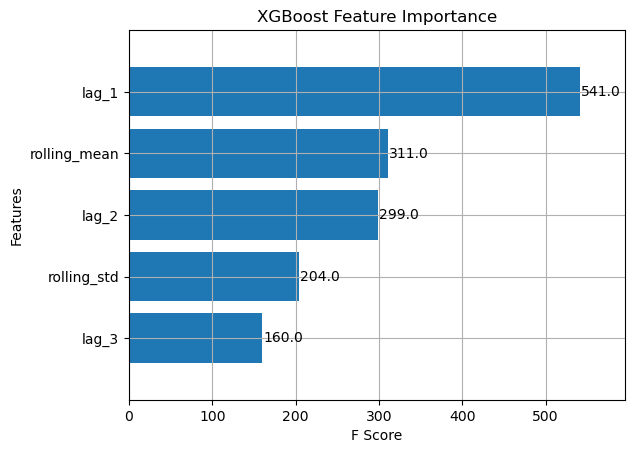

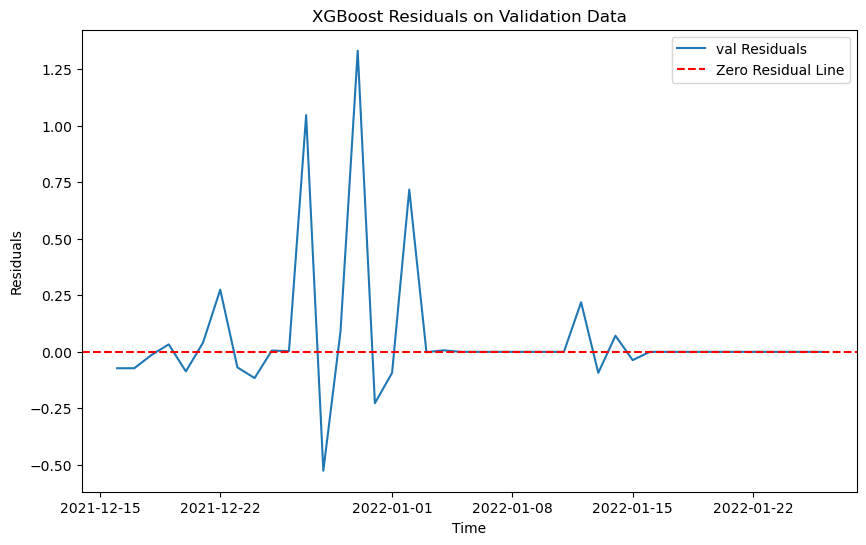

RMSE on training data for XGBoost: 0.04196254392175313
RMSE on validation data for XGBoost: 0.30473378372890375
RMSE on test data for XGBoost: 0.2681053746334653


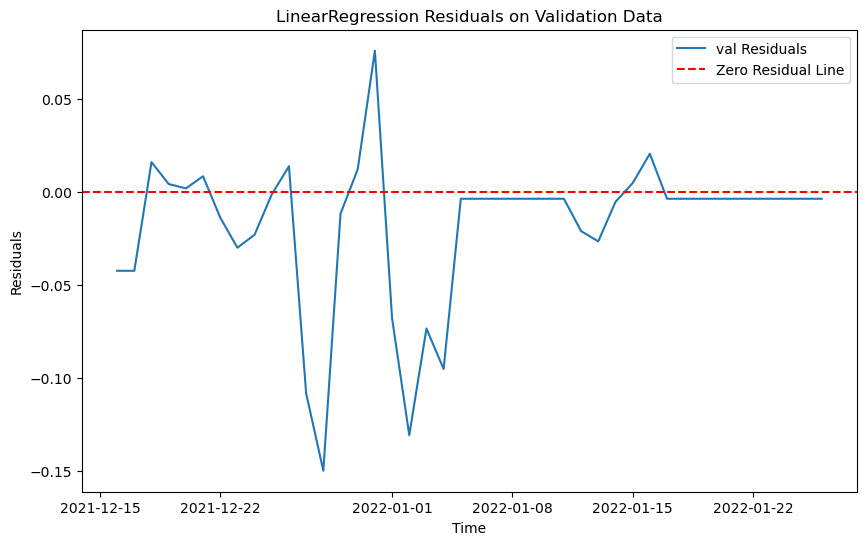

RMSE on training data for LinearRegression: 0.057480854821606114
RMSE on validation data for LinearRegression: 0.04477752045366179
RMSE on test data for LinearRegression: 0.0255174415769701

Best model is LinearRegression with RMSE: 0.04477752045366179
Best model saved as: models\model_469.pkl
data num 80
train_482.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.480029233145371e-15
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.00024243961465409759
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0010365401352592373
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

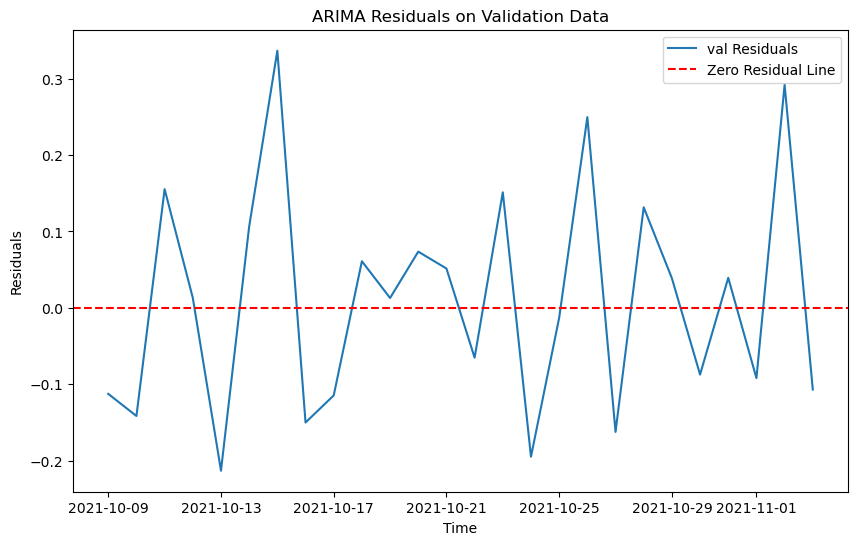

21:52:00 - cmdstanpy - INFO - Chain [1] start processing
21:52:00 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3437115368037843
RMSE on validation data for ARIMA: 0.1470606245291978
RMSE on test data for ARIMA: 0.3623440712647289


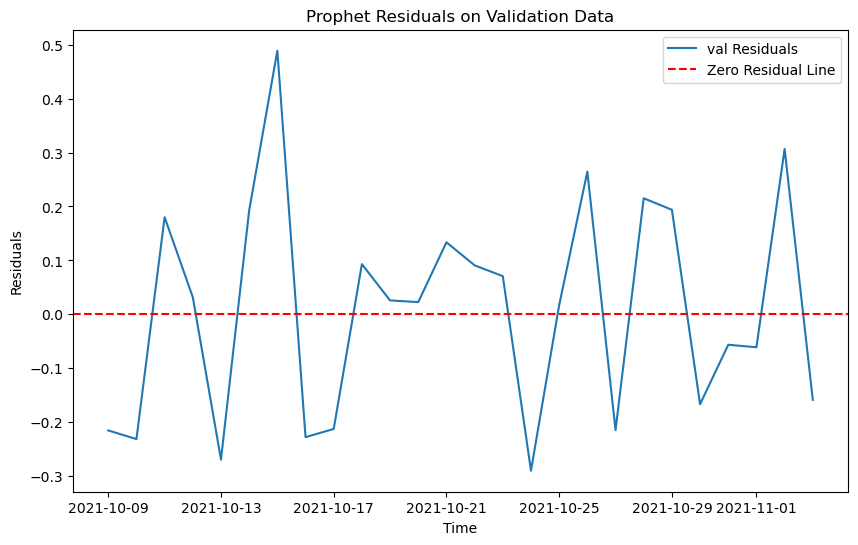

RMSE on training data for Prophet: 0.35751571280773836
RMSE on validation data for Prophet: 0.20180351789619175
RMSE on test data for Prophet: 0.36617810341074974


<Figure size 1000x800 with 0 Axes>

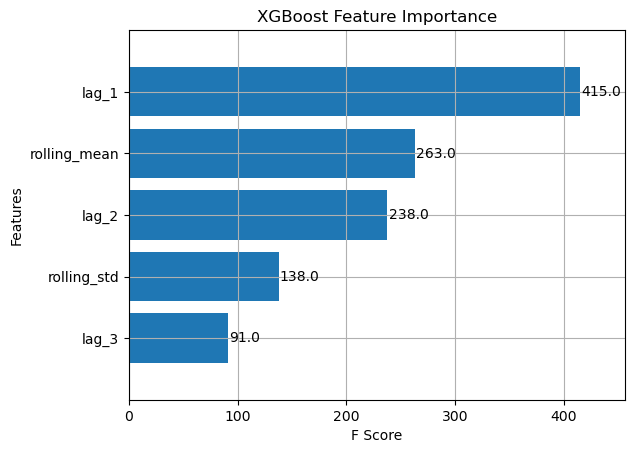

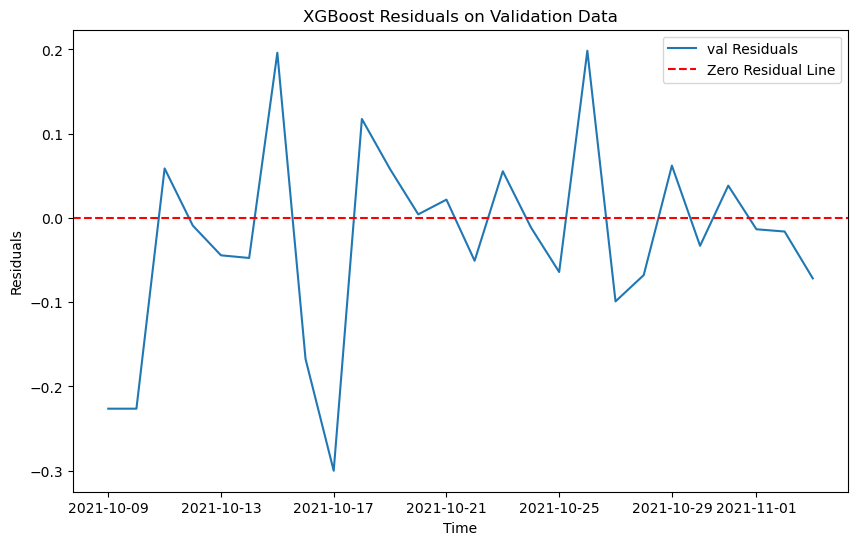

RMSE on training data for XGBoost: 0.006926064205011388
RMSE on validation data for XGBoost: 0.11770931963543367
RMSE on test data for XGBoost: 0.4202646750888443


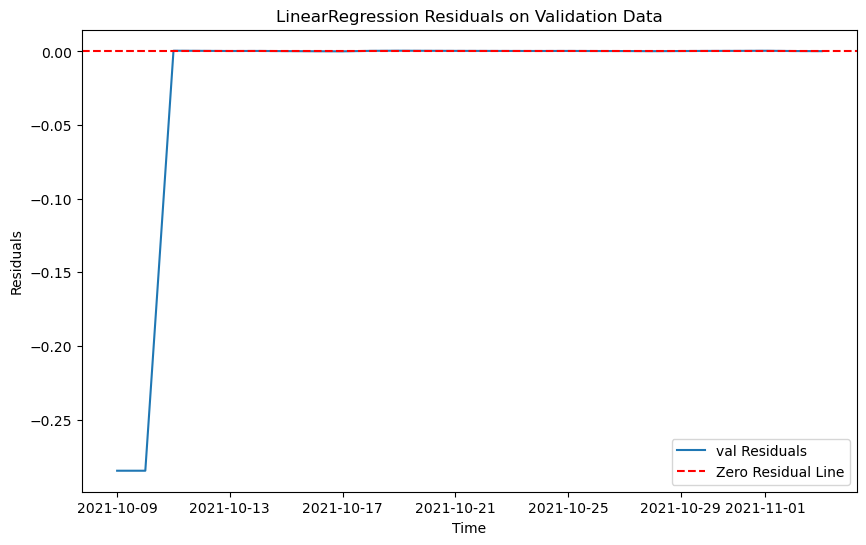

RMSE on training data for LinearRegression: 0.0019885723694660126
RMSE on validation data for LinearRegression: 0.07896141952644717
RMSE on test data for LinearRegression: 0.03825993017966667

Best model is LinearRegression with RMSE: 0.07896141952644717
Best model saved as: models\model_482.pkl
data num 81
train_483.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


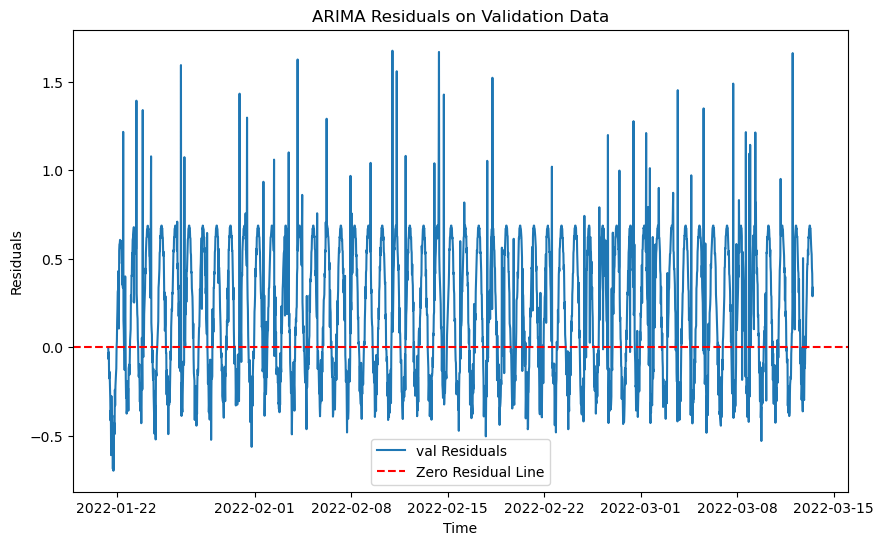

RMSE on training data for ARIMA: 0.26333527802005835
RMSE on validation data for ARIMA: 0.43395844714546605
RMSE on test data for ARIMA: 0.9165369284769744


21:52:06 - cmdstanpy - INFO - Chain [1] start processing
21:52:08 - cmdstanpy - INFO - Chain [1] done processing


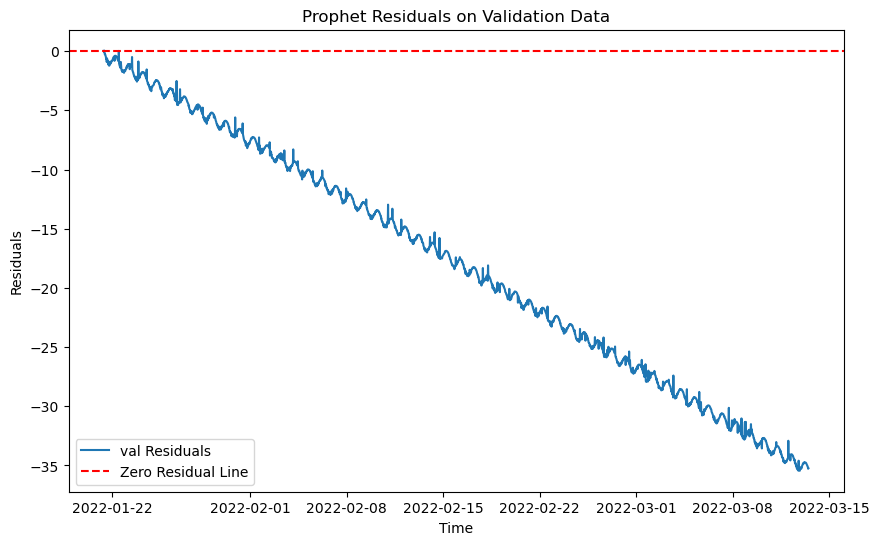

RMSE on training data for Prophet: 0.29430902611850085
RMSE on validation data for Prophet: 20.509066555160356
RMSE on test data for Prophet: 43.272246647257276


<Figure size 1000x800 with 0 Axes>

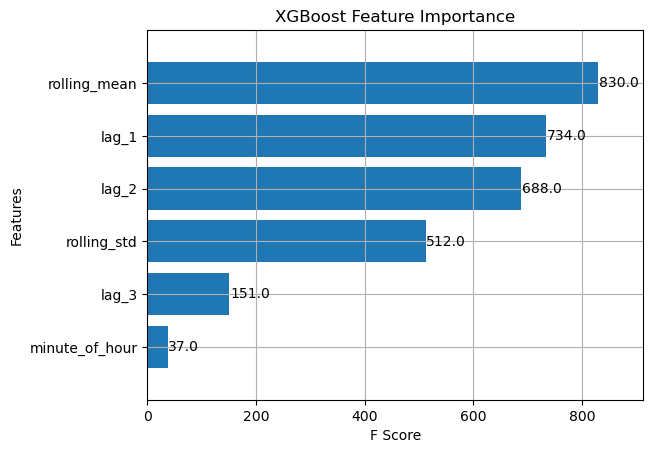

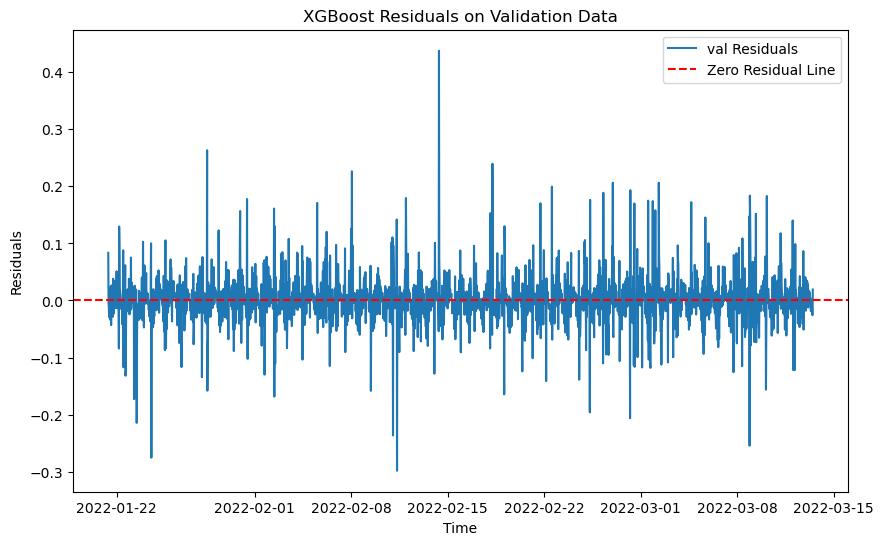

RMSE on training data for XGBoost: 0.028066443661390425
RMSE on validation data for XGBoost: 0.0432720397102222
RMSE on test data for XGBoost: 0.5258281395002365


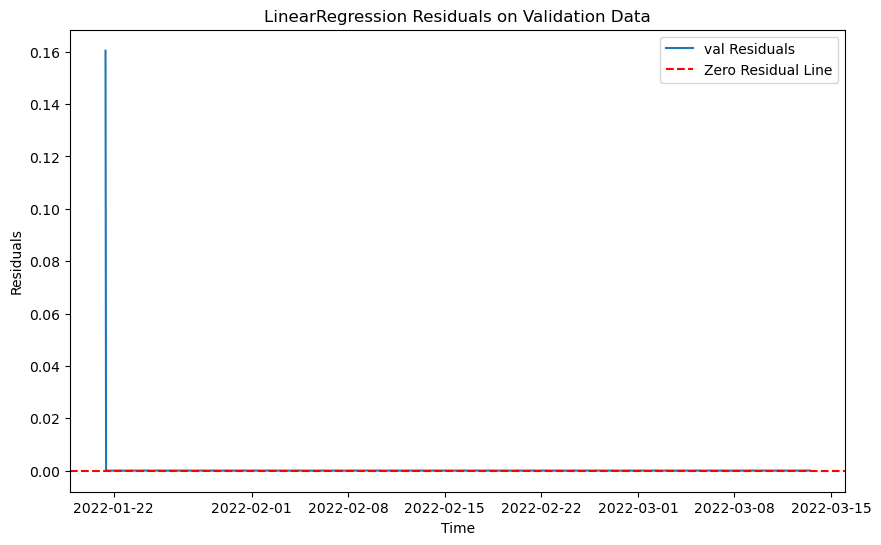

RMSE on training data for LinearRegression: 0.0016129732450686218
RMSE on validation data for LinearRegression: 0.003552045145652881
RMSE on test data for LinearRegression: 0.0034035103885516733

Best model is LinearRegression with RMSE: 0.003552045145652881
Best model saved as: models\model_483.pkl
data num 82
train_490.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.3095789011178228e-15
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.011875026015529035
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.3953170143267758e-18
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

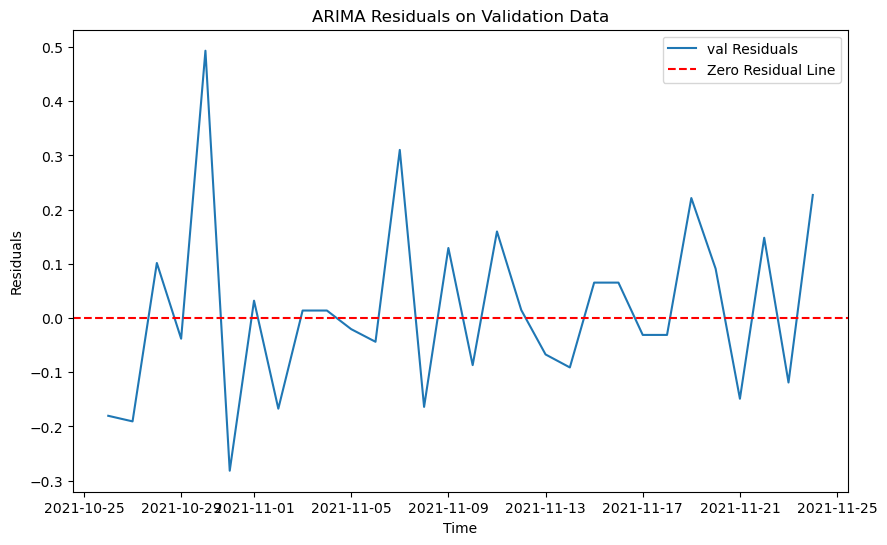

21:52:15 - cmdstanpy - INFO - Chain [1] start processing
21:52:15 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.23095160546089952
RMSE on validation data for ARIMA: 0.16314897206758405
RMSE on test data for ARIMA: 0.4121642350489246


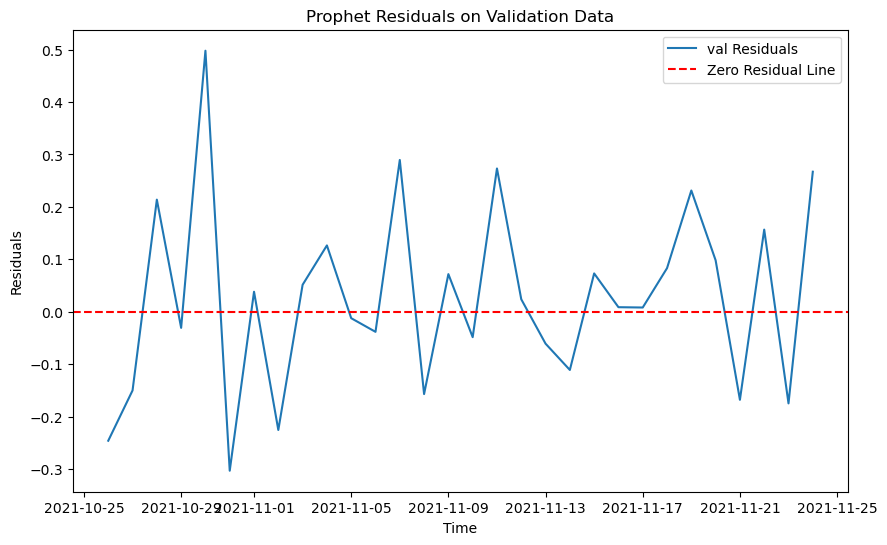

RMSE on training data for Prophet: 0.2305588083327751
RMSE on validation data for Prophet: 0.1806886227951244
RMSE on test data for Prophet: 0.43633259888601034


<Figure size 1000x800 with 0 Axes>

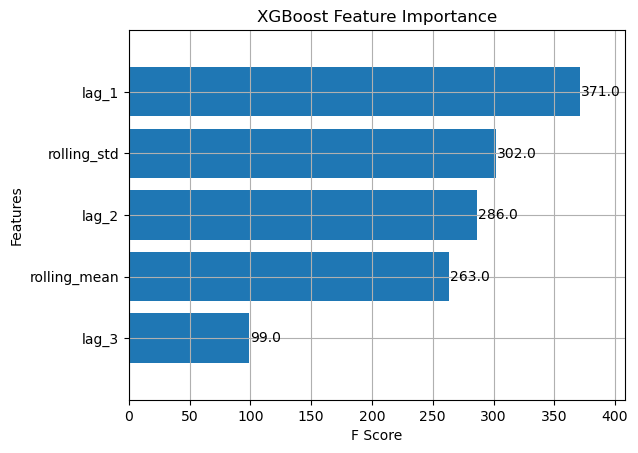

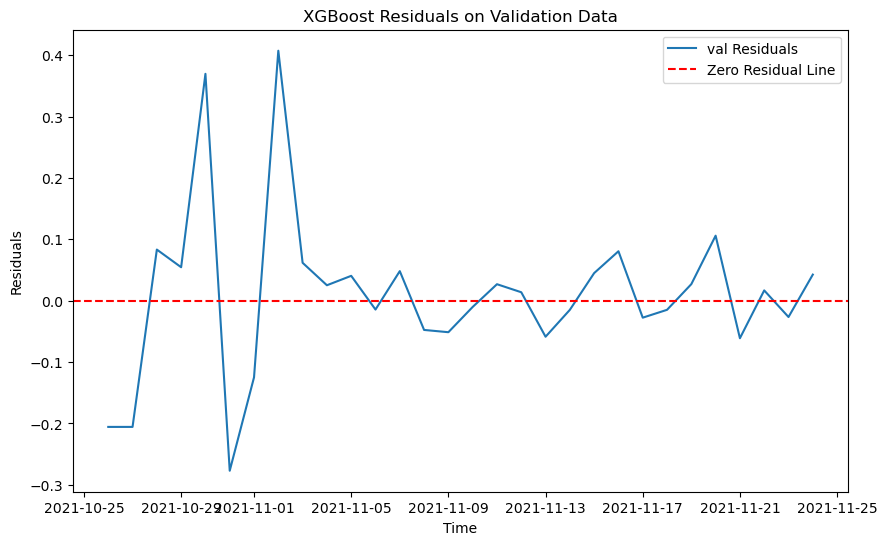

RMSE on training data for XGBoost: 0.004533717484708248
RMSE on validation data for XGBoost: 0.13357213562663975
RMSE on test data for XGBoost: 0.4292910616215485


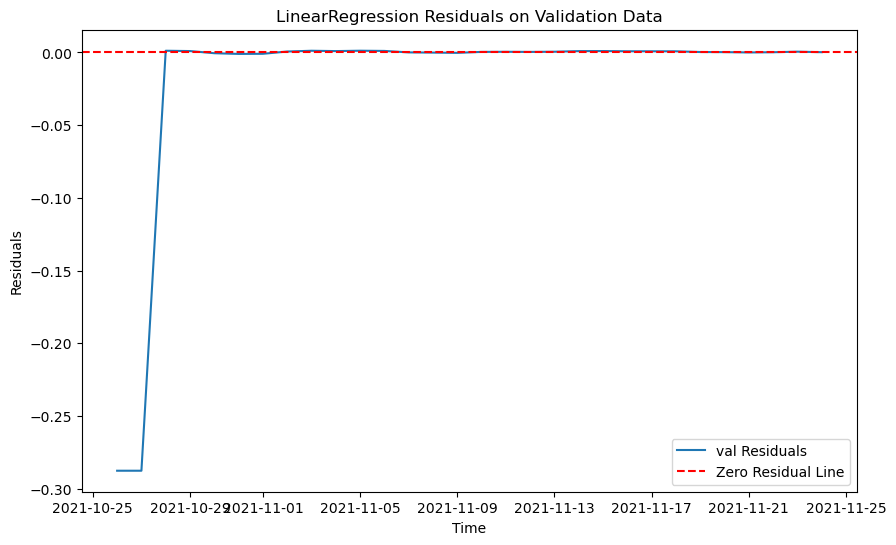

RMSE on training data for LinearRegression: 0.0029404036757219726
RMSE on validation data for LinearRegression: 0.07428633164273961
RMSE on test data for LinearRegression: 0.1901065401216309

Best model is LinearRegression with RMSE: 0.07428633164273961
Best model saved as: models\model_490.pkl
data num 83
train_491.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 4.5426836835811e-13
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 5.027285864241052e-08
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

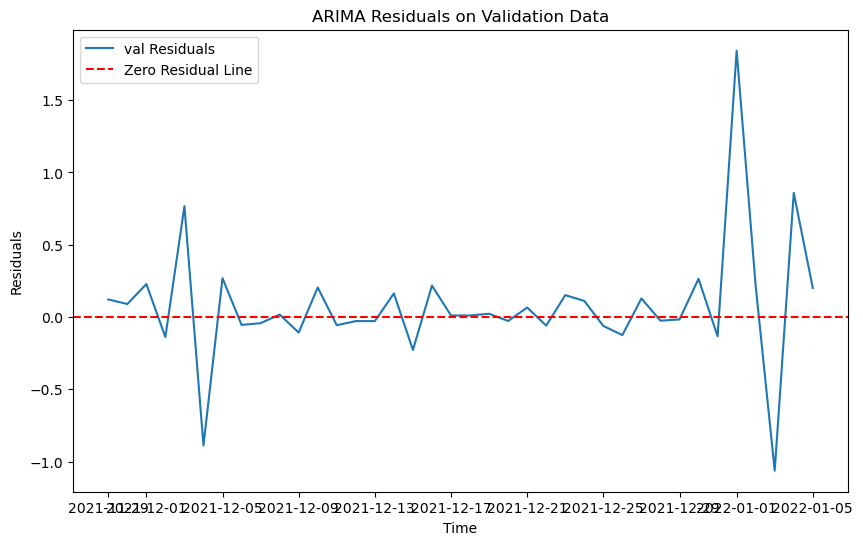

21:52:17 - cmdstanpy - INFO - Chain [1] start processing
21:52:17 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3767655631605285
RMSE on validation data for ARIMA: 0.4366678479928982
RMSE on test data for ARIMA: 1.0086205314240062


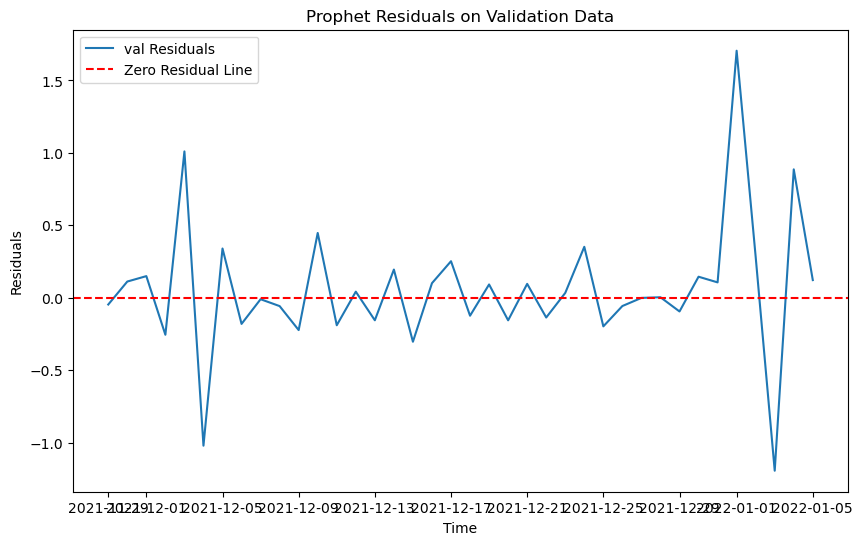

RMSE on training data for Prophet: 0.40533486846932293
RMSE on validation data for Prophet: 0.468086685810928
RMSE on test data for Prophet: 0.9967085999704769


<Figure size 1000x800 with 0 Axes>

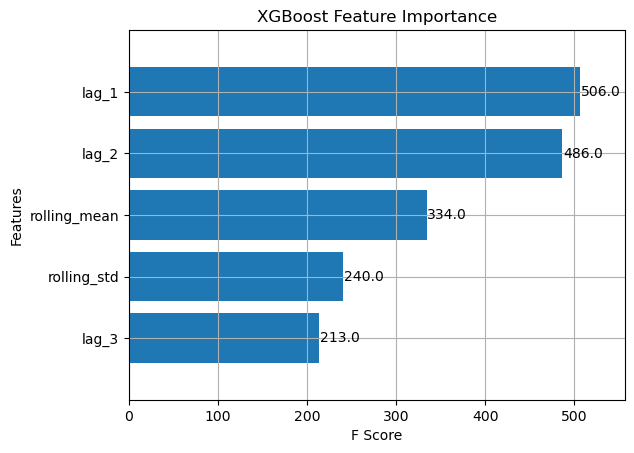

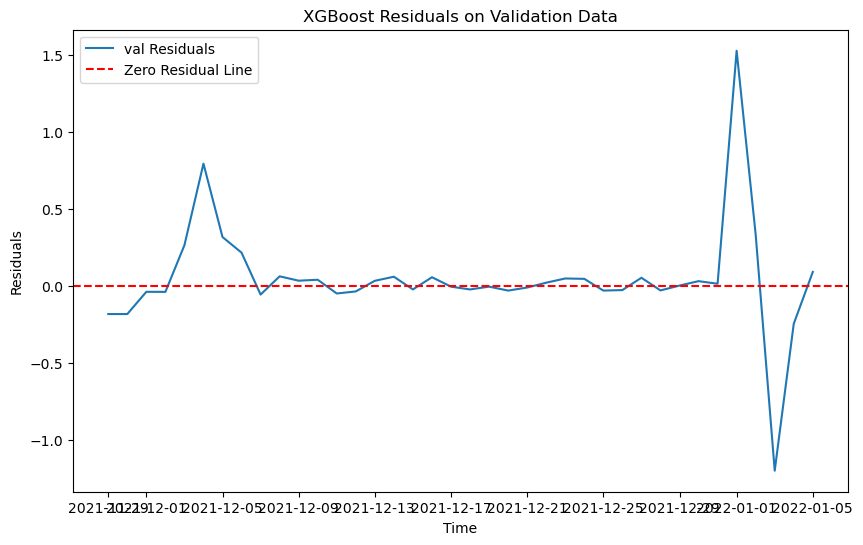

RMSE on training data for XGBoost: 0.006186257183288152
RMSE on validation data for XGBoost: 0.3594136481346553
RMSE on test data for XGBoost: 1.2993675281534063


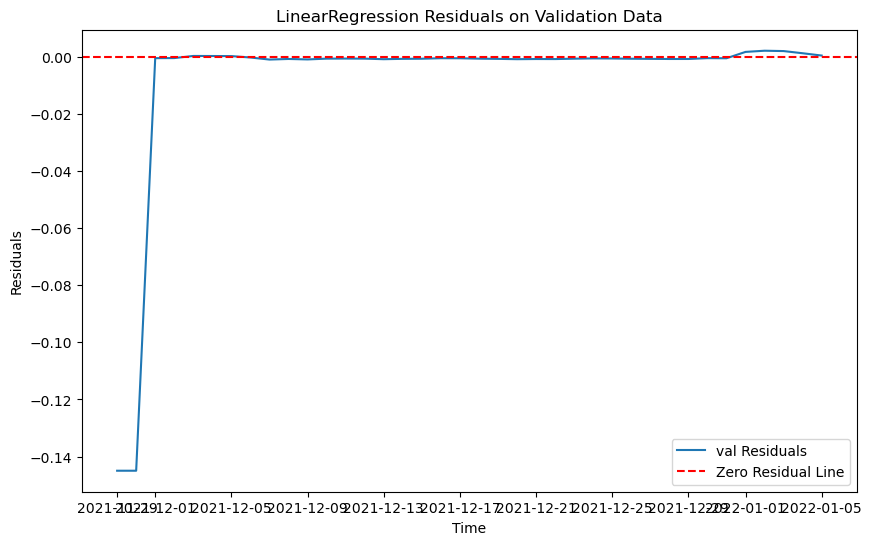

RMSE on training data for LinearRegression: 0.0044121896650744855
RMSE on validation data for LinearRegression: 0.03326832910876637
RMSE on test data for LinearRegression: 0.05027156711110437

Best model is LinearRegression with RMSE: 0.03326832910876637
Best model saved as: models\model_491.pkl
data num 84
train_495.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\904417940.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].diff().bfill()


New p-value after differencing: 0.0
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


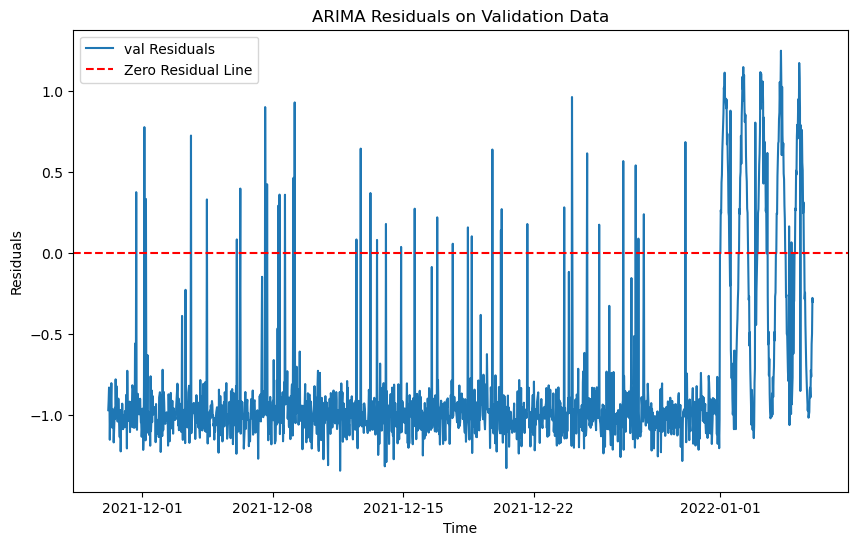

RMSE on training data for ARIMA: 0.2869422206303
RMSE on validation data for ARIMA: 0.9572654156616919
RMSE on test data for ARIMA: 0.702367531423262


21:52:25 - cmdstanpy - INFO - Chain [1] start processing
21:52:25 - cmdstanpy - INFO - Chain [1] done processing


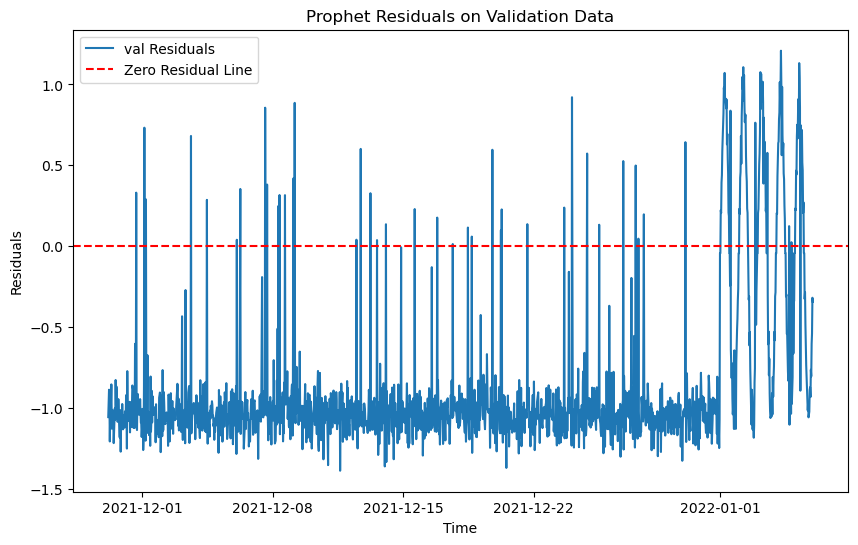

RMSE on training data for Prophet: 0.3293357852163294
RMSE on validation data for Prophet: 0.9962123365420026
RMSE on test data for Prophet: 0.7032042460559452


<Figure size 1000x800 with 0 Axes>

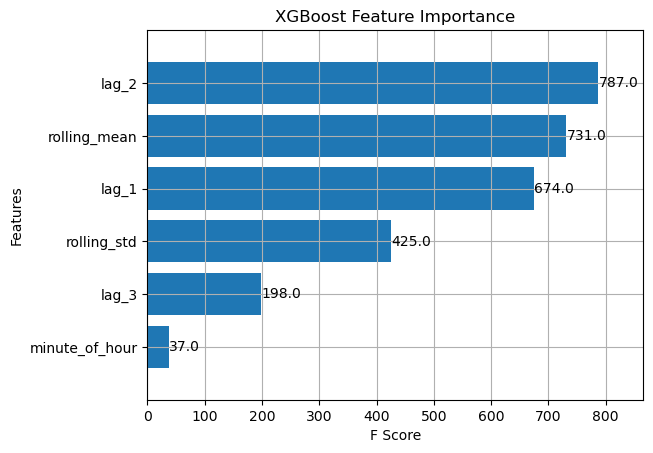

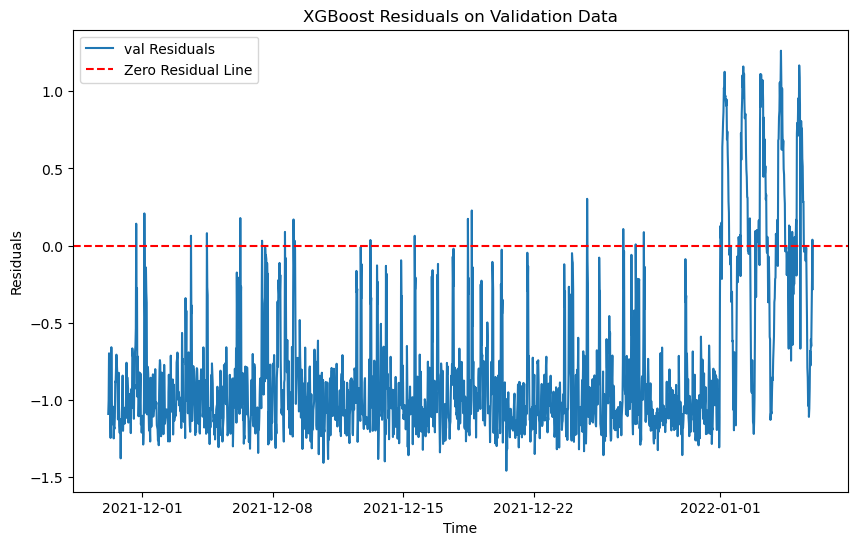

RMSE on training data for XGBoost: 0.028421327911507158
RMSE on validation data for XGBoost: 0.9570688878749679
RMSE on test data for XGBoost: 0.6259245943045636


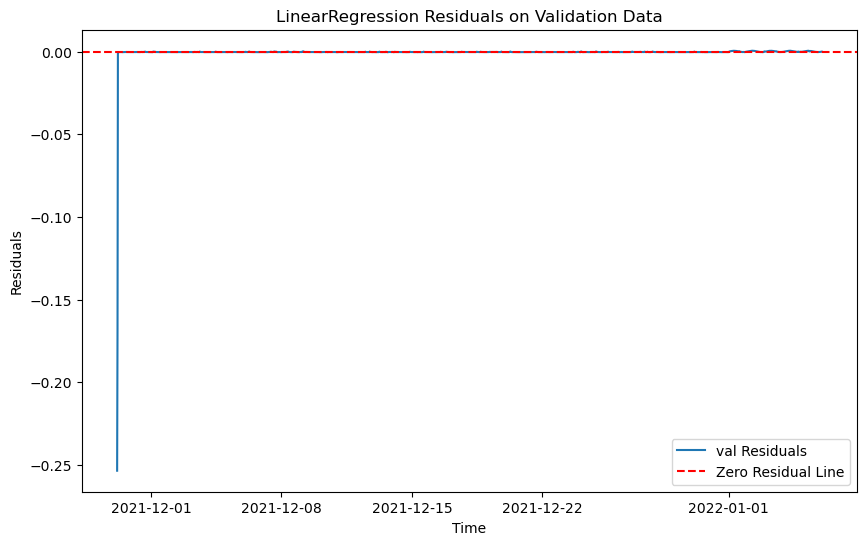

RMSE on training data for LinearRegression: 0.004252779010308209
RMSE on validation data for LinearRegression: 0.007159135034454677
RMSE on test data for LinearRegression: 0.005954066359210884

Best model is LinearRegression with RMSE: 0.007159135034454677
Best model saved as: models\model_495.pkl
data num 85
train_498.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


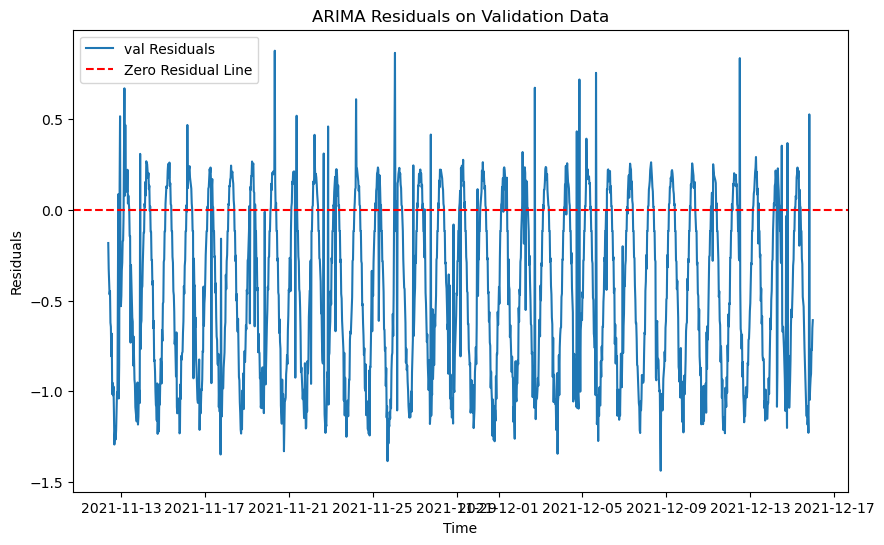

RMSE on training data for ARIMA: 0.24644337554610127
RMSE on validation data for ARIMA: 0.6568466891316843
RMSE on test data for ARIMA: 0.5534454699315116


21:52:34 - cmdstanpy - INFO - Chain [1] start processing
21:52:34 - cmdstanpy - INFO - Chain [1] done processing


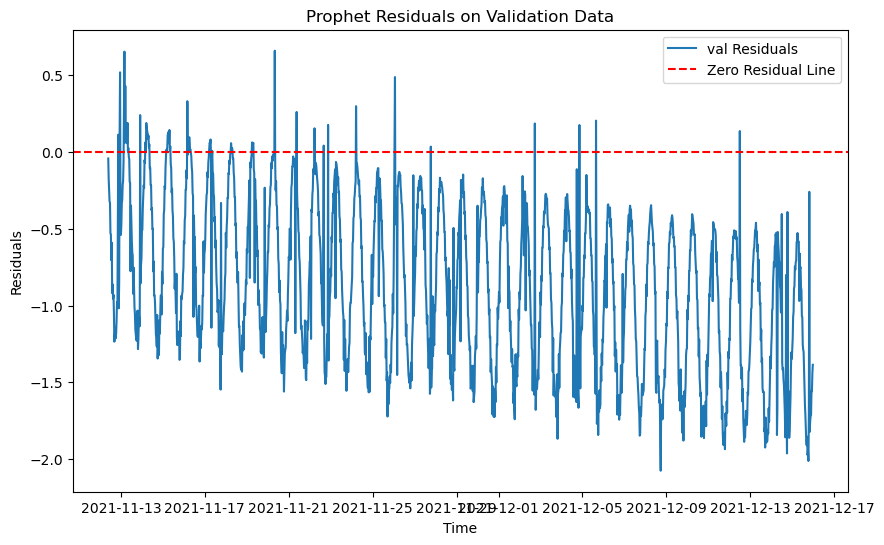

RMSE on training data for Prophet: 0.2072246633391084
RMSE on validation data for Prophet: 1.0145004873943206
RMSE on test data for Prophet: 0.9735349726246859


<Figure size 1000x800 with 0 Axes>

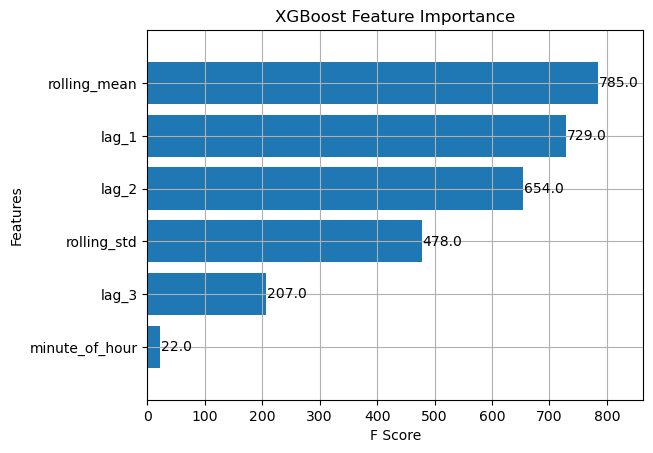

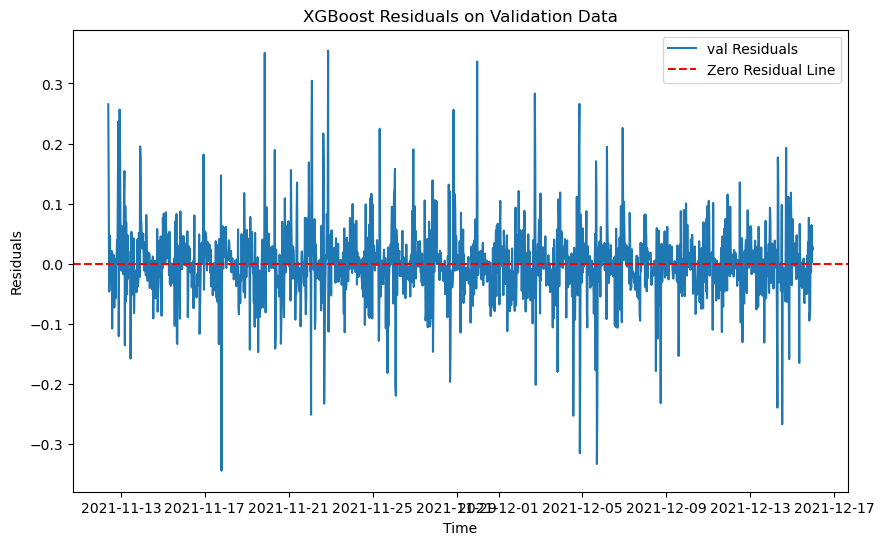

RMSE on training data for XGBoost: 0.03647429393438573
RMSE on validation data for XGBoost: 0.0611601777236062
RMSE on test data for XGBoost: 0.05377021807096021


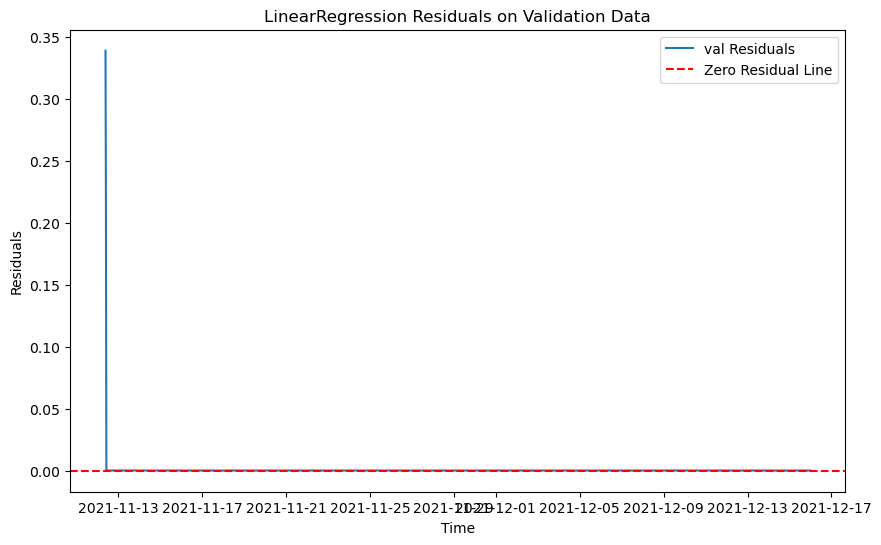

RMSE on training data for LinearRegression: 0.002313118131923448
RMSE on validation data for LinearRegression: 0.009924236341695612
RMSE on test data for LinearRegression: 0.005039462395246014

Best model is LinearRegression with RMSE: 0.009924236341695612
Best model saved as: models\model_498.pkl
data num 86
train_499.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.2740023613911522e-12
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.602419277677893e-08
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.924117746004849e-07
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

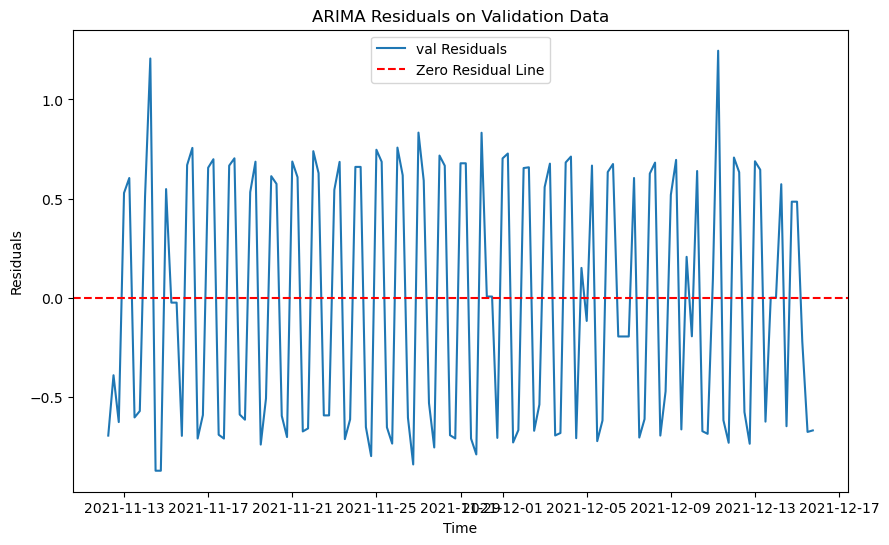

21:52:39 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.4461071378804954
RMSE on validation data for ARIMA: 0.6394010751401106
RMSE on test data for ARIMA: 0.6989259773815605


21:52:39 - cmdstanpy - INFO - Chain [1] done processing


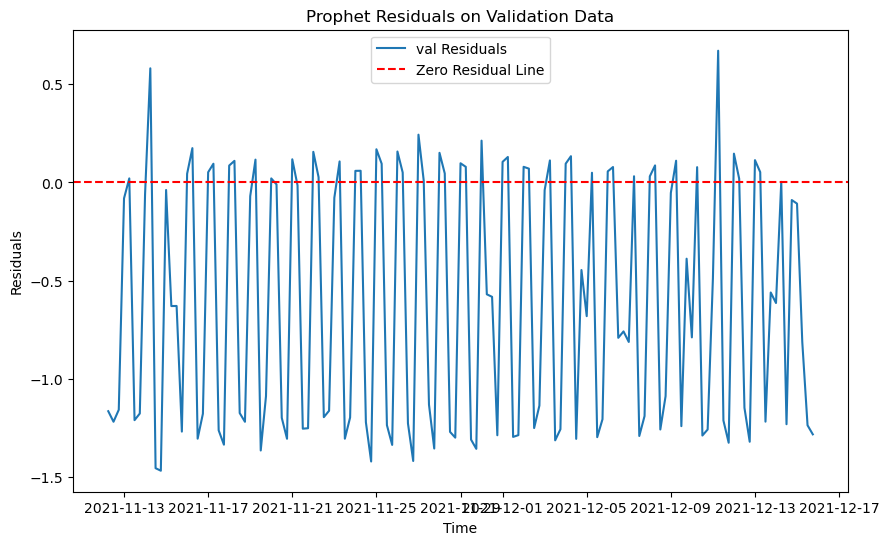

RMSE on training data for Prophet: 0.28731880141682875
RMSE on validation data for Prophet: 0.8792053499561266
RMSE on test data for Prophet: 0.906224561157782


<Figure size 1000x800 with 0 Axes>

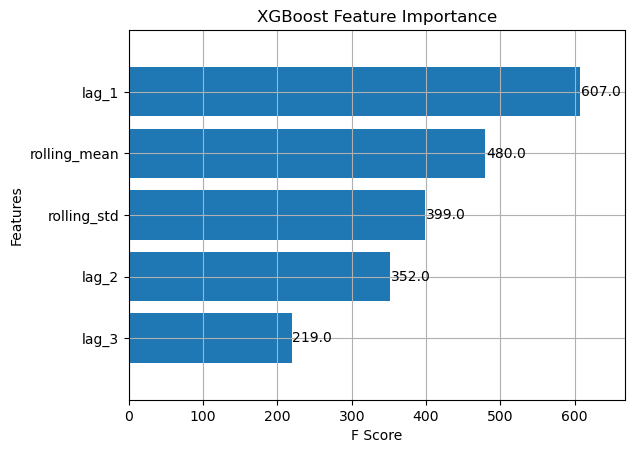

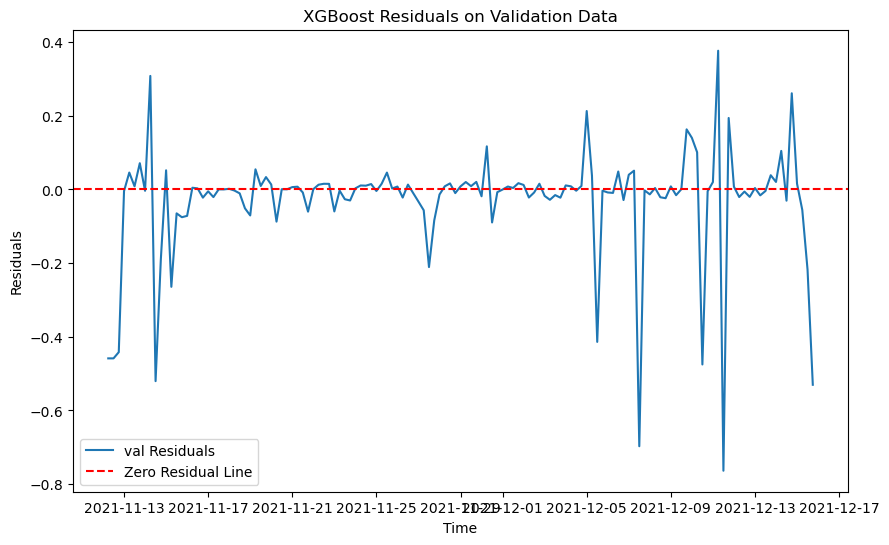

RMSE on training data for XGBoost: 0.058598386893206386
RMSE on validation data for XGBoost: 0.15877171201373608
RMSE on test data for XGBoost: 0.2389868849476352


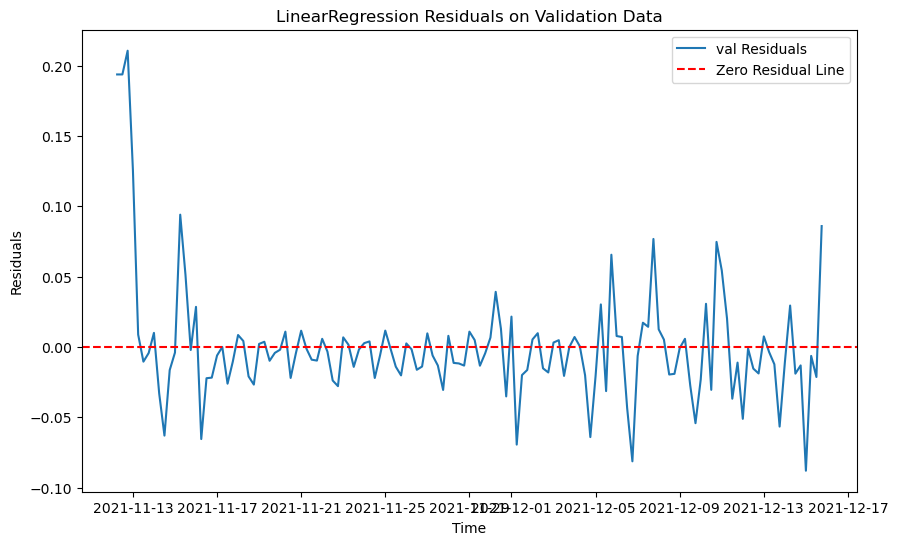

RMSE on training data for LinearRegression: 0.09221585829205135
RMSE on validation data for LinearRegression: 0.04257754062291464
RMSE on test data for LinearRegression: 0.09341943384628712

Best model is LinearRegression with RMSE: 0.04257754062291464
Best model saved as: models\model_499.pkl
data num 87
train_505.csv
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 1.3580782358000683e-12
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 2.18697310408286e-08
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

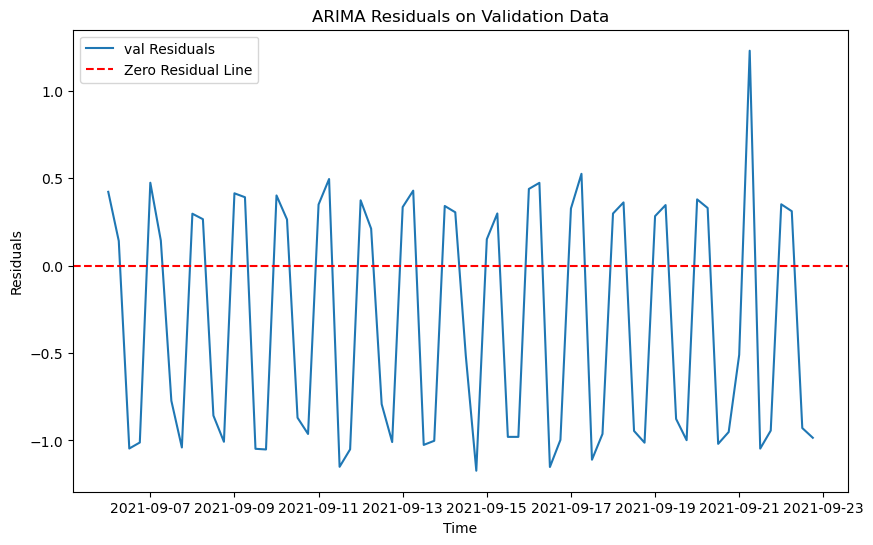

21:52:41 - cmdstanpy - INFO - Chain [1] start processing
21:52:41 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3838701279325082
RMSE on validation data for ARIMA: 0.7561088805058019
RMSE on test data for ARIMA: 0.7534429525620722


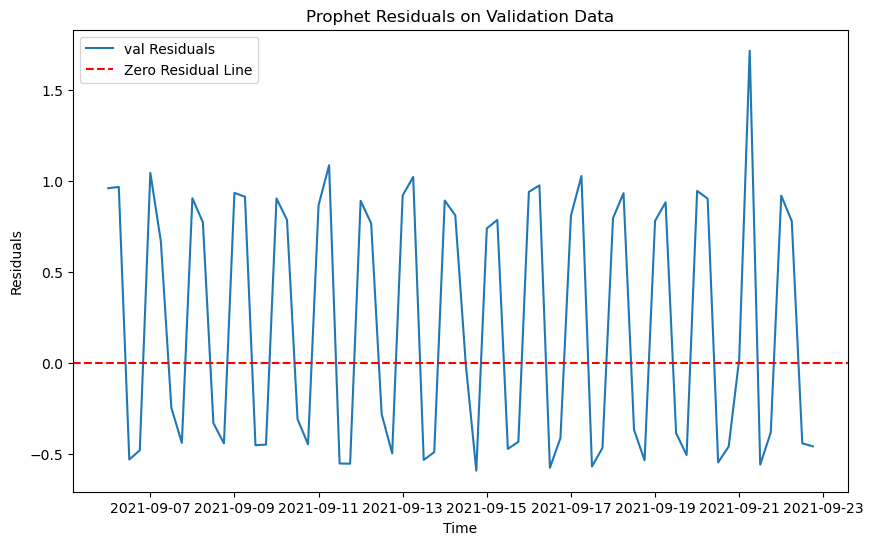

RMSE on training data for Prophet: 0.22332175332447143
RMSE on validation data for Prophet: 0.72373242964119
RMSE on test data for Prophet: 0.7146601581267508


<Figure size 1000x800 with 0 Axes>

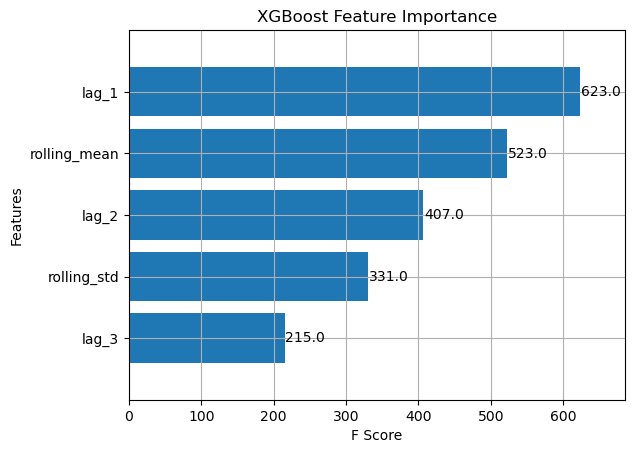

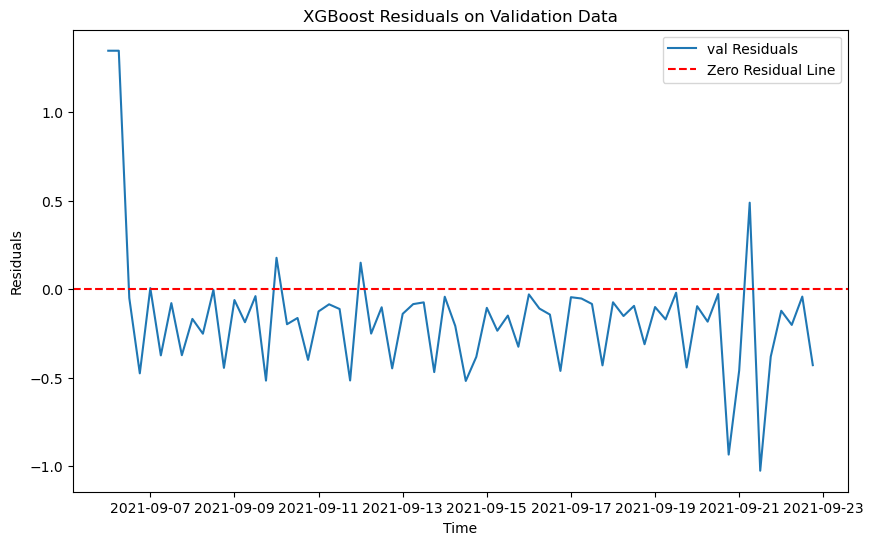

RMSE on training data for XGBoost: 0.034802647701323346
RMSE on validation data for XGBoost: 0.38606467519182786
RMSE on test data for XGBoost: 0.4260156093969538


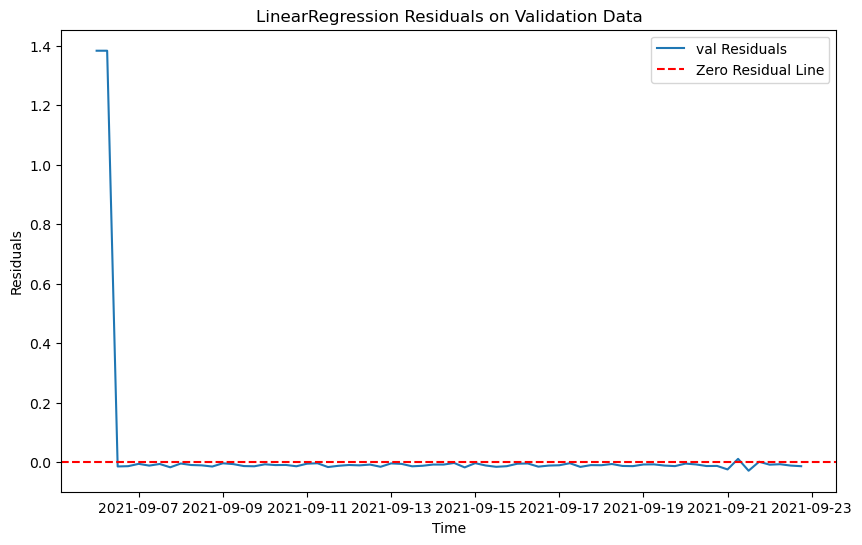

RMSE on training data for LinearRegression: 0.043710351994459704
RMSE on validation data for LinearRegression: 0.23755579894313028
RMSE on test data for LinearRegression: 0.15125236006079612

Best model is LinearRegression with RMSE: 0.23755579894313028
Best model saved as: models\model_505.pkl
data num 88
train_506.csv
The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.0001673999622407969
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

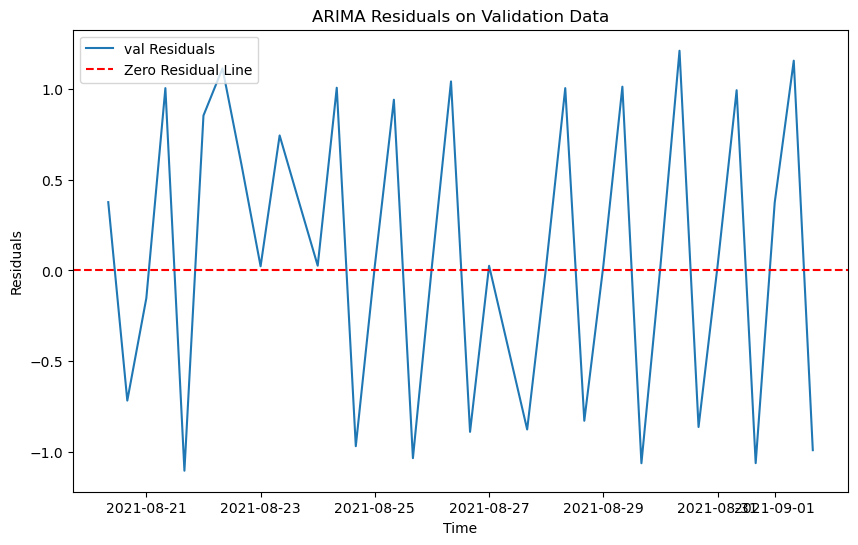

21:52:43 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.61397018790277
RMSE on validation data for ARIMA: 0.7842769279793915
RMSE on test data for ARIMA: 1.3177696929977225


21:52:43 - cmdstanpy - INFO - Chain [1] done processing


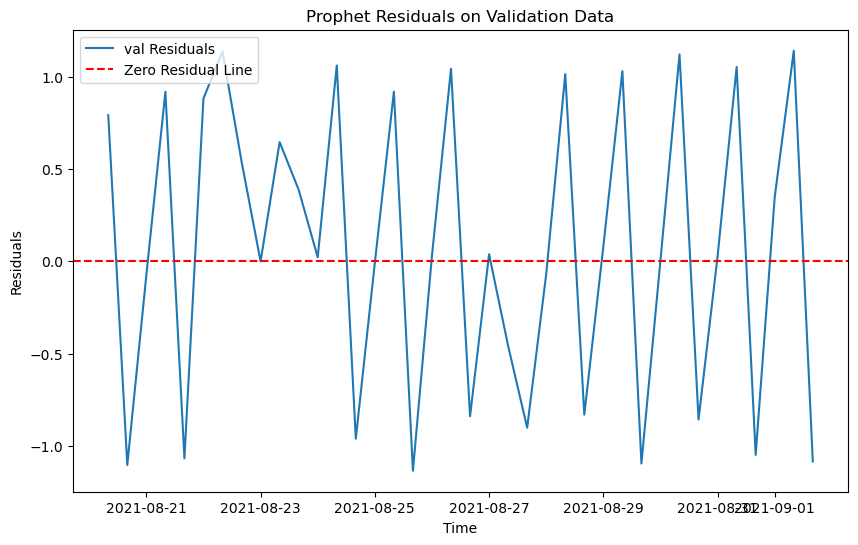

RMSE on training data for Prophet: 0.2857374056921228
RMSE on validation data for Prophet: 0.8030218641774506
RMSE on test data for Prophet: 1.3165019302595122


<Figure size 1000x800 with 0 Axes>

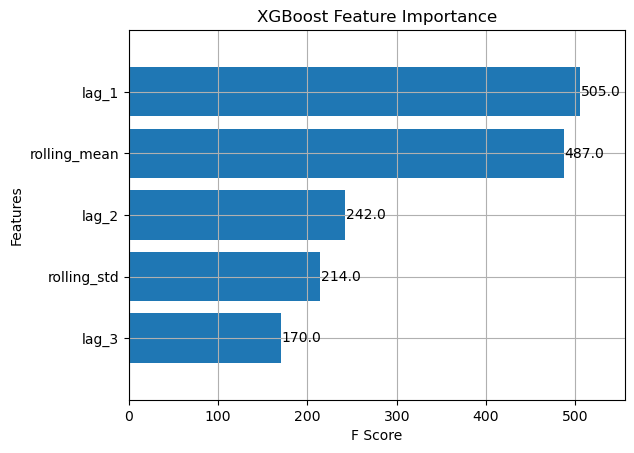

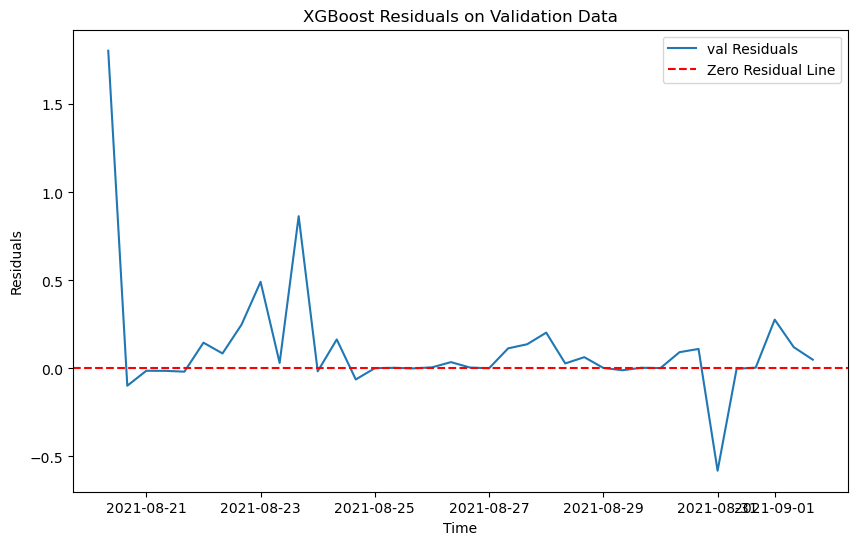

RMSE on training data for XGBoost: 0.06452434719080605
RMSE on validation data for XGBoost: 0.3595408617513695
RMSE on test data for XGBoost: 0.8192096099056645


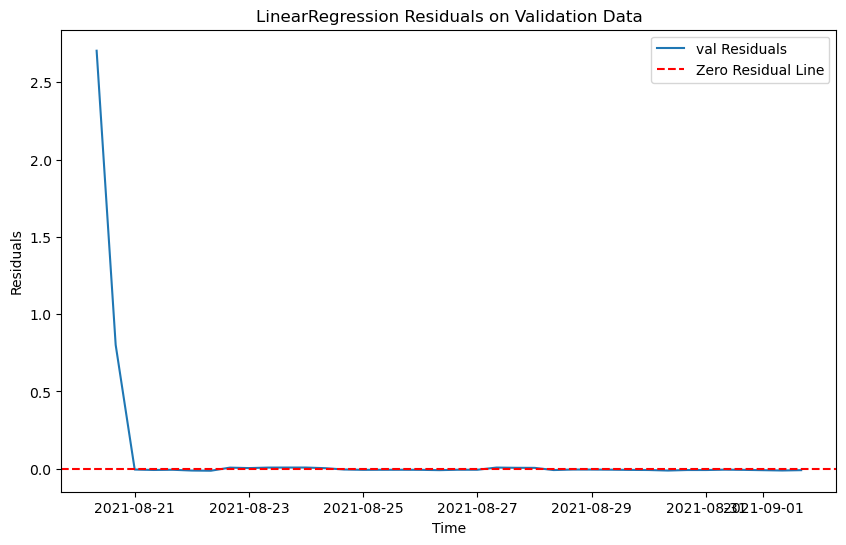

RMSE on training data for LinearRegression: 0.08454795150607805
RMSE on validation data for LinearRegression: 0.4575385958067627
RMSE on test data for LinearRegression: 0.4647435706662975

Best model is XGBoost with RMSE: 0.3595408617513695
Best model saved as: models\model_506.pkl
data num 89
train_507.csv
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

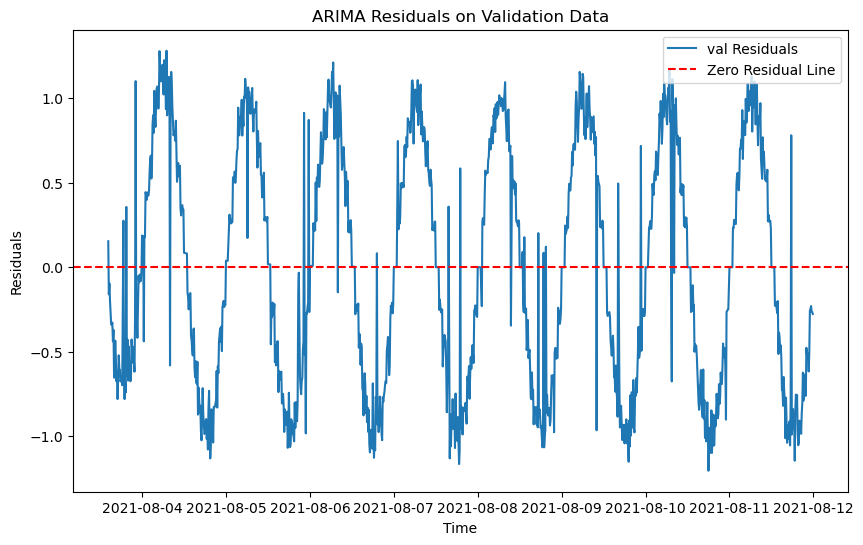

21:52:49 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.2634197224017003
RMSE on validation data for ARIMA: 0.6992688630540007
RMSE on test data for ARIMA: 0.712863417474842


21:52:49 - cmdstanpy - INFO - Chain [1] done processing


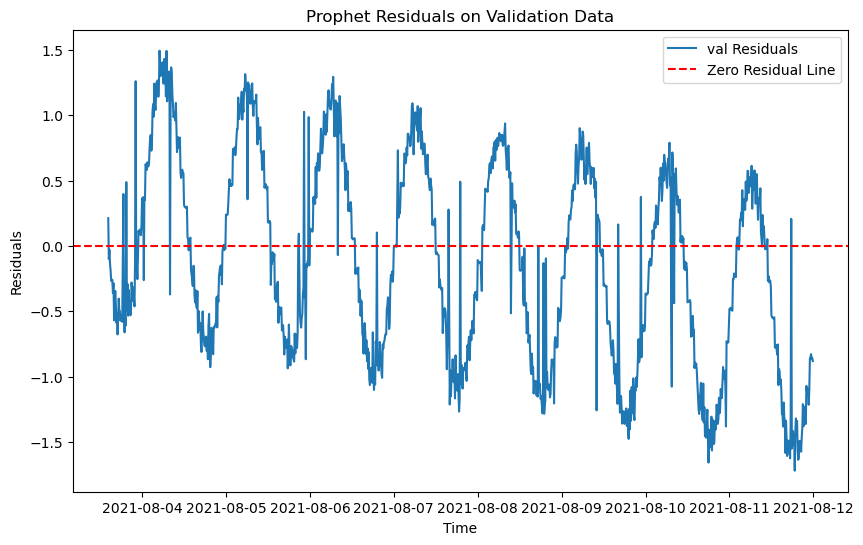

RMSE on training data for Prophet: 0.2284803882197134
RMSE on validation data for Prophet: 0.7737927566066901
RMSE on test data for Prophet: 1.180468281390102


<Figure size 1000x800 with 0 Axes>

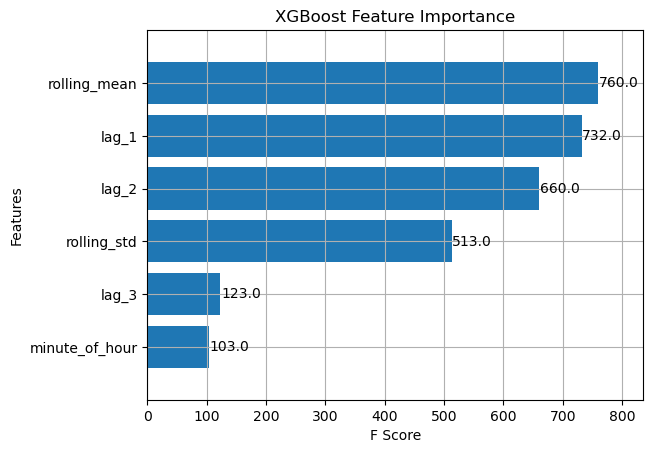

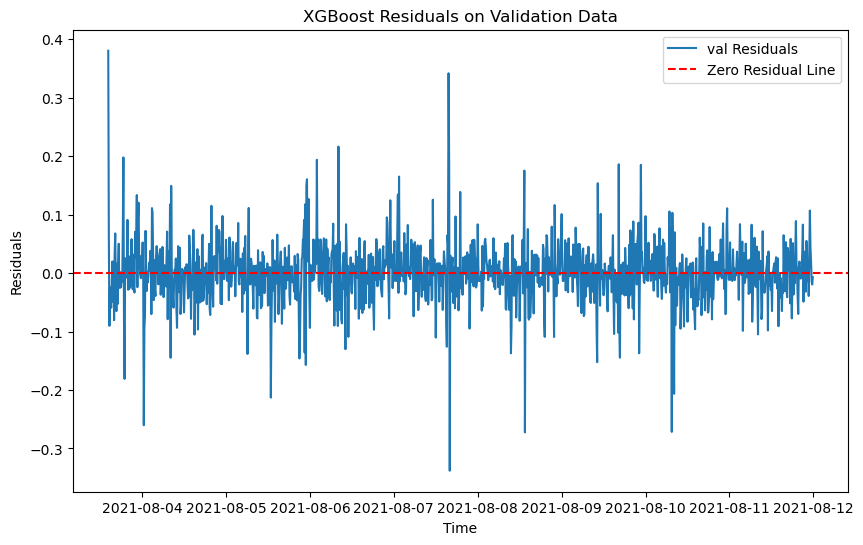

RMSE on training data for XGBoost: 0.037395543925067005
RMSE on validation data for XGBoost: 0.05312620020772489
RMSE on test data for XGBoost: 0.05999965014134577


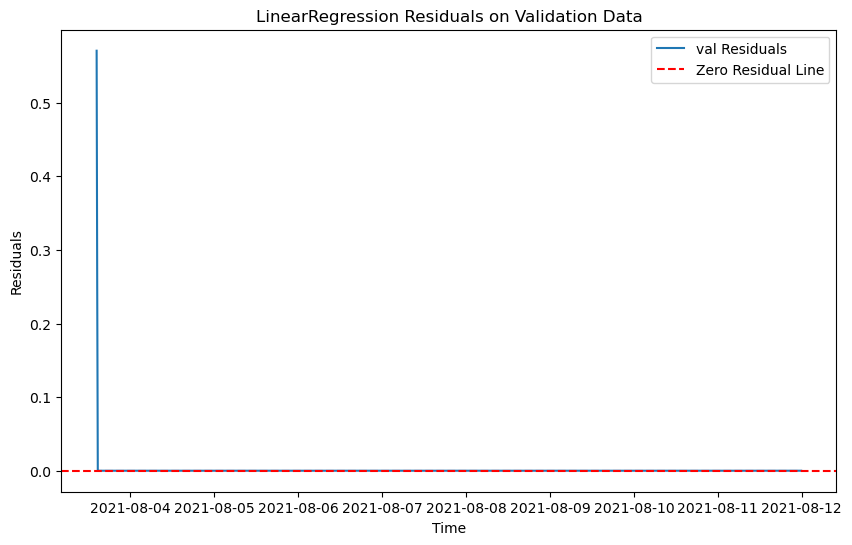

RMSE on training data for LinearRegression: 7.873472096675302e-15
RMSE on validation data for LinearRegression: 0.017919462705018943
RMSE on test data for LinearRegression: 7.838282708959503e-15

Best model is LinearRegression with RMSE: 0.017919462705018943
Best model saved as: models\model_507.pkl
data num 90
train_66.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 0.002466349359570113
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

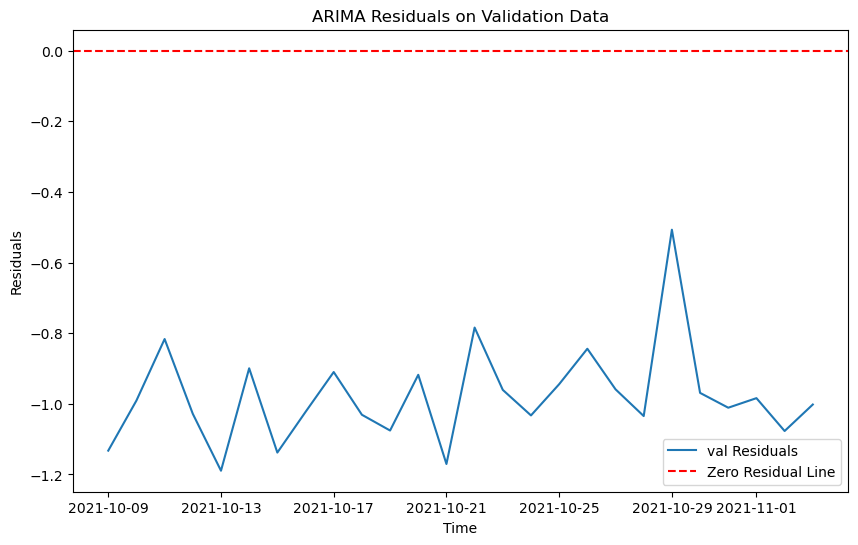

21:52:53 - cmdstanpy - INFO - Chain [1] start processing
21:52:53 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.5864147788086986
RMSE on validation data for ARIMA: 0.9876725134902464
RMSE on test data for ARIMA: 0.9407005204378632


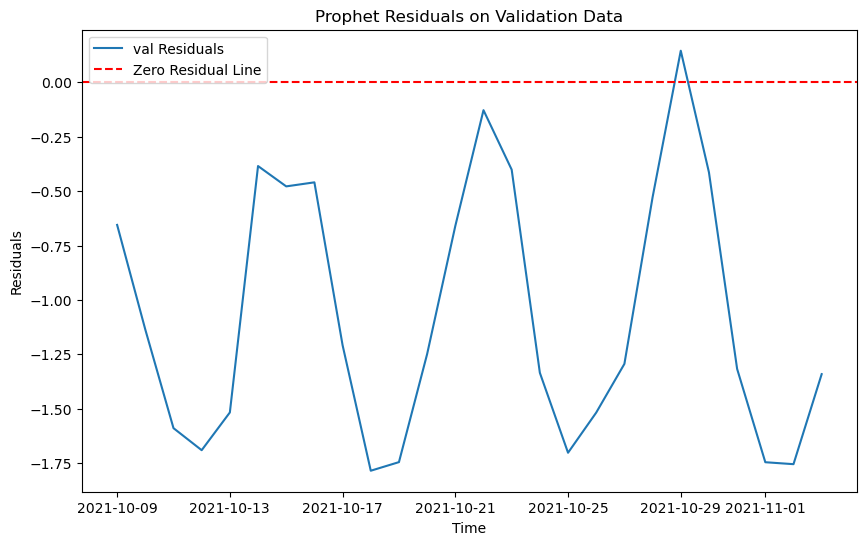

RMSE on training data for Prophet: 0.3525052087826791
RMSE on validation data for Prophet: 1.2189391417698658
RMSE on test data for Prophet: 1.1326785455366364


<Figure size 1000x800 with 0 Axes>

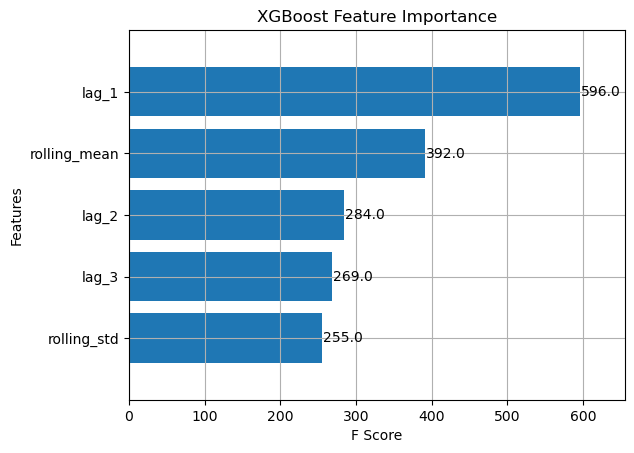

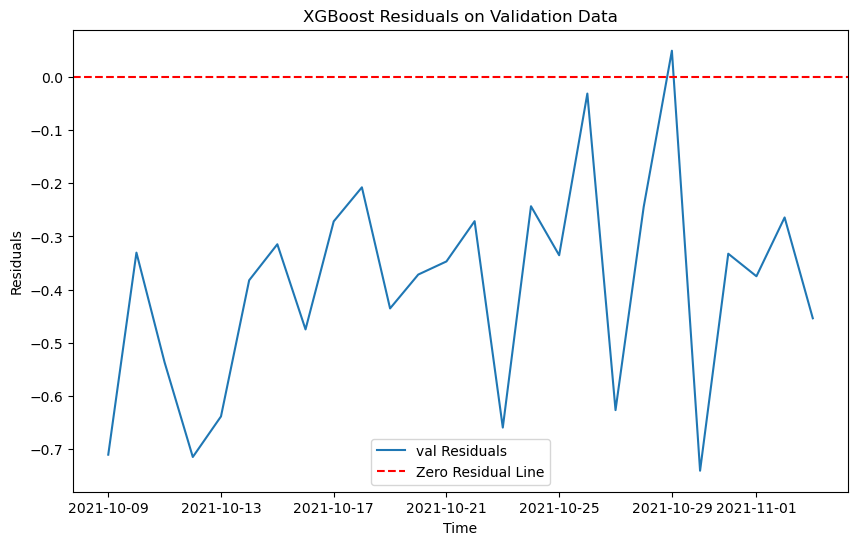

RMSE on training data for XGBoost: 0.012167668137584802
RMSE on validation data for XGBoost: 0.44143584030055577
RMSE on test data for XGBoost: 0.4823644231944947


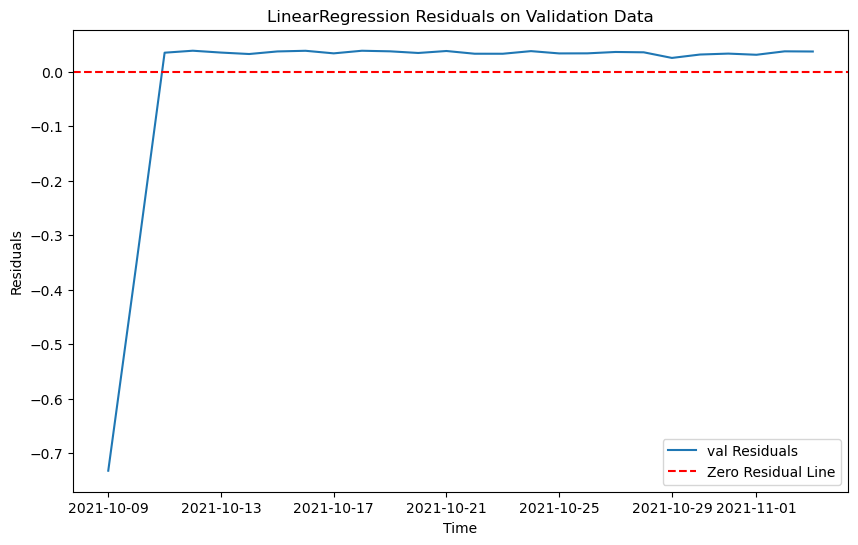

RMSE on training data for LinearRegression: 0.01741558789116548
RMSE on validation data for LinearRegression: 0.16285209489681443
RMSE on test data for LinearRegression: 0.04549878277876467

Best model is LinearRegression with RMSE: 0.16285209489681443
Best model saved as: models\model_66.pkl
data num 91
train_74.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.
The differenced time series is stationary.
The time series is not stationary. Applying differencing 0


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

New p-value after differencing: 1.5711087596951554e-26
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 30min will be used.
  self._init_dates(dates, freq)


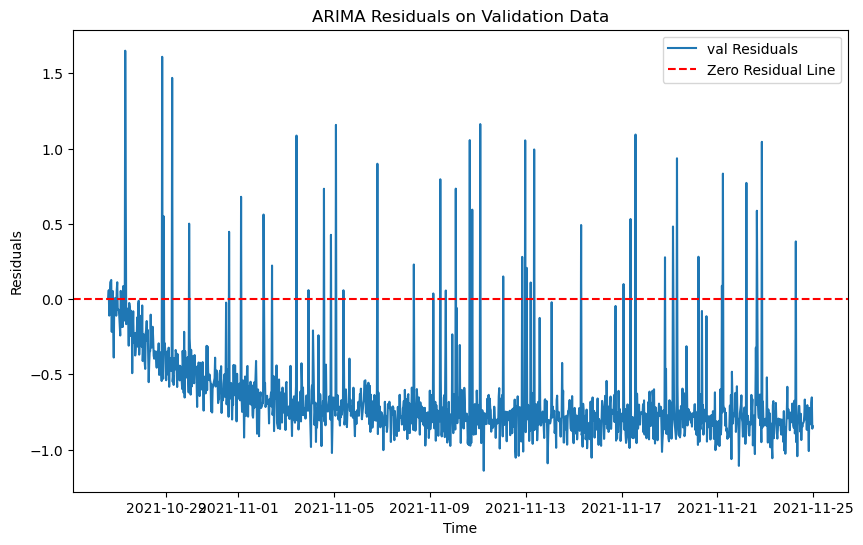

21:52:58 - cmdstanpy - INFO - Chain [1] start processing


RMSE on training data for ARIMA: 0.25623019959323934
RMSE on validation data for ARIMA: 0.7298436894118606
RMSE on test data for ARIMA: 0.4257231586952526


21:52:58 - cmdstanpy - INFO - Chain [1] done processing


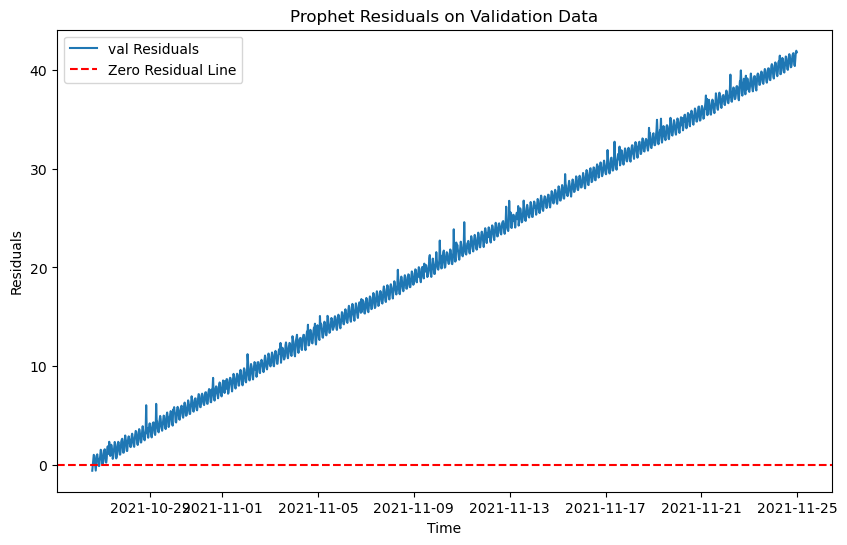

RMSE on training data for Prophet: 0.40005178072835706
RMSE on validation data for Prophet: 23.942597646225835
RMSE on test data for Prophet: 51.87713063267518


<Figure size 1000x800 with 0 Axes>

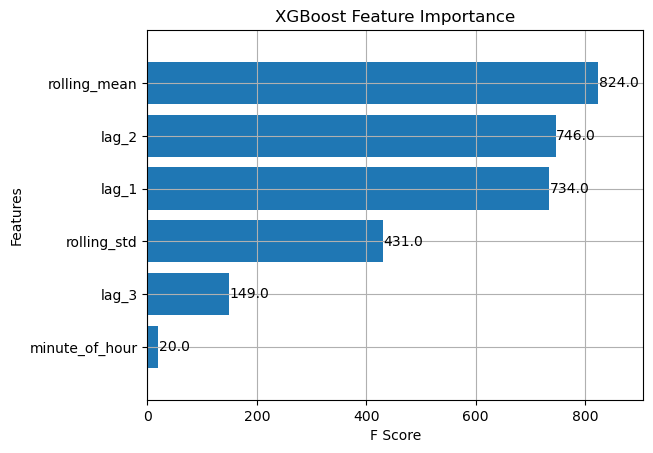

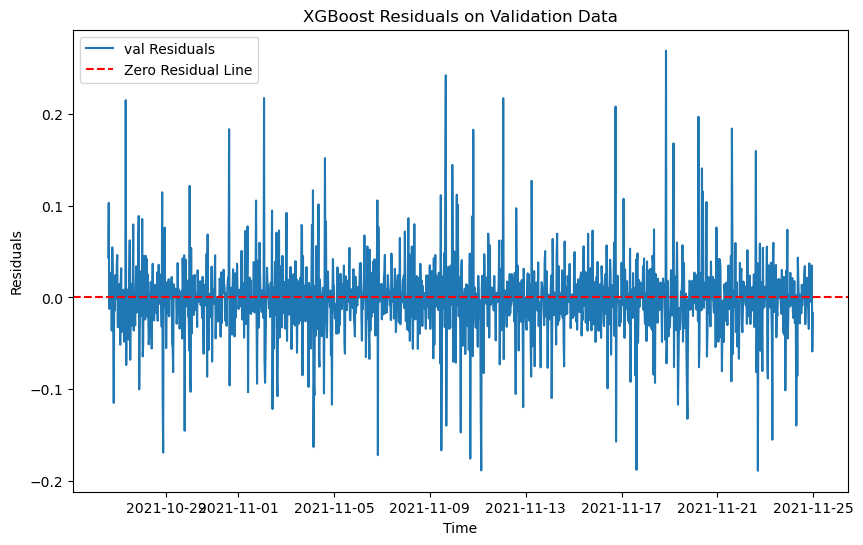

RMSE on training data for XGBoost: 0.03700784905497203
RMSE on validation data for XGBoost: 0.04351870275544632
RMSE on test data for XGBoost: 0.1863769195648247


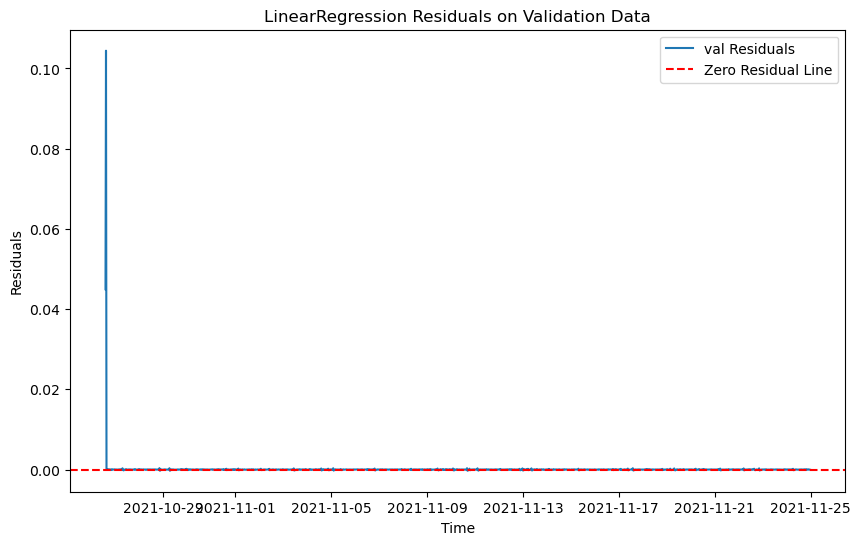

RMSE on training data for LinearRegression: 0.0034769430290543966
RMSE on validation data for LinearRegression: 0.0030259768979559857
RMSE on test data for LinearRegression: 0.00011876668811281268

Best model is LinearRegression with RMSE: 0.0030259768979559857
Best model saved as: models\model_74.pkl
data num 92
train_75.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 7.928067790863645e-18
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

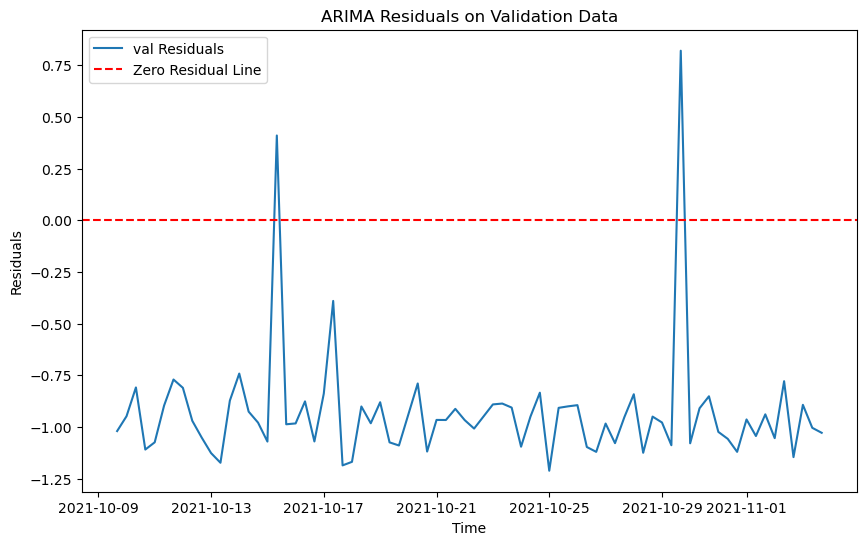

21:53:03 - cmdstanpy - INFO - Chain [1] start processing
21:53:03 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.39452184785897115
RMSE on validation data for ARIMA: 0.9736940858935843
RMSE on test data for ARIMA: 0.9748900813018145


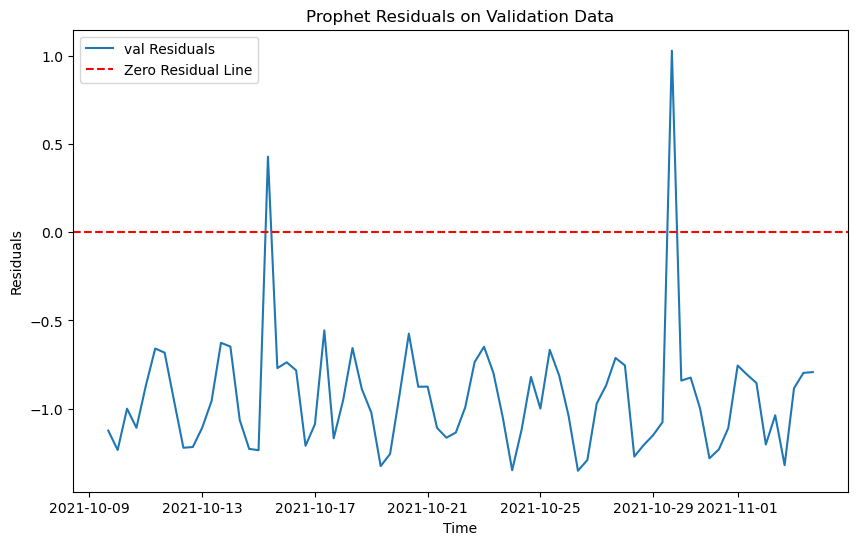

RMSE on training data for Prophet: 0.3940890800269556
RMSE on validation data for Prophet: 0.9972984003958596
RMSE on test data for Prophet: 0.9963395677445002


<Figure size 1000x800 with 0 Axes>

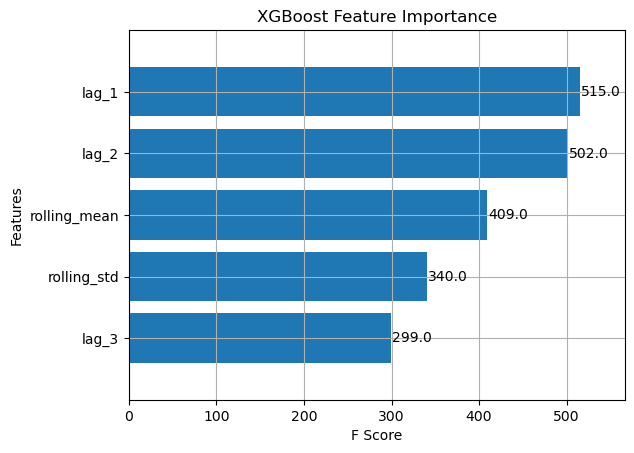

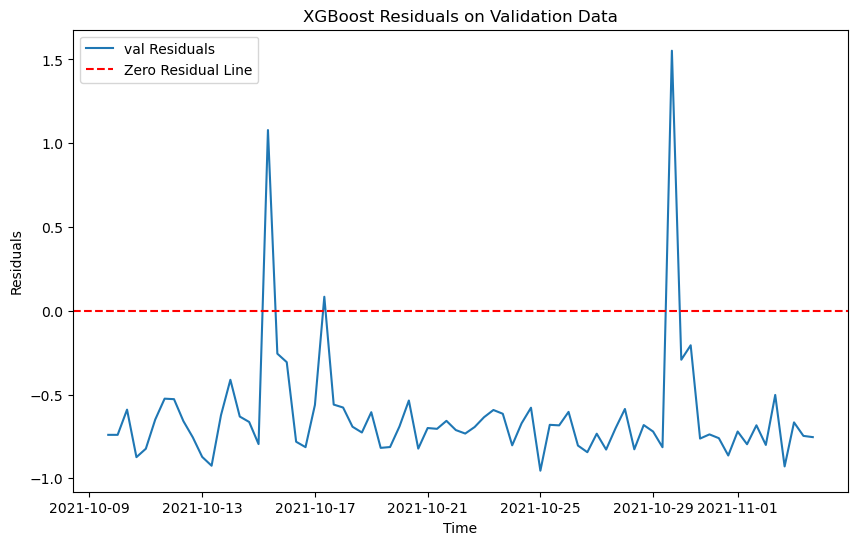

RMSE on training data for XGBoost: 0.01566293495858083
RMSE on validation data for XGBoost: 0.7222794651226354
RMSE on test data for XGBoost: 0.7373658915214284


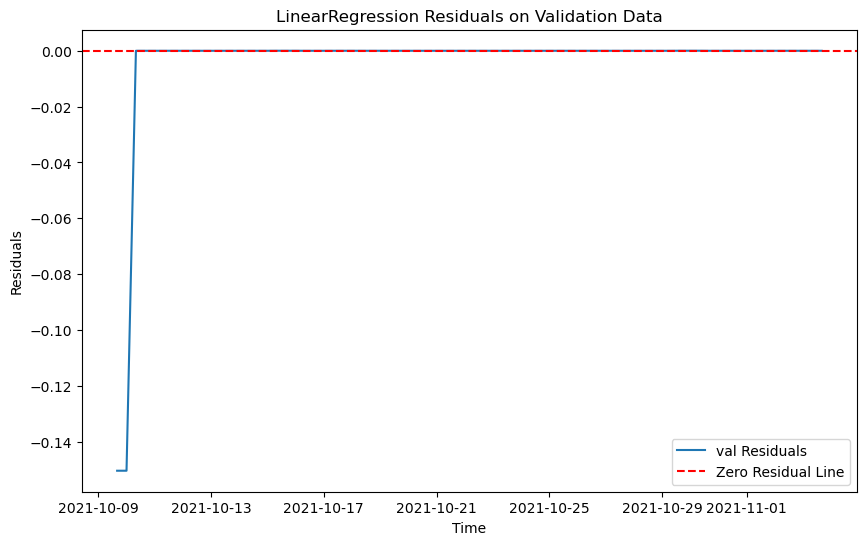

RMSE on training data for LinearRegression: 3.9992172818553555e-05
RMSE on validation data for LinearRegression: 0.024403292024288824
RMSE on test data for LinearRegression: 0.010326399433663772

Best model is LinearRegression with RMSE: 0.024403292024288824
Best model saved as: models\model_75.pkl
data num 93
train_79.csv
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

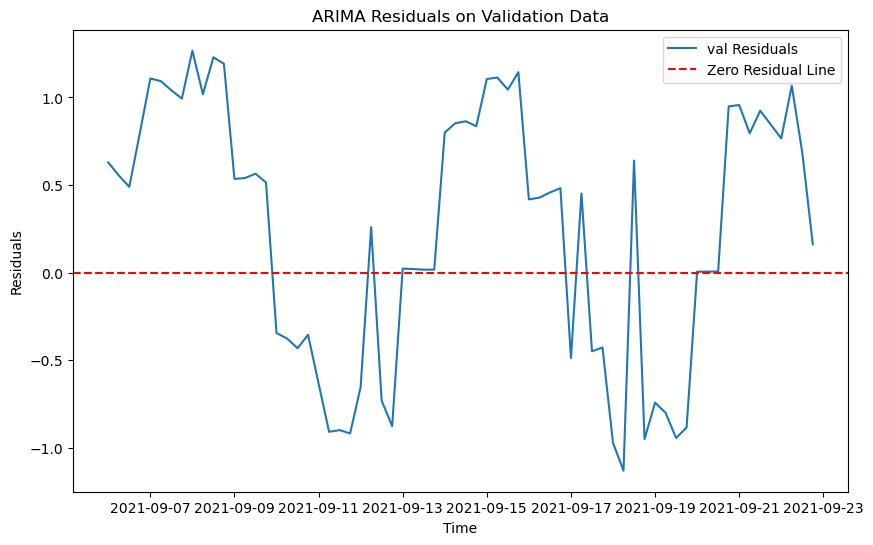

21:53:04 - cmdstanpy - INFO - Chain [1] start processing
21:53:04 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.3754554221797084
RMSE on validation data for ARIMA: 0.7669739038807504
RMSE on test data for ARIMA: 0.937597295251897


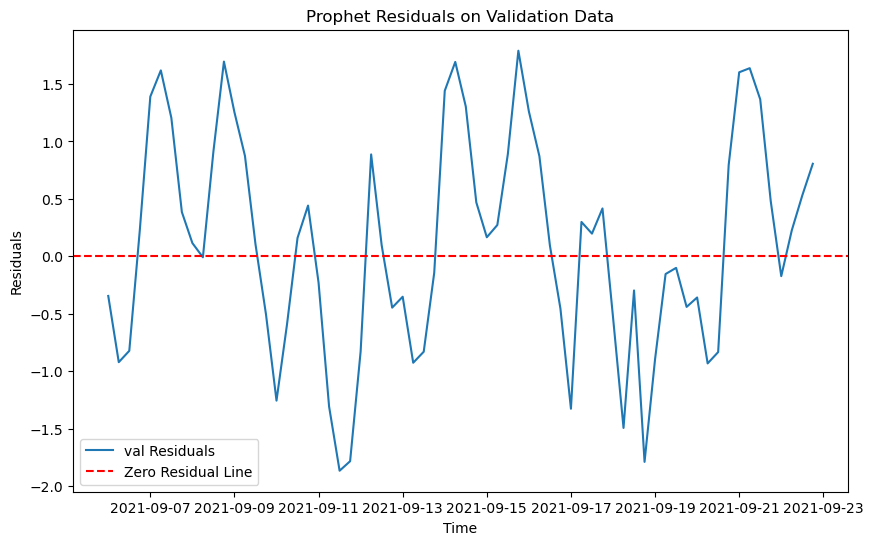

RMSE on training data for Prophet: 0.255180506554419
RMSE on validation data for Prophet: 0.9492098723798854
RMSE on test data for Prophet: 1.1785538719125668


<Figure size 1000x800 with 0 Axes>

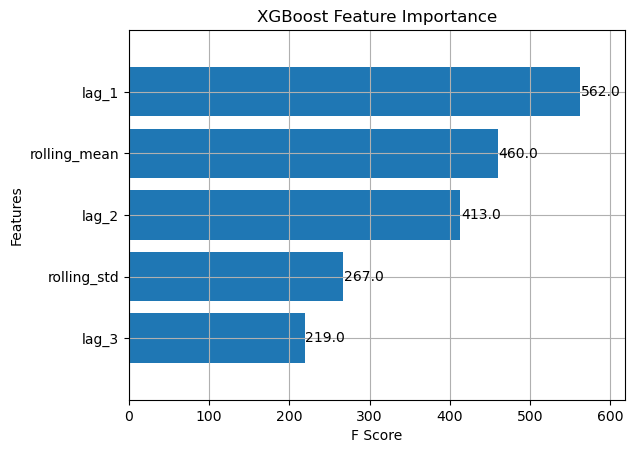

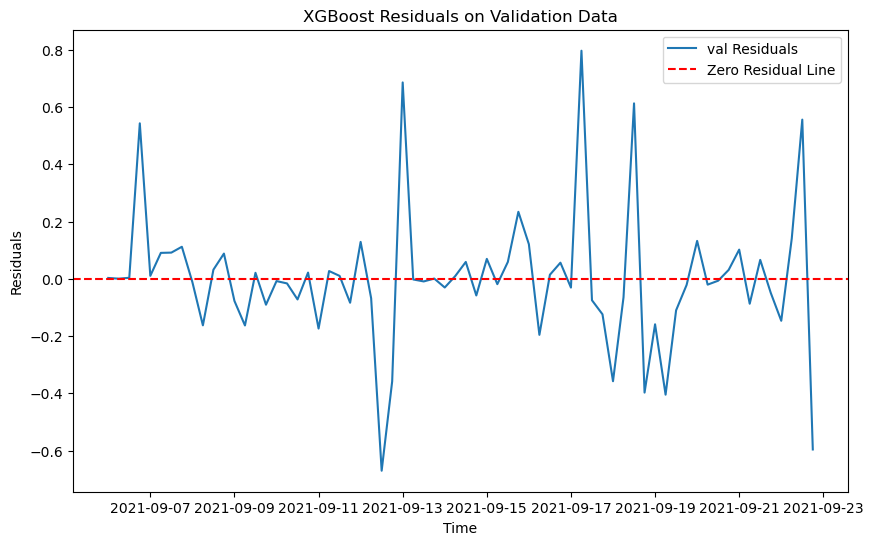

RMSE on training data for XGBoost: 0.017144202397466897
RMSE on validation data for XGBoost: 0.23993299807346935
RMSE on test data for XGBoost: 0.22972613112373505


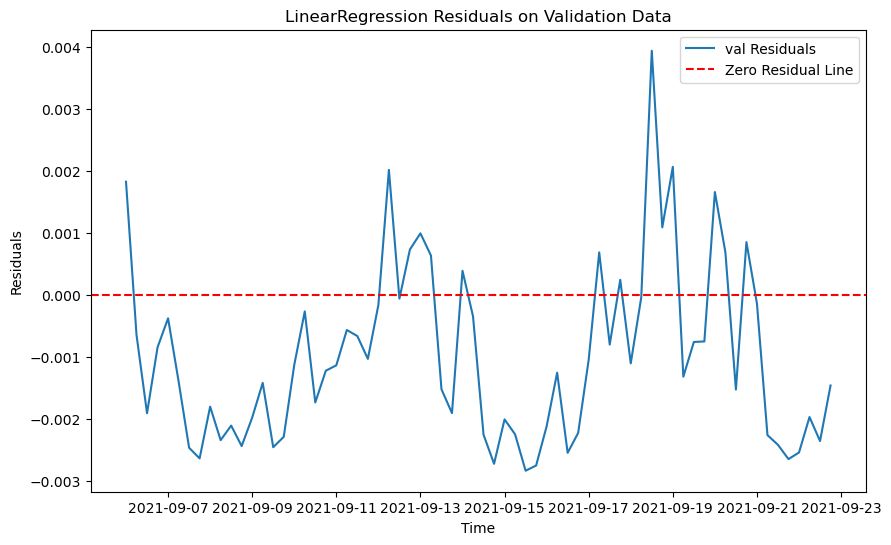

RMSE on training data for LinearRegression: 0.012617374223340066
RMSE on validation data for LinearRegression: 0.0017394646037848082
RMSE on test data for LinearRegression: 0.15564333918105605

Best model is LinearRegression with RMSE: 0.0017394646037848082
Best model saved as: models\model_79.pkl
data num 94
train_9.csv


C:\Windows\Temp\ipykernel_20040\904417940.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop('anomaly', axis=1, inplace=True)
C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['minute_of_hour'] = df.index.minute
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[f'lag_{lag}'] = df['value'].shift(lag)
C:\Windows\Temp\ipykernel_20040\685240870.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\685240870.py:23: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='bfill', inplace=True)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency 10min will be used.
  self._init_dates(dates, freq)
C:\Users\mohamed\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive 

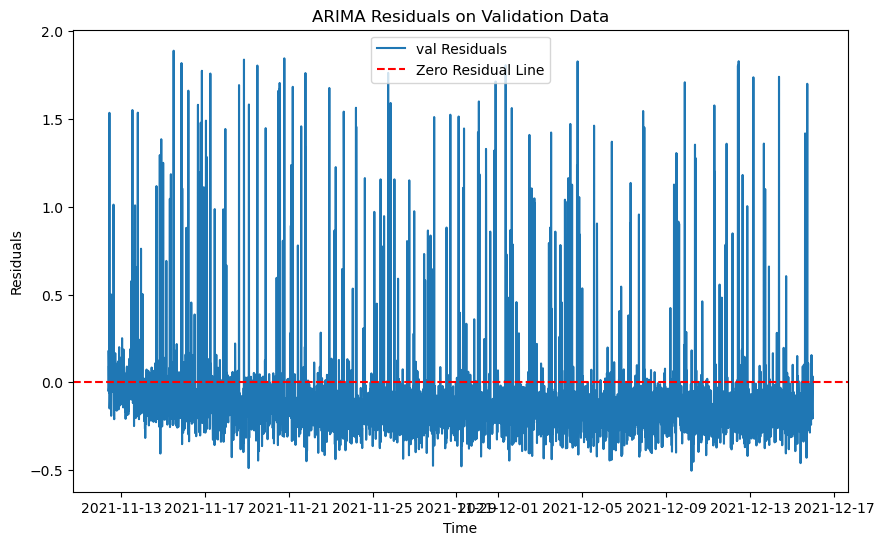

RMSE on training data for ARIMA: 0.24583794394705497
RMSE on validation data for ARIMA: 0.28869840670186225
RMSE on test data for ARIMA: 0.8746244256854737


21:53:25 - cmdstanpy - INFO - Chain [1] start processing
21:53:31 - cmdstanpy - INFO - Chain [1] done processing


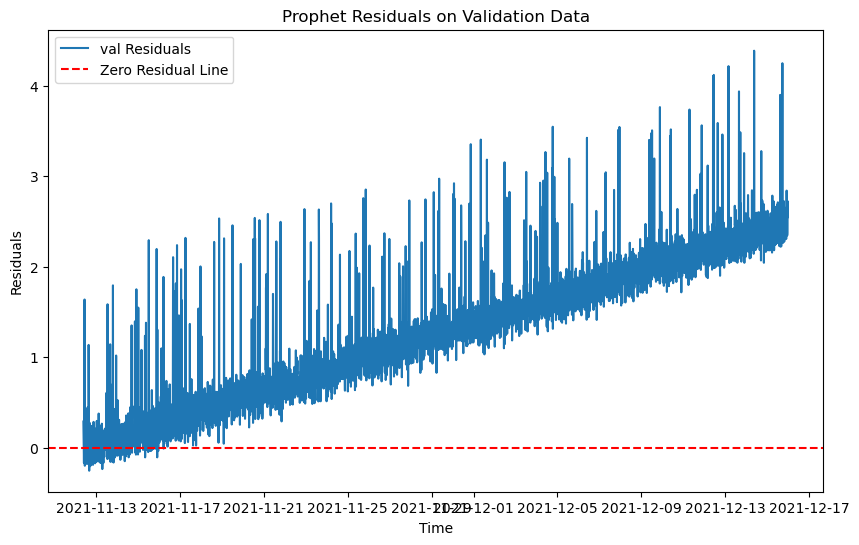

RMSE on training data for Prophet: 0.25885298184972105
RMSE on validation data for Prophet: 1.4902916286777368
RMSE on test data for Prophet: 3.8976348473949116


<Figure size 1000x800 with 0 Axes>

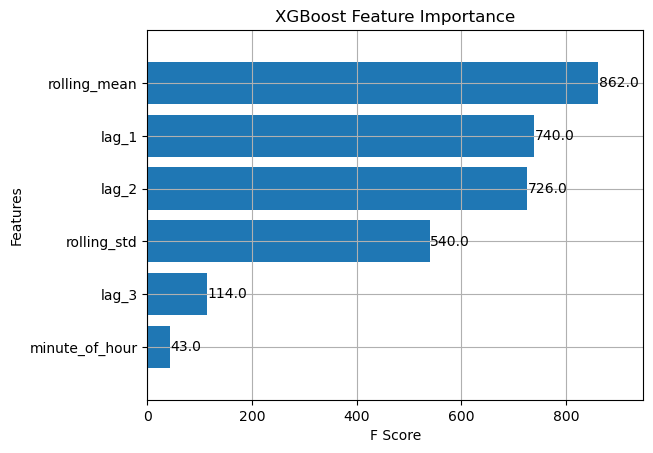

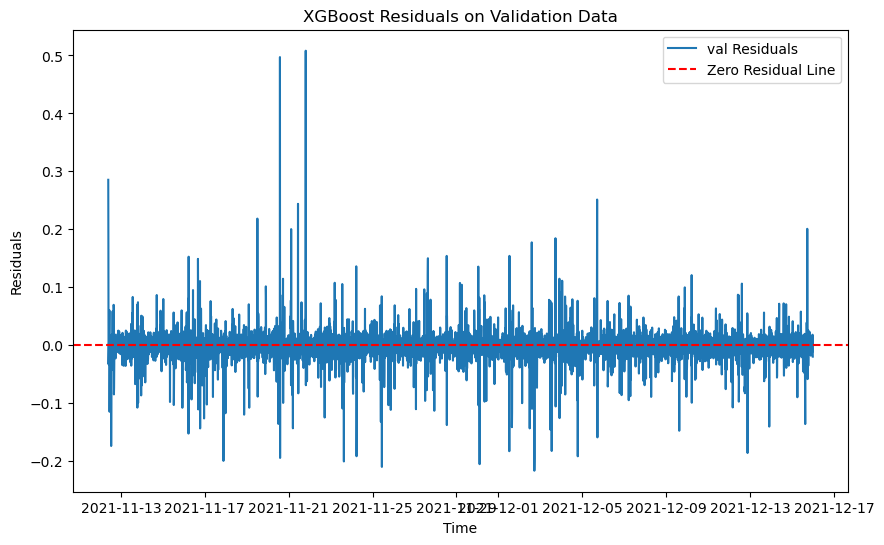

RMSE on training data for XGBoost: 0.027267473272201602
RMSE on validation data for XGBoost: 0.030709800396028077
RMSE on test data for XGBoost: 0.6256124742873085


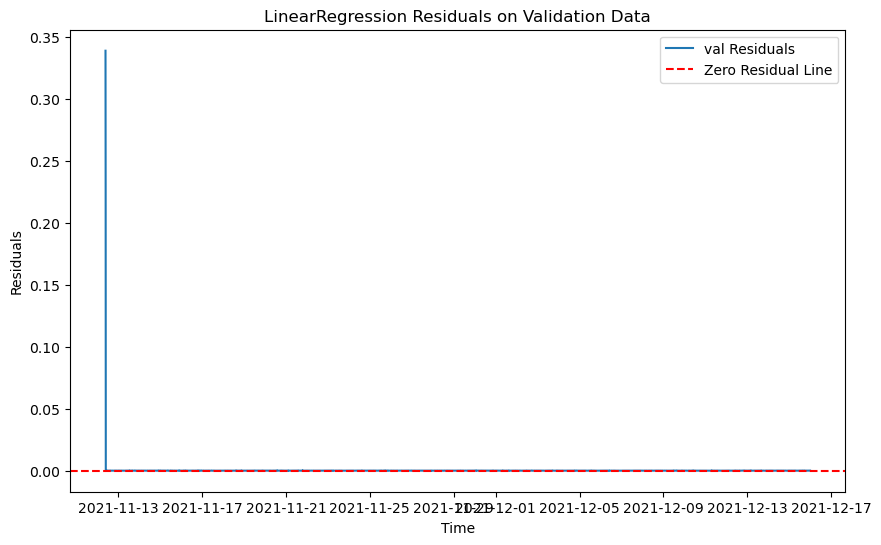

RMSE on training data for LinearRegression: 0.001774512705855682
RMSE on validation data for LinearRegression: 0.005851655919908474
RMSE on test data for LinearRegression: 0.0019684422865375597

Best model is LinearRegression with RMSE: 0.005851655919908474
Best model saved as: models\model_9.pkl
data num 95
train_92.csv
The time series is not stationary. Applying differencing 0
New p-value after differencing: 6.340565760113121e-28
The differenced time series is stationary.
The differenced time series is stationary.
The differenced time series is stationary.


C:\Windows\Temp\ipykernel_20040\904417940.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['timestamp'] = pd.to_datetime(df['timestamp'])
C:\Windows\Temp\ipykernel_20040\904417940.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['value'] = df['value'].interpolate(method='linear')
C:\Windows\Temp\ipykernel_20040\904417940.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

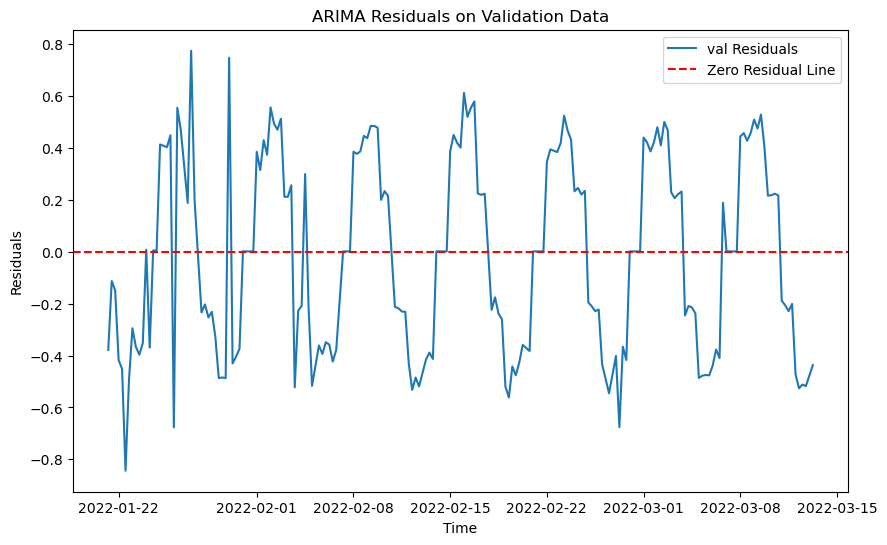

21:53:42 - cmdstanpy - INFO - Chain [1] start processing
21:53:42 - cmdstanpy - INFO - Chain [1] done processing


RMSE on training data for ARIMA: 0.23365580079593412
RMSE on validation data for ARIMA: 0.37261666778170804
RMSE on test data for ARIMA: 0.5882797446449252


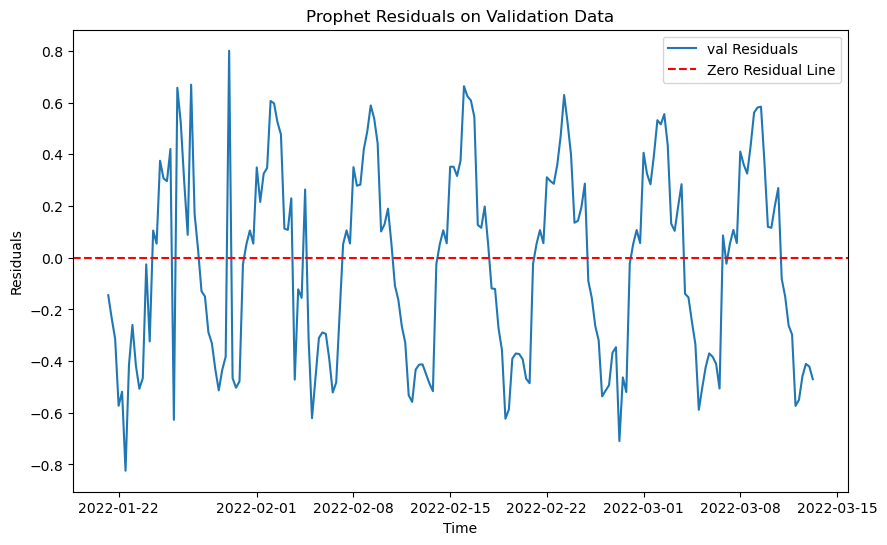

RMSE on training data for Prophet: 0.24330138105400273
RMSE on validation data for Prophet: 0.3774861943427184
RMSE on test data for Prophet: 0.5899554864894296


<Figure size 1000x800 with 0 Axes>

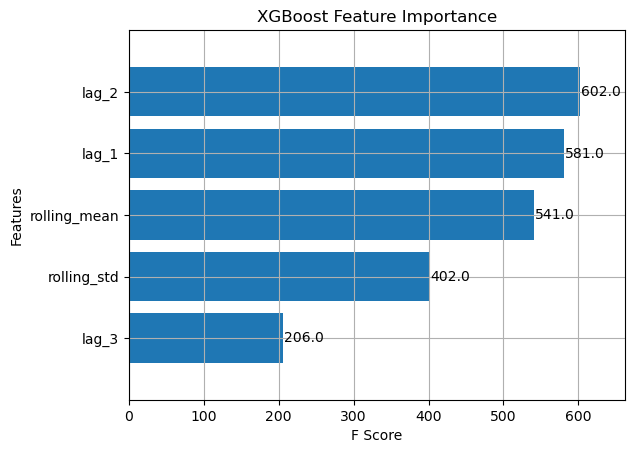

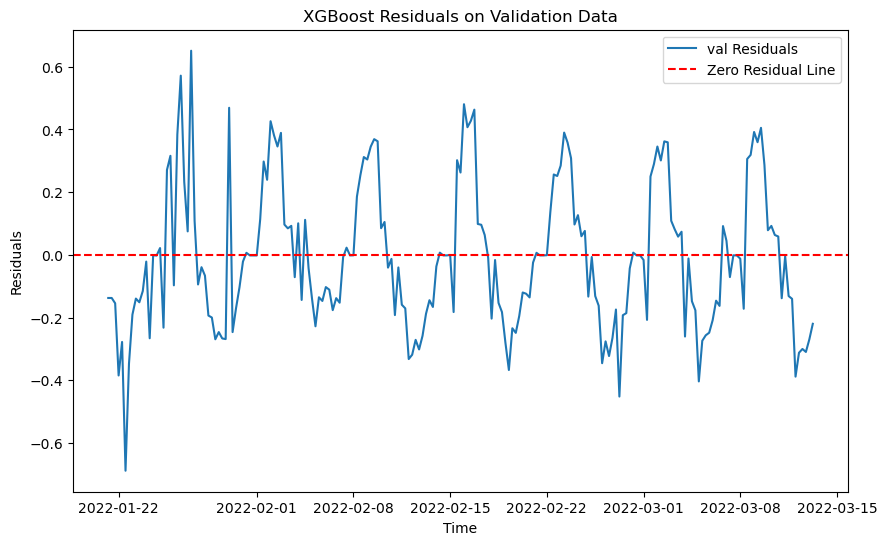

RMSE on training data for XGBoost: 0.013413220557255101
RMSE on validation data for XGBoost: 0.23031281792325747
RMSE on test data for XGBoost: 0.4823447463841138


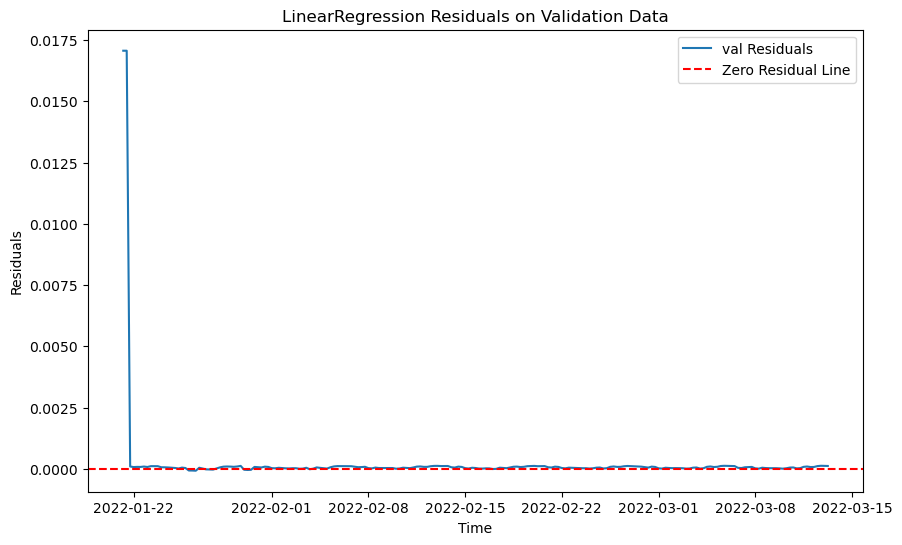

RMSE on training data for LinearRegression: 0.0008756843359149625
RMSE on validation data for LinearRegression: 0.0016868613334336865
RMSE on test data for LinearRegression: 0.02006188800407775

Best model is LinearRegression with RMSE: 0.0016868613334336865
Best model saved as: models\model_92.pkl
data num 96


In [32]:
folder_path = 'train_splits'
cnt=0

for filename in os.listdir(folder_path):
    
    if filename.endswith('.csv'):
        print(filename)
        train_file_path = os.path.join(folder_path, filename)
        test_file_path = train_file_path.replace("train","test")
        df= pd.read_csv(train_file_path)
        test_df= pd.read_csv(test_file_path)
        
        split_idx = int(0.8 * len(df))
        train_df = df[:split_idx]  # First 80% for training
        val_df = df[split_idx:]


        train_df = preprocess_data(train_df)
        val_df =  preprocess_data(val_df)
        test_df = preprocess_data(test_df)


        best_rmse = float('inf')
        best_model = None
        best_model_name = ""
        
       
        arima_model = train_arima_model(train_df)
        train_rmse, val_rmse, test_rmse = Model_Evaluation(arima_model, train_df, val_df, test_df, 'ARIMA') 
        if val_rmse < best_rmse:
            best_rmse = val_rmse
            best_model = arima_model
            best_model_name = 'ARIMA'

        
        prophet_model = train_prophet_model(train_df)   
        train_rmse, val_rmse, test_rmse = Model_Evaluation(prophet_model, train_df, val_df, test_df, 'Prophet')
        if val_rmse < best_rmse:
            best_rmse = val_rmse
            best_model = prophet_model
            best_model_name = 'Prophet'

        
        xgb_model = train_xgboost_model(train_df)
        train_rmse, val_rmse, test_rmse = Model_Evaluation(xgb_model, train_df, val_df, test_df, 'XGBoost')
        if val_rmse < best_rmse:
            best_rmse = val_rmse
            best_model = xgb_model
            best_model_name = 'XGBoost'
            
                
        lin_reg_model = train_linear_regression_model(train_df)
        train_rmse, val_rmse, test_rmse = Model_Evaluation(lin_reg_model, train_df, val_df, test_df, 'LinearRegression')   
        if val_rmse < best_rmse:
            best_rmse = val_rmse
            best_model = lin_reg_model
            best_model_name = 'LinearRegression'


            
        print(f"\nBest model is {best_model_name} with RMSE: {best_rmse}")
            
        save_model(best_model, filename)

        cnt+=1
        print(f'data num {cnt}')
        
        
        